# Pick top cells from each component and use this for sus plots

In [2]:
%load_ext autoreload
%autoreload 2
import cascade as cas
import flow
import pool
import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
from copy import deepcopy
import scipy as sp
import bottleneck as bt
from scipy.stats import pearsonr
from scipy.cluster import hierarchy

# except: 
import tensortools as tt
from flow.misc import wordhash
from cascade import utils
from cascade import paths
from cascade import tca
from functools import reduce

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
# useful lookup tables
color_dict = {'plus': [0.46, 0.85, 0.47, 1],
     'minus': [0.84, 0.12, 0.13, 1],
     'neutral': [0.28, 0.68, 0.93, 1],
     'learning': [34/255, 110/255, 54/255, 1],
     'reversal': [173/255, 38/255, 26/255, 1],
     'gray': [163/255, 163/255, 163/255, 1]}

lookup = {'OA27': {'plus': 270, 'minus': 135, 'neutral': 0},
     'VF226': {'plus': 0, 'minus': 270, 'neutral': 135},
     'OA67': {'plus': 0, 'minus': 270, 'neutral': 135},
     'OA32': {'plus': 135, 'minus': 0, 'neutral': 270},
     'OA34': {'plus': 270, 'minus': 135, 'neutral': 0},
     'OA36': {'plus': 0, 'minus': 270, 'neutral': 135},
     'OA26': {'plus': 270, 'minus': 135, 'neutral': 0}}

lookup_ori = {'OA27': {270: 'plus', 135: 'minus', 0: 'neutral'},
     'VF226': {0: 'plus', 270: 'minus', 135: 'neutral'},
     'OA67': {0: 'plus', 270: 'minus', 135: 'neutral'},
     'OA32': {135: 'plus', 0: 'minus', 270: 'neutral'},
     'OA34': {270: 'plus', 135: 'minus', 0: 'neutral'},
     'OA36': {0: 'plus', 270: 'minus', 135: 'neutral'},
     'OA26': {270: 'plus', 135: 'minus', 0: 'neutral'}}

In [4]:
def _first100_bool(meta):
    """
    Helper function to get a boolean vector of the first 100 trials for each day.
    If a day is shorter than 100 trials use the whole day. 
    """
    
    days = meta.reset_index()['date'].unique()

    first100 = np.zeros((len(meta)))
    for di in days:
        dboo  = meta.reset_index()['date'].isin([di]).values
        daylength = np.sum(dboo)
        if daylength > 100:
            first100[np.where(dboo)[0][:100]] = 1
        else:
            first100[dboo] = 1
    firstboo = first100 > 0
    
    return firstboo

In [5]:
def _last100_bool(meta):
    """
    Helper function to get a boolean vector of the last 100 trials for each day.
    If a day is shorter than 100 trials use the whole day. 
    """
    
    days = meta.reset_index()['date'].unique()

    first100 = np.zeros((len(meta)))
    for di in days:
        dboo  = meta.reset_index()['date'].isin([di]).values
        daylength = np.sum(dboo)
        if daylength > 100:
            first100[np.where(dboo)[0][-100:]] = 1
        else:
            first100[dboo] = 1
    firstboo = first100 > 0
    
    return firstboo

In [6]:
def _firstlast100_bool(meta):
    """
    Helper function to get a boolean vector of the first and last 100 trials for each day.
    If a day is shorter than 200 trials use the whole day. 
    """
    
    days = meta.reset_index()['date'].unique()

    first100 = np.zeros((len(meta)))
    for di in days:
        dboo  = meta.reset_index()['date'].isin([di]).values
        daylength = np.sum(dboo)
        if daylength > 100:
            first100[np.where(dboo)[0][-50:]] = 1
            first100[np.where(dboo)[0][:50]] = 1
        else:
            first100[dboo] = 1
    firstboo = first100 > 0
    
    return firstboo

In [7]:
def _mosttrials_bool(meta):
    """
    Helper function to get a boolean vector of the first n trials for each day.
    n = the number of trials on the shortest day.
    """
    
    day_lengths = []
    days = meta.reset_index()['date'].unique()
    for di in days:
        dboo  = meta.reset_index()['date'].isin([di]).values
        day_lengths.append(np.sum(dboo))
    trialn = np.min(day_lengths)
    
    first100 = np.zeros((len(meta)))
    for di in days:
        dboo  = meta.reset_index()['date'].isin([di]).values
        first100[np.where(dboo)[0][:trialn]] = 1
    firstboo = first100 > 0
    
    mouse = meta.reset_index()['mouse'].unique()[0]
    print('{}: {} trials are being used to maximize possible trials each day'.format(mouse, trialn))
    
    return firstboo

In [8]:
def _mostlatetrials_bool(meta):
    """
    Helper function to get a boolean vector of the first n trials for each day.
    n = the number of trials on the shortest day.
    """
    
    day_lengths = []
    days = meta.reset_index()['date'].unique()
    for di in days:
        dboo  = meta.reset_index()['date'].isin([di]).values
        day_lengths.append(np.sum(dboo))
    trialn = np.min(day_lengths)
    
    first100 = np.zeros((len(meta)))
    for di in days:
        dboo  = meta.reset_index()['date'].isin([di]).values
        first100[np.where(dboo)[0][-trialn:]] = 1
    firstboo = first100 > 0
    
    mouse = meta.reset_index()['mouse'].unique()[0]
    print('{}: {} trials are being used to maximize possible trials each day'.format(mouse, trialn))
    
    return firstboo

In [9]:
def _get_fitting_template_defaults(mouse, sigma=3, sec=15.5, normalize=True):
    """
    Helper function for convolving Gaussian kernel with onset, sustained 
    stimulus, stimulus offset, and ensure delivery period. These can then be
    used for simple linear regression or GLM. 
    """

    # preallocate Gaussian kernel convolution 
    gker = []
    
    # dumb params
    blur = sec
    lag = sec/2
    elag = sec/1.5
    # pick ranges of relevant time periods for convolution
    onset_r = np.arange(np.floor(sec + lag), np.round(sec + sec/3 + blur), 1)
    if mouse in ['OA32', 'OA34', 'OA36']:
        sus_r = np.arange(np.floor(sec + lag), np.round(sec*3 + blur), 1)
        off_r = np.arange(np.floor(sec*3 + sec/4 + lag), np.round(sec*3 + sec/3 + blur), 1)
        ensure_r = np.arange(np.floor(sec*3 + sec/3 + elag), np.round(sec*5 + blur), 1)
    else:
        sus_r = np.arange(np.floor(sec + lag), np.round(sec*4 + blur), 1)
        off_r = np.arange(np.floor(sec*4 + sec/4 + lag), np.round(sec*4 + sec/3 + blur), 1)
        ensure_r = np.arange(np.floor(sec*4 + sec/3 + elag), np.round(sec*6 + blur), 1)
    ranges = [onset_r, sus_r, off_r, ensure_r]

    # convolve
    for i in ranges:
        i = [int(s) for s in i]
        starter = np.zeros((108))
        starter[i] = 1
        gker.append(sp.ndimage.gaussian_filter1d(starter, sigma, mode='constant', cval=0))

    # normalize filters
    if normalize:
        gker = [(s - np.min(s))/np.max(s) for s in gker]

    templates = np.vstack(gker).T

    return templates

[-1  0  1  2  3  4  5  6]
[ 0.  15.5 31.  46.5 62.  77.5 93. ]


([<matplotlib.axis.XTick at 0xb286a33a90>,
 <a list of 7 Text xticklabel objects>)

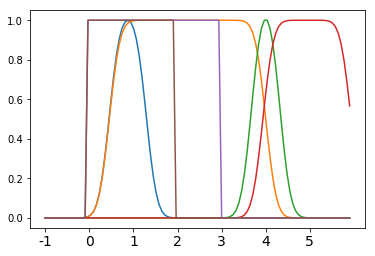

In [10]:
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)
print(times)
print(timepts)

A = _get_fitting_template_defaults('OA27')
plt.plot(A)
short = np.zeros((108))
long = np.zeros((108))
short[15:int(np.floor(15.5*3))] = 1
long[15:int(np.floor(15.5*4))] = 1
plt.plot(long)
plt.plot(short)
plt.xticks(timepts, labels=times, size=14)

In [11]:
def _get_fitting_template_new(sigma=3.5, sec=15.5, lag=5, normalize=True):
    """
    Helper function for convolving Gaussian kernel with onset, sustained 
    stimulus, stimulus offset, and ensure delivery period. These can then be
    used for simple linear regression or GLM. 
    """

    # preallocate Gaussian kernel convolution 
    gker = []
    
    # dumb params
    ranges = np.arange(15.5 + lag, 108, 15.5/2)
    ranges = list(np.floor(ranges))
    ranges = [int(s) for s in ranges]
    
    # convolve
    for i in ranges:
#         i = [int(s) for s in i]
        starter = np.zeros((108))
        starter[i] = 1
        gker.append(sp.ndimage.gaussian_filter1d(starter, sigma, mode='constant', cval=0))

    # normalize filters
    if normalize:
        gker = [(s - np.min(s))/np.max(s) for s in gker]

    templates = np.vstack(gker).T

    return templates

In [12]:
ranges = np.ceil(np.logspace(0.1, 1, 10)*(10)+3)
ranges

array([ 16.,  19.,  23.,  29.,  35.,  43.,  54.,  67.,  83., 103.])

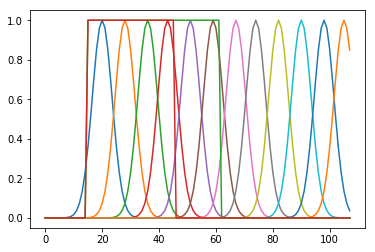

In [13]:
A = _get_fitting_template_new(sigma=3.5, lag=5)
plt.plot(A)
short = np.zeros((108))
long = np.zeros((108))
short[15:int(np.floor(15.5*3))] = 1
long[15:int(np.floor(15.5*4))] = 1
plt.plot(long)
plt.plot(short)

In [14]:
def _get_fitting_template_noverlap(mouse, sigma=3.5, shift=0, sec=15.5, normalize=True):
    """
    Helper function for convolving Gaussian kernel with onset, sustained 
    stimulus, stimulus offset, and ensure delivery period. These can then be
    used for simple linear regression or GLM. 
    """

    # preallocate Gaussian kernel convolution 
    gker = []
    
    # dumb params
    blur = sec/2
    lag = sec/2
    elag = sec/1.5
    # pick ranges of relevant time periods for convolution
    onset_r = [18+shift]
    if mouse in ['OA32', 'OA34', 'OA36']:
        sus_r = np.arange(np.floor(sec + lag), np.round(sec*3 + blur), 1)
        off_r = np.arange(np.floor(sec*3 + sec/4 + lag), np.round(sec*3 + sec/3 + blur), 1)
        ensure_r = np.arange(np.floor(sec*3 + sec/3 + elag), np.round(sec*5 + blur), 1)
    else:
        sus_r = np.arange(np.floor(sec + lag), np.round(sec*4 + blur), 1)
        off_r = np.arange(np.floor(sec*4 + sec/4 + lag), np.round(sec*4 + sec/3 + blur), 1)
        ensure_r = np.arange(np.floor(sec*4 + sec/3 + elag), np.round(sec*6 + blur), 1)
    ranges = [onset_r, sus_r, off_r, ensure_r]

    # convolve
    for i in ranges:
        i = [int(s) for s in i]
        starter = np.zeros((108))
        starter[i] = 1
        gker.append(sp.ndimage.gaussian_filter1d(starter, sigma, mode='constant', cval=0))

    # normalize filters
    if normalize:
        gker = [(s - np.min(s))/np.max(s) for s in gker]

    templates = np.vstack(gker).T

    return templates

In [15]:
def _get_fitting_template_log(sigma=3.5, sec=15.5, lag=0, normalize=True):
    """
    Helper function for convolving Gaussian kernel with onset, sustained 
    stimulus, stimulus offset, and ensure delivery period. These can then be
    used for simple linear regression or GLM. 
    """

    # preallocate Gaussian kernel convolution 
    gker = []
    
    # dumb params
    ranges = np.ceil(np.logspace(0.1, 1, 10)*(10)+3)
    ranges = list(np.floor(ranges))
    ranges = [int(s) for s in ranges]
    
    # convolve
    for i in ranges:
#         i = [int(s) for s in i]
        starter = np.zeros((108))
        starter[i] = 1
        gker.append(sp.ndimage.gaussian_filter1d(starter, sigma, mode='constant', cval=0))

    # normalize filters
    if normalize:
        gker = [(s - np.min(s))/np.max(s) for s in gker]

    templates = np.vstack(gker).T

    return templates

[-1  0  1  2  3  4  5  6]
[ 0.  15.5 31.  46.5 62.  77.5 93. ]


([<matplotlib.axis.XTick at 0xb286bef4e0>,
 <a list of 7 Text xticklabel objects>)

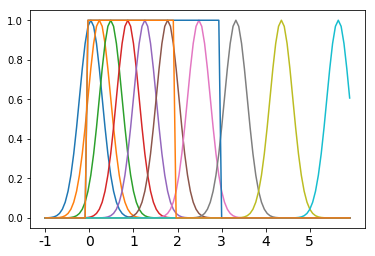

In [17]:
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)
print(times)
print(timepts)

A = _get_fitting_template_log(sigma=4)
plt.plot(A)
short = np.zeros((108))
long = np.zeros((108))
short[15:int(np.floor(15.5*3))] = 1
long[15:int(np.floor(15.5*4))] = 1
plt.plot(long)
plt.plot(short)
plt.xticks(timepts, labels=times, size=14)

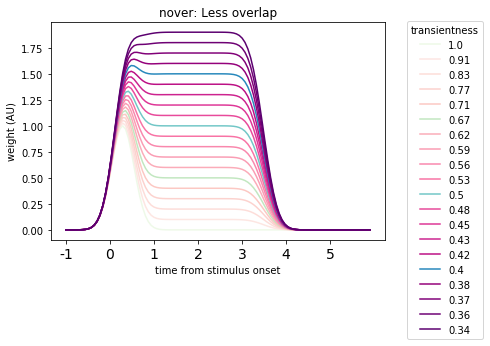

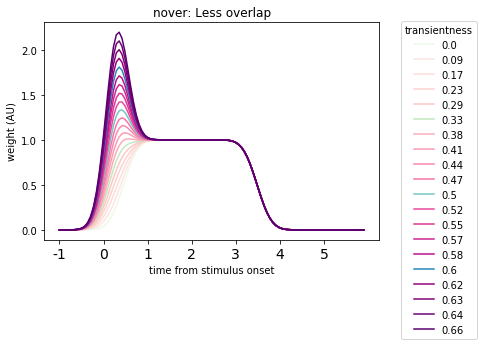

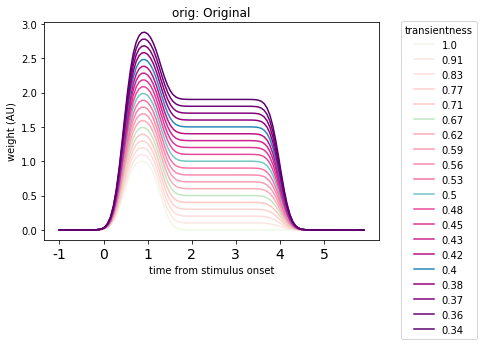

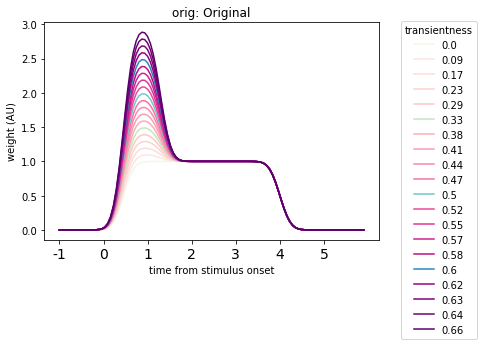

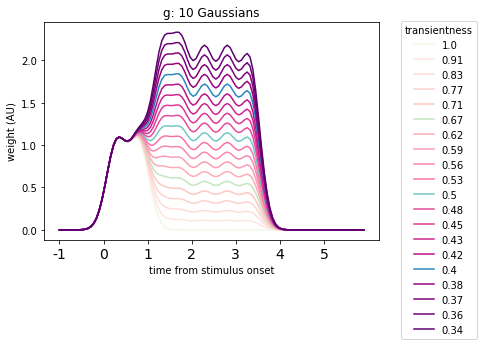

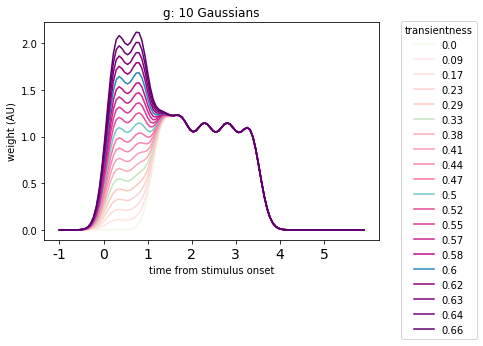

In [213]:
colors = sns.color_palette('RdPu', len(np.arange(0, 2, .1)))
colors2 = sns.color_palette('GnBu', len(np.arange(0, 2, .1)))
mod_by = 5
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)

A = _get_fitting_template_noverlap('OA27', sigma=4, shift=2)

plt.figure()
for c, i in enumerate(np.arange(0, 2, .1)):
#     plt.plot(A[:,0]+A[:,1]*i, label=round(1/(1+i), 2), color=colors[c])
    if c % mod_by == 0:
        plt.plot(A[:,0]+A[:,1]*i, label=round(1/(1+i), 2), color=colors2[c])
    else:
        plt.plot(A[:,0]+A[:,1]*i, label=round(1/(1+i), 2), color=colors[c])
plt.legend(title='transientness', bbox_to_anchor=(1.05, 1.03), loc='upper left')
plt.xticks(timepts, labels=times, size=14)
plt.xlabel('time from stimulus onset')
plt.ylabel('weight (AU)')
plt.title('nover: Less overlap')
plt.savefig('nover1_transientness_calc.png', bbox_inches='tight')

plt.figure()
for c, i in enumerate(np.arange(0, 2, .1)):
    if c % mod_by == 0:
        plt.plot(A[:,0]*i+A[:,1], label=round(i/(1+i), 2), color=colors2[c])
    else:
        plt.plot(A[:,0]*i+A[:,1], label=round(i/(1+i), 2), color=colors[c])
plt.legend(title='transientness', bbox_to_anchor=(1.05, 1.03), loc='upper left')
plt.xticks(timepts, labels=times, size=14)
plt.xlabel('time from stimulus onset')
plt.ylabel('weight (AU)')
plt.title('nover: Less overlap')
plt.savefig('nover2_transientness_calc.png', bbox_inches='tight')


B = _get_fitting_template_defaults('OA27')

plt.figure()
for c, i in enumerate(np.arange(0, 2, .1)):
#     plt.plot(A[:,0]+A[:,1]*i, label=round(1/(1+i), 2), color=colors[c])
    if c % mod_by == 0:
        plt.plot(B[:,0]+B[:,1]*i, label=round(1/(1+i), 2), color=colors2[c])
    else:
        plt.plot(B[:,0]+B[:,1]*i, label=round(1/(1+i), 2), color=colors[c])
plt.legend(title='transientness', bbox_to_anchor=(1.05, 1.03), loc='upper left')
plt.xticks(timepts, labels=times, size=14)
plt.xlabel('time from stimulus onset')
plt.ylabel('weight (AU)')
plt.title('orig: Original')
plt.savefig('orig1_transientness_calc.png', bbox_inches='tight')

plt.figure()
for c, i in enumerate(np.arange(0, 2, .1)):
    if c % mod_by == 0:
        plt.plot(B[:,0]*i+B[:,1], label=round(i/(1+i), 2), color=colors2[c])
    else:
        plt.plot(B[:,0]*i+B[:,1], label=round(i/(1+i), 2), color=colors[c])
plt.legend(title='transientness', bbox_to_anchor=(1.05, 1.03), loc='upper left')
plt.xticks(timepts, labels=times, size=14)
plt.xlabel('time from stimulus onset')
plt.ylabel('weight (AU)')
plt.title('orig: Original')
plt.savefig('orig2_transientness_calc.png', bbox_inches='tight')

C = _get_fitting_template_new(sigma=3.5, lag=5)

plt.figure()
for c, i in enumerate(np.arange(0, 2, .1)):
    ci = deepcopy(C)
    ci[:, 2:7] = ci[:, 2:7]*i
    ci = np.sum(ci[:,:7], axis=1)
    if c % mod_by == 0:
        plt.plot(ci, label=round(1/(1+i), 2), color=colors2[c])
    else:
        plt.plot(ci, label=round(1/(1+i), 2), color=colors[c])
plt.legend(title='transientness', bbox_to_anchor=(1.05, 1.03), loc='upper left')
plt.xticks(timepts, labels=times, size=14)
plt.xlabel('time from stimulus onset')
plt.ylabel('weight (AU)')
plt.title('g: 10 Gaussians')
plt.savefig('g1_transientness_calc.png', bbox_inches='tight')

plt.figure()
for c, i in enumerate(np.arange(0, 2, .1)):
    ci = deepcopy(C)
    ci[:, 0:2] = ci[:, 0:2]*i
    ci = np.sum(ci[:,:7], axis=1)
    if c % mod_by == 0:
        plt.plot(ci, label=round(i/(1+i), 2), color=colors2[c])
    else:
        plt.plot(ci, label=round(i/(1+i), 2), color=colors[c])
plt.legend(title='transientness', bbox_to_anchor=(1.05, 1.03), loc='upper left')
plt.xticks(timepts, labels=times, size=14)
plt.xlabel('time from stimulus onset')
plt.ylabel('weight (AU)')
plt.title('g: 10 Gaussians')
plt.savefig('g2_transientness_calc.png', bbox_inches='tight')

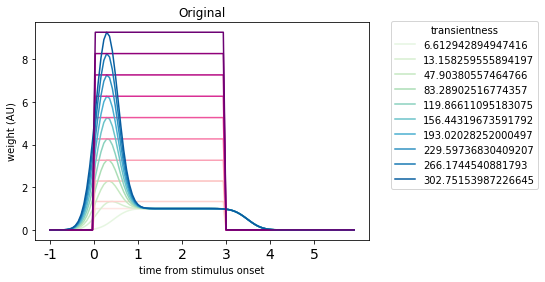

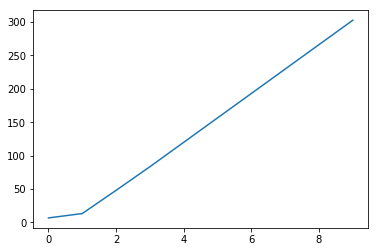

In [20]:
plotting_r = np.arange(0, 10, 1)
colors = sns.color_palette('RdPu', len(plotting_r))
colors2 = sns.color_palette('GnBu', len(plotting_r))

B = _get_fitting_template_noverlap('OA27', sigma=4, shift=2)

vec_trans1 = []
vec_trans2 = []
stim_r = [int(s) for s in np.arange(16, 15.5*4)]
plt.figure()
for c, i in enumerate(plotting_r):
    trace = B[:,0]*i+B[:,1]
    stim = np.zeros((len(trace)))
    stim[stim_r] = np.max(trace[stim_r])
    cumsum_diff = (np.trapz(stim[stim_r]) - np.trapz(trace[stim_r])) #/np.trapz(stim[stim_r])
#     vec_trans1.append(cumsum_diff)
#     cumsum_diff = np.sum(trace[stim_r])/np.sum(stim[stim_r])
#     cumsum_diff = cumsum_diff #/np.max(trace[stim_r]) #len(stim_r)
    vec_trans2.append(cumsum_diff)
    plt.plot(trace, label=cumsum_diff, color=colors2[c])
    plt.plot(stim, color=colors[c])
plt.legend(title='transientness', bbox_to_anchor=(1.05, 1.03), loc='upper left')
plt.xticks(timepts, labels=times, size=14)
plt.xlabel('time from stimulus onset')
plt.ylabel('weight (AU)')
plt.title('Original')

plt.figure()
# plt.plot(vec_trans1)
plt.plot(vec_trans2)

In [21]:
def _sortcellfactors(cell_factors):
    """
    Sort a set of neuron factors by which factor they contribute
    to the most.

    Input
    -------
    Tensortools ensemble with method. (set of multiple initializations of TCA)
        i.e., _sortfactors(ensemble['ncp_bcd'])

    Returns
    -------
    my_method, copy of tensortools ensemble method now with neuron factors sorted.
    my_rank_sorts, sort indexes to keep track of cell identity

    """

    factors = deepcopy(cell_factors)

    # sort each neuron factor and update the order based on strongest factor
    # reflecting prioritized sorting of earliest to latest factors

    # sort neuron factors according to which component had highest weight
    max_fac = np.argmax(factors, axis=1)
    sort_fac = np.argsort(max_fac)
    sort_max_fac = max_fac[sort_fac]
    first_sort = factors[sort_fac, :]

    # descending sort within each group of sorted neurons
    second_sort = []
    for i in np.unique(max_fac):
        second_inds = (np.where(sort_max_fac == i)[0])
        second_sub_sort = np.argsort(first_sort[sort_max_fac == i, i])
        second_sort.extend(second_inds[second_sub_sort][::-1])

    # apply the second sort
    full_sort = sort_fac[second_sort]
    sorted_factors = factors[full_sort, :]

    # check for zero-weight factors
    no_weight_binary = np.max(sorted_factors, axis=1) == 0
    inds_to_end = full_sort[no_weight_binary]
    full_sort = np.concatenate((full_sort[np.invert(no_weight_binary)], inds_to_end), axis=0)
    
    # apply the final sort
    sorted_factors = factors[full_sort, :]

    return sorted_factors, full_sort

In [22]:
def _first100_wtrans_bool(meta):
    """
    Helper function to get a boolean vector of the first 100 trials for each day.
    If a day is shorter than 100 trials use the whole day. 
    """
    
    day_vec = _update_meta_date_vec(meti).reset_index()['date'].values
    u_days = np.unique(day_vec)

    first100 = np.zeros((len(meta)))
    for di in u_days:
        dboo  = np.isin(day_vec, di)
        daylength = np.sum(dboo)
        if daylength > 100:
            first100[np.where(dboo)[0][:100]] = 1
        else:
            first100[dboo] = 1
    firstboo = first100 > 0
    
    return firstboo

In [23]:
def _update_meta_date_vec(meta):
    """
    Helper function to get change date vector in metadata to be .5 for learning
    and reversal transitions in the middle of the day.
    """
    
    day_vec = np.array(meta.reset_index()['date'].values, dtype='float')
    days = np.unique(day_vec)
    ls = meta['learning_state'].values
    for di in days:
        dboo  = np.isin(day_vec, di)
        states_vec = ls[dboo]
        u_states = np.unique(states_vec)
        if len(u_states) > 1:
            second_state = dboo & (ls == u_states[1])
            day_vec[second_state] += 0.5
    
    # replace
    new_meta = meta.reset_index()
    new_meta['date'] = day_vec
    new_meta = new_meta.set_index(['mouse', 'date', 'run', 'trial_idx'])
    
    return new_meta

In [24]:
def _update_meta_stages(meta):
    """
    Helper function to add the stage of learning to metadata.
    """
    
    stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
    
    meta = cas.utils.add_dprime_to_meta(meta)
    meta = _update_meta_date_vec(meta)
    u_days = np.unique(meta.reset_index()['date'])
    all_days = meta.reset_index()['date'].values
    ls = meta['learning_state'].values
    dp = meta['dprime'].values
    
    stage_vec = []
    for lsi, dpi in zip(ls, dp):
    
        if 'naive' in lsi:
            stage_vec.append('naive')
        elif 'learning' in lsi:
            if dpi < 2:
                stage_vec.append('low_dp learning')
            elif dpi >=2:
                stage_vec.append('high_dp learning')
        elif 'reversal1' in lsi:
            if dpi < 2:
                stage_vec.append('low_dp reversal1')
            elif dpi >=2:
                stage_vec.append('high_dp reversal1')
    
    meta['parsed_stage'] = stage_vec
    
    return meta

In [25]:
def _update_meta_reltrials(meta):
    """
    Helper funtion to add the relative trial number to each trial (relative to start of day).
    """
    # ensure you are splitting at reversal
    meta = _update_meta_date_vec(meta)
    all_days = meta.reset_index()['date'].values
    u_days = np.unique(meta.reset_index()['date'])
    
    rel_trials = np.zeros((len(meta)))
    trial_ind = 0
    for di in u_days:
        trial_count = np.sum(np.isin(all_days, di))
        for ti in range(trial_count):
            rel_trials[trial_ind] = ti
            trial_ind +=1
    
    meta['relative_trial_idx'] = rel_trials
    
    return meta

In [26]:
def _tensor_to_df(tensor, meta):
    """
    Helper function to get tensor into a dataframe for easier pandas parsing/grouping.
    """
    
    # unwrap tensor
    cell_list = []
    for celli in range(tensor.shape[0]):
        cellmat = tensor[celli,:,:]
        cell_df = pd.DataFrame(data=cellmat.T, index=meta.index)
        cell_df['cell_number'] = [celli+1]*len(tensor.shape[2])
        cell_df = cell_df.reset_index().set_index(['mouse', 'date', 'run', 'trial_idx', 'cell_number'])
        cell_list.append(cell_df)
        
    # stick df back together
    tensor_df = pd.concat(cell_list, axis=0)     
    
    return tensor_df
    

In [27]:
def _tensor_to_avg_df(tensor, meta, norm=False):
    """
    Helper function to get tensor into a dataframe for easier pandas parsing/grouping.
    """
    
    # get average across cells
    if norm:
        cell_max = np.nanmax(np.nanmax(tensor[:,:,:], axis=1), axis=1)
        cellmat = np.nanmean(tensor[:,:,:]/cell_max[:, None, None], axis=0)
    else:
        cellmat = np.nanmean(tensor[:,:,:], axis=0)
    cell_df = pd.DataFrame(data=cellmat.T, index=meta.index)
    
    return cell_df

In [28]:
def comp_tensor_dict_to_df(tensor_dict, meta, first100only=False):
    
    if first100only:
        firstboo = _first100_wtrans_bool(meta)
        meta = _update_meta_date_vec(meta)
        meta = meta.iloc[firstboo,:]
        
    comp_list = []
    for ki in tensor_dict:
        if first100only:
            comp_tensor = tensor_dict[ki][:,:,firstboo]
        else:
            comp_tensor = tensor_dict[ki]
        comp_tensor_df = _tensor_to_df(comp_tensor, meta)
        comp_tensor_df['component'] = [ki]*len(comp_tensor_df)
        comp_tensor_df = comp_tensor_df.reset_index().set_index(['mouse', 'date', 'run', 'trial_idx', 'component', 'cell_number'])
        comp_list.append(comp_tensor_df)
        
     # stick df back together
    tensor_df = pd.concat(comp_list, axis=0)    
    
    return tensor_df

In [30]:
def comp_tensor_dict_to_avg_df(tensor_dict, meta, norm=False, first100only=False):
    
    if first100only:
        firstboo = _first100_wtrans_bool(meta)
        meta = _update_meta_date_vec(meta)
        meta = meta.iloc[firstboo,:]
        
    comp_list = []
    for ki in tensor_dict:
        if first100only:
            comp_tensor = tensor_dict[ki][:,:,firstboo]
        else:
            comp_tensor = tensor_dict[ki]
        comp_tensor_df = _tensor_to_avg_df(comp_tensor, meta, norm=norm)
        comp_tensor_df['component'] = [ki]*len(comp_tensor_df)
        comp_tensor_df = comp_tensor_df.reset_index().set_index(['mouse', 'date', 'run', 'trial_idx', 'component'])
        comp_list.append(comp_tensor_df)
        
     # stick df back together
    tensor_df = pd.concat(comp_list, axis=0)    
    
    return tensor_df

In [11]:
mice = ['OA27', 'VF226', 'OA67','OA32', 'OA34', 'OA36', 'OA26']
words = ['rebel']*len(mice) #viewers
pars = {
    'tags': None,

    # TCA params
    'rank': 20,
    'method': ('ncp_hals',),
    'replicates': 3,
    'fit_options': None,
    'skip_modes': [],
    'negative_modes' :  [],


    # grouping params
    'group_by': 'all2',
    'up_or_down': 'up',
    'use_dprime': False,
    'dprime_threshold': 2,

    # tensor params
    'trace_type': 'zscore_day',
    'cs': '',
    'downsample': True,
    'start_time': -1,
    'end_time': 6,
    'clean_artifacts': None,
    'thresh': 20,
    'warp': False,
    'smooth': True,
    'smooth_win': 6,
    'verbose': True,

    # filtering params
    'exclude_tags': ('disengaged', 'orientation_mapping', 'contrast', 'retinotopy', 'sated'),
    'exclude_conds': ('blank', 'blank_reward', 'pavlovian'),
    'driven': False,
    'drive_css': ('0', '135', '270'),
    'drive_threshold': 1.31, # should change this to 1.31
    'nan_trial_threshold': 0.95,
    'score_threshold': 0.8,

    # other params
    'update_meta': False,
    'three_pt_tf': False,
    'remove_stim_corr': False}

In [56]:
mice = ['OA27', 'VF226', 'OA67','OA32', 'OA34', 'OA36', 'OA26']
words = ['bookmarks']
words.extend(['horrible']*6)
# words = ['chicken'] # unsmoothed raw triggered
# words.extend(['costa']*6)

# load in a full size tensor
model_list = []
tensor_list = []
id_list = []
bhv_list = []
meta_list = []
for mouse, word in zip(mice, words):
    out = cas.load.load_all_groupday(mouse, word=word, with_model=False, group_by='all3', nan_thresh=0.95)  # return   model, ids, tensor, meta, bhv
    model_list.append(out[0])
    tensor_list.append(out[2])
    id_list.append(out[1])
    bhv_list.append(out[4])
    meta_list.append(out[3])

Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     0 plus
     270 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     0 plus
     270 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     135 plus
     0 minus
     270 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     0 plus
     270 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.


In [55]:
np.any([True, True])

True

In [32]:
meta_list[0].columns

Index(['orientation', 'condition', 'initial_condition', 'trialerror',
       'prev_reward', 'prev_punish', 'prev_same_plus', 'prev_same_neutral',
       'prev_same_minus', 'hunger', 'learning_state', 'tag', 'firstlick',
       'firstlickbout', 'ensure', 'quinine', 'hmm_engaged', 'speed',
       'pre_speed', 'anticipatory_licks', 'pre_licks', 'pupil', 'pre_pupil',
       'brainmotion', 'go', 'reward', 'punishment',
       'p_initial_plus_since_last_initial_plus',
       'p_initial_minus_since_last_initial_plus',
       'p_initial_neutral_since_last_initial_plus',
       'p_go_since_last_initial_plus', 'p_reward_since_last_initial_plus',
       'p_initial_plus_since_last_initial_minus',
       'p_initial_minus_since_last_initial_minus',
       'p_initial_neutral_since_last_initial_minus',
       'p_go_since_last_initial_minus', 'p_reward_since_last_initial_minus',
       'p_initial_plus_since_last_initial_neutral',
       'p_initial_minus_since_last_initial_neutral',
       'p_initial_ne

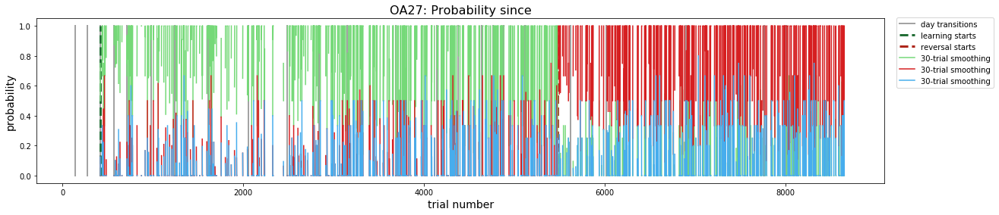

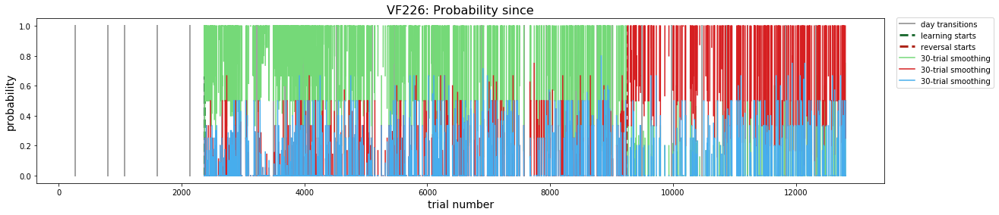

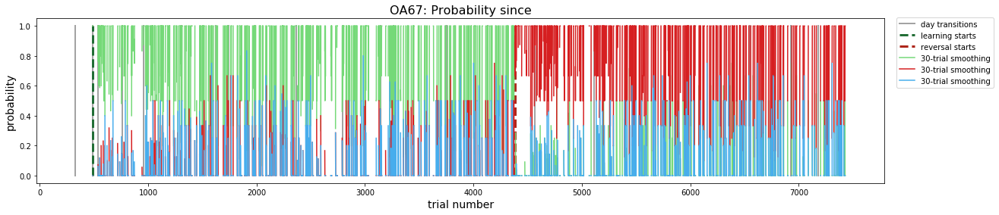

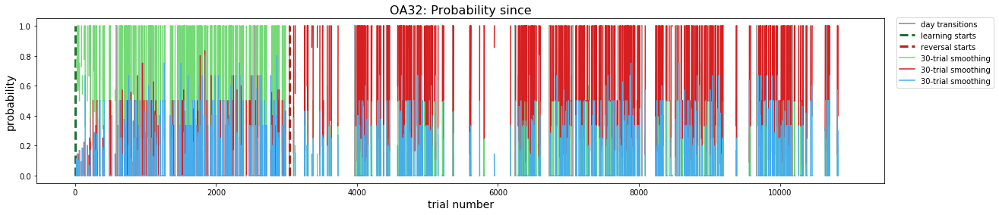

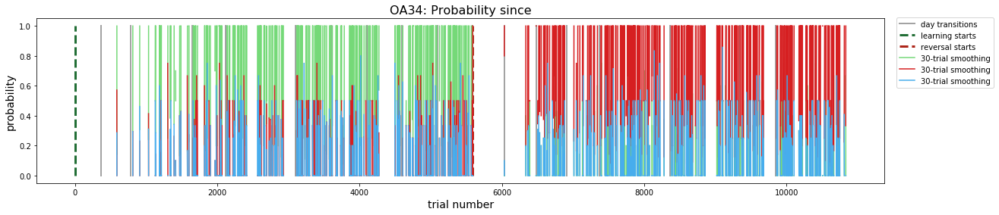

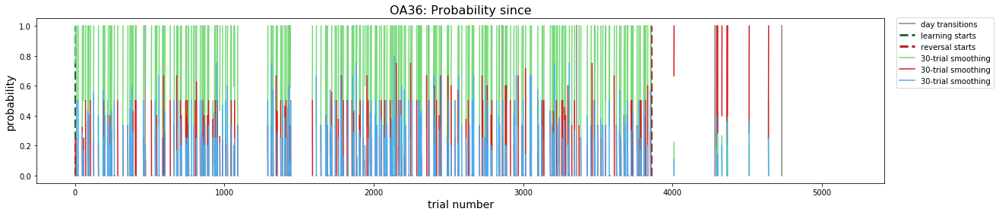

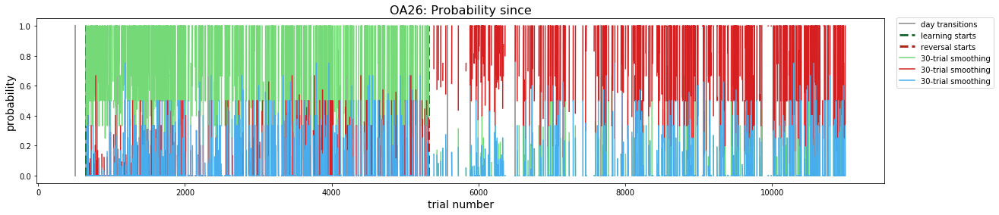

In [62]:
for mi, meti in zip(mice, meta_list):
    
    plt.figure(figsize=(20,4))
    plt.xlabel('trial number', size=14)
    plt.ylabel('probability', size=14)
#     plt.yticks([0, 1], labels=['disengaged', 'engaged'], size=12)
    plt.title('{}: Probability since'.format(mi), size=16)

    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    ndays = np.diff(dates.values)
    day_x = np.where(ndays)[0] + 0.5
    
    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    lear_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][0]
    
    # plot date a d rev
    y_min = 0 
    y_max = 1
    first_day = True
    if len(day_x) > 0:
        for k in day_x:
#             if k == lear_ind or k == rev_ind:
#                 continue
            if first_day:
                plt.plot([k, k], [y_min, y_max], color=color_dict['gray'], linewidth=2, label='day transitions')
                first_day = False
            else:
                plt.plot([k, k], [y_min, y_max], color=color_dict['gray'], linewidth=2)
    plt.plot([lear_ind, lear_ind], [y_min, y_max], '--', color=color_dict['learning'], linewidth=3, label='learning starts')
    plt.plot([rev_ind, rev_ind], [y_min, y_max], '--', color=color_dict['reversal'], linewidth=3, label='reversal starts')
    
    # plot hmm on top
    plt.plot(meti['p_initial_plus_since_last_reward'].values, label='30-trial smoothing', color=color_dict['plus'])
    plt.plot(meti['p_initial_minus_since_last_reward'].values, label='30-trial smoothing', color=color_dict['minus'])
    plt.plot(meti['p_initial_neutral_since_last_reward'].values, label='30-trial smoothing', color=color_dict['neutral'])
    
        # plot hmm on top
    plt.plot(meti['p_initial_plus_since_last_initial_plus'].values, label='30-trial smoothing', color=color_dict['plus'])
    plt.plot(meti['p_initial_minus_since_last_initial_minus'].values, label='30-trial smoothing', color=color_dict['minus'])
    plt.plot(meti['p_initial_neutral_since_last_initial_neutral'].values, label='30-trial smoothing', color=color_dict['neutral'])
    
    plt.legend(bbox_to_anchor=(1.01, 1.03), loc='upper left')

    #     plt.savefig('{}_hmm_engagement_all_trials.pdf'.format(mi), bbox_inches='tight')

In [81]:
x1 = np.where(~meti['p_initial_plus_since_last_reward'].isna())[0]

array([  655,   656,   657, ..., 10998, 10999, 11007], dtype=int64)

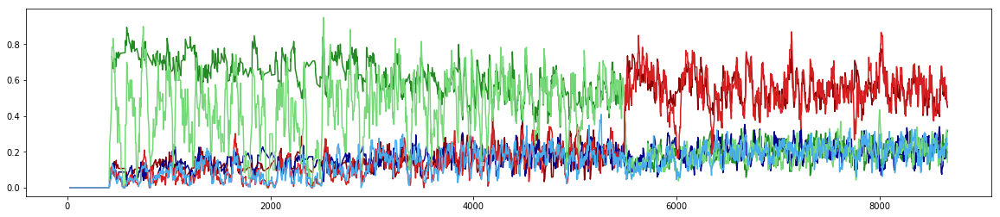

In [86]:
meti = meta_list[0]
plt.figure(figsize=(20, 4))
roll_by = 10

x1 = np.where(~meti['p_initial_plus_since_last_reward'].isna())[0]
plt.plot(x1, meti['p_initial_plus_since_last_reward'].dropna().rolling(roll_by).mean().values, label='30-trial smoothing', color='forestgreen')
x1 = np.where(~meti['p_initial_minus_since_last_reward'].isna())[0]
plt.plot(x1, meti['p_initial_minus_since_last_reward'].dropna().rolling(roll_by).mean().values, label='30-trial smoothing', color='darkred')
x1 = np.where(~meti['p_initial_neutral_since_last_reward'].isna())[0]
plt.plot(x1, meti['p_initial_neutral_since_last_reward'].dropna().rolling(roll_by).mean().values, label='30-trial smoothing', color='darkblue')

x2 = np.where(~meti['p_reward_since_last_initial_plus'].isna())[0]
plt.plot(x2, meti['p_reward_since_last_initial_plus'].dropna().rolling(roll_by).mean().values, label='30-trial smoothing', color=color_dict['plus'])

x3 = np.where(~meti['p_reward_since_last_initial_minus'].isna())[0]
plt.plot(x3, meti['p_reward_since_last_initial_minus'].dropna().rolling(roll_by).mean().values, label='30-trial smoothing', color=color_dict['minus'])

x4 = np.where(~meti['p_reward_since_last_initial_neutral'].isna())[0]
plt.plot(x4, meti['p_reward_since_last_initial_neutral'].dropna().rolling(roll_by).mean().values, label='30-trial smoothing', color=color_dict['neutral'])

In [87]:
# load TCA models and data

rank = 10
words = ['rebel']*len(mice)
model_list = []
model_id_list = []
model_meta_list = []
for mouse, word in zip(mice, words):
    V, my_sorts = cas.load.groupday_tca_model(
            mouse=mouse,
            trace_type='zscore_day',
            method='ncp_hals',
            cs='',
            rank=rank,
            word=word,
            group_by='l_vs_r1_tight',
#             group_by='high_dprime_learning',
            nan_thresh=0.95,
            score_threshold=0.8,
            full_output=False,
            unsorted=True,
            verbose=False)
    model_list.append(V)
    ids = cas.load.groupday_tca_ids(
            mouse=mouse,
            trace_type='zscore_day',
            method='ncp_hals',
            cs='',
            word=word,
            group_by='l_vs_r1_tight',
#             group_by='high_dprime_learning',
            nan_thresh=0.95,
            score_threshold=0.8)
    model_id_list.append(ids)
    met = cas.load.groupday_tca_meta(
            mouse=mouse,
            trace_type='zscore_day',
            method='ncp_hals',
            cs='',
            word=word,
            group_by='l_vs_r1_tight',
#             group_by='high_dprime_learning',
            nan_thresh=0.95,
            score_threshold=0.8)
    model_meta_list.append(met)

Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     0 plus
     270 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     0 plus
     270 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     135 plus
     0 minus
     270 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     0 plus
     270 minus
     135 neutral
Updated naive trialerror to match learning.
Updated naive cs-ori pairings to match learning.
     270 plus
     135 minus
     0 neutral
Updated naive trialerror to match learning.


In [88]:
# subset full size tensor to only include cells that were kept in tca model
subset_tensor_list = []
subset_model_list = []
for t1, m1, l1, l2 in zip(tensor_list, model_list, id_list, model_id_list):
    survivor_boo = np.in1d(l1, l2)
    subset_tensor_list.append(t1[survivor_boo,:,:])
    kept_ids1 = l1[survivor_boo]
    survivor_boo = np.in1d(l2, l1)
    subset_model_list.append(m1.results[rank][0].factors[0][survivor_boo, :])
    kept_ids2 = l2[survivor_boo]
    if np.sum((kept_ids1-kept_ids2) != 0) > 0:
        print('Unmatched ids!!!')

In [33]:
yest = []
for ci in range(1,rank+1):
    thresh = np.std(V)*1
    weight_vec = deepcopy(V[:, ci-1])
#     weight_vec[weight_vec <= thresh] = 0
    print(np.isin(np.argsort(weight_vec)[np.sort(weight_vec) > thresh],dubs))
    yest.append(np.argsort(weight_vec)[np.sort(weight_vec) > thresh])

[False  True  True  True False False  True  True  True False  True  True
 False  True False False  True  True  True  True False  True  True False
 False False False]
[False False False  True  True False  True  True False False False  True
 False False False False False  True  True]
[ True False False False False False False  True False  True False  True
 False False False  True  True False False  True False False False False
  True  True False False  True False False  True False False  True  True
 False False  True False False False  True False  True False False False
  True False False]
[ True False False  True False  True  True  True False  True  True  True
  True  True  True  True False  True False  True  True  True False  True
 False False  True False False  True  True  True  True  True False False
  True False False  True  True  True False False False False False False
  True]
[ True  True  True  True  True  True False  True  True  True  True  True
  True  True  True  True False F

In [ ]:
sorted_cells = _sortcellfactors(V)
clus_boundaries = np.argmax(sorted_cells[0], axis=1)
plt.plot(sorted_cells[0])
clus_boundaries

In [ ]:
st = deepcopy(sorted_cells[0])
th = np.std(st)
for i in range(st.shape[1]):
    st[st[:,i] < thresh, i] = np.nan
plt.plot(st)

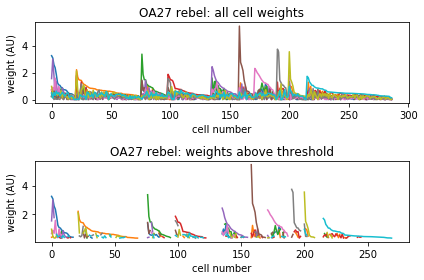

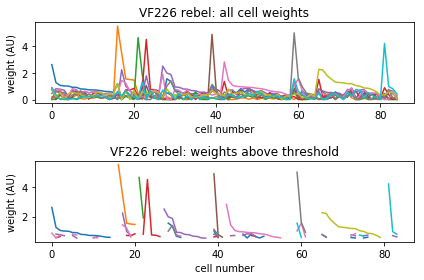

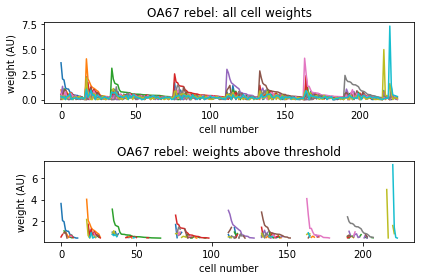

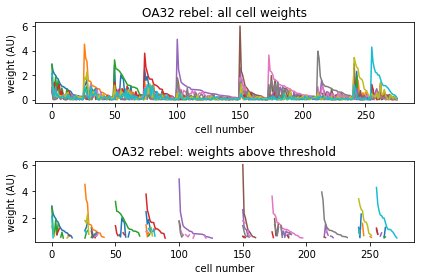

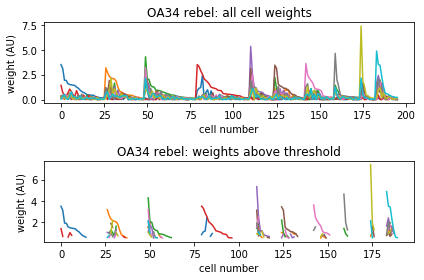

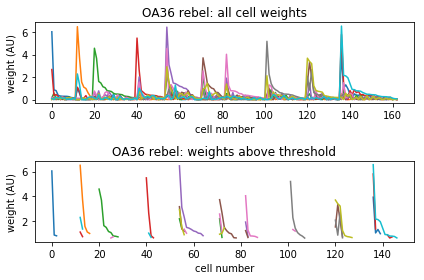

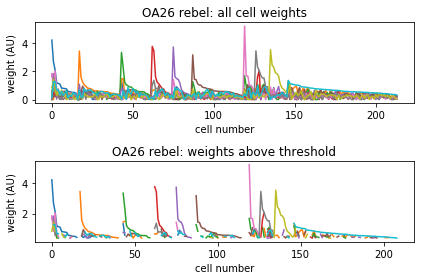

In [89]:
for c, V in enumerate(subset_model_list):
    thresh = np.std(V)*1
    weights = deepcopy(_sortcellfactors(V)[0])
    for i in range(V.shape[1]):
        weights[weights[:,i] < thresh, i] = np.nan
        
    fig, (ax1, ax2) = plt.subplots(2,1)
    ax1.plot(_sortcellfactors(V)[0])
    ax2.plot(weights)
    ax1.set_title('{} {}: all cell weights'.format(mice[c], words[0]))
    ax2.set_title('{} {}: weights above threshold'.format(mice[c], words[0]))
    ax1.set_ylabel('weight (AU)')
    ax2.set_ylabel('weight (AU)')
    ax1.set_xlabel('cell number')
    ax2.set_xlabel('cell number')
    plt.tight_layout()
#     plt.savefig('{}_{}_cell_weights_above_threshold.pdf'.format(words[0], mice[c]), bbox_inches='tight')

In [32]:
dubs = [s for s in yest if np.sum(np.isin(yest, s)) > 1]

In [ ]:
np.array(yest)[~np.isin(yest, np.unique(yest))]
[s for s in yest if np.sum(np.isin(yest, s)) == 1]

# get groups of cells from your components without replacement

In [396]:
# get groups of cells from your components    
# build cell-weighted/-projected
thresh_list = []
for c, V in enumerate(subset_model_list):
    cell_clusters = {}
    thresh = np.std(V)*1
    sorted_cells = _sortcellfactors(V)
    weights = deepcopy(sorted_cells[0])
    clusters = np.array(np.argmax(weights, axis=1), dtype='float')
    
    # if you have no weights in any component set to nan
    no_weights_bool = np.nansum(weights, axis=1) == 0
    clusters[no_weights_bool] = np.nan
    for i in range(V.shape[1]):
        cell_bool = (weights[:,i] > thresh) & np.isin(clusters, i)
        print('    included {} cells from comp {}'.format(np.sum(cell_bool), i+1))
        cell_clusters[i+1] = subset_tensor_list[c][sorted_cells[1], :][cell_bool,:,:]
    thresh_list.append(cell_clusters)
    print('Onward: Done mouse {}.'.format(c+1))

    included 18 cells from comp 1
    included 48 cells from comp 2
    included 19 cells from comp 3
    included 25 cells from comp 4
    included 21 cells from comp 5
    included 12 cells from comp 6
    included 17 cells from comp 7
    included 8 cells from comp 8
    included 9 cells from comp 9
    included 55 cells from comp 10
Onward: Done mouse 1.
    included 15 cells from comp 1
    included 5 cells from comp 2
    included 2 cells from comp 3
    included 4 cells from comp 4
    included 11 cells from comp 5
    included 3 cells from comp 6
    included 14 cells from comp 7
    included 3 cells from comp 8
    included 15 cells from comp 9
    included 3 cells from comp 10
Onward: Done mouse 2.
    included 12 cells from comp 1
    included 10 cells from comp 2
    included 33 cells from comp 3
    included 23 cells from comp 4
    included 18 cells from comp 5
    included 20 cells from comp 6
    included 16 cells from comp 7
    included 18 cells from comp 8
    includ

KeyboardInterrupt: 

In [843]:
weights.shape

(214, 10)

# control: group all non offset cells

Started: mouse 1.
    ALL CELLS: included 287 cells
    INSIDE CLUSTER: included 75 cells
    SLOPPY: included 114 cells
    OUTSIDE CLUSTER: included 97 cells
    offset INSIDE CLUSTER: included 157 cells
    offset SLOPPY: included 217 cells
    offset OUTSIDE CLUSTER: included 183 cells
Onward: Done mouse 1.

Started: mouse 2.
    ALL CELLS: included 85 cells
    INSIDE CLUSTER: included 7 cells
    SLOPPY: included 13 cells
    OUTSIDE CLUSTER: included 6 cells
    offset INSIDE CLUSTER: included 68 cells
    offset SLOPPY: included 74 cells
    offset OUTSIDE CLUSTER: included 51 cells
Onward: Done mouse 2.

Started: mouse 3.
    ALL CELLS: included 226 cells
    INSIDE CLUSTER: included 36 cells
    SLOPPY: included 70 cells
    OUTSIDE CLUSTER: included 51 cells
    offset INSIDE CLUSTER: included 120 cells
    offset SLOPPY: included 146 cells
    offset OUTSIDE CLUSTER: included 114 cells
Onward: Done mouse 3.

Started: mouse 4.
    ALL CELLS: included 276 cells
    INSIDE CLU

D:\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


    ALL CELLS: included 163 cells
    INSIDE CLUSTER: included 49 cells
    SLOPPY: included 52 cells
    OUTSIDE CLUSTER: included 35 cells
    offset INSIDE CLUSTER: included 23 cells
    offset SLOPPY: included 26 cells
    offset OUTSIDE CLUSTER: included 16 cells
Onward: Done mouse 6.

Started: mouse 7.
    ALL CELLS: included 214 cells
    INSIDE CLUSTER: included 20 cells
    SLOPPY: included 45 cells
    OUTSIDE CLUSTER: included 39 cells
    offset INSIDE CLUSTER: included 176 cells
    offset SLOPPY: included 194 cells
    offset OUTSIDE CLUSTER: included 164 cells
Onward: Done mouse 7.



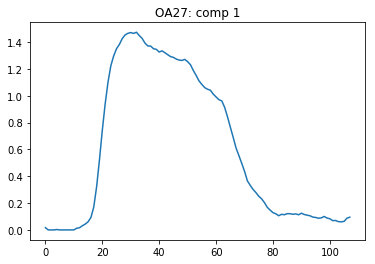

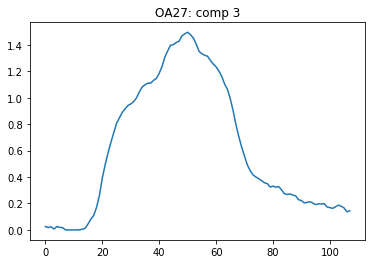

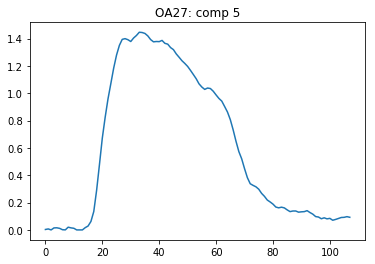

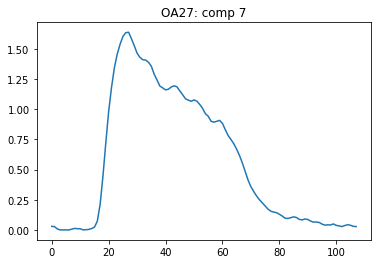

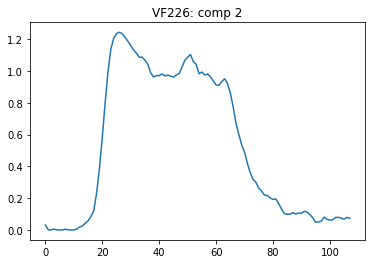

...

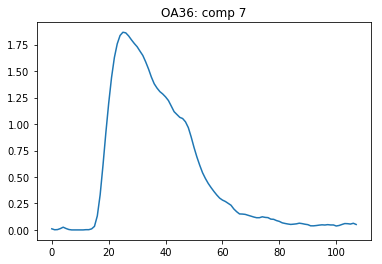

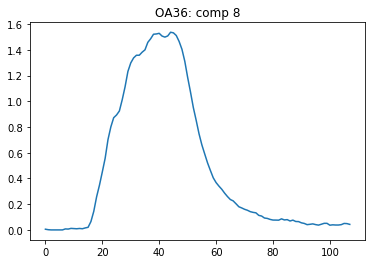

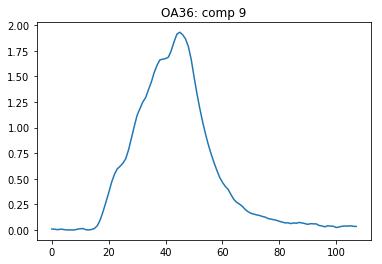

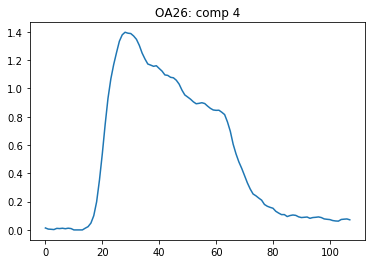

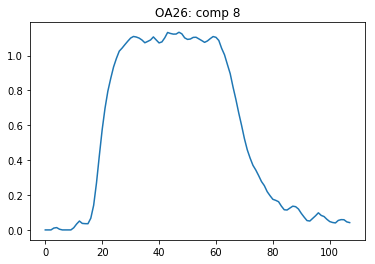

In [398]:
# get groups of cells from your components    
# build cell-weighted/-projected
thresh_list_control = []
cluster_bins_control = []
for c, V in enumerate(subset_model_list):
    
    print('Started: mouse {}.'.format(c+1))
    
    # TCA model
    Vm = model_list[c]
    
    # mouse name
    mi = mice[c]
    
    # check group shape, if offset is closer to stim than baseline throw it out
    secsec = np.mean(Vm.results[rank][0].factors[1][32:48, :], axis=0)
    lastsec = np.mean(Vm.results[rank][0].factors[1][-32:, :], axis=0)
    diffsec = np.round(lastsec/secsec) < 1
    
    # get indices for stimulus period
    tstart = int(np.floor(15.5))
    tend = int(np.floor(15.5*1.5))
    if mi in ['OA32', 'OA34', 'OA36']:
        send = int(np.floor(15.5*3))
    else:
        send = int(np.floor(15.5*4))
    sstart = int(np.floor(send-15.5/2))
    
    # get threhsold of cell weights and get clusters
    thresh = np.std(V)*1
    sorted_cells = _sortcellfactors(V)
    weights = deepcopy(sorted_cells[0])
    clusters = np.array(np.argmax(weights, axis=1), dtype='float')
    
    # if you have no weights in any component set to nan
    no_weights_bool = np.nansum(weights, axis=1) == 0
    clusters[no_weights_bool] = np.nan
    
    total_clus_per_cell_above_thresh = np.sum(weights[:, :] > thresh, axis=1)
    
    cell_bool_sloppy = (weights[:,i] < -1000)
    cell_bool_outside = (weights[:,i] < -1000)
    cell_bool = (weights[:,i] < -1000) # set to all false
    offset_bool_sloppy = (weights[:,i] < -1000)
    offset_bool_outside = (weights[:,i] < -1000)
    offset_bool = (weights[:,i] < -1000) # set to all false
    for i in range(V.shape[1]):
        
        # check that temporal factor shape
        assert words[0] in 'rebel' # word must be rebel for this temporal fac check to work!
        if not diffsec[i]:
            offset_bool = offset_bool | ((weights[:,i] > thresh) & np.isin(clusters, i))
            offset_bool_sloppy = offset_bool_sloppy | (weights[:,i] > thresh)
            offset_bool_outside = offset_bool_outside | ((weights[:,i] > thresh) & ~np.isin(clusters, i))
            continue
            
        # don't consider offset components
        temp_fac = Vm.results[rank][0].factors[1][:, i]
#         if np.argmax(temp_fac) > send:
#             plt.figure()
#             plt.plot(temp_fac)
#             plt.title('{}: comp {}'.format(mi, i+1))
#             continue
        plt.figure()
        plt.plot(temp_fac)
        plt.title('{}: comp {}'.format(mi, i+1))
        # aggregate non offset cells  
        cell_bool = cell_bool | ((weights[:,i] > thresh) & np.isin(clusters, i))
#         print('        Added: {} cells'.format(np.sum((weights[:,i] > thresh) & np.isin(clusters, i))))
        cell_bool_sloppy = cell_bool_sloppy | (weights[:,i] > thresh)
        cell_bool_outside = cell_bool_outside | ((weights[:,i] > thresh) & ~np.isin(clusters, i))
    
    cell_clusters_control = {}
    print('    ALL CELLS: included {} cells'.format(len(cell_bool)))
    print('    INSIDE CLUSTER: included {} cells'.format(np.sum(cell_bool)))
    print('    SLOPPY: included {} cells'.format(np.sum(cell_bool_sloppy)))
    print('    OUTSIDE CLUSTER: included {} cells'.format(np.sum(cell_bool_outside)))
    print('    offset INSIDE CLUSTER: included {} cells'.format(np.sum(offset_bool)))
    print('    offset SLOPPY: included {} cells'.format(np.sum(offset_bool_sloppy)))
    print('    offset OUTSIDE CLUSTER: included {} cells'.format(np.sum(offset_bool_outside)))
    sorted_ten = subset_tensor_list[c][sorted_cells[1], :]
    cell_clusters_control['all_cells'] = sorted_ten[:,:,:]
    cell_clusters_control['inside'] = sorted_ten[cell_bool,:,:]
    cell_clusters_control['sloppy'] = sorted_ten[cell_bool_sloppy,:,:]
    cell_clusters_control['outside'] = sorted_ten[cell_bool_outside,:,:]
    cell_clusters_control['off_inside'] = sorted_ten[offset_bool,:,:]
    cell_clusters_control['off_sloppy'] = sorted_ten[offset_bool_sloppy,:,:]
    cell_clusters_control['off_outside'] = sorted_ten[offset_bool_outside,:,:]
    thresh_list_control.append(cell_clusters_control)
    # just for sloppy right now
    cluster_bins_control.append(total_clus_per_cell_above_thresh[cell_bool_sloppy])
    print('Onward: Done mouse {}.\n'.format(c+1))

# fit transientness and sustainedness for your control groups, plot cluster number above threshold for each cell.

### trial drivenness

In [400]:
# Look at a bin over the first second and one over the remainder of the stim period.
# Since we will exclude offest responses ignore this time period for now.
times = np.arange(-1, 6, 1/15.5)[:-1]
baseboo = times < 0

simp_comp_proj_list = {}
# for thresh in [2, 5, 10, 15]:
#     simp_comp_proj_list[thresh] = {}
for mouse, proj, meti in zip(mice, thresh_list_control, meta_list):
    print('Started: {}.'.format(mouse))
    simp_comp_proj_list[mouse] = {}
    # get boolean for bins of stimulus period
    if mouse in ['OA32', 'OA34', 'OA36']:
        stim_total = 2
    else: 
        stim_total = 3
    onsetboo = (times > 0) & (times < 0.5)
    sustainboo = (times > 0.5) & (times < stim_total)

    comp_list = {}
    std_list, on_list, sus_list = [], [], []
    for k in proj:
        ons_resp = np.nanmean(proj[k][:, onsetboo, :], axis=1)
        sus_resp = np.nanmean(proj[k][:, sustainboo, :], axis=1)
#         base_mean = np.nanmean(proj[k][:, baseboo, :], axis=1)[:, None, :]
#         base_std = np.nanstd(base_mean, axis=2).flatten()[:, None]
#             base_std = np.ones(ons_resp.shape)*base_std*thresh
        base_std = np.nanstd(proj[k][:, baseboo, :])
#         base_std = 3
        comp_list[k] = ((ons_resp > base_std) | (sus_resp > base_std))

#     simp_comp_proj_list.append(comp_list)
    simp_comp_proj_list[mouse] = comp_list
    print('Making progress: {} done.\n'.format(mouse))
# simp_comp_proj_dict = {}
# for mi, pp in zip(mice, simp_comp_proj_list):
#     simp_comp_proj_dict[mi] = pp
# np.save('simo_proj_dict_rebel.npy', simp_comp_proj_dict)

Started: OA27.


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


Making progress: OA27 done.

Started: VF226.
Making progress: VF226 done.

Started: OA67.
Making progress: OA67 done.

Started: OA32.
Making progress: OA32 done.

Started: OA34.
Making progress: OA34 done.

Started: OA36.
Making progress: OA36 done.

Started: OA26.
Making progress: OA26 done.



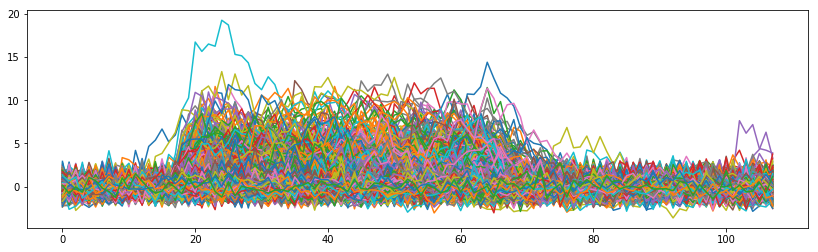

In [940]:
mo = 1
cell = 4
plt.figure(figsize=(14,4))
# sns.heatmap(thresh_list_control[mo]['sloppy'][cell, :, :])
plt.plot(thresh_list_control[mo]['sloppy'][cell, :, :])
# plt.plot(simp_comp_proj_list['VF226']['sloppy'][cell, :]*10)

0.027346883290566254

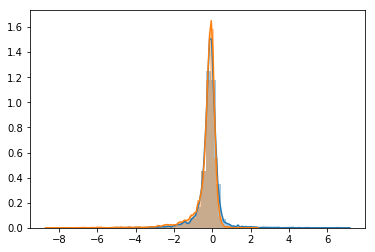

In [903]:
sns.distplot(ons_resp[0,:][~np.isnan(ons_resp[0,:])])
sns.distplot(sus_resp[0,:][~np.isnan(sus_resp[0,:])])
base_std[0,0]

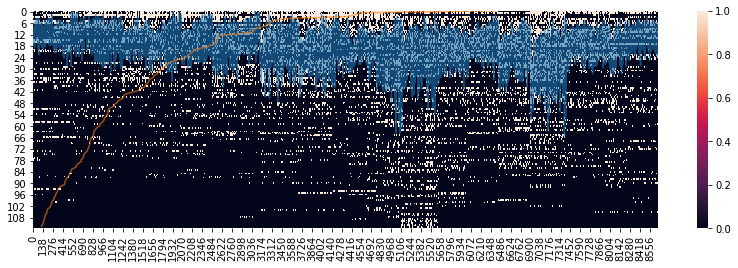

In [94]:
mo = 'OA27'
plt.figure(figsize=(14, 4))
sorter = np.argsort(np.sum(simp_comp_proj_list[mo]['sloppy'],axis=1))[::-1]
sns.heatmap(simp_comp_proj_list[mo]['sloppy'][sorter,:])
plt.plot(np.sum(simp_comp_proj_list[mo]['sloppy'],axis=0), alpha=0.6)
plt.plot(np.sum(simp_comp_proj_list[mo]['sloppy'][sorter,:],axis=1), np.arange((simp_comp_proj_list[mo]['sloppy'].shape[0])), alpha=0.6)

### NNLS fitting

In [95]:
fits_control = {}
daily_avg_dict_control = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list_control, meta_list):
    
    meti = _update_meta_date_vec(meti)
    meti = _update_meta_stages(meti)
    A = _get_fitting_template_defaults(mi)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['parsed_stage'].values
    u_days = meti.reset_index()['parsed_stage'].unique()
    firsty = _first100_wtrans_bool(meti)
    
    eng_boo = meti['hmm_engaged'].values
    
    daily_avg_dict_control[mi] = {}
    fits_control[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits_control[mi][comp_n] = {}
        daily_avg_dict_control[mi][comp_n] = {}
        for ori in oris:
            cell_mat = np.zeros((proj[comp_n].shape[0], proj[comp_n].shape[1], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                for c_n in range(cell_mat.shape[0]):
                    driven_boo = simp_comp_proj_list[mi][comp_n][c_n, :] > 0
                    if np.sum(driven_boo & day_ori_bool) > 0:
                        cell_mat[c_n, :, dc] = np.nanmean(proj[comp_n][c_n, :, driven_boo & day_ori_bool & eng_boo], axis=0)
            all_tr = np.zeros((proj[comp_n].shape[0], A.shape[1], len(u_days)))
            for tr_n in range(cell_mat.shape[2]):
                for c_n in range(cell_mat.shape[0]):
                    b = deepcopy(cell_mat[c_n, :, tr_n])
                    b[b < 0] = 0
                    if np.sum(np.isnan(b)) == len(b):
                        sp_ans = np.zeros(4)
                        sp_ans[:] = np.nan
                        sp_ans = sp_ans
                    else:
                        sp_ans = sp.optimize.nnls(A, b)[0]
                    all_tr[c_n, :, tr_n] = sp_ans
            fits_control[mi][comp_n]['ori_{}'.format(ori)] = all_tr
            fits_control[mi][comp_n]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict_control[mi][comp_n]['ori_{}'.format(ori)] = cell_mat

    print('Making progress: {} done.'.format(mi))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning: Mean of empty slice


Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


### NNLS fitting with evenly spaced gaussians

[-1  0  1  2  3  4  5  6]
[ 0.  15.5 31.  46.5 62.  77.5 93. ]


([<matplotlib.axis.XTick at 0xb28a56e940>,
 <a list of 7 Text xticklabel objects>)

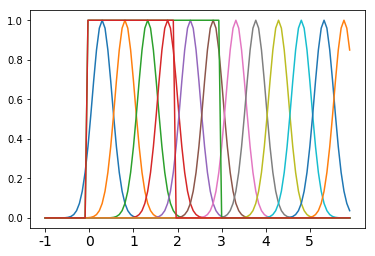

In [97]:
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)
print(times)
print(timepts)

A = _get_fitting_template_new(sigma=3.5, lag=5)
plt.plot(A)
short = np.zeros((108))
long = np.zeros((108))
short[15:int(np.floor(15.5*3))] = 1
long[15:int(np.floor(15.5*4))] = 1
plt.plot(long)
plt.plot(short)
plt.xticks(timepts, labels=times, size=14)

In [102]:
all_tr.shape
sp_ans.shape
sp_ans

array([nan, nan, nan, nan])

In [103]:
fits_control_g = {}
daily_avg_dict_control_g = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list_control, meta_list):
    
    meti = _update_meta_date_vec(meti)
    meti = _update_meta_stages(meti)
    A = _get_fitting_template_new(lag=5, sigma=3.5)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['parsed_stage'].values
    u_days = meti.reset_index()['parsed_stage'].unique()
    firsty = _first100_wtrans_bool(meti)
    
    eng_boo = meti['hmm_engaged'].values
    
    daily_avg_dict_control_g[mi] = {}
    fits_control_g[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits_control_g[mi][comp_n] = {}
        daily_avg_dict_control_g[mi][comp_n] = {}
        for ori in oris:
            cell_mat = np.zeros((proj[comp_n].shape[0], proj[comp_n].shape[1], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                for c_n in range(cell_mat.shape[0]):
                    driven_boo = simp_comp_proj_list[mi][comp_n][c_n, :] > 0
                    if np.sum(driven_boo & day_ori_bool) > 0:
                        cell_mat[c_n, :, dc] = np.nanmean(proj[comp_n][c_n, :, driven_boo & day_ori_bool & eng_boo], axis=0)
            all_tr = np.zeros((proj[comp_n].shape[0], A.shape[1], len(u_days)))
            for tr_n in range(cell_mat.shape[2]):
                for c_n in range(cell_mat.shape[0]):
                    b = deepcopy(cell_mat[c_n, :, tr_n])
                    b[b < 0] = 0
                    if np.sum(np.isnan(b)) == len(b):
                        sp_ans = np.zeros(A.shape[1])
                        sp_ans[:] = np.nan
                        sp_ans = sp_ans
                    else:
                        sp_ans = sp.optimize.nnls(A, b)[0]
                    all_tr[c_n, :, tr_n] = sp_ans
            fits_control_g[mi][comp_n]['ori_{}'.format(ori)] = all_tr
            fits_control_g[mi][comp_n]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict_control_g[mi][comp_n]['ori_{}'.format(ori)] = cell_mat

    print('Making progress: {} done.'.format(mi))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning: Mean of empty slice


Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


### NNLS fitting with log spaced gaussians

[-1  0  1  2  3  4  5  6]
[ 0.  15.5 31.  46.5 62.  77.5 93. ]


([<matplotlib.axis.XTick at 0xc6a92f8f28>,
 <a list of 7 Text xticklabel objects>)

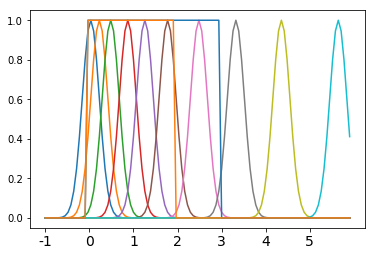

In [527]:
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)
print(times)
print(timepts)

A = _get_fitting_template_log(sigma=3, lag=0)
plt.plot(A)
short = np.zeros((108))
long = np.zeros((108))
short[15:int(np.floor(15.5*3))] = 1
long[15:int(np.floor(15.5*4))] = 1
plt.plot(long)
plt.plot(short)
plt.xticks(timepts, labels=times, size=14)

In [535]:
fits_control_log = {}
daily_avg_dict_control_log = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list_control, meta_list):
    
    meti = _update_meta_date_vec(meti)
    meti = _update_meta_stages(meti)
    A = _get_fitting_template_log(sigma=3)
    A = _get_fitting_template_log(sigma=4, shift=2)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['parsed_stage'].values
    u_days = meti.reset_index()['parsed_stage'].unique()
    firsty = _first100_wtrans_bool(meti)
    
    daily_avg_dict_control_log[mi] = {}
    fits_control_log[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits_control_log[mi][comp_n] = {}
        daily_avg_dict_control_log[mi][comp_n] = {}
        for ori in oris:
            cell_mat = np.zeros((proj[comp_n].shape[0], proj[comp_n].shape[1], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                for c_n in range(cell_mat.shape[0]):
                    driven_boo = simp_comp_proj_list[mi][comp_n][c_n, :] > 0
                    if np.sum(driven_boo & day_ori_bool) > 0:
                        cell_mat[c_n, :, dc] = np.nanmean(proj[comp_n][c_n, :, driven_boo & day_ori_bool], axis=0)
            all_tr = np.zeros((proj[comp_n].shape[0], A.shape[1], len(u_days)))
            for tr_n in range(cell_mat.shape[2]):
                for c_n in range(cell_mat.shape[0]):
                    b = deepcopy(cell_mat[c_n, :, tr_n])
                    b[b < 0] = 0
                    if np.sum(np.isnan(b)) == len(b):
                        sp_ans = np.zeros(A.shape[1])
                        sp_ans[:] = np.nan
                        sp_ans = sp_ans
                    else:
                        sp_ans = sp.optimize.nnls(A, b)[0]
                    all_tr[c_n, :, tr_n] = sp_ans
            fits_control_log[mi][comp_n]['ori_{}'.format(ori)] = all_tr
            fits_control_log[mi][comp_n]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict_control_log[mi][comp_n]['ori_{}'.format(ori)] = cell_mat

    print('Making progress: {} done.'.format(mi))

Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


0.7495385207610281

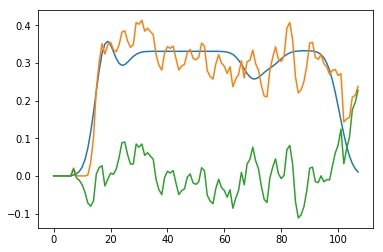

In [371]:
plt.plot(A@sp_ans[:, None])
plt.plot(b)
plt.plot(b-recon)
recon = A@sp_ans[:, None].flatten()
1 - np.var(b-recon)/np.var(b)


### NNLS fitting with better simple spacing

[-1  0  1  2  3  4  5  6]
[ 0.  15.5 31.  46.5 62.  77.5 93. ]


([<matplotlib.axis.XTick at 0xb28c54c9b0>,
 <a list of 7 Text xticklabel objects>)

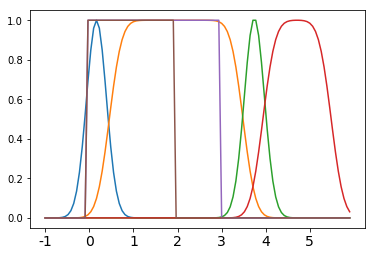

In [104]:
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)
print(times)
print(timepts)

A = _get_fitting_template_noverlap('OA27')
plt.plot(A)
short = np.zeros((108))
long = np.zeros((108))
short[15:int(np.floor(15.5*3))] = 1
long[15:int(np.floor(15.5*4))] = 1
plt.plot(long)
plt.plot(short)
plt.xticks(timepts, labels=times, size=14)

In [584]:
fits_control_nover = {}
fits_control_nover_varex = {}
daily_avg_dict_control_nover = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list_control, meta_list):
    
    meti = _update_meta_date_vec(meti)
    meti = _update_meta_stages(meti)
    A = _get_fitting_template_noverlap(mi)
#     A = _get_fitting_template_log(sigma=4, shift=2)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['parsed_stage'].values
    u_days = meti.reset_index()['parsed_stage'].unique()
    firsty = _first100_wtrans_bool(meti)
    
    eng_boo = meti['hmm_engaged'].values | meti['learning_state'].isin(['naive']).values
    
    daily_avg_dict_control_nover[mi] = {}
    fits_control_nover[mi] = {}
    fits_control_nover_varex[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits_control_nover[mi][comp_n] = {}
        fits_control_nover_varex[mi][comp_n] = {}
        daily_avg_dict_control_nover[mi][comp_n] = {}
        for ori in oris:
            cell_mat = np.zeros((proj[comp_n].shape[0], proj[comp_n].shape[1], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                for c_n in range(cell_mat.shape[0]):
                    driven_boo = simp_comp_proj_list[mi][comp_n][c_n, :] > 0
                    if np.sum(driven_boo & day_ori_bool) > 0:
                        cell_mat[c_n, :, dc] = np.nanmean(proj[comp_n][c_n, :, driven_boo & day_ori_bool & eng_boo], axis=0)
            all_tr = np.zeros((proj[comp_n].shape[0], A.shape[1], len(u_days)))
            all_varex = np.zeros((proj[comp_n].shape[0], 1, len(u_days)))
            for tr_n in range(cell_mat.shape[2]):
                for c_n in range(cell_mat.shape[0]):
                    b = deepcopy(cell_mat[c_n, :, tr_n])
                    b[b < 0] = 0
                    if np.sum(np.isnan(b)) == len(b):
                        sp_ans = np.zeros(A.shape[1])
                        sp_ans[:] = np.nan
                        sp_ans = sp_ans
                        varex = np.nan
                    else:
                        sp_ans = sp.optimize.nnls(A, b)[0]
                        recon = A@sp_ans[:, None].flatten()
                        varex = 1 - np.var(b-recon)/np.var(b)
                    all_tr[c_n, :, tr_n] = sp_ans
                    all_varex[c_n, :, tr_n] = varex
                    
            fits_control_nover_varex[mi][comp_n]['ori_{}'.format(ori)] = all_varex
            fits_control_nover[mi][comp_n]['ori_{}'.format(ori)] = all_tr
            fits_control_nover[mi][comp_n]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict_control_nover[mi][comp_n]['ori_{}'.format(ori)] = cell_mat

    print('Making progress: {} done.'.format(mi))

Making progress: OA27 done.
Making progress: VF226 done.


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: Mean of empty slice


Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


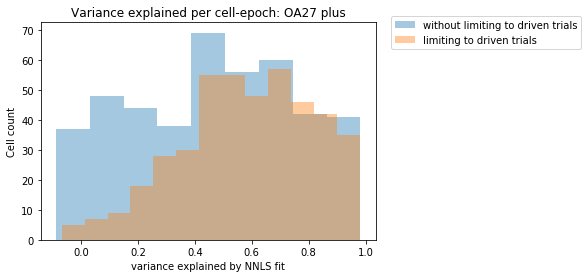

In [390]:
# sns.heatmap(fits_control_nover_varex['OA27']['sloppy']['ori_{}'.format(270)].squeeze())
vec = deepcopy(fits_control_nover_varex['OA27']['sloppy']['ori_{}'.format(270)].squeeze().flatten())
vec = vec[np.isfinite(vec)]
sns.distplot(vec, kde=False, label='without limiting to driven trials')
sns.distplot(vec1, kde=False, label='limiting to driven trials')
plt.title('Variance explained per cell-epoch: OA27 plus')
plt.ylabel('Cell count')
plt.xlabel('variance explained by NNLS fit')
plt.legend(bbox_to_anchor=(1.03, 1.05), loc='upper left')

lookup[mi][oi]
vec = deepcopy(fits_control_nover_varex['OA27']['sloppy']['ori_{}'.format(270)].squeeze().flatten())
vec = vec[np.isfinite(vec)]
sns.distplot(vec, kde=False, label='without limiting to driven trials')
sns.distplot(vec1, kde=False, label='limiting to driven trials')
plt.title('Variance explained per cell-epoch: OA27 plus')
plt.ylabel('Cell count')
plt.xlabel('variance explained by NNLS fit')
plt.legend(bbox_to_anchor=(1.03, 1.05), loc='upper left')

In [384]:
vec1 = deepcopy(vec)

## NNLS fitting replaced with simple bias index

In [585]:
fits_control_bias = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list_control, meta_list):
    
    fits_control_bias[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits_control_bias[mi][comp_n] = {}
        
        # get your denominator per filter
        denom = deepcopy(fits_control_nover[mi][comp_n]['ori_{}'.format(oris[0])])
        for ori in oris[1:]:
            denom += fits_control_nover[mi][comp_n]['ori_{}'.format(ori)]
            
        for ori in oris:
            all_tr = fits_control_nover[mi][comp_n]['ori_{}'.format(ori)]
            fits_control_bias[mi][comp_n]['ori_{}'.format(ori)] = all_tr/denom

    print('Making progress: {} done.'.format(mi))

Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


## NNLS fitting replaced with simple ramp index

In [ ]:
times = np.arange(-1, 6, 1/15.5)[:108]
times

In [407]:
fits_control_ramp = {}
daily_avg_dict_control_ramp = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list_control, meta_list):
    
    meti = _update_meta_date_vec(meti)
    meti = _update_meta_stages(meti)
#     A = _get_fitting_template_noverlap(mi)
#     A = _get_fitting_template_log(sigma=4, shift=2)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['parsed_stage'].values
    u_days = meti.reset_index()['parsed_stage'].unique()
    firsty = _first100_wtrans_bool(meti)
    times = np.arange(-1, 6, 1/15.5)[:108]
    early_boo = (times > 0) & (times < 1)
    if mi in ['OA32', 'OA34', 'OA36']:
        late_boo = (times > 1.5) & (times < 2)
    else:
        late_boo = (times > 2.5) & (times < 3)
    
    
    eng_boo = meti['hmm_engaged'].values | meti['learning_state'].isin(['naive']).values
    
    daily_avg_dict_control_ramp[mi] = {}
    fits_control_ramp[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits_control_ramp[mi][comp_n] = {}
        daily_avg_dict_control_ramp[mi][comp_n] = {}
        for ori in oris:
            cell_mat = np.zeros((proj[comp_n].shape[0], proj[comp_n].shape[1], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                for c_n in range(cell_mat.shape[0]):
                    driven_boo = simp_comp_proj_list[mi][comp_n][c_n, :] > 0
                    if np.sum(driven_boo & day_ori_bool) > 0:
                        cell_mat[c_n, :, dc] = np.nanmean(proj[comp_n][c_n, :, driven_boo & day_ori_bool & eng_boo], axis=0)
            all_tr = np.zeros((proj[comp_n].shape[0], 1, len(u_days)))
            for tr_n in range(cell_mat.shape[2]):
                for c_n in range(cell_mat.shape[0]):
                    b = deepcopy(cell_mat[c_n, :, tr_n])
                    b[b < 0] = 0
                    if np.sum(np.isnan(b)) == len(b):
                        sp_ans = np.zeros(1)
                        sp_ans[:] = np.nan
                        sp_ans = sp_ans
                    else:
                        sp_ans = np.log2(np.nanmean(b[late_boo])/np.nanmean(b[early_boo]))
                    all_tr[c_n, :, tr_n] = sp_ans
            fits_control_ramp[mi][comp_n]['ori_{}'.format(ori)] = all_tr
            fits_control_ramp[mi][comp_n]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict_control_ramp[mi][comp_n]['ori_{}'.format(ori)] = cell_mat

    print('Making progress: {} done.'.format(mi))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:49: RuntimeWarning: divide by zero encountered in log2
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:49: RuntimeWarning: divide by zero encountered in double_scalars


Making progress: OA27 done.
Making progress: VF226 done.


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:38: RuntimeWarning: Mean of empty slice


Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


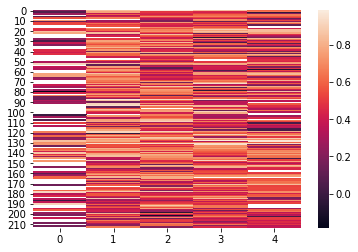

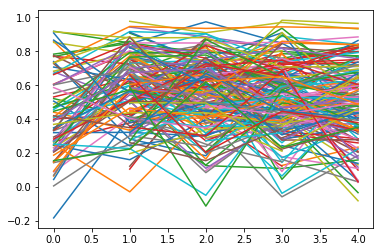

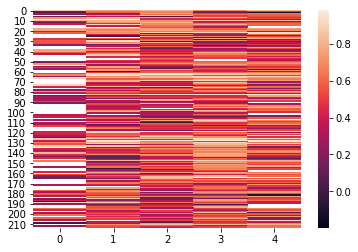

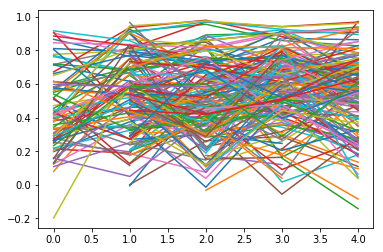

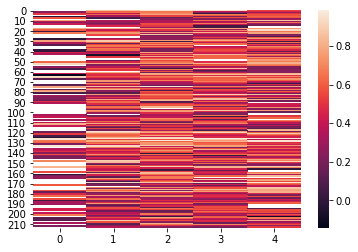

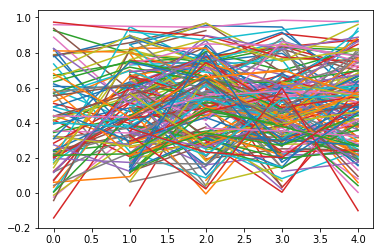

In [419]:
mo = 'OA27'
comp_n = 'all_cells'
ori_stage_list = []
for oi in ['plus', 'minus', 'neutral']:
    alta = fits_control_nover_varex[mi][comp_n]['ori_{}'.format(lookup[mi][oi])]
    ori_stage_list.append(alta.squeeze()[:, :, None])
    plt.figure()
    sns.heatmap(alta.squeeze())
    plt.figure()
    plt.plot(alta.squeeze().T)
all_oris = np.concatenate(ori_stage_list, axis=2)
arg_max_p = np.nanmax(all_oris, axis=2)

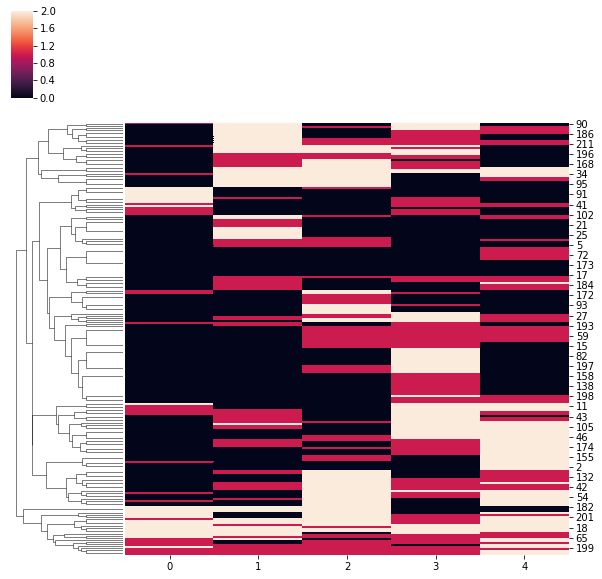

In [426]:
arg_max_p = np.argmax(all_oris, axis=2)
# plt.figure(figsize=(14, 5))
# sns.heatmap(arg_max_p)
sns.clustermap(arg_max_p, col_cluster=False)

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: All-NaN slice encountered
  """Entry point for launching an IPython kernel.


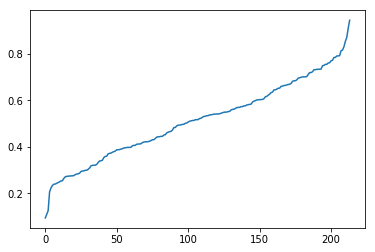

In [442]:
max_p = np.nanmin(np.nanmax(all_oris, axis=2), axis=1)
plt.plot(np.sort(max_p))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: All-NaN slice encountered
  """Entry point for launching an IPython kernel.


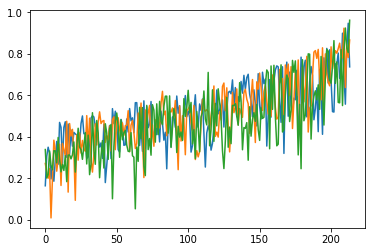

In [437]:
max_p = np.nanmax(all_oris, axis=2)
sort_p = fits_control_nover_varex[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])]
mean_alta = np.nanmean(max_p.squeeze(), axis=1)
sort_alta = np.argsort(mean_alta)
for oi in ['plus', 'minus', 'neutral']:
    alta = fits_control_nover_varex[mi][comp_n]['ori_{}'.format(lookup[mi][oi])]
#     sorter = np.argsort(sort_p.squeeze()[:, 2])
#     plt.figure(figsize=(10, 10))
    mean_alta = np.nanmean(alta.squeeze(), axis=1)
#     sort_alta = np.argsort(mean_alta)
    plt.plot(mean_alta[sort_alta])
#     sns.heatmap((alta.squeeze())[sorter,:])

# plotting

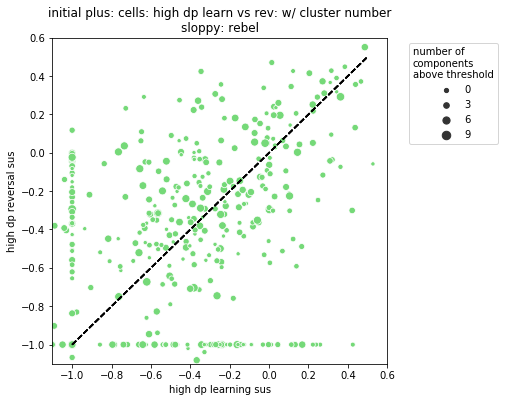

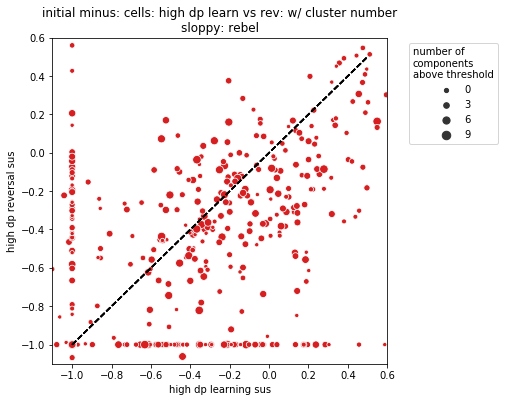

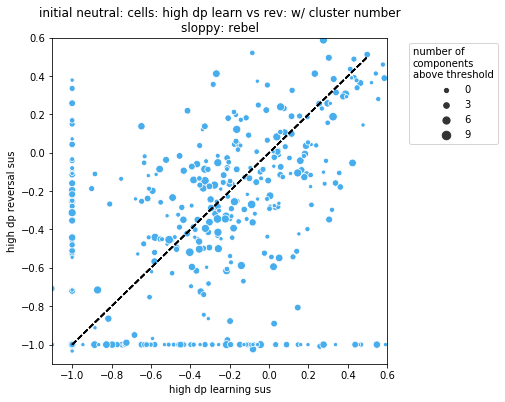

In [992]:
comp_n = 'sloppy'

# plt.figure(figsize=(8,8))
for oi in ['plus', 'minus', 'neutral']:
    done = False
    f, ax = plt.subplots(figsize=(6, 6))
#     ax.set(xscale="log", yscale="log")
    for c, mi in enumerate(mice):
        if mi in ['OA36']:
            continue
        if mi in ['OA32', 'OA34', 'OA36']:
            high_dp_ind = 1
            high_dp_rev = 3
        else:
            high_dp_ind = 2
            high_dp_rev = 4
        trans_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
        trans_betas[trans_betas == 0] = 0.1
        trans_betas = np.log10(trans_betas)
        sus_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :])
        sus_betas[sus_betas == 0] = 0.1
        sus_betas = np.log10(sus_betas)
        
        if done == False:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c], ax=ax)
            done = True
        else:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c], legend=False)
        plt.plot([-1, 0.5], [-1, 0.5], 'k--')
        plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
        plt.xlabel('high dp learning sus')
        plt.ylabel('high dp reversal sus')
        plt.ylim([-1.1, 0.6])
        plt.xlim([-1.1, 0.6])
        plt.title('initial {}: cells: high dp learn vs rev: w/ cluster number\n{}: {}'.format(oi, comp_n, words[0]))
#         plt.savefig('allmice_log_initial_{}_sus_scatter_comp_{}_{}_high_dp_learn_v_rev.pdf'.format(oi, comp_n, words[0]), bbox_inches='tight')

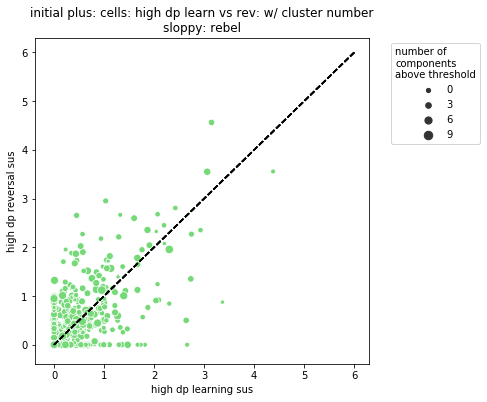

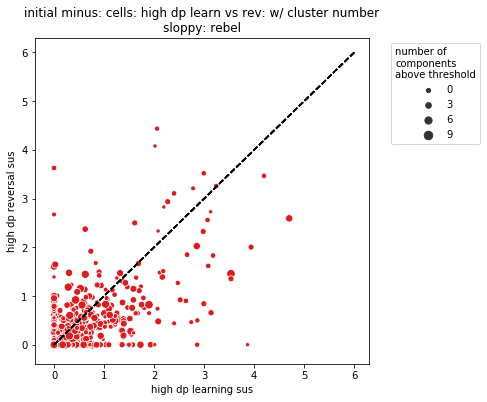

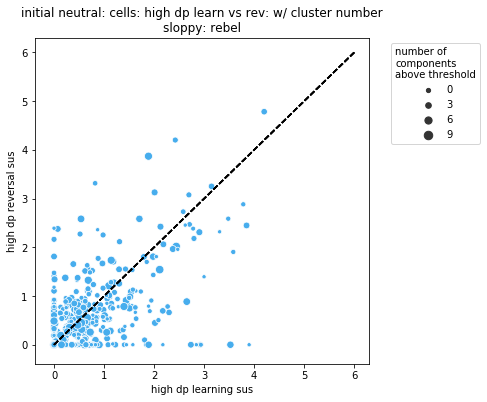

In [293]:
comp_n = 'sloppy'

# plt.figure(figsize=(8,8))
for oi in ['plus', 'minus', 'neutral']:
    done = False
    plt.figure(figsize=(6,6))
    for c, mi in enumerate(mice):
        if mi in ['OA36']:
            continue
        if mi in ['OA32', 'OA34', 'OA36']:
            high_dp_ind = 1
            high_dp_rev = 3
        else:
            high_dp_ind = 2
            high_dp_rev = 4
        trans_betas = fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :]
        sus_betas = fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :]
        
        if done == False:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c])
            done = True
        else:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c], legend=False)
        plt.plot([0, 6], [0, 6], 'k--')
        plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
        plt.xlabel('high dp learning sus')
        plt.ylabel('high dp reversal sus')
        plt.title('initial {}: cells: high dp learn vs rev: w/ cluster number\n{}: {}'.format(oi, comp_n, words[0]))
        plt.savefig('allmice_initial_{}_sus_scatter_comp_{}_{}_high_dp_learn_v_rev.pdf'.format(oi, comp_n, words[0]), bbox_inches='tight')

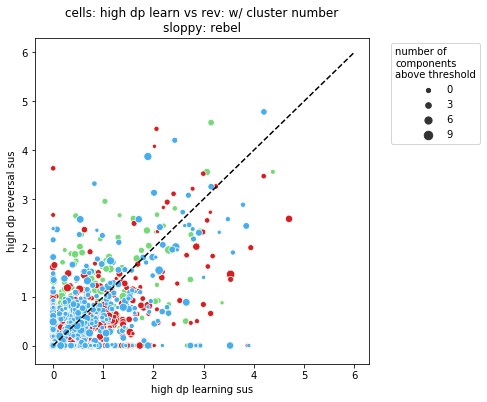

In [976]:
comp_n = 'sloppy'

plt.figure(figsize=(6,6))
done = False
for oi in ['plus', 'minus', 'neutral']:
#     done = False
#     plt.figure(figsize=(6,6))
    for c, mi in enumerate(mice):
        if mi in ['OA36']:
            continue
        if mi in ['OA32', 'OA34', 'OA36']:
            high_dp_ind = 1
            high_dp_rev = 3
        else:
            high_dp_ind = 2
            high_dp_rev = 4
        trans_betas = fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :]
        sus_betas = fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :]
        
        if done == False:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c])
            done = True
        else:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c], legend=False)
plt.plot([0, 6], [0, 6], 'k--')
plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('high dp learning sus')
plt.ylabel('high dp reversal sus')
plt.title('cells: high dp learn vs rev: w/ cluster number\n{}: {}'.format(comp_n, words[0]))
plt.savefig('allmice_sus_scatter_comp_{}_{}_high_dp_learn_v_rev.pdf'.format(comp_n, words[0]), bbox_inches='tight')

# a/(a+b)

In [33]:
b = np.ones((108))
# b[15:30] = 1
sp_ans = sp.optimize.nnls(A, b)[0]
sp_ans

array([0.19539896, 0.97735298, 0.        , 1.01266982])

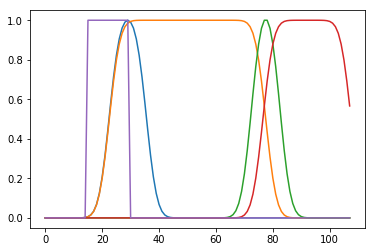

In [32]:
plt.plot(A)
plt.plot(b)

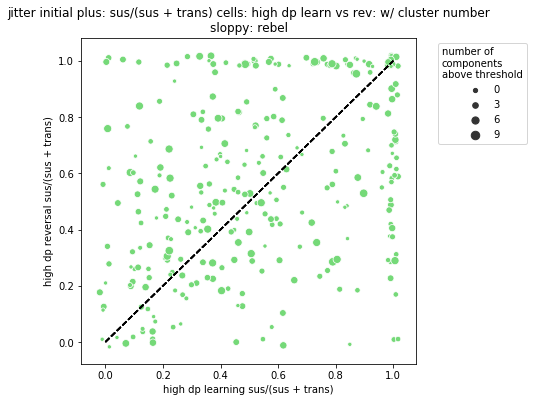

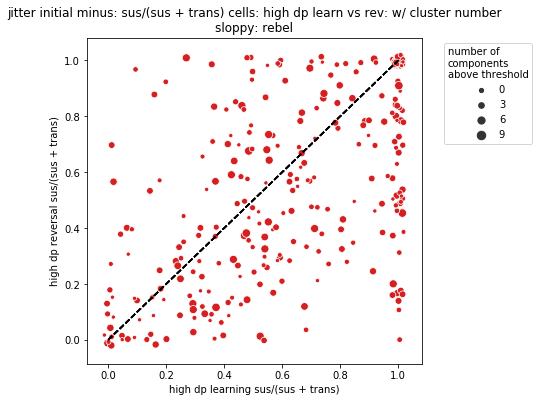

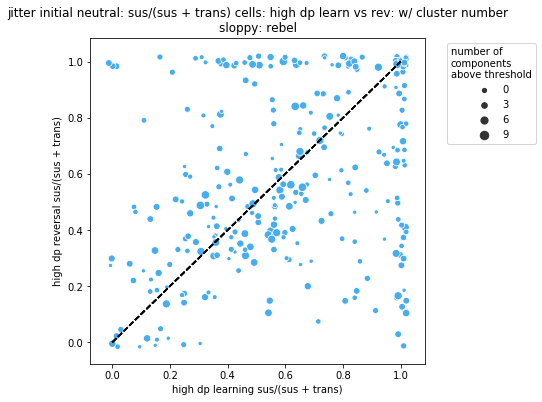

In [296]:
comp_n = 'sloppy'

# plt.figure(figsize=(8,8))
for oi in ['plus', 'minus', 'neutral']:
    done = False
    plt.figure(figsize=(6,6))
    for c, mi in enumerate(mice):
        if mi in ['OA36']:
            continue
        if mi in ['OA32', 'OA34', 'OA36']:
            high_dp_ind = 1
            high_dp_rev = 3
        else:
            high_dp_ind = 2
            high_dp_rev = 4
        trans_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
        sus_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :])
        
        sus_betas = sus_betas/(trans_betas + sus_betas)
        jitter_mat = (np.random.rand(sus_betas.shape[0], sus_betas.shape[1]) - 0.5)/25
        sus_betas += jitter_mat
        
        if done == False:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c])
            done = True
        else:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c], legend=False)
        plt.plot([0, 1], [0, 1], 'k--')
        plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
        plt.xlabel('high dp learning sus/(sus + trans)')
        plt.ylabel('high dp reversal sus/(sus + trans)')
        plt.title('jitter initial {}: sus/(sus + trans) cells: high dp learn vs rev: w/ cluster number\n{}: {}'.format(oi, comp_n, words[0]))
#         plt.savefig('allmice_initial_{}_sus_jitter_aab_scatter_comp_{}_{}_high_dp_learn_v_rev.pdf'.format(oi, comp_n, words[0]), bbox_inches='tight')

## a/(a+b) with evenly spaced gaussians

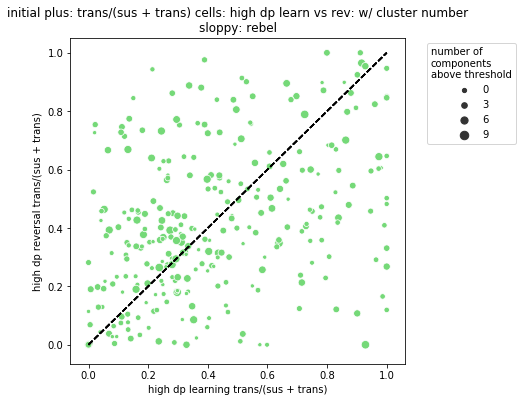

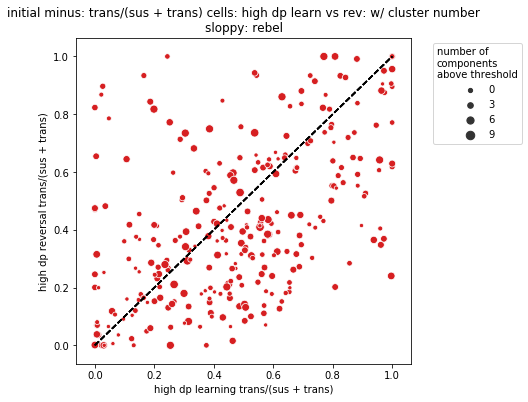

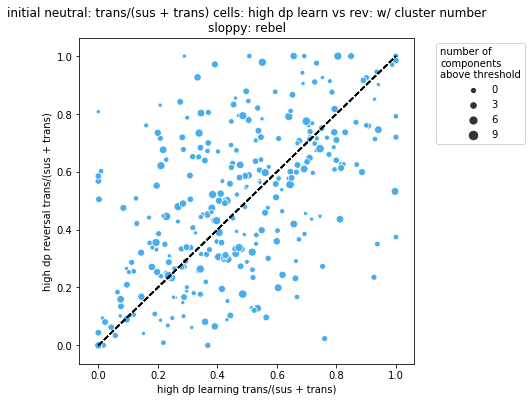

In [299]:
comp_n = 'sloppy'

# plt.figure(figsize=(8,8))
for oi in ['plus', 'minus', 'neutral']:
    done = False
    plt.figure(figsize=(6,6))
    for c, mi in enumerate(mice):
        if mi in ['OA36']:
            continue
        if mi in ['OA32', 'OA34', 'OA36']:
            high_dp_ind = 1
            high_dp_rev = 3
            sus_filt_n = 3
        else:
            high_dp_ind = 2
            high_dp_rev = 4
            sus_filt_n = 5
        trans_betas = deepcopy(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
        sus_betas = deepcopy(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 2:sus_filt_n, :], axis=1))
        
        sus_betas = sus_betas/(trans_betas + sus_betas)
#         jitter_mat = (np.random.rand(sus_betas.shape[0], sus_betas.shape[1]) - 0.5)/25
#         sus_betas += jitter_mat
        
        if done == False:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c])
            done = True
        else:
            sns.scatterplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], color=color_dict[oi],
                        size=cluster_bins_control[c], legend=False)
        plt.plot([0, 1], [0, 1], 'k--')
        plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
        plt.xlabel('high dp learning trans/(sus + trans)')
        plt.ylabel('high dp reversal trans/(sus + trans)')
        plt.title('initial {}: trans/(sus + trans) cells: high dp learn vs rev: w/ cluster number\n{}: {}'.format(oi, comp_n, words[0]))
#         plt.savefig('allmice_initial_{}_trans_aab_scatter_comp_{}_{}_high_dp_learn_v_rev.pdf'.format(oi, comp_n, words[0]), bbox_inches='tight')

In [ ]:
pa = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:sus_filt_n, :], axis=1), axis=1)
ma = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:sus_filt_n, :], axis=1), axis=1)
na = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:sus_filt_n, :], axis=1), axis=1)
pmn_mat = np.vstack([pa, ma, na])
pmn_text = ['plus', 'minus', 'neutral']
best_pmn = np.argmax(pmn_mat, axis=0)
driven_by = ['initial_{}'.format(pmn_text[s]) for s in best_pmn]

In [286]:
fits_control_ramp[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])].shape

(164, 1, 5)

In [657]:
fits_control[mi].keys()

dict_keys(['inside', 'sloppy', 'outside', 'off_inside', 'off_sloppy', 'off_outside'])

## grid plot

In [600]:
comp_n = 'all_cells'
cmap_lookup = {'plus': 'Greens', 'minus': 'Reds', 'neutral': 'Blues'}
col1 = 'high_dp learning'
col2 = 'low_dp reversal1'
jitter_please = False
which_fits = 'nover'
kill_zeros = True
use_varex= True
varex_thresh = 0.4
use_log10 = False

# plt.figure(figsize=(8,8))
all_ori_list = []
for oi in ['plus', 'minus', 'neutral']:
    done = False
    plt.figure(figsize=(6,6))
    df_list = []
    for c, mi in enumerate(mice):
        if mi in ['OA36']:
            continue
        if mi in ['OA32', 'OA34', 'OA36']:
            high_dp_ind = 1
            high_dp_rev = 3
            sus_filt_n = 3
            sus_filt_g = 5
            sus_filt_log = 5
            sus_cols = ['low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
        else:
            high_dp_ind = 2
            high_dp_rev = 4
            sus_filt_n = 5
            sus_filt_g = 7
            sus_filt_log = 6
            sus_cols = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
#         trans_betas = fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :]
        for wind in ['transient', 'sustained', 'sus_index', 'trans_index', 'vis_stimulus']:
            
            if which_fits == 'g':
                trans_betas = np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:1, :], axis=1)
#                 trans_betas = deepcopy(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                sus_betas = np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 2:sus_filt_g, :], axis=1)
                stim_betas = np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:sus_filt_g, :], axis=1)

                # get most driven ori across all stages of learning 
                pa = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:sus_filt_g, :], axis=1), axis=1)
                ma = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:sus_filt_g, :], axis=1), axis=1)
                na = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:sus_filt_g, :], axis=1), axis=1)
            elif which_fits == 'log':
                trans_betas = np.nanmean(fits_control_log[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:1, :], axis=1)
#                 trans_betas = deepcopy(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                sus_betas = np.nanmean(fits_control_log[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 2:sus_filt_log, :], axis=1)
                stim_betas = np.nanmean(fits_control_log[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:sus_filt_log, :], axis=1)

                # get most driven ori across all stages of learning 
                pa = np.nanmean(np.nanmean(fits_control_log[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:sus_filt_log, :], axis=1), axis=1)
                ma = np.nanmean(np.nanmean(fits_control_log[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:sus_filt_log, :], axis=1), axis=1)
                na = np.nanmean(np.nanmean(fits_control_log[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:sus_filt_log, :], axis=1), axis=1)
            elif which_fits == 'nover':
                trans_betas = deepcopy(fits_control_nover[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                sus_betas = deepcopy(fits_control_nover[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :])
                stim_betas = np.nanmean(fits_control_nover[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:1, :], axis=1)
                
                if use_varex:
                    ori_stage_list = []
                    for oik in ['plus', 'minus', 'neutral']:
                        alta = fits_control_nover_varex[mi][comp_n]['ori_{}'.format(lookup[mi][oik])]
                        ori_stage_list.append(alta.squeeze()[:,:,None])
                    all_oris = np.concatenate(ori_stage_list, axis=2)
                    max_p = np.nanmax(all_oris, axis=2)
#                     nama = fits_control_nover_varex[mi][comp_n]['ori_{}'.format(lookup[mi][oi])].squeeze()
                    nama = max_p
                    trans_betas[nama < varex_thresh] = np.nan
                    sus_betas[nama < varex_thresh] = np.nan
                    stim_betas[nama < varex_thresh] = np.nan
                    
                if use_log10:
                    trans_betas = np.log10(trans_betas)
                    sus_betas = np.log10(sus_betas)
                    stim_betas = np.log10(stim_betas)
                                                                
                # get most driven ori across all stages of learning 
                pa = np.nanmean(np.nanmean(fits_control_nover[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:1, :], axis=1), axis=1)
                ma = np.nanmean(np.nanmean(fits_control_nover[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:1, :], axis=1), axis=1)
                na = np.nanmean(np.nanmean(fits_control_nover[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:1, :], axis=1), axis=1)
            elif which_fits == 'bias':
                trans_betas = deepcopy(fits_control_bias[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                sus_betas = deepcopy(fits_control_bias[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :])
                stim_betas = np.nanmean(fits_control_bias[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:1, :], axis=1)
                
                if use_varex:
                    ori_stage_list = []
                    for oik in ['plus', 'minus', 'neutral']:
                        alta = fits_control_nover_varex[mi][comp_n]['ori_{}'.format(lookup[mi][oik])]
                        ori_stage_list.append(alta.squeeze()[:,:,None])
                    all_oris = np.concatenate(ori_stage_list, axis=2)
                    max_p = np.nanmax(all_oris, axis=2)
#                     nama = fits_control_nover_varex[mi][comp_n]['ori_{}'.format(lookup[mi][oi])].squeeze()
                    nama = max_p
                    trans_betas[nama < varex_thresh] = np.nan
                    sus_betas[nama < varex_thresh] = np.nan
                    stim_betas[nama < varex_thresh] = np.nan

                # get most driven ori across all stages of learning 
                pa = np.nanmean(np.nanmean(fits_control_bias[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:1, :], axis=1), axis=1)
                ma = np.nanmean(np.nanmean(fits_control_bias[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:1, :], axis=1), axis=1)
                na = np.nanmean(np.nanmean(fits_control_bias[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:1, :], axis=1), axis=1)
            elif which_fits == 'ramp':
                trans_betas = deepcopy(fits_control_ramp[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                sus_betas = deepcopy(fits_control_ramp[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                stim_betas = deepcopy(fits_control_ramp[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])

                # get most driven ori across all stages of learning 
                pa = np.nanmean(fits_control_ramp[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0, :], axis=1)
                ma = np.nanmean(fits_control_ramp[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0, :], axis=1)
                na = np.nanmean(fits_control_ramp[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0, :], axis=1)
            else:
                trans_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                sus_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :])
                stim_betas = np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:1, :], axis=1)

                # get most driven ori across all stages of learning 
                pa = np.nanmean(np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:1, :], axis=1), axis=1)
                ma = np.nanmean(np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:1, :], axis=1), axis=1)
                na = np.nanmean(np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:1, :], axis=1), axis=1)
                
            pmn_mat = np.vstack([pa, ma, na])
            pmn_text = ['plus', 'minus', 'neutral']
            best_pmn = np.argmax(pmn_mat, axis=0)
            driven_by = ['initial_{}'.format(pmn_text[s]) for s in best_pmn]
            
            if wind == 'transient':
                betas = trans_betas
            elif wind == 'sustained':
                betas = sus_betas
            elif wind == 'sus_index':
                betas = sus_betas/(trans_betas + sus_betas)
            elif wind == 'trans_index':
                betas = trans_betas/(trans_betas + sus_betas)
            elif wind == 'vis_stimulus':
                betas = stim_betas
            
            if kill_zeros:
                betas[betas == 0] = np.nan
                
            if jitter_please:
                jitter_mat = (np.random.rand(betas.shape[0], betas.shape[1]) - 0.5)/25
                betas += jitter_mat

            ori_sus_cols = ['initial_{} {}'.format(oi, s) for s in sus_cols]
            data_df = pd.DataFrame(betas, columns=sus_cols)
            data_df['mouse'] = [mi]*len(data_df)
            data_df['orientation'] = ['initial_{}'.format(oi)]*len(data_df)
            data_df['cell_number'] = np.arange(len(data_df))
            data_df['response_type'] = [wind]*len(data_df)
            data_df['driven_by'] = driven_by

            df_list.append(data_df)
    
    all_mouse_df = pd.concat(df_list, axis=0, sort=False)
    all_ori_list.append(all_mouse_df)

big_df = pd.concat(all_ori_list, axis=0)
# #         if done == False:
# #         sns.kdeplot(data=data_df, x='high_dp learning', y='high_dp reversal1', shade=True, shade_lowest=False, cmaps=cmap_lookup[oi])
#     sns.scatterplot(data=all_mouse_df, x=col1, y=col2, color=color_dict[oi])
# #                         size=cluster_bins_control[c])
# #     sns.kdeplot(all_mouse_df[col1], all_mouse_df[col2], shade=True, shade_lowest=False, cmap=cmap_lookup[oi])
# #             done = True
# #         else:
# #             sns.kdeplot(x=sus_betas[:, high_dp_ind], y=sus_betas[:, high_dp_rev], shade=True, shade_lowest=False, cmaps=cmap_lookup[oi])
#     plt.plot([0, 1], [0, 1], 'k--')
# #         plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
#     plt.xlabel('{} trans/(sus + trans)'.format(col1))
#     plt.ylabel('{} trans/(sus + trans)'.format(col2))
#     plt.title('initial {}: trans/(sus + trans) cells: {} vs {}\n{}: {}'.format(oi, col1, col2, comp_n, words[0]))
# #         plt.savefig('allmice_initial_{}_trans_aab_scatter_comp_{}_{}_high_dp_learn_v_rev.pdf'.format(oi, comp_n, words[0]), bbox_inches='tight')

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:69: RuntimeWarning: All-NaN slice encountered
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:61: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:82: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:83: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:84: RuntimeWarning: Mean of empty slice


<Figure size 432x432 with 0 Axes>

<Figure size 432x432 with 0 Axes>

<Figure size 432x432 with 0 Axes>

In [486]:
max_p

array([[0.86641558, 0.84501015, 0.97449162, 0.94520906, 0.82974668],
       [0.23935047, 0.76556784, 0.66863882, 0.45164801, 0.6401905 ],
       [       nan,        nan,        nan, 0.4264096 , 0.29562194],
       ...,
       [       nan, 0.69842863, 0.82315904, 0.81699668, 0.81242432],
       [0.23320264, 0.58280199, 0.62010119, 0.37865629, 0.6107381 ],
       [       nan, 0.66097762, 0.421823  , 0.51227657, 0.62959495]])

In [ ]:
col1 = 'high_dp learning'
col2 = 'naive'
response_type = 'transient'

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(14,4))
fig1, ax = plt.subplots(1, 3, figsize=(20, 6))

# plt.figure(figsize=(6,6))
for c, oi in enumerate(['plus', 'minus', 'neutral']):
    plt.figure(figsize=(6,6))
    driven_df = big_df.loc[big_df['driven_by'].isin(['initial_{}'.format(oi)]) & big_df['orientation'].isin(['initial_{}'.format(oi)])]
    resp_df = driven_df.loc[driven_df['response_type'].isin([response_type])]
    
    sns.scatterplot(data=resp_df, x=col1, y=col2, color=color_dict[oi], ax=ax[c])
    
    # add in cells that don't exist for a given colunn
    col1vec = resp_df[col1].values
    col2vec = resp_df[col2].values
    col1na = resp_df[col1].isna()
    col2na = resp_df[col2].isna()
    jitter_vec = (np.random.rand(resp_df.shape[0]) - 0.5)/25
    jitter_vec += 1.2
    
    sns.scatterplot(data=resp_df, x=col1vec[col2na], y=jitter_vec[col2na], color=color_dict['gray'], ax=ax[c])
    sns.scatterplot(data=resp_df, x=jitter_vec[col1na], y=col2vec[col1na], color=color_dict['gray'], ax=ax[c])
    
    if oi in ['plus']:
        sns.distplot(col1vec[col2na & ~col1na], 10, ax=ax1)
        sns.distplot(col2vec[col1na & ~col2na], 10, ax=ax1)
    elif oi in ['minus']:
        sns.distplot(col1vec[col2na & ~col1na], 10, ax=ax2)
        sns.distplot(col2vec[col1na & ~col2na], 10, ax=ax2)
    else:
        sns.distplot(col1vec[col2na & ~col1na], 10, ax=ax3)
        sns.distplot(col2vec[col1na & ~col2na], 10, ax=ax3)
        
    sns.regplot(data=resp_df, x=col1, y=col2, scatter=False, color=color_dict[oi], ax=ax[c])
    ax[c].plot([0, 1.2], [0, 1.2], 'k--')
#     plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
    ax[c].set_xlabel('{} {}'.format(col1, response_type))
    ax[c].set_ylabel('{} {}'.format(col2, response_type))
    ax[c].set_title('initial {}: {} cells: {} vs {}\n{}: {}: {} v1'.format(oi, response_type, col1, col2, comp_n, words[0], which_fits))
#     plt.savefig('initial_{}_{}_cells_{}_vs_{}_{}_{}_{}v1.pdf'.format(oi, response_type, col1, col2, comp_n, words[0], which_fits), bbox_inches='tight')

In [189]:
response_type = 'trans_index'
new_df_list = []
for c, oi in enumerate(['plus', 'minus', 'neutral']):
    plt.figure(figsize=(6,6))
    driven_df = big_df.loc[big_df['driven_by'].isin(['initial_{}'.format(oi)]) & big_df['orientation'].isin(['initial_{}'.format(oi)])]
    resp_df = driven_df.loc[driven_df['response_type'].isin([response_type])]
    new_df_list.append(resp_df)
grid_df = pd.concat(new_df_list, axis=0)

<Figure size 432x432 with 0 Axes>

<Figure size 432x432 with 0 Axes>

<Figure size 432x432 with 0 Axes>

In [487]:
driven_df.head()
# response_type

,naive,low_dp learning,high_dp learning,low_dp reversal1,high_dp reversal1,mouse,orientation,cell_number,response_type,driven_by


In [265]:
driven_df['response_type'].unique()

array(['transient', 'sustained', 'sus_index', 'trans_index',
       'vis_stimulus'], dtype=object)

<Figure size 432x432 with 0 Axes>

<Figure size 432x432 with 0 Axes>

<Figure size 432x432 with 0 Axes>

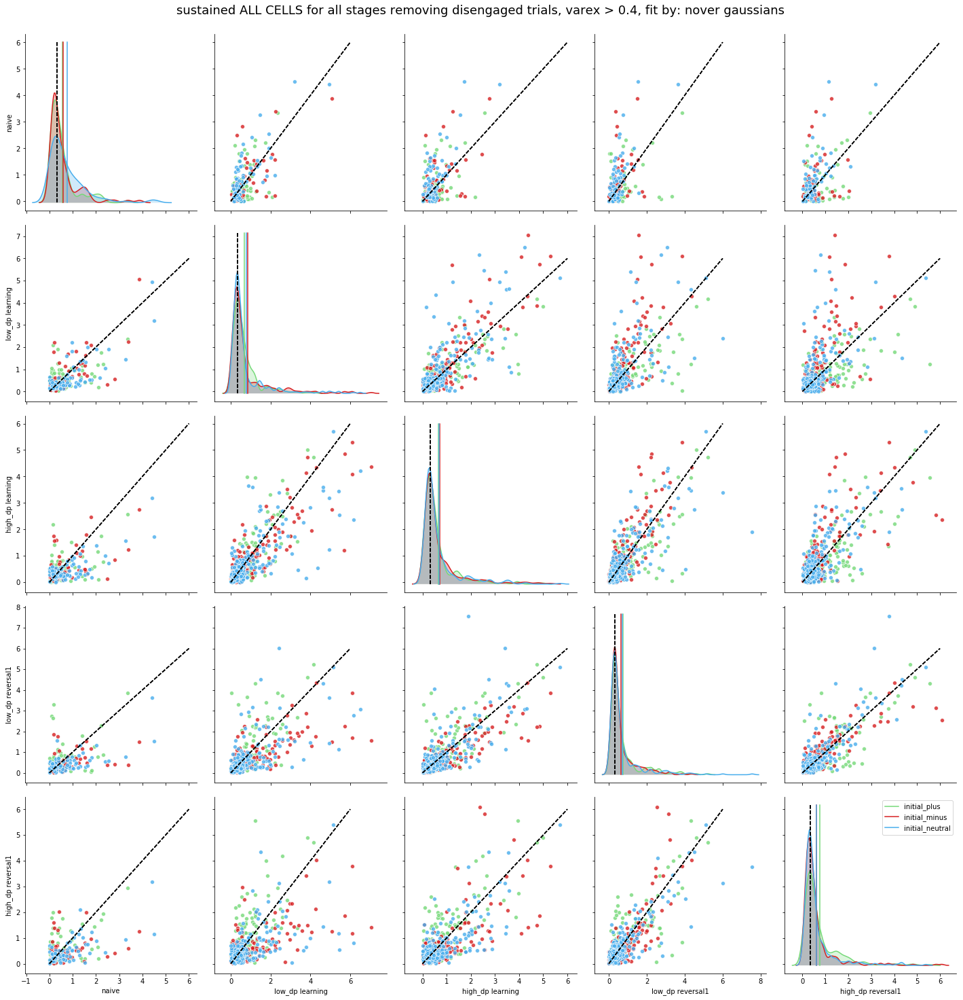

In [604]:
response_type = 'sustained'
new_df_list = []
# ['plus', 'minus', 'neutral']
for c, oi in enumerate(['plus', 'minus', 'neutral']):
    plt.figure(figsize=(6,6))
    driven_df = big_df.loc[big_df['driven_by'].isin(['initial_{}'.format(oi)]) & big_df['orientation'].isin(['initial_{}'.format(oi)])]
#     driven_df = big_df.loc[big_df['orientation'].isin(['initial_{}'.format(oi)])]
    resp_df = driven_df.loc[driven_df['response_type'].isin([response_type])]
    new_df_list.append(resp_df)
grid_df = pd.concat(new_df_list, axis=0)
# grid_df = grid_df.fillna(-1)

# useful lookup tables
def originline(a, b, color, label):
#     plt.plot([0,1], [0,1], '--k')
    plt.plot([0,6], [0,6], '--k')
#     plt.ylim([-0.2,1.2])
#     plt.xlim([-0.2,1.2])
    
# useful lookup tables
def originline2(a, color, label):
#     plt.plot([0.5, 0.5], [0,2], '--k')
    plt.plot([0.33, 0.33], [0,2], '--k')
    test = np.nanmean(a)
    plt.plot([test, test], [0,2], color=color)
#     print(a, len(a))
#     asd
    
hue_dict = {'initial_plus': [0.46, 0.85, 0.47, 1],
     'initial_minus': [0.84, 0.12, 0.13, 1],
     'initial_neutral': [0.28, 0.68, 0.93, 1],
     'learning': [34/255, 110/255, 54/255, 1],
     'reversal': [173/255, 38/255, 26/255, 1],
     'gray': [163/255, 163/255, 163/255, 1]}
# g = sns.PairGrid(grid_df.set_index(['mouse', 'cell_number',
#        'response_type', 'driven_by']).drop(columns='naive'), hue='orientation', palette=hue_dict, height=4)
g = sns.PairGrid(grid_df.set_index(['mouse', 'cell_number',
       'response_type', 'driven_by']), hue='orientation', palette=hue_dict, height=4)
# g = sns.PairGrid(grid_df.set_index(['cell_number',
#        'response_type', 'driven_by', 'orientation']).drop(columns='naive'), hue='mouse', height=4)
# g = g.map_offdiag(plt.scatter, edgecolor="w", s=40)
g = g.map_offdiag(sns.scatterplot, alpha=0.8)
# g = g.map_offdiag(sns.regplot)
g = g.map_offdiag(originline)
g = g.map_diag(sns.kdeplot, shade=True)
# g = g.map_diag(sns.distplot)
g = g.map_diag(originline2)
plt.suptitle('{} ALL CELLS for all stages removing disengaged trials, varex > 0.4, fit by: {} gaussians'.format(response_type, which_fits), y=1.02, size=18)
plt.legend()
plt.savefig('{}_ALLCELLS_allstage_remdiseng_trials_fit_by_{}_gaus_wnaive_wvarex.pdf'.format(response_type, which_fits), bbox_inches='tight')

In [223]:
grid_df.head()

,naive,low_dp learning,high_dp learning,low_dp reversal1,high_dp reversal1,mouse,orientation,cell_number,response_type,driven_by
11,NaN,0.501856,0.218188,0.163058,0.423903,OA27,initial_plus,11,trans_index,initial_plus
14,NaN,0.765034,0.169757,NaN,0.016001,OA27,initial_plus,14,trans_index,initial_plus
15,NaN,0.914057,0.999322,NaN,0.794580,OA27,initial_plus,15,trans_index,initial_plus
29,NaN,-0.018959,NaN,0.717102,NaN,OA27,initial_plus,29,trans_index,initial_plus
32,NaN,0.002372,NaN,0.673607,NaN,OA27,initial_plus,32,trans_index,initial_plus


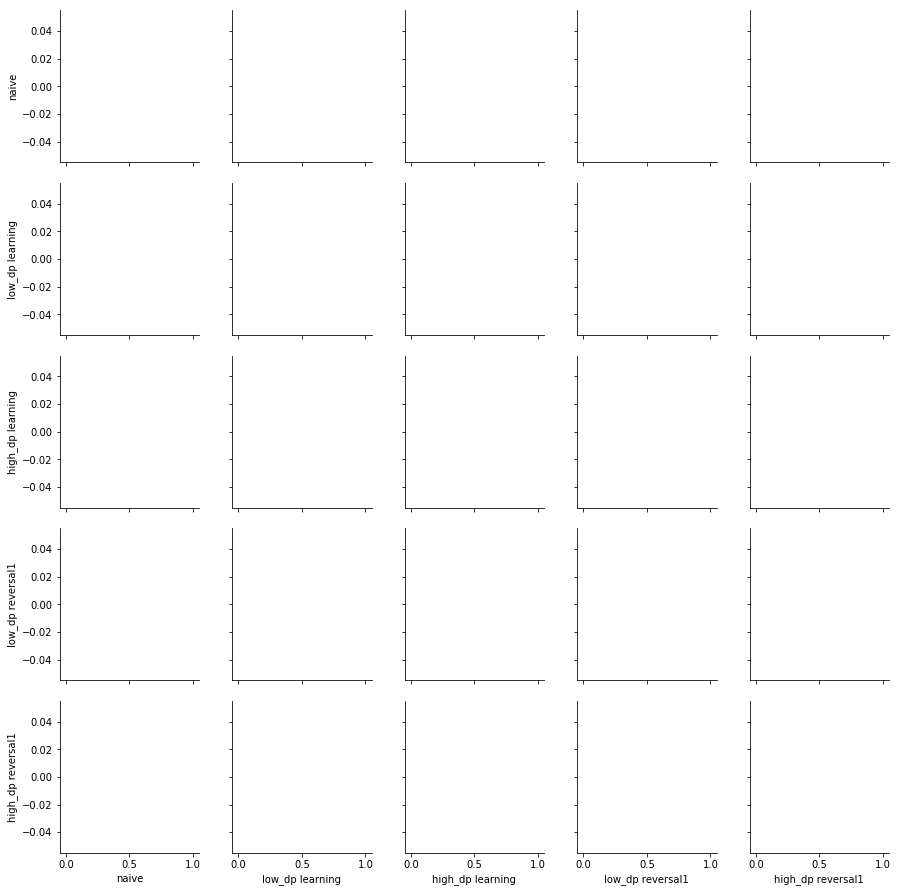

In [131]:
grid_melt = grid_df.melt(id_vars=['mouse', 'orientation', 'cell_number',
       'response_type', 'driven_by'])
grid_melt = grid_melt.rename(columns={"variable": "learning stage", "value": "sustainedness index"})

g = sns.PairGrid(grid_df.dropna().set_index(['mouse', 'cell_number',
       'response_type', 'driven_by', 'orientation']))
g = g.map_diag(plt.hist, edgecolor="w")
g = g.map_offdiag(plt.scatter, edgecolor="w", s=40)

In [701]:
g = sns.PairGrid(iris)
g = g.map_diag(plt.hist, edgecolor="w")
g = g.map_offdiag(plt.scatter, edgecolor="w", s=40)

Index(['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1',
       'high_dp reversal1', 'mouse', 'orientation', 'cell_number',
       'response_type', 'driven_by'],
      dtype='object')

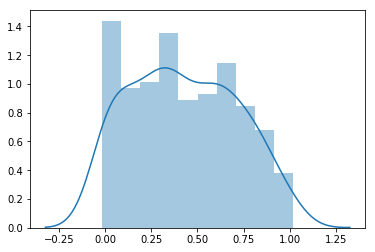

In [681]:
# tet_df = big_df.set_index(['mouse', 'orientation', 'cell_number', ])
big_boo = (big_df['driven_by'].isin(['initial_{}'.format('plus')]) & big_df['response_type'].isin([response_type]))
for oi in ['minus', 'neutral']:
    big_boo = big_boo | (big_df['driven_by'].isin(['initial_{}'.format(oi)]) & big_df['response_type'].isin([response_type]))
driven_df = big_df.loc[big_boo]
# tet_df = big_df.set_index(['mouse', 'orientation', 'cell_number', ])

sns.pairplot(data=big_df, hue='driven_by')

# CDF stage1 - stage2

<Figure size 432x432 with 0 Axes>

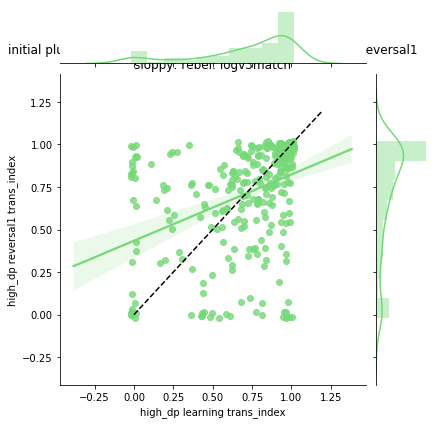

<Figure size 432x432 with 0 Axes>

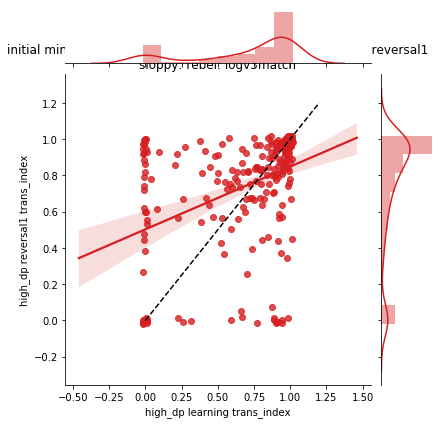

<Figure size 432x432 with 0 Axes>

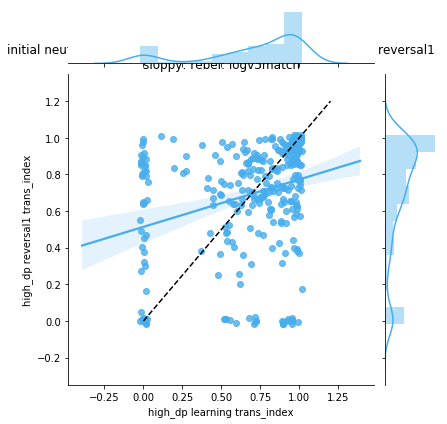

In [542]:
col1 = 'high_dp learning'
col2 = 'high_dp reversal1'

response_type = 'trans_index'

# plt.figure(figsize=(6,6))
for oi in ['plus', 'minus', 'neutral']:
    plt.figure(figsize=(6,6))
    driven_df = big_df.loc[big_df['driven_by'].isin(['initial_{}'.format(oi)])]
    resp_df = driven_df.loc[driven_df['response_type'].isin([response_type])]
    
    col1vec = resp_df[col1].values
    col2vec = resp_df[col2].values
    diff = col1vec - col2vec
    diff_clean = diff[np.isfinite(diff)]
    
    kwargs_cdf1 = {'cumulative': False}
    kwargs_cdf2 = {'cumulative': False}
#     sns.distplot(diff_clean, hist=False, kde_kws=kwargs_cdf2, color=color_dict[oi])
#     sns.scatterplot(data=resp_df, x=col1, y=col2, color=color_dict[oi])
    sns.jointplot(data=resp_df, x=col1, y=col2, color=color_dict[oi], kind='reg')

    col1vec = resp_df[col1].dropna().values
    col2vec = resp_df[col2].dropna().values
#     sns.distplot(col1vec, hist=False, kde_kws=kwargs_cdf2, color=color_dict[oi])
#     sns.distplot(col2vec, hist=False, kde_kws=kwargs_cdf2, color=color_dict['gray'])
#     x_rand = np.random.randint(1,101, 1000)/50 - 0.5
#     sns.distplot(x_rand, hist_kws=kwargs_cdf1, kde_kws=kwargs_cdf2)
    # add in cells that don't exist for a given colunn
#     col1vec = resp_df[col1].values
#     col2vec = resp_df[col2].values
#     col1na = resp_df[col1].isna()
#     col2na = resp_df[col2].isna()
#     jitter_vec = (np.random.rand(resp_df.shape[0]) - 0.5)/25
#     jitter_vec += 1.2
    
#     sns.scatterplot(data=resp_df, x=col1vec[col2na], y=jitter_vec[col2na], color=color_dict['gray'])
#     sns.scatterplot(data=resp_df, x=jitter_vec[col1na], y=col2vec[col1na], color=color_dict['gray'])
    

#     sns.regplot(data=resp_df, x=col1, y=col2, color=color_dict[oi])
#     plt.plot([-1,1], [0, 1], 'k--')
    plt.plot([0,1.2], [0, 1.2], 'k--')
#     plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
    plt.xlabel('{} {}'.format(col1, response_type))
    plt.ylabel('{} {}'.format(col2, response_type))
    plt.title('initial {}: {} cells: {} vs {}\n{}: {}: {}v3match'.format(oi, response_type, col1, col2, comp_n, words[0], which_fits))
#     plt.savefig('initial_{}_{}_cells_{}_vs_{}_{}_{}_{}v3match.pdf'.format(oi, response_type, col1, col2, comp_n, words[0], which_fits), bbox_inches='tight')

# model scatter 1 against model v3match, just need to get two dfs

In [402]:
def df_model_stages(mice, fits_control_g, fits_control,
        comp_n = 'sloppy',
        col1 = 'high_dp learning',
        col2 = 'low_dp reversal1',
        jitter_please = True,
        which_fits = 'g',
        kill_zeros = False):

    cmap_lookup = {'plus': 'Greens', 'minus': 'Reds', 'neutral': 'Blues'}

    # plt.figure(figsize=(8,8))
    all_ori_list = []
    for oi in ['plus', 'minus', 'neutral']:
        done = False
        df_list = []
        for c, mi in enumerate(mice):
            if mi in ['OA36']:
                continue
            if mi in ['OA32', 'OA34', 'OA36']:
                high_dp_ind = 1
                high_dp_rev = 3
                sus_filt_n = 3+2
                sus_cols = ['low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
            else:
                high_dp_ind = 2
                high_dp_rev = 4
                sus_filt_n = 5+2
                sus_cols = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
    #         trans_betas = fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :]
            for wind in ['transient', 'sustained', 'sus_index', 'trans_index', 'vis_stimulus']:

                if which_fits == 'g':
                    trans_betas = np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:1, :], axis=1)
    #                 trans_betas = deepcopy(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                    sus_betas = np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 2:sus_filt_n, :], axis=1)
                    stim_betas = np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:sus_filt_n, :], axis=1)

                    # get most driven ori across all stages of learning 
                    pa = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:sus_filt_n, :], axis=1), axis=1)
                    ma = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:sus_filt_n, :], axis=1), axis=1)
                    na = np.nanmean(np.nanmean(fits_control_g[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:sus_filt_n, :], axis=1), axis=1)
                else:
                    trans_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0, :])
                    sus_betas = deepcopy(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 1, :])
                    stim_betas = np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi][oi])][:, 0:1, :], axis=1)

                    # get most driven ori across all stages of learning 
                    pa = np.nanmean(np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi]['plus'])][:, 0:1, :], axis=1), axis=1)
                    ma = np.nanmean(np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi]['minus'])][:, 0:1, :], axis=1), axis=1)
                    na = np.nanmean(np.nanmean(fits_control[mi][comp_n]['ori_{}'.format(lookup[mi]['neutral'])][:, 0:1, :], axis=1), axis=1)

                pmn_mat = np.vstack([pa, ma, na])
                pmn_text = ['plus', 'minus', 'neutral']
                best_pmn = np.argmax(pmn_mat, axis=0)
                driven_by = ['initial_{}'.format(pmn_text[s]) for s in best_pmn]

                if wind == 'transient':
                    betas = trans_betas
                elif wind == 'sustained':
                    betas = sus_betas
                elif wind == 'sus_index':
                    betas = sus_betas/(trans_betas + sus_betas)
                elif wind == 'trans_index':
                    betas = trans_betas/(trans_betas + sus_betas)
                elif wind == 'vis_stimulus':
                    betas = stim_betas

                if kill_zeros:
                    betas[betas == 0] = np.nan

                if jitter_please:
                    jitter_mat = (np.random.rand(betas.shape[0], betas.shape[1]) - 0.5)/25
                    betas += jitter_mat

                ori_sus_cols = ['initial_{} {}'.format(oi, s) for s in sus_cols]
                data_df = pd.DataFrame(betas, columns=sus_cols)
                data_df['mouse'] = [mi]*len(data_df)
                data_df['orientation'] = ['initial_{}'.format(oi)]*len(data_df)
                data_df['cell_number'] = np.arange(len(data_df))
                data_df['response_type'] = [wind]*len(data_df)
                data_df['driven_by'] = driven_by

                df_list.append(data_df)

        all_mouse_df = pd.concat(df_list, axis=0, sort=False)
        all_ori_list.append(all_mouse_df)

    big_df = pd.concat(all_ori_list, axis=0)

    return big_df


In [450]:
big_gau_df = df_model_stages(mice, fits_control_g, fits_control,
        comp_n = 'sloppy',
        col1 = 'high_dp learning',
        col2 = 'low_dp reversal1',
        jitter_please = True,
        which_fits = 'g',
        kill_zeros = False)

big_orig_df = df_model_stages(mice, fits_control_g, fits_control,
        comp_n = 'sloppy',
        col1 = 'high_dp learning',
        col2 = 'low_dp reversal1',
        jitter_please = True,
        which_fits = 'notg',
        kill_zeros = False)

big_orig_df.set_index(['mouse', 'cell_number', 'response_type', 'orientation'], inplace=True)
big_gau_df.set_index(['mouse', 'cell_number', 'response_type', 'orientation'], inplace=True)

print(big_orig_df.shape, big_gau_df.shape)

(5925, 6) (5925, 6)


In [422]:
col1 = 'high_dp learning'
new_df = big_orig_df.loc[:, [col1, 'driven_by']]
new_vec = big_gau_df.loc[:, [col1]]
both_models = new_df.merge(new_vec, left_index=True, right_index=True)
both_models.head()

high_dp learning_x  \
mouse cell_number response_type orientation                        
OA27  0           transient     initial_plus            0.546076   
      1           transient     initial_plus            1.977367   
      2           transient     initial_plus            0.011367   
      3           transient     initial_plus            0.161173   
      4           transient     initial_plus           -0.015259   

                                                    driven_by  \
mouse cell_number response_type orientation                     
OA27  0           transient     initial_plus  initial_neutral   
      1           transient     initial_plus  initial_neutral   
      2           transient     initial_plus  initial_neutral   
      3           transient     initial_plus     initial_plus   
      4           transient     initial_plus  initial_neutral   

                                              high_dp learning_y  
mouse cell_number response_type orientation                       
OA27  0           transient     initial_plus            0.273169  
      1           transient     initial_plus            0.008191  
      2           transient     initial_plus           -0.016444  
      3           transient     initial_plus            0.722511  
      4           transient     initial_plus            0.007355

In [430]:
both_models = new_df.merge(new_vec, left_index=True, right_index=True)
both_models = both_models.reset_index()
driven_df = both_models.loc[both_models['driven_by'].isin(['initial_{}'.format(oi)])]
driven_df.head()

,mouse,cell_number,response_type,orientation,high_dp learning_x,driven_by,high_dp learning
3,OA27,3,transient,initial_plus,NaN,initial_plus,0.722511
14,OA27,14,transient,initial_plus,NaN,initial_plus,0.936834
15,OA27,15,transient,initial_plus,NaN,initial_plus,1.923963
29,OA27,29,transient,initial_plus,NaN,initial_plus,-0.014398
32,OA27,32,transient,initial_plus,NaN,initial_plus,0.003805


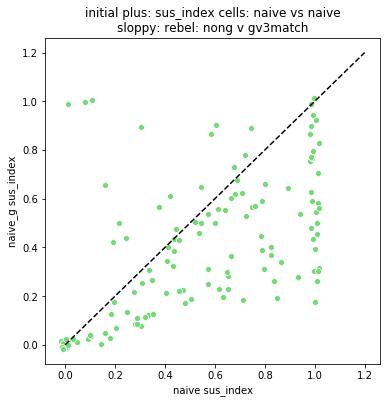

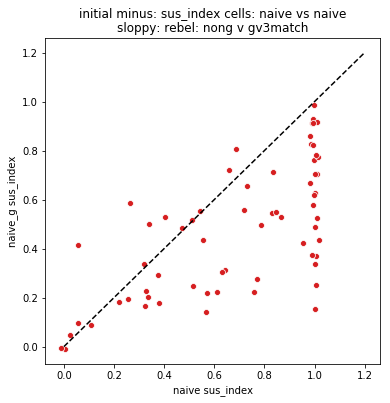

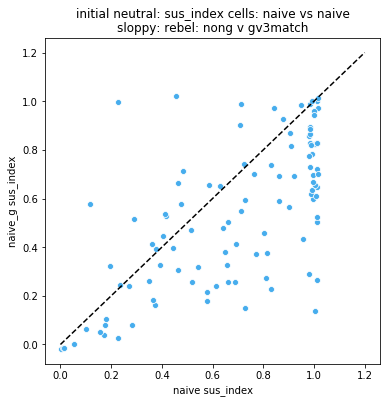

In [449]:
col1 = 'high_dp reversal1'
col1 = 'naive'
# col1 = 'high_dp learning_x'

# col2 = 'high_dp learning_y'


response_type = 'sus_index'

# plt.figure(figsize=(6,6))
for oi in ['plus', 'minus', 'neutral']:
    plt.figure(figsize=(6,6))
    new_df = big_orig_df.loc[:, [col1, 'driven_by']]
    new_vec = big_gau_df.loc[:, [col1]]
    new_vec['{}_g'.format(col1)] = deepcopy(new_vec.values)
    new_vec = new_vec.drop(columns=col1)
    both_models = new_df.merge(new_vec, left_index=True, right_index=True)
    both_models = both_models.reset_index()
    driven_df = both_models.loc[both_models['driven_by'].isin(['initial_{}'.format(oi)])]
    resp_df = driven_df.loc[driven_df['response_type'].isin([response_type])]
    
    sns.scatterplot(data=resp_df, x='{}'.format(col1), y='{}_g'.format(col1), color=color_dict[oi])
    
    # add in cells that don't exist for a given colunn
    col1vec = resp_df['{}'.format(col1)].values
    col2vec = resp_df['{}_g'.format(col1)].values
    col1na = resp_df['{}'.format(col1)].isna()
    col2na = resp_df['{}_g'.format(col1)].isna()
    jitter_vec = (np.random.rand(resp_df.shape[0]) - 0.5)/25
    jitter_vec += 1.2
    
    sns.scatterplot(data=resp_df, x=col1vec[col2na], y=jitter_vec[col2na], color=color_dict['gray'])
    sns.scatterplot(data=resp_df, x=jitter_vec[col1na], y=col2vec[col1na], color=color_dict['gray'])
    

#     sns.regplot(data=resp_df,  x='{}'.format(col1), y='{}_g'.format(col1), color=color_dict[oi])
    plt.plot([0, 1.2], [0, 1.2], 'k--')
#     plt.legend(title='number of\ncomponents\nabove threshold', loc='upper left', bbox_to_anchor=(1.05, 1))
    plt.xlabel('{} {}'.format(col1, response_type))
    plt.ylabel('{} {}'.format('{}_g'.format(col1), response_type))
    plt.title('initial {}: {} cells: {} vs {}\n{}: {}: nong v {}v3match'.format(oi, response_type, col1, col1, comp_n, words[0], which_fits))
    plt.savefig('initial_{}_{}_cells_{}_vs_{}_{}_{}_nong_v_{}v3match.pdf'.format(oi, response_type, col1, col1, comp_n, words[0], which_fits), bbox_inches='tight')

In [255]:
print(big_df.shape)
big_df.head()

big_df_i = big_df.set_index(['mouse', 'cell_number', 'response_type', 'orientation']).mean(axis=1)
best_idx = big_df_i.groupby(['mouse', 'cell_number', 'response_type']).idxmax()
best_idx.head()


(5925, 9)


mouse  cell_number  response_type
OA26   0            sus_index            (OA26, 0, sus_index, initial_minus)
                    sustained             (OA26, 0, sustained, initial_plus)
                    trans_index      (OA26, 0, trans_index, initial_neutral)
                    transient             (OA26, 0, transient, initial_plus)
                    vis_stimulus       (OA26, 0, vis_stimulus, initial_plus)
dtype: object

In [246]:
best_idx['orientation'].unique()

array(['initial_plus'], dtype=object)

In [202]:
new_frame.index.names = ['mouse', 'cell_number', 'orientation', 'response_type', 'stage']

TypeError: 'FrozenList' does not support mutable operations.

In [ ]:
dig_df = big_df.set_index(['mouse', 'cell_number', 'orientation', 'response_type'])
new_frame = dig_df.stack().to_frame(name='value')
new_frame.index.names = ['mouse', 'cell_number', 'orientation', 'response_type', 'stage']
vis_boo = new_frame.reset_index()['response_type'].isin(['vis_stimulus']).values
best_idxs = new_frame.iloc[vis_boo, :].groupby(['mouse', 'cell_number', 'response_type', 'stage']).idxmax()
high_dp_idxs = new_frame[best_idxs.values]
high_dp_idxs.head()

In [216]:
best_idxs.head()

high_dp learning  \
mouse cell_number response_type                               
OA26  0           vis_stimulus      (OA26, 0, initial_plus)   
      1           vis_stimulus      (OA26, 1, initial_plus)   
      2           vis_stimulus      (OA26, 2, initial_plus)   
      3           vis_stimulus     (OA26, 3, initial_minus)   
      4           vis_stimulus   (OA26, 4, initial_neutral)   

                                          high_dp reversal1  \
mouse cell_number response_type                               
OA26  0           vis_stimulus      (OA26, 0, initial_plus)   
      1           vis_stimulus      (OA26, 1, initial_plus)   
      2           vis_stimulus      (OA26, 2, initial_plus)   
      3           vis_stimulus     (OA26, 3, initial_minus)   
      4           vis_stimulus   (OA26, 4, initial_neutral)   

                                          low_dp learning  \
mouse cell_number response_type                             
OA26  0           vis_stimulus    (OA26, 0, initial_plus)   
      1           vis_stimulus    (OA26, 1, initial_plus)   
      2           vis_stimulus    (OA26, 2, initial_plus)   
      3           vis_stimulus    (OA26, 3, initial_plus)   
      4           vis_stimulus   (OA26, 4, initial_minus)   

                                           low_dp reversal1  \
mouse cell_number response_type                               
OA26  0           vis_stimulus     (OA26, 0, initial_minus)   
      1           vis_stimulus      (OA26, 1, initial_plus)   
      2           vis_stimulus     (OA26, 2, initial_minus)   
      3           vis_stimulus   (OA26, 3, initial_neutral)   
      4           vis_stimulus     (OA26, 4, initial_minus)   

                                                      naive  
mouse cell_number response_type                              
OA26  0           vis_stimulus   (OA26, 0, initial_neutral)  
      1           vis_stimulus      (OA26, 1, initial_plus)  
      2           vis_stimulus      (OA26, 2, initial_plus)  
      3           vis_stimulus      (OA26, 3, initial_plus)  
      4           vis_stimulus   (OA26, 4, initial_neutral)

In [ ]:
dig_df = big_df.set_index(['mouse', 'cell_number', 'orientation'])
best_idxs = dig_df.loc[dig_df['response_type'].isin(['vis_stimulus'])].groupby(['mouse', 'cell_number', 'response_type']).idxmax()
high_dp_idxs = best_idxs['high_dp learning']
dig_df.loc[high_dp_idxs, dig_df.columns]

In [ ]:
# variables to change
norm_please=False
by_stage=True

# make lookup dictionary of stage and dprime for each day
daily_stage_dict = {}
daily_dp_dict = {}
for mi, meti in zip(mice, meta_list):
    # add useful variables for further plotting
    meti = cas.utils.add_dprime_to_meta(meti)
    meti = _update_meta_date_vec(meti)
    u_days = np.unique(meti.reset_index()['date'])
    all_days = meti.reset_index()['date'].values
    ls = meti['learning_state'].values
    dp = meti['dprime'].values
    dp_vec = np.zeros((len(u_days)))
    ls_vec = []
    for dc, day_i in enumerate(u_days):
        day_bool = (all_days == day_i)
        ls_vec.append(np.unique(ls[day_bool])[0]) 
        dp_vec[dc] = np.unique(dp[day_bool])
    daily_stage_dict[mi] = ls_vec
    daily_dp_dict[mi] = dp_vec

# hardcoded variable for tempofac plotting
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)

filt_names = ['transientness', 'sustainedness']
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
sus_list = []
trans_list = []
mouse_vec, comp_vec, clus_vec = [], [], []
clusi = 0
for mi, m1, met1, meti in zip(mice, model_list, model_meta_list, meta_list):
    
    # daily stage and dprime
    lsi = daily_stage_dict[mi]
    dpi = daily_dp_dict[mi]
    
    # 0.5 for transition days
    meti = _update_meta_date_vec(meti)

    # check group tuning
    o_max = []
    for oi in oris:
        o_max.append(np.max(np.abs(m1.results[rank][0].factors[2][met1['orientation'].isin([oi]).values, :]), axis=0))
    o_ind_max = np.argmax(np.vstack(o_max), axis=0)

    # check group shape, if offset is closer to stim than baseline throw it out
    secsec = np.mean(m1.results[rank][0].factors[1][32:48, :], axis=0)
    lastsec = np.mean(m1.results[rank][0].factors[1][-32:, :], axis=0)
    diffsec = np.round(lastsec/secsec) < 1

    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    udays = {d: c for c, d in enumerate(np.unique(dates))}
    ndays = np.diff([udays[i] for i in np.unique(dates)])
    day_x = np.where(ndays)[0] + 1

    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 1
    if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
        lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
        lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 1
    else:
        lear_ind = 0

    trans_list_oris, sus_list_oris = [], []
    for oc, oi in enumerate(['plus', 'neutral', 'minus',]):
        trans_list_bloc, sus_list_bloc = [], []
        for ci in range(1, 11):
            
            # check that temporal factor shape
            if not diffsec[ci-1]:
                print('{} {} skipped: tempfac'.format(mi,ci))
                continue

            # check trial factor with largest amplitude 
#                 if o_ind_max[ci-1] != oc:
#                     print('{} {} ori {}:{} skipped: tuning'.format(mi,ci,lookup[mi][oi],oi))
#                     continue

            tempofac = m1.results[rank][0].factors[1][:, ci-1]
#             if norm_please:
#                 mn_trans = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 0, :], axis=1)[:, None]
#                 mn_sus = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 1, :], axis=1)[:, None]
#             else:
            mn_trans = 1
            mn_sus = 1
            mx_trans = fits_control[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 0, :]/mn_trans
            mx_sus = fits_control[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 1, :]/mn_sus
            
            if by_stage:
                # take mean sus/trans value by stage of learning
                mx_trans_stage = np.zeros((mx_sus.shape[0], len(stages)))
                mx_trans_stage[:] = np.nan
                mx_sus_stage = np.zeros((mx_sus.shape[0], len(stages)))
                mx_sus_stage[:] = np.nan
                for si, sti in enumerate(stages):
                    if 'naive' in sti:
                        stabool = np.array([s == 'naive' for s in lsi])
                    elif 'learning' in sti:
                        stabool = np.array([s == 'learning' for s in lsi])
                        if 'low_dp' in sti:
                            dbool = dpi < 2
                        elif 'high_dp' in sti:
                            dbool = dpi >= 2
                        stabool = stabool & dbool
                    elif 'reversal1' in sti:
                        stabool = np.array([s == 'reversal1' for s in lsi])
                        if 'low_dp' in sti:
                            dbool = dpi < 2
                        elif 'high_dp' in sti:
                            dbool = dpi >= 2
                        stabool = stabool & dbool
                    
                    
                    mx_trans_stage[:, si] = np.nanmean(mx_trans[:, stabool], axis=1)
                    mx_sus_stage[:, si] = np.nanmean(mx_sus[:, stabool], axis=1)
                    
                trans_list_bloc.append(mx_trans_stage)
                sus_list_bloc.append(mx_sus_stage)
            else:
                trans_list_bloc.append(mx_trans)
                sus_list_bloc.append(mx_sus)
                
                        # make component-mouse vectors
            if oc == 0:
                mouse_vec.extend([mi]*mx_sus.shape[0])
                comp_vec.extend([ci]*mx_sus.shape[0])
                clus_vec.extend([clusi]*mx_sus.shape[0])
                clusi +=1

        trans_list_oris.append(np.vstack(trans_list_bloc))
        sus_list_oris.append(np.vstack(sus_list_bloc))

    trans_list.append(np.hstack(trans_list_oris))
    sus_list.append(np.hstack(sus_list_oris))

trans_stack = np.vstack(trans_list)
sus_stack = np.vstack(sus_list)
combo_stack = np.hstack([trans_stack, sus_stack])

if norm_please:
    combo_stack = combo_stack/np.nanmax(combo_stack, axis=1)[:, None]
    trans_stack = trans_stack/np.nanmax(trans_stack, axis=1)[:, None]
    sus_stack = sus_stack/np.nanmax(sus_stack, axis=1)[:, None]

# control: plot stage averages of you control groups

In [ ]:
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
times = np.arange(-1, 6, 1)
timepts = np.arange(0, 108, 15.5)

for mi, meti, threshi, V in zip(mice, meta_list, thresh_list_control, model_list):
    
    # get all necessary data in dataframe
    df = comp_tensor_dict_to_avg_df(threshi, meti, first100only=True)
    firstboo = _first100_wtrans_bool(meti)
    meti = _update_meta_date_vec(meti).iloc[firstboo, :]
    meti = _update_meta_stages(meti)
    meti = _update_meta_reltrials(meti)
    
    drop_later = meti.columns
    df_merge = df.merge(meti, right_index=True, left_index=True)
    mean_df = df_merge.groupby(['component',  'parsed_stage', 'orientation', 'relative_trial_idx']).mean()
    left_over = mean_df.columns
    drop_now = drop_later[np.isin(drop_later, left_over)]
    md_df = mean_df.drop(columns=drop_now)
    
    for compi in md_df.reset_index()['component'].unique():
            
        comp_df = md_df.iloc[md_df.reset_index()['component'].isin([compi]).values, :]
        fig, ax = plt.subplots(1,3, figsize=(18,8))
        for c, csi in enumerate(['plus', 'minus', 'neutral']):
            ori = lookup[mi][csi]
            ori_boo = comp_df.reset_index()['orientation'].isin([ori]).values
            reordered_stages = []
            for stagi in stages:
                stage_boo = comp_df.reset_index()['parsed_stage'].isin([stagi]).values
                stage_df = comp_df.iloc[(ori_boo & stage_boo), :]
                reordered_stages.append(stage_df)
            reordered_df = pd.concat(reordered_stages, axis=0)
            sns.heatmap(reordered_df.values, ax=ax[c])
            ax[c].set_title('{}: {}\n\ncomp {}: initial_{}\n'.format(mi, words[0], compi, csi))
            ax[c].set_ylabel('trial number (average 100 per day per epoch)')
            ax[c].set_xlabel('time from stimulus onset (sec)')
            ax[c].set_xticks(timepts)
            ax[c].set_xticklabels(times, rotation=0)

            x_min = 0 
            x_max = 108 
            stage_vec = reordered_df.reset_index()['parsed_stage'].values
            if any(np.isin(stage_vec, 'naive')):
                lear_ind = np.where(np.isin(stage_vec, 'naive'))[0][-1]
            else:
                lear_ind = 0
            rev_ind = np.where(np.isin(stage_vec, 'high_dp learning'))[0][-1]
            for stagi in np.unique(stage_vec)[:-1]:
                epoch_end = np.where(np.isin(stage_vec, stagi))[0][-1]
                ax[c].plot([x_min, x_max], [epoch_end, epoch_end], color=color_dict['gray'], linewidth=2)
            ax[c].plot([x_min, x_max], [lear_ind, lear_ind], '--', color=color_dict['learning'], linewidth=3)
            ax[c].plot([x_min, x_max], [rev_ind, rev_ind], '--', color=color_dict['reversal'], linewidth=3)
        fig.savefig('{}_{}_norepcontrol_avg_heatmaps_comp_{}_stages.png'.format(mi, words[0], compi), bbox_inches='tight')
#     plt.close('all')

# fit each date (rev/learn not split)

In [132]:
fits2 = {}
daily_avg_dict2 = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list, meta_list):

    A = _get_fitting_template_defaults(mi)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_bool(meti)
    
    daily_avg_dict2[mi] = {}
    fits2[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits2[mi]['component_{}'.format(c+1)] = {}
        daily_avg_dict2[mi]['component_{}'.format(c+1)] = {}
        for ori in oris:
            cell_mat = np.zeros((proj[comp_n].shape[0], proj[comp_n].shape[1], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                cell_mat[:, :, dc] = np.nanmean(proj[comp_n][:, :, day_ori_bool], axis=2)
            all_tr = np.zeros((proj[comp_n].shape[0], A.shape[1], len(u_days)))
            for tr_n in range(cell_mat.shape[2]):
                for c_n in range(cell_mat.shape[0]):
                    b = deepcopy(cell_mat[c_n, :, tr_n])
                    b[b < 0] = 0
                    if np.sum(np.isnan(b)) == len(b):
                        sp_ans = np.zeros(4)
                        sp_ans[:] = np.nan
                        sp_ans = sp_ans
                    else:
                        sp_ans = sp.optimize.nnls(A, b)[0]
                    all_tr[c_n, :, tr_n] = sp_ans
            fits2[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = all_tr
            fits2[mi]['component_{}'.format(c+1)]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict2[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = cell_mat

    print('Making progress: {} done.'.format(mi))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


In [674]:
for compi in range(1,11):
#     print(np.nanstd(np.nanmean(thresh_list[0][compi], axis=0)[:15, :].flatten()))
    print(np.nanstd(np.nanmean(thresh_list[0][compi], axis=0)[:15, :]))
    print(np.nanmax(np.nanmean(thresh_list[0][compi], axis=0)[:15, :]))

0.2816605294679159
2.842291738258563
0.25743959176194825
2.7662751983681857
0.3077424493452549
2.6572841270376117
0.26085477734647483
3.6468142177684286
0.2509596340789399
1.5378719328234791
0.3171399394717911
6.886067802787468
0.2541485401817225
2.84094367828821
0.3313796575183698
5.641333199616882
0.3031321006966485
3.8860773345886144
0.25160792578185365
1.418206697124202


In [684]:
cell_max = np.nanmax(np.nanmax(thresh_list[0][compi], axis=1), axis=1)
cell_max

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning: All-NaN slice encountered
  """Entry point for launching an IPython kernel.


array([14.83497103,  8.58649762, 13.97447839, 84.58848462, 10.19672818,
       28.7995912 ,  9.93601615, 10.77472186, 10.37286683, 28.05235305,
        6.49582964, 10.40666866, 17.1182155 , 10.46065744, 18.20199032,
       10.53584887, 30.02670173, 15.04745085,  3.59235055, 19.37352071,
        6.03650997,  2.96410793, 10.24872331, 11.4378265 ,  7.41918535,
       19.91898138, 21.54914877,  7.07520473, 14.83068066,  9.61165519,
       14.30890476,  5.64506649,  3.18828526, 14.35825295, 17.1844346 ,
        3.69297849, 23.80481536,  9.19076205, 18.81485801,  9.24332749,
        6.19025843, 11.24706105,  8.4521644 , 25.8046117 , 21.51561258,
       13.17749378, 16.25225961, 22.35621098, 24.38860449,  4.57793242,
       28.58852305, 22.80374253, 14.86047913,  7.80442971, 19.62527237])

# heatmaps all trials

In [709]:
times = np.arange(-1, 6, 1)
timepts = np.arange(0, 108, 15.5)

for mi, meti, threshi in zip(mice, meta_list, thresh_list):
    
    firstboo = _first100_wtrans_bool(meti)
    meti = _update_meta_date_vec(meti).iloc[firstboo, :]

    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    udays = {d: c for c, d in enumerate(np.unique(dates))}
    # ndays = np.diff([udays[i] for i in np.unique(dates)])
    ndays = np.diff([udays[i] for i in dates])
    day_x = np.where(ndays)[0] + 0.5

    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    # rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 0.5
    if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
        lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
    #     lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 0.5
    else:
        lear_ind = 0 - 0.5

    for compi in range(1,11):
        cell_max = np.nanmax(np.nanmax(threshi[compi][:,:,firstboo], axis=1), axis=1)
        mean_per_comp = np.nanmean(threshi[compi][:,:,firstboo], axis=0)
        mean_per_comp_norm = np.nanmean(threshi[compi][:,:,firstboo]/cell_max[:, None, None], axis=0)

        fig, (ax1, ax2) = plt.subplots(1,2, figsize=(12,14))
        sns.heatmap(mean_per_comp.T, ax=ax1)
        ax1.set_title('{}: {}, comp {}'.format(mi, words[0], compi))
        ax1.set_ylabel('trial number (first 100 per day)')
        ax1.set_xlabel('time from stimulus onset (sec)')
        ax1.set_xticks(timepts)
        ax1.set_xticklabels(times, rotation=0)

        y_min = 0 
        y_max = 108 
        if len(day_x) > 0:
            for k in day_x:
                if k == lear_ind or k == rev_ind:
                    continue
                ax1.plot([y_min, y_max], [k, k], color=color_dict['gray'], linewidth=2)
        ax1.plot([y_min, y_max], [lear_ind, lear_ind], '--', color=color_dict['learning'], linewidth=3)
        ax1.plot([y_min, y_max], [rev_ind, rev_ind], '--', color=color_dict['reversal'], linewidth=3)

        sns.heatmap(mean_per_comp_norm.T, ax=ax2)
        ax2.set_title('{}: {}, norm comp {}'.format(mi, words[0], compi))
        ax2.set_xlabel('time from stimulus onset (sec)')
        ax2.set_xticks(timepts)
        ax2.set_xticklabels(times, rotation=0)

        y_min = 0 
        y_max = 108 
        if len(day_x) > 0:
            for k in day_x:
                if k == lear_ind or k == rev_ind:
                    continue
                ax2.plot([y_min, y_max], [k, k], color=color_dict['gray'], linewidth=2)
        ax2.plot([y_min, y_max], [lear_ind, lear_ind], '--', color=color_dict['learning'], linewidth=3)
        ax2.plot([y_min, y_max], [rev_ind, rev_ind], '--', color=color_dict['reversal'], linewidth=3)

        fig.savefig('{}_{}_norep_avg_heatmaps_comp_{}.png'.format(mi, words[0], compi), bbox_inches='tight')
    plt.close('all')
        

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:26: RuntimeWarning: All-NaN slice encountered
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:27: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: RuntimeWarning: Mean of empty slice


In [ ]:
firstboo = _first100_wtrans_bool(meti)
meti = _update_meta_date_vec(meti).iloc[firstboo, :]
meti = _update_meta_stages(meti)
meti = _update_meta_reltrials(meti)

meti = meti.reset_index().groupby(['parsed_stage', 'relative_trial_idx']).mean()
meti.head()

In [746]:
meti.head()

orientation condition  trialerror  prev_reward  \
mouse date     run trial_idx                                                   
OA27  170116.0 3   0                    0   neutral         3.0        False   
                   1                  135     minus         4.0        False   
                   2                  270      plus         0.0        False   
                   3                    0   neutral         3.0        False   
                   4                  135     minus         4.0        False   

                              prev_punish  hunger learning_state       tag  \
mouse date     run trial_idx                                                 
OA27  170116.0 3   0                False  hungry          naive  standard   
                   1                False  hungry          naive  standard   
                   2                False  hungry          naive  standard   
                   3                False  hungry          naive  standard   
                   4                False  hungry          naive  standard   

                              firstlick  firstlickbout  ...  speed  pre_speed  \
mouse date     run trial_idx                            ...                     
OA27  170116.0 3   0                NaN            NaN  ...    NaN        NaN   
                   1                NaN            NaN  ...    NaN        NaN   
                   2                NaN            NaN  ...    NaN        NaN   
                   3                NaN            NaN  ...    NaN        NaN   
                   4                NaN            NaN  ...    NaN        NaN   

                              anticipatory_licks  pre_licks  pupil  pre_pupil  \
mouse date     run trial_idx                                                    
OA27  170116.0 3   0                         NaN        NaN    NaN        NaN   
                   1                         NaN        NaN    NaN        NaN   
                   2                         NaN        NaN    NaN        NaN   
                   3                         NaN        NaN    NaN        NaN   
                   4                         NaN        NaN    NaN        NaN   

                              brainmotion  dprime  parsed_stage  \
mouse date     run trial_idx                                      
OA27  170116.0 3   0                  NaN     0.0         naive   
                   1                  NaN     0.0         naive   
                   2                  NaN     0.0         naive   
                   3                  NaN     0.0         naive   
                   4                  NaN     0.0         naive   

                              relative_trial_idx  
mouse date     run trial_idx                      
OA27  170116.0 3   0                         0.0  
                   1                         1.0  
                   2                         2.0  
                   3                         3.0  
                   4                         4.0  

[5 rows x 22 columns]

# heatmaps by stage grouping across first 100 trials

In [792]:
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
times = np.arange(-1, 6, 1)
timepts = np.arange(0, 108, 15.5)

for mi, meti, threshi, V in zip(mice, meta_list, thresh_list, model_list):
    
    # check group shape, if offset is closer to stim than baseline throw it out
    secsec = np.mean(V.results[rank][0].factors[1][32:48, :], axis=0)
    lastsec = np.mean(V.results[rank][0].factors[1][-32:, :], axis=0)
    diffsec = np.round(lastsec/secsec) < 1
    
    # get all necessary data in dataframe
    df = comp_tensor_dict_to_avg_df(threshi, meti, first100only=True)
    firstboo = _first100_wtrans_bool(meti)
    meti = _update_meta_date_vec(meti).iloc[firstboo, :]
    meti = _update_meta_stages(meti)
    meti = _update_meta_reltrials(meti)
    
    drop_later = meti.columns
    df_merge = df.merge(meti, right_index=True, left_index=True)
    mean_df = df_merge.groupby(['component',  'parsed_stage', 'orientation', 'relative_trial_idx']).mean()
    left_over = mean_df.columns
    drop_now = drop_later[np.isin(drop_later, left_over)]
    md_df = mean_df.drop(columns=drop_now)
    
    for compi in md_df.reset_index()['component'].unique():
        
        # don't consider offset components
#         temp_fac = V.results[rank][0].factors[1][:, compi-1]
#         if np.argmax(temp_fac) > send:
#             continue
            
        # check that temporal factor shape
        if not diffsec[ci-1]:
            print('{} {} skipped: tempfac'.format(mi,ci))
            continue
            
        comp_df = md_df.iloc[md_df.reset_index()['component'].isin([compi]).values, :]
        fig, ax = plt.subplots(1,3, figsize=(18,8))
        for c, csi in enumerate(['plus', 'minus', 'neutral']):
            ori = lookup[mi][csi]
            ori_boo = comp_df.reset_index()['orientation'].isin([ori]).values
            reordered_stages = []
            for stagi in stages:
                stage_boo = comp_df.reset_index()['parsed_stage'].isin([stagi]).values
                stage_df = comp_df.iloc[(ori_boo & stage_boo), :]
                reordered_stages.append(stage_df)
            reordered_df = pd.concat(reordered_stages, axis=0)
            sns.heatmap(reordered_df.values, ax=ax[c])
            ax[c].set_title('{}: {}\n\ncomp {}: initial_{}\n'.format(mi, words[0], compi, csi))
            ax[c].set_ylabel('trial number (average 100 per day per epoch)')
            ax[c].set_xlabel('time from stimulus onset (sec)')
            ax[c].set_xticks(timepts)
            ax[c].set_xticklabels(times, rotation=0)

            x_min = 0 
            x_max = 108 
            stage_vec = reordered_df.reset_index()['parsed_stage'].values
            if any(np.isin(stage_vec, 'naive')):
                lear_ind = np.where(np.isin(stage_vec, 'naive'))[0][-1]
            else:
                lear_ind = 0
            rev_ind = np.where(np.isin(stage_vec, 'high_dp learning'))[0][-1]
            for stagi in np.unique(stage_vec)[:-1]:
                epoch_end = np.where(np.isin(stage_vec, stagi))[0][-1]
                ax[c].plot([x_min, x_max], [epoch_end, epoch_end], color=color_dict['gray'], linewidth=2)
            ax[c].plot([x_min, x_max], [lear_ind, lear_ind], '--', color=color_dict['learning'], linewidth=3)
            ax[c].plot([x_min, x_max], [rev_ind, rev_ind], '--', color=color_dict['reversal'], linewidth=3)
        fig.savefig('{}_{}_norep_avg_heatmaps_comp_{}_stages.png'.format(mi, words[0], compi), bbox_inches='tight')
    plt.close('all')

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: Mean of empty slice
  # This is added back by InteractiveShellApp.init_path()


In [765]:
df.head()

0         1         2    \
mouse date     run trial_idx component                                 
OA27  170116.0 3   0         1         -0.110000  0.021729  0.867938   
                   1         1          0.466887 -0.122594 -0.228365   
                   2         1          0.012323  0.014659 -0.197458   
                   3         1          0.419145 -0.156593 -0.083267   
                   4         1          0.124616 -0.350832 -0.228673   

                                             3         4         5    \
mouse date     run trial_idx component                                 
OA27  170116.0 3   0         1         -0.183898  0.084918 -0.151687   
                   1         1          0.390117  0.878530 -0.207712   
                   2         1          0.442778 -0.067653  0.353159   
                   3         1          0.286654  0.025255 -0.238826   
                   4         1         -0.008958  0.263436  0.122763   

                                             6         7         8    \
mouse date     run trial_idx component                                 
OA27  170116.0 3   0         1         -0.205321 -0.324283 -0.246731   
                   1         1         -0.057303 -0.118474 -0.397831   
                   2         1          0.722250 -0.489922 -0.284674   
                   3         1          0.097904 -0.096000 -0.445569   
                   4         1         -0.092548 -0.379608  0.079636   

                                             9    ...       98        99   \
mouse date     run trial_idx component            ...                       
OA27  170116.0 3   0         1          0.528646  ... -0.028957 -0.121317   
                   1         1         -0.550733  ... -0.048136 -0.123348   
                   2         1         -0.286788  ...  0.341462  0.328669   
                   3         1         -0.030306  ... -0.057210  0.539693   
                   4         1         -0.276379  ... -0.281026 -0.269164   

                                             100       101       102  \
mouse date     run trial_idx component                                 
OA27  170116.0 3   0         1         -0.449686 -0.321182 -0.063008   
                   1         1         -0.124981  0.043512 -0.141245   
                   2         1          0.204533  0.046199  0.025406   
                   3         1          0.593242 -0.037434 -0.087303   
                   4         1         -0.336800 -0.203385 -0.318994   

                                             103       104       105  \
mouse date     run trial_idx component                                 
OA27  170116.0 3   0         1         -0.157308  0.050523  0.011265   
                   1         1         -0.146623  0.165185 -0.296146   
                   2         1         -0.359479 -0.411728 -0.117377   
                   3         1          0.177649  0.092597 -0.048098   
                   4         1          0.109322 -0.243616  0.585697   

                                             106       107  
mouse date     run trial_idx component                      
OA27  170116.0 3   0         1          0.004015  0.021780  
                   1         1         -0.107125 -0.064509  
                   2         1          0.042801  0.411837  
                   3         1          0.557362 -0.160378  
                   4         1         -0.095131 -0.292318  

[5 rows x 108 columns]

In [776]:
drop_later = meti.columns
df_merge = df.merge(meti, right_index=True, left_index=True)
mean_df = df_merge.groupby(['component',  'parsed_stage', 'orientation', 'relative_trial_idx']).mean()
left_over = mean_df.columns
drop_now = drop_later[np.isin(drop_later, left_over)]
md_df = mean_df.drop(columns=drop_now)
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
# md_df = md_df.reorder_levels(stages, axis=1)
md_df.head()

0         1    \
component parsed_stage     orientation relative_trial_idx                       
1         high_dp learning 0           1.0                -0.469111 -0.028821   
                                       3.0                -0.020888  0.097291   
                                       4.0                -0.346765 -0.429882   
                                       5.0                 0.061367 -0.235023   
                                       6.0                -0.283429  0.059468   

                                                                2         3    \
component parsed_stage     orientation relative_trial_idx                       
1         high_dp learning 0           1.0                 0.295878 -0.040854   
                                       3.0                -0.080820 -0.103995   
                                       4.0                 0.122337  0.091796   
                                       5.0                -0.229003  0.045422   
                                       6.0                -0.104101 -0.127845   

                                                                4         5    \
component parsed_stage     orientation relative_trial_idx                       
1         high_dp learning 0           1.0                 0.103133 -0.092824   
                                       3.0                -0.129163  0.275387   
                                       4.0                -0.032925 -0.042281   
                                       5.0                 0.256645  0.040474   
                                       6.0                 0.241894  0.136129   

                                                                6         7    \
component parsed_stage     orientation relative_trial_idx                       
1         high_dp learning 0           1.0                -0.006697 -0.172637   
                                       3.0                -0.208689 -0.342461   
                                       4.0                -0.176867  0.229506   
                                       5.0                -0.178451  0.049178   
                                       6.0                 0.349740  0.063976   

                                                                8         9    \
component parsed_stage     orientation relative_trial_idx                       
1         high_dp learning 0           1.0                 0.036211  0.028092   
                                       3.0                -0.038937  0.321787   
                                       4.0                 0.199531  0.055522   
                                       5.0                 0.177183 -0.031993   
                                       6.0                -0.324913 -0.079923   

                                                           ...       98   \
component parsed_stage     orientation relative_trial_idx  ...             
1         high_dp learning 0           1.0                 ...  0.037738   
                                       3.0                 ... -0.277056   
                                       4.0                 ...  0.103341   
                                       5.0                 ...  0.014297   
                                       6.0                 ...  0.656246   

                                                                99        100  \
component parsed_stage     orientation relative_trial_idx                       
1         high_dp learning 0           1.0                -0.333578  0.077866   
                                       3.0                -0.460545 -0.326908   
                                       4.0                 0.010913  0.167613   
                                       5.0                 0.069444  0.132350   
                                       6.0                 0.148507 -0.055397   

                                                                101       102  \
component parsed_stage     orientation rel

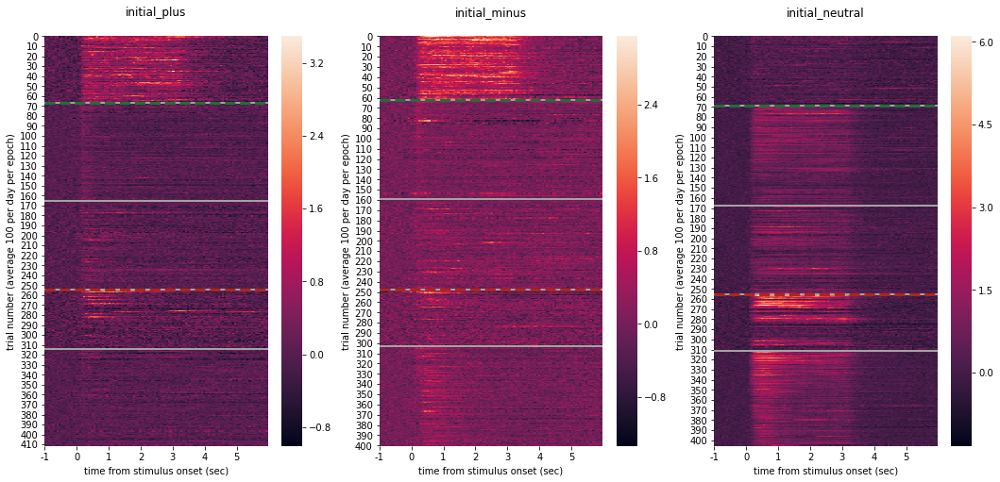

In [786]:
mi = 'OA27'
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
times = np.arange(-1, 6, 1)
timepts = np.arange(0, 108, 15.5)

for compi in md_df.reset_index()['component'].unique():
    comp_df = md_df.iloc[md_df.reset_index()['component'].isin([compi]).values, :]
    fig, ax = plt.subplots(1,3, figsize=(18,8))
    for c, csi in enumerate(['plus', 'minus', 'neutral']):
        ori = lookup[mi][csi]
        ori_boo = comp_df.reset_index()['orientation'].isin([ori]).values
        reordered_stages = []
        for stagi in stages:
            stage_boo = comp_df.reset_index()['parsed_stage'].isin([stagi]).values
            stage_df = comp_df.iloc[(ori_boo & stage_boo), :]
            reordered_stages.append(stage_df)
        reordered_df = pd.concat(reordered_stages, axis=0)
        sns.heatmap(reordered_df.values, ax=ax[c])
        ax[c].set_title('initial_{}\n'.format(csi))
        ax[c].set_ylabel('trial number (average 100 per day per epoch)')
        ax[c].set_xlabel('time from stimulus onset (sec)')
        ax[c].set_xticks(timepts)
        ax[c].set_xticklabels(times, rotation=0)
        
        x_min = 0 
        x_max = 108 
        stage_vec = reordered_df.reset_index()['parsed_stage'].values
        if any(np.isin(stage_vec, 'naive')):
            lear_ind = np.where(np.isin(stage_vec, 'naive'))[0][-1]
        else:
            lear_ind = 0
        rev_ind = np.where(np.isin(stage_vec, 'high_dp learning'))[0][-1]
        for stagi in stages[:-1]:
            epoch_end = np.where(np.isin(stage_vec, stagi))[0][-1]
            ax[c].plot([x_min, x_max], [epoch_end, epoch_end], color=color_dict['gray'], linewidth=2)
        ax[c].plot([x_min, x_max], [lear_ind, lear_ind], '--', color=color_dict['learning'], linewidth=3)
        ax[c].plot([x_min, x_max], [rev_ind, rev_ind], '--', color=color_dict['reversal'], linewidth=3)
    fig.savefig('{}_{}_norep_avg_heatmaps_comp_{}_stages.png'.format(mi, words[0], compi), bbox_inches='tight')

In [ ]:
times = np.arange(-1, 6, 1)
timepts = np.arange(0, 108, 15.5)

for mi, meti, threshi in zip(mice, meta_list, thresh_list):
    
    # get all necessary data in dataframe
    firstboo = _first100_wtrans_bool(meti)
    meti = _update_meta_date_vec(meti).iloc[firstboo, :]
    meti = _update_meta_stages(meti)
    meti = _update_meta_reltrials(meti)
    
    #
    
    # after you take means of your 
    meti = meti.reset_index().groupby(['parsed_stage', 'relative_trial_idx']).mean()

    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    udays = {d: c for c, d in enumerate(np.unique(dates))}
    # ndays = np.diff([udays[i] for i in np.unique(dates)])
    ndays = np.diff([udays[i] for i in dates])
    day_x = np.where(ndays)[0] + 0.5

    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    # rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 0.5
    if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
        lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
    #     lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 0.5
    else:
        lear_ind = 0 - 0.5

    for compi in range(1,11):
        cell_max = np.nanmax(np.nanmax(threshi[compi][:,:,firstboo], axis=1), axis=1)
        mean_per_comp = np.nanmean(threshi[compi][:,:,firstboo], axis=0)
        mean_per_comp_norm = np.nanmean(threshi[compi][:,:,firstboo]/cell_max[:, None, None], axis=0)

        fig, (ax1, ax2) = plt.subplots(1,2, figsize=(12,14))
        sns.heatmap(mean_per_comp.T, ax=ax1)
        ax1.set_title('{}: {}, comp {}'.format(mi, words[0], compi))
        ax1.set_ylabel('trial number (first 100 per day)')
        ax1.set_xlabel('time from stimulus onset (sec)')
        ax1.set_xticks(timepts)
        ax1.set_xticklabels(times, rotation=0)

        y_min = 0 
        y_max = 108 
        if len(day_x) > 0:
            for k in day_x:
                if k == lear_ind or k == rev_ind:
                    continue
                ax1.plot([y_min, y_max], [k, k], color=color_dict['gray'], linewidth=2)
        ax1.plot([y_min, y_max], [lear_ind, lear_ind], '--', color=color_dict['learning'], linewidth=3)
        ax1.plot([y_min, y_max], [rev_ind, rev_ind], '--', color=color_dict['reversal'], linewidth=3)

        sns.heatmap(mean_per_comp_norm.T, ax=ax2)
        ax2.set_title('{}: {}, norm comp {}'.format(mi, words[0], compi))
        ax2.set_xlabel('time from stimulus onset (sec)')
        ax2.set_xticks(timepts)
        ax2.set_xticklabels(times, rotation=0)

        y_min = 0 
        y_max = 108 
        if len(day_x) > 0:
            for k in day_x:
                if k == lear_ind or k == rev_ind:
                    continue
                ax2.plot([y_min, y_max], [k, k], color=color_dict['gray'], linewidth=2)
        ax2.plot([y_min, y_max], [lear_ind, lear_ind], '--', color=color_dict['learning'], linewidth=3)
        ax2.plot([y_min, y_max], [rev_ind, rev_ind], '--', color=color_dict['reversal'], linewidth=3)

        fig.savefig('{}_{}_norep_avg_heatmaps_comp_{}.png'.format(mi, words[0], compi), bbox_inches='tight')
    plt.close('all')
        

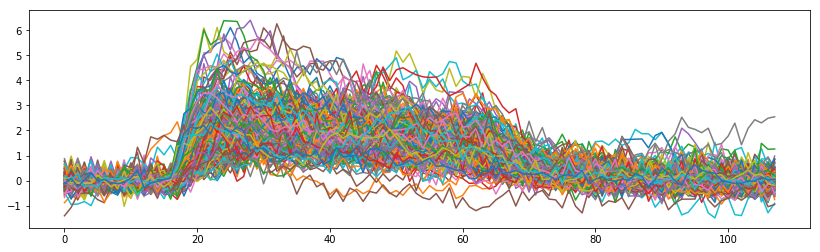

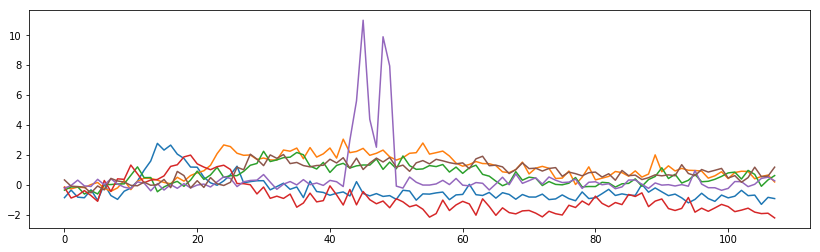

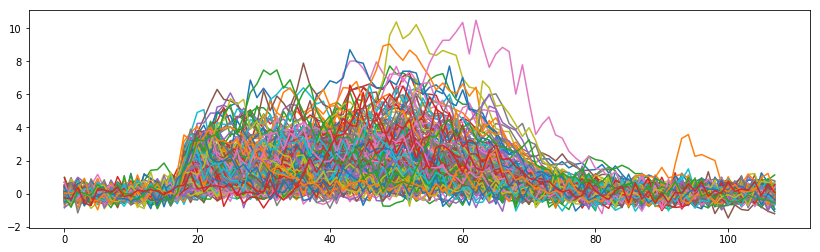

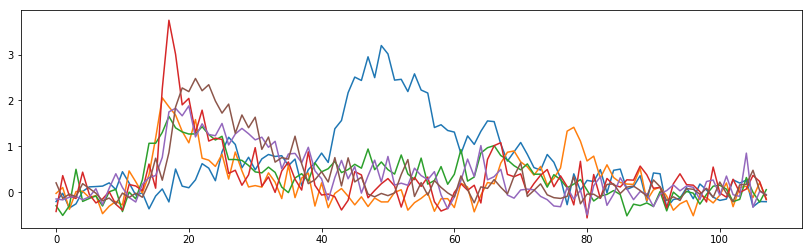

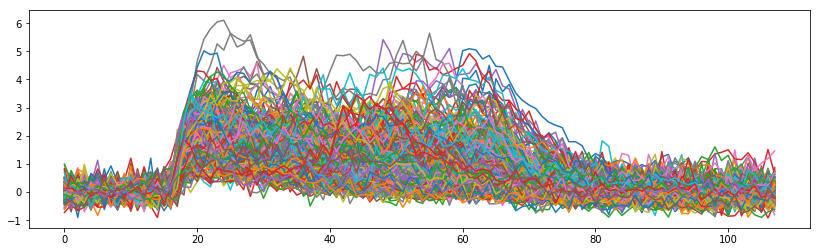

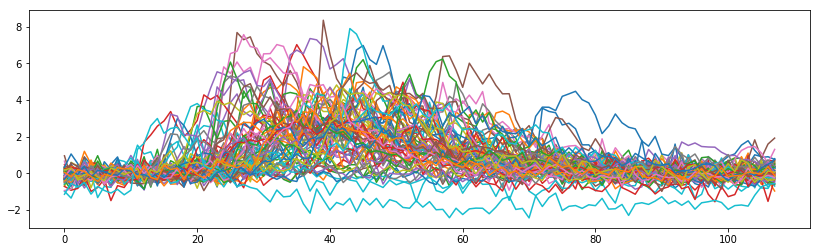

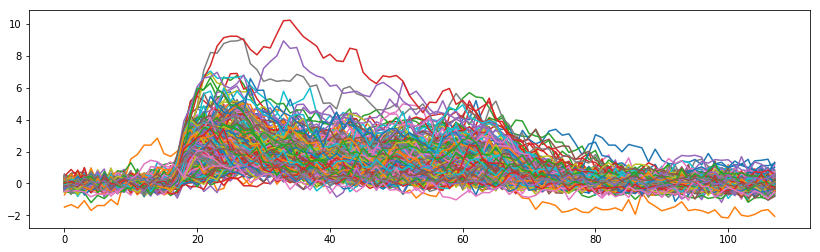

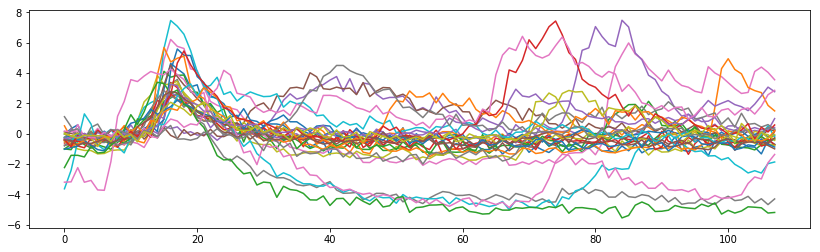

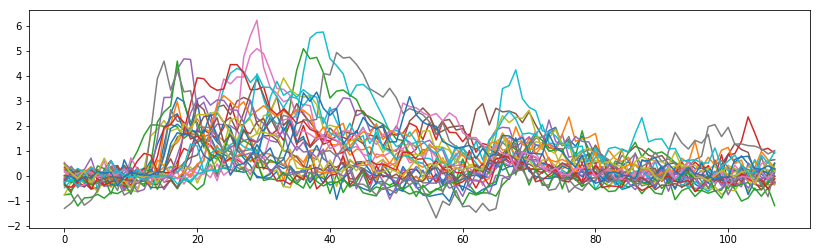

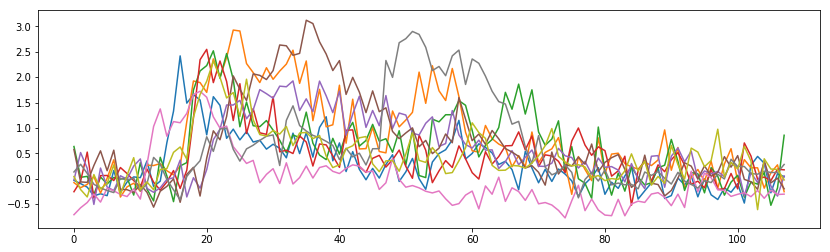

In [680]:
for compi in range(1,11):
    plt.figure(figsize=(14,4))
#     sns.heatmap(np.nanmean(thresh_list[0][compi], axis=0))
    thresh = np.nanstd(np.nanmean(thresh_list[0][compi], axis=0)[:15, :])*5
    mean_per_comp = np.nanmean(thresh_list[0][compi], axis=0)
    onsboo = np.nanmean(mean_per_comp[15:23, :], axis=0) > thresh
    susboo = np.nanmean(mean_per_comp[23:60, :], axis=0) > thresh
    plt.plot(mean_per_comp[:, susboo | onsboo])

# fit each date (rev/learn split)

In [597]:
fits2 = {}
daily_avg_dict2 = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list, meta_list):
    
    meti = _update_meta_date_vec(meti)
    A = _get_fitting_template_defaults(mi)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_wtrans_bool(meti)
    
    daily_avg_dict2[mi] = {}
    fits2[mi] = {}
    
    for c, comp_n in enumerate(proj.keys()):
        fits2[mi]['component_{}'.format(c+1)] = {}
        daily_avg_dict2[mi]['component_{}'.format(c+1)] = {}
        for ori in oris:
            cell_mat = np.zeros((proj[comp_n].shape[0], proj[comp_n].shape[1], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                cell_mat[:, :, dc] = np.nanmean(proj[comp_n][:, :, day_ori_bool], axis=2)
            all_tr = np.zeros((proj[comp_n].shape[0], A.shape[1], len(u_days)))
            for tr_n in range(cell_mat.shape[2]):
                for c_n in range(cell_mat.shape[0]):
                    b = deepcopy(cell_mat[c_n, :, tr_n])
                    b[b < 0] = 0
                    if np.sum(np.isnan(b)) == len(b):
                        sp_ans = np.zeros(4)
                        sp_ans[:] = np.nan
                        sp_ans = sp_ans
                    else:
                        sp_ans = sp.optimize.nnls(A, b)[0]
                    all_tr[c_n, :, tr_n] = sp_ans
            fits2[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = all_tr
            fits2[mi]['component_{}'.format(c+1)]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict2[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = cell_mat

    print('Making progress: {} done.'.format(mi))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


# plot sustainedness by day per group of cells

In [100]:
filt_n = 0
norm_please=True

filt_names = ['transientness', 'sustainedness']
for filt_n in range(2):
    for mi in ['OA27']:
        for oi in oris:
            for ci in range(1, 11):
                plt.figure()
                if norm_please:
                    mn = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :], axis=1)
                    mx = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :]/mn[:, None]
                    sns.heatmap(mx)
                    plt.title('{}: initial {}, comp {}, {}\n normalized {}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]))
                    plt.xlabel('day number')
                    plt.ylabel('cell number')
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}_norm.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
                else:
                    sns.heatmap(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :])
                    plt.title('{}: initial {}, comp {}, {}\n{}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]))
                    plt.xlabel('day number')
                    plt.ylabel('cell number')
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
            plt.close('all')

In [101]:
filt_n = 0
norm_please=False

filt_names = ['transientness', 'sustainedness']
for filt_n in range(2):
    for mi in ['OA27']:
        for oi in oris:
            for ci in range(1, 11):
                plt.figure()
                if norm_please:
                    mn = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :], axis=1)
                    mx = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :]/mn[:, None]
                    sns.heatmap(mx)
                    plt.title('{}: initial {}, comp {}, {}\n normalized {}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]))
                    plt.xlabel('day number')
                    plt.ylabel('cell number')
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}_norm.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
                else:
                    sns.heatmap(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :])
                    plt.title('{}: initial {}, comp {}, {}\n{}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]))
                    plt.xlabel('day number')
                    plt.ylabel('cell number')
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
            plt.close('all')

# plot only the best components (cells of those componenet anyway)

In [ ]:
filt_n = 0
norm_please=False

times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)

filt_names = ['transientness', 'sustainedness']
for filt_n in range(2):
    for mi, m1, met1, meti in zip(mice, model_list, model_meta_list, meta_list):
        
        # check group tuning
        o_max = []
        for oi in oris:
            o_max.append(np.max(np.abs(m1.results[rank][0].factors[2][met1['orientation'].isin([oi]).values, :]), axis=0))
        o_ind_max = np.argmax(np.vstack(o_max), axis=0)
        
        # check group shape, if offset is closer to stim than baseline throw it out
        secsec = np.mean(m1.results[rank][0].factors[1][32:48, :], axis=0)
        lastsec = np.mean(m1.results[rank][0].factors[1][-32:, :], axis=0)
        diffsec = np.round(lastsec/secsec) < 1
        
        # calculate change indices for days and reversal/learning
        dates = meti.reset_index()['date']
        udays = {d: c for c, d in enumerate(np.unique(dates))}
        ndays = np.diff([udays[i] for i in np.unique(dates)])
        day_x = np.where(ndays)[0] + 1

        # get your learning and reversal start indices 
        rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
        rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 1
        if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
            lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
            lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 1
        else:
            lear_ind = 0
        
        for oc, oi in enumerate(oris):
            for ci in range(1, 11):
                
                # check that temporal factor shape
                if not diffsec[ci-1]:
                    print('{} {} skipped: tempfac'.format(mi,ci))
                    continue
                    
                # check trial factor with largest amplitude 
                if o_ind_max[ci-1] != oc:
                    print('{} {} ori {} skipped: tuning'.format(mi,ci,oi))
                    continue
                
                fig = plt.figure(figsize=(10, 3))
                gs = fig.add_gridspec(100, 100)
                
                ax1 = fig.add_subplot(gs[:, :30])
                ax1.plot(m1.results[rank][0].factors[1][:, ci-1], color=color_dict[lookup_ori[mi][oi]], linewidth=3)
                ax1.set_title('temporal factor \n', size=16)
                ax1.set_xticks(timepts)
                ax1.set_xticklabels(times, size=12)
                ax1.tick_params(axis='both', which='major', labelsize=14)
                ax1.set_xlabel('time from stimulus onset (sec)', size=14)
                ax1.set_ylabel('response amplitude (AU)', size=14)
                sns.despine()
                
                ax2 = fig.add_subplot(gs[:, 40:])
                
                y_min = 0
                y_max = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)].shape[0]
                if len(day_x) > 0:
                    for k in day_x:
                        if k == lear_ind or k == rev_ind:
                            continue
                        ax2.plot([k, k], [y_min, y_max], color=color_dict['gray'], linewidth=1)
                ax2.plot([lear_ind, lear_ind], [y_min, y_max], '--', color=color_dict['learning'], linewidth=2)
                ax2.plot([rev_ind, rev_ind], [y_min, y_max], '--', color=color_dict['reversal'], linewidth=2)

                if norm_please:
                    mn = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :], axis=1)
                    mx = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :]/mn[:, None]
                    if np.isnan(np.nanmean(mx.flatten())):
                        continue
                    sns.heatmap(mx, ax=ax2)
                    ax2.set_title('{}: initial {}, comp {}, {}\n normalized {}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]), size=16)
                    ax2.set_xlabel('day number', size=14)
                    ax2.set_ylabel('cell number', size=14)
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}_norm.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
                else:
                    sns.heatmap(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :], ax=ax2)
                    ax2.set_title('{}: initial {}, comp {}, {}\n{}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]), size=16)
                    ax2.set_xlabel('day number', size=14)
                    ax2.set_ylabel('cell number', size=14)
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
            plt.close('all')

# plot only the best components with 0.5 date splits (cells of those componenet anyway)

In [ ]:
filt_n = 0
norm_please=False

times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)

filt_names = ['transientness', 'sustainedness']
for filt_n in range(2):
    for mi, m1, met1, meti in zip(mice, model_list, model_meta_list, meta_list):
        
        # 0.5 for transition days
        meti = _update_meta_date_vec(meti)
        
        # check group tuning
        o_max = []
        for oi in oris:
            o_max.append(np.max(np.abs(m1.results[rank][0].factors[2][met1['orientation'].isin([oi]).values, :]), axis=0))
        o_ind_max = np.argmax(np.vstack(o_max), axis=0)
        
        # check group shape, if offset is closer to stim than baseline throw it out
        secsec = np.mean(m1.results[rank][0].factors[1][32:48, :], axis=0)
        lastsec = np.mean(m1.results[rank][0].factors[1][-32:, :], axis=0)
        diffsec = np.round(lastsec/secsec) < 1
        
        # calculate change indices for days and reversal/learning
        dates = meti.reset_index()['date']
        udays = {d: c for c, d in enumerate(np.unique(dates))}
        ndays = np.diff([udays[i] for i in np.unique(dates)])
        day_x = np.where(ndays)[0] + 1

        # get your learning and reversal start indices 
        rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
        rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 1
        if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
            lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
            lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 1
        else:
            lear_ind = 0
        
        for oc, oi in enumerate(oris):
            for ci in range(1, 11):
                
                # check that temporal factor shape
                if not diffsec[ci-1]:
                    print('{} {} skipped: tempfac'.format(mi,ci))
                    continue
                    
                # check trial factor with largest amplitude 
                if o_ind_max[ci-1] != oc:
                    print('{} {} ori {} skipped: tuning'.format(mi,ci,oi))
                    continue
                
                fig = plt.figure(figsize=(10, 3))
                gs = fig.add_gridspec(100, 100)
                
                ax1 = fig.add_subplot(gs[:, :30])
                ax1.plot(m1.results[rank][0].factors[1][:, ci-1], color=color_dict[lookup_ori[mi][oi]], linewidth=3)
                ax1.set_title('temporal factor \n', size=16)
                ax1.set_xticks(timepts)
                ax1.set_xticklabels(times, size=12)
                ax1.tick_params(axis='both', which='major', labelsize=14)
                ax1.set_xlabel('time from stimulus onset (sec)', size=14)
                ax1.set_ylabel('response amplitude (AU)', size=14)
                sns.despine()
                
                ax2 = fig.add_subplot(gs[:, 40:])
                
                y_min = 0
                y_max = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)].shape[0]
                if len(day_x) > 0:
                    for k in day_x:
                        if k == lear_ind or k == rev_ind:
                            continue
                        ax2.plot([k, k], [y_min, y_max], color=color_dict['gray'], linewidth=1)
                ax2.plot([lear_ind, lear_ind], [y_min, y_max], '--', color=color_dict['learning'], linewidth=2)
                ax2.plot([rev_ind, rev_ind], [y_min, y_max], '--', color=color_dict['reversal'], linewidth=2)

                if norm_please:
                    mn = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :], axis=1)
                    mx = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :]/mn[:, None]
                    if np.isnan(np.nanmean(mx.flatten())):
                        continue
                    sns.heatmap(mx, ax=ax2)
                    ax2.set_title('{}: initial {}, comp {}, {}\n normalized {}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]), size=16)
                    ax2.set_xlabel('day number', size=14)
                    ax2.set_ylabel('cell number', size=14)
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}_norm.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
                else:
                    sns.heatmap(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(oi)][:, filt_n, :], ax=ax2)
                    ax2.set_title('{}: initial {}, comp {}, {}\n{}\n'.format(mi, lookup_ori[mi][oi], ci, words[0], filt_names[filt_n]), size=16)
                    ax2.set_xlabel('day number', size=14)
                    ax2.set_ylabel('cell number', size=14)
                    plt.savefig('{}_{}_initial_{}_comp_{}_{}.pdf'.format(mi, words[0], lookup_ori[mi][oi], ci, filt_names[filt_n]), bbox_inches='tight')
            plt.close('all')

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning: divide by zero encountered in true_divide


OA27 1 skipped: tempfac
OA27 2 ori 0 skipped: tuning
OA27 3 ori 0 skipped: tuning
OA27 5 skipped: tempfac
OA27 7 skipped: tempfac
OA27 8 ori 0 skipped: tuning
OA27 9 ori 0 skipped: tuning
OA27 10 ori 0 skipped: tuning
OA27 1 skipped: tempfac
OA27 4 ori 135 skipped: tuning
OA27 5 skipped: tempfac
OA27 6 ori 135 skipped: tuning
OA27 7 skipped: tempfac
OA27 8 ori 135 skipped: tuning
OA27 9 ori 135 skipped: tuning
OA27 10 ori 135 skipped: tuning
OA27 1 skipped: tempfac
OA27 2 ori 270 skipped: tuning
OA27 3 ori 270 skipped: tuning
OA27 4 ori 270 skipped: tuning
OA27 5 skipped: tempfac
OA27 6 ori 270 skipped: tuning
OA27 7 skipped: tempfac
VF226 1 skipped: tempfac
VF226 2 ori 0 skipped: tuning
VF226 3 skipped: tempfac
VF226 4 ori 0 skipped: tuning
VF226 5 ori 0 skipped: tuning
VF226 6 skipped: tempfac
VF226 8 ori 0 skipped: tuning
VF226 10 ori 0 skipped: tuning
VF226 1 skipped: tempfac
VF226 2 ori 135 skipped: tuning
VF226 3 skipped: tempfac
VF226 6 skipped: tempfac
VF226 7 ori 135 skipped: 

In [163]:
udays

{170116.0: 0,
 170118.0: 1,
 170119.0: 2,
 170204.0: 3,
 170206.0: 4,
 170207.0: 5,
 170208.0: 6,
 170209.0: 7,
 170210.0: 8,
 170211.0: 9,
 170214.0: 10,
 170215.0: 11,
 170216.0: 12,
 170217.0: 13,
 170220.0: 14,
 170223.0: 15,
 170224.0: 16,
 170303.0: 17,
 170308.0: 18,
 170318.0: 19,
 170318.5: 20,
 170320.0: 21,
 170321.0: 22,
 170322.0: 23,
 170323.0: 24,
 170326.0: 25,
 170328.0: 26,
 170403.0: 27,
 170404.0: 28}

# build a stage heatmap across all mice

In [613]:
# variables to change
norm_please=False
by_stage=True

# make lookup dictionary of stage and dprime for each day
daily_stage_dict = {}
daily_dp_dict = {}
for mi, meti in zip(mice, meta_list):
    # add useful variables for further plotting
    meti = cas.utils.add_dprime_to_meta(meti)
    meti = _update_meta_date_vec(meti)
    u_days = np.unique(meti.reset_index()['date'])
    all_days = meti.reset_index()['date'].values
    ls = meti['learning_state'].values
    dp = meti['dprime'].values
    dp_vec = np.zeros((len(u_days)))
    ls_vec = []
    for dc, day_i in enumerate(u_days):
        day_bool = (all_days == day_i)
        ls_vec.append(np.unique(ls[day_bool])[0]) 
        dp_vec[dc] = np.unique(dp[day_bool])
    daily_stage_dict[mi] = ls_vec
    daily_dp_dict[mi] = dp_vec

# hardcoded variable for tempofac plotting
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)

filt_names = ['transientness', 'sustainedness']
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
sus_list = []
trans_list = []
mouse_vec, comp_vec, clus_vec = [], [], []
clusi = 0
for mi, m1, met1, meti in zip(mice, model_list, model_meta_list, meta_list):
    
    # daily stage and dprime
    lsi = daily_stage_dict[mi]
    dpi = daily_dp_dict[mi]
    
    # 0.5 for transition days
    meti = _update_meta_date_vec(meti)

    # check group tuning
    o_max = []
    for oi in oris:
        o_max.append(np.max(np.abs(m1.results[rank][0].factors[2][met1['orientation'].isin([oi]).values, :]), axis=0))
    o_ind_max = np.argmax(np.vstack(o_max), axis=0)

    # check group shape, if offset is closer to stim than baseline throw it out
    secsec = np.mean(m1.results[rank][0].factors[1][32:48, :], axis=0)
    lastsec = np.mean(m1.results[rank][0].factors[1][-32:, :], axis=0)
    diffsec = np.round(lastsec/secsec) < 1

    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    udays = {d: c for c, d in enumerate(np.unique(dates))}
    ndays = np.diff([udays[i] for i in np.unique(dates)])
    day_x = np.where(ndays)[0] + 1

    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 1
    if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
        lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
        lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 1
    else:
        lear_ind = 0

    trans_list_oris, sus_list_oris = [], []
    for oc, oi in enumerate(['plus', 'neutral', 'minus',]):
        trans_list_bloc, sus_list_bloc = [], []
        for ci in range(1, 11):
            
            # check that temporal factor shape
            if not diffsec[ci-1]:
                print('{} {} skipped: tempfac'.format(mi,ci))
                continue

            # check trial factor with largest amplitude 
#                 if o_ind_max[ci-1] != oc:
#                     print('{} {} ori {}:{} skipped: tuning'.format(mi,ci,lookup[mi][oi],oi))
#                     continue

            tempofac = m1.results[rank][0].factors[1][:, ci-1]
#             if norm_please:
#                 mn_trans = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 0, :], axis=1)[:, None]
#                 mn_sus = np.nanmax(fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 1, :], axis=1)[:, None]
#             else:
            mn_trans = 1
            mn_sus = 1
            mx_trans = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 0, :]/mn_trans
            mx_sus = fits2[mi]['component_{}'.format(ci)]['ori_{}'.format(lookup[mi][oi])][:, 1, :]/mn_sus
            
            if by_stage:
                # take mean sus/trans value by stage of learning
                mx_trans_stage = np.zeros((mx_sus.shape[0], len(stages)))
                mx_trans_stage[:] = np.nan
                mx_sus_stage = np.zeros((mx_sus.shape[0], len(stages)))
                mx_sus_stage[:] = np.nan
                for si, sti in enumerate(stages):
                    if 'naive' in sti:
                        stabool = np.array([s == 'naive' for s in lsi])
                    elif 'learning' in sti:
                        stabool = np.array([s == 'learning' for s in lsi])
                        if 'low_dp' in sti:
                            dbool = dpi < 2
                        elif 'high_dp' in sti:
                            dbool = dpi >= 2
                        stabool = stabool & dbool
                    elif 'reversal1' in sti:
                        stabool = np.array([s == 'reversal1' for s in lsi])
                        if 'low_dp' in sti:
                            dbool = dpi < 2
                        elif 'high_dp' in sti:
                            dbool = dpi >= 2
                        stabool = stabool & dbool
                    
                    
                    mx_trans_stage[:, si] = np.nanmean(mx_trans[:, stabool], axis=1)
                    mx_sus_stage[:, si] = np.nanmean(mx_sus[:, stabool], axis=1)
                    
                trans_list_bloc.append(mx_trans_stage)
                sus_list_bloc.append(mx_sus_stage)
            else:
                trans_list_bloc.append(mx_trans)
                sus_list_bloc.append(mx_sus)
                
                        # make component-mouse vectors
            if oc == 0:
                mouse_vec.extend([mi]*mx_sus.shape[0])
                comp_vec.extend([ci]*mx_sus.shape[0])
                clus_vec.extend([clusi]*mx_sus.shape[0])
                clusi +=1

        trans_list_oris.append(np.vstack(trans_list_bloc))
        sus_list_oris.append(np.vstack(sus_list_bloc))

    trans_list.append(np.hstack(trans_list_oris))
    sus_list.append(np.hstack(sus_list_oris))

trans_stack = np.vstack(trans_list)
sus_stack = np.vstack(sus_list)
combo_stack = np.hstack([trans_stack, sus_stack])

if norm_please:
    combo_stack = combo_stack/np.nanmax(combo_stack, axis=1)[:, None]
    trans_stack = trans_stack/np.nanmax(trans_stack, axis=1)[:, None]
    sus_stack = sus_stack/np.nanmax(sus_stack, axis=1)[:, None]

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:120: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:121: RuntimeWarning: Mean of empty slice


OA27 2 skipped: tempfac
OA27 4 skipped: tempfac
OA27 6 skipped: tempfac
OA27 8 skipped: tempfac
OA27 9 skipped: tempfac
OA27 10 skipped: tempfac
OA27 2 skipped: tempfac
OA27 4 skipped: tempfac
OA27 6 skipped: tempfac
OA27 8 skipped: tempfac
OA27 9 skipped: tempfac
OA27 10 skipped: tempfac
OA27 2 skipped: tempfac
OA27 4 skipped: tempfac
OA27 6 skipped: tempfac
OA27 8 skipped: tempfac
OA27 9 skipped: tempfac
OA27 10 skipped: tempfac
VF226 1 skipped: tempfac
VF226 4 skipped: tempfac
VF226 5 skipped: tempfac
VF226 6 skipped: tempfac
VF226 7 skipped: tempfac
VF226 8 skipped: tempfac
VF226 9 skipped: tempfac
VF226 10 skipped: tempfac
VF226 1 skipped: tempfac
VF226 4 skipped: tempfac
VF226 5 skipped: tempfac
VF226 6 skipped: tempfac
VF226 7 skipped: tempfac
VF226 8 skipped: tempfac
VF226 9 skipped: tempfac
VF226 10 skipped: tempfac
VF226 1 skipped: tempfac
VF226 4 skipped: tempfac
VF226 5 skipped: tempfac
VF226 6 skipped: tempfac
VF226 7 skipped: tempfac
VF226 8 skipped: tempfac
VF226 9 skipp

In [614]:
df1 = pd.DataFrame(data=combo_stack, index=pd.MultiIndex.from_arrays([mouse_vec, comp_vec, clus_vec], names=['mouse', 'component', 'cell_group']))
av_df = df1.groupby(['mouse', 'component', 'cell_group']).mean()

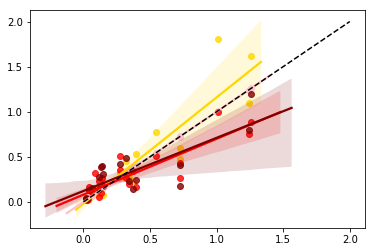

In [656]:
av_combo = av_df.values
alpha =0.5
modi=10
sns.regplot(x=av_combo[:, np.array([2+modi])].flatten(), y=av_combo[:, np.array([1+modi])].flatten(), color='gold')
sns.regplot(x=av_combo[:, np.array([2+modi])].flatten(), y=av_combo[:, np.array([2+modi])].flatten(), color='pink')
sns.regplot(x=av_combo[:, np.array([2+modi])].flatten(), y=av_combo[:, np.array([3+modi])].flatten(), color='red')
sns.regplot(x=av_combo[:, np.array([2+modi])].flatten(), y=av_combo[:, np.array([4+modi])].flatten(), color='maroon')
plt.plot([0, 2], [0, 2], '--k')

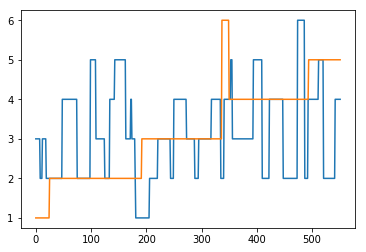

In [562]:
plt.plot(expanded_clus_vec)
plt.plot(new_sort_expanded_clusters[expanded_sorter])

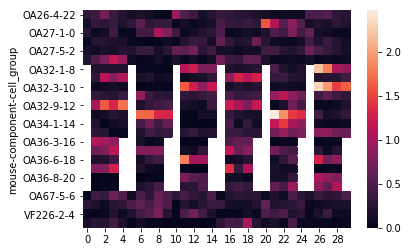

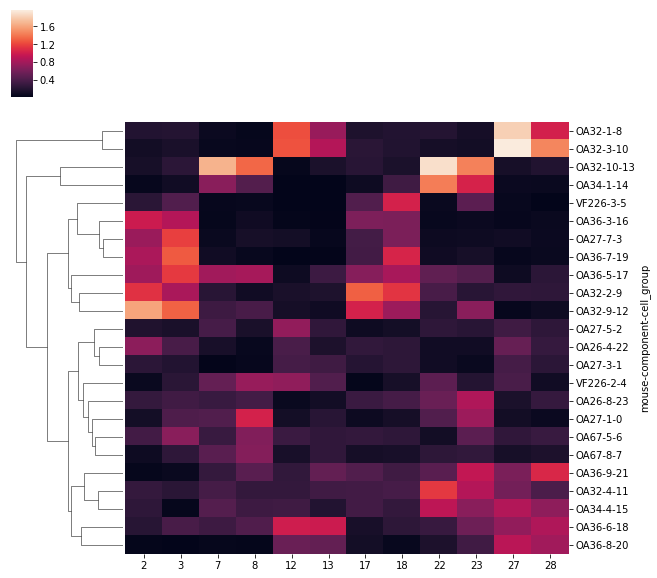

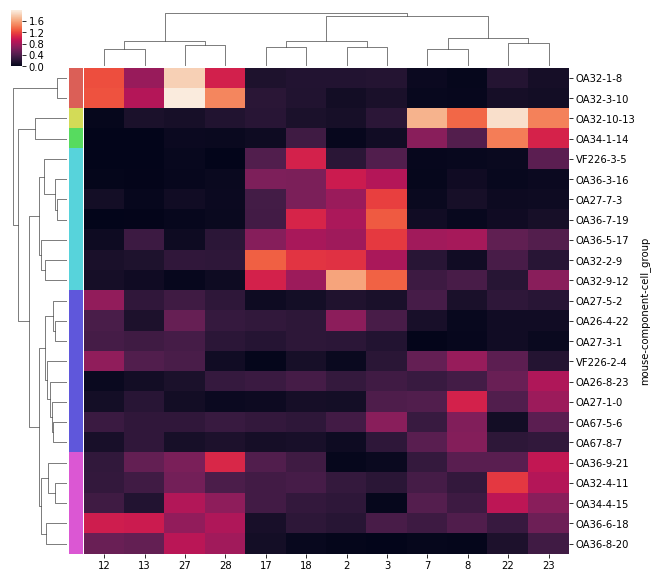

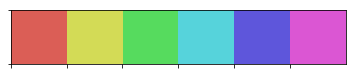

In [616]:
test = pd.DataFrame(data=combo_stack, index=pd.MultiIndex.from_arrays([mouse_vec, comp_vec, clus_vec], names=['mouse', 'component', 'cell_group']))
mtest = test.groupby(['mouse', 'component', 'cell_group']).mean()
sns.heatmap(mtest)
drop_cols = [0, 1, 4, 5, 6, 9, 10, 11, 14]
drop_cols.extend(np.array([0, 1, 4, 5, 6, 9, 10, 11, 14])+15)
sort_klug = mtest.drop(columns=drop_cols)
# sort_klug = mtest.drop(columns=[0, 4, 5, 9, 10, 14])
sort_klug[np.isnan(sort_klug)] = -0.1
g = sns.clustermap(sort_klug, col_cluster=False,)# method='ward')
new_sort1 = g.dendrogram_row.reordered_ind

# get sorted component-blocks 
new_sort2 = mtest.reset_index()['cell_group'].loc[new_sort1]

# component block sorting expanded to all cells
new_sort3 = [[s]*np.sum(np.array(clus_vec) == s) for s in new_sort2]

# cluster to get cluster color labels for each component
cluster_number = 6
row_sorter = g.dendrogram_row.reordered_ind
clusters = hierarchy.fcluster(
    g.dendrogram_row.linkage, cluster_number, criterion='maxclust')
cluster_color_options = sns.color_palette('hls', cluster_number)
cluster_colors = [cluster_color_options[i-1] for i in clusters]
clusters
cas.plotting.cluster.clustermap(sort_klug, row_colors=cluster_colors)
sns.palplot(cluster_color_options)
np.unique(clusters)
# good_clusters = [1, 2, 5]

# component clusters expanded to all cells
cell_uclus = list(np.unique(clus_vec))
new_sort_expanded_clusters = [clusters[s] for s in clus_vec]
new_sort_expanded_clusters = np.array(new_sort_expanded_clusters)
expanded_clus_vec = []
for s in new_sort2:
    sbool = np.array(clus_vec) == s
    expanded_clus_vec.extend(new_sort_expanded_clusters[sbool])
expanded_clus_vec = np.array(expanded_clus_vec)

# get a single sorting vector
expanded_sorter = []
sorter_vec = np.arange(combo_stack.shape[0])
for s in new_sort1:
    sbool = np.array(clus_vec) == s
    expanded_sorter.extend(sorter_vec[sbool])
expanded_sorter1 = np.array(expanded_sorter)

# get a single sorting vector
expanded_sorter = []
sorter_vec = np.arange(combo_stack.shape[0])
for s in new_sort2:
    sbool = np.array(clus_vec) == s
    expanded_sorter.extend(sorter_vec[sbool])
expanded_sorter2 = np.array(expanded_sorter)

# these better be the same size!
assert len(expanded_sorter) == combo_stack.shape[0]

In [ ]:
expanded_clus_vec

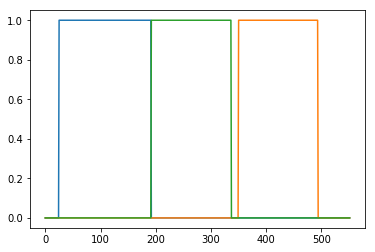

In [569]:
for ki in clus_blocks_bool_dict:
    plt.plot(clus_blocks_bool_dict[ki])

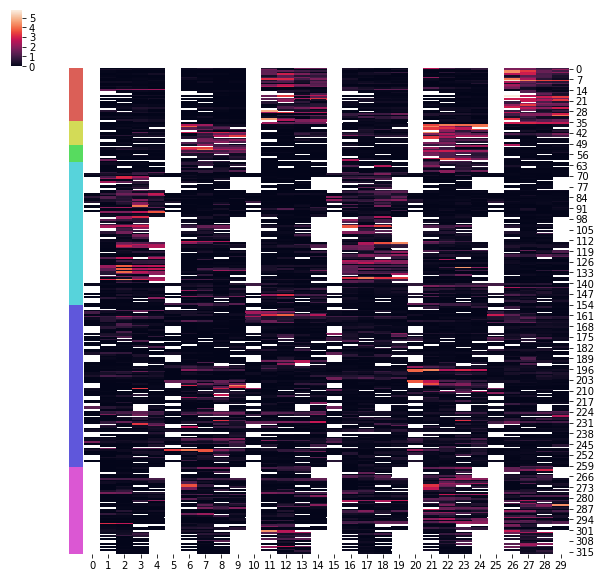

In [623]:
cluster_colors2 = [cluster_color_options[i-1] for i in new_sort_expanded_clusters[expanded_sorter1]]
cas.plotting.cluster.clustermap(combo_stack[expanded_sorter2, :], row_cluster=False, col_cluster=False, row_colors=cluster_colors2)

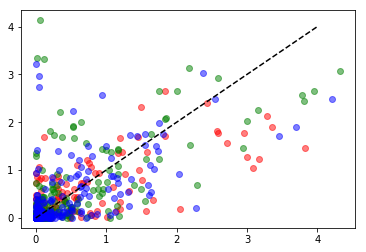

In [639]:
alpha =0.5
plt.plot(combo_stack[:, np.array([12])], combo_stack[:, np.array([13])], 'ro', alpha=alpha)
plt.plot(combo_stack[:, np.array([2])], combo_stack[:, np.array([3])], 'go', alpha=alpha)
plt.plot(combo_stack[:, np.array([7])], combo_stack[:, np.array([8])], 'bo', alpha=alpha)
plt.plot([0, 4], [0, 4], '--k')

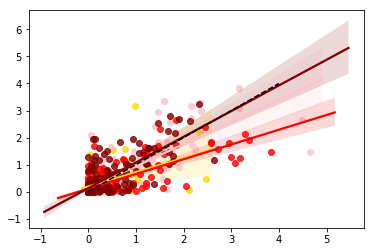

In [636]:
alpha =0.5
# plt.plot(combo_stack[:, np.array([12])], combo_stack[:, np.array([14])], 'ro', alpha=alpha)
sns.regplot(x=combo_stack[:, np.array([10])].flatten(), y=combo_stack[:, np.array([11])].flatten(), color='gold')
sns.regplot(x=combo_stack[:, np.array([11])].flatten(), y=combo_stack[:, np.array([12])].flatten(), color='pink')
sns.regplot(x=combo_stack[:, np.array([12])].flatten(), y=combo_stack[:, np.array([13])].flatten(), color='red')
sns.regplot(x=combo_stack[:, np.array([13])].flatten(), y=combo_stack[:, np.array([14])].flatten(), color='maroon')
# plt.plot(combo_stack[:, np.array([17])], combo_stack[:, np.array([18])], 'go', alpha=alpha)
# plt.plot(combo_stack[:, np.array([7])], combo_stack[:, np.array([8])], 'bo', alpha=alpha)
plt.plot([0, 4], [0, 4], '--k')

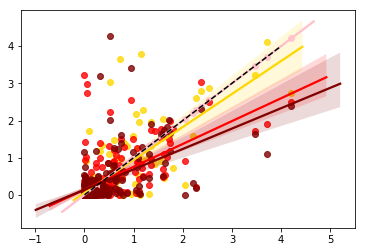

In [647]:
alpha =0.5
modi=5
# plt.plot(combo_stack[:, np.array([12])], combo_stack[:, np.array([14])], 'ro', alpha=alpha)
sns.regplot(x=trans_stack[:, np.array([2+modi])].flatten(), y=trans_stack[:, np.array([1+modi])].flatten(), color='gold')
sns.regplot(x=trans_stack[:, np.array([2+modi])].flatten(), y=trans_stack[:, np.array([2+modi])].flatten(), color='pink')
sns.regplot(x=trans_stack[:, np.array([2+modi])].flatten(), y=trans_stack[:, np.array([3+modi])].flatten(), color='red')
sns.regplot(x=trans_stack[:, np.array([2+modi])].flatten(), y=trans_stack[:, np.array([4+modi])].flatten(), color='maroon')
# plt.plot(combo_stack[:, np.array([17])], combo_stack[:, np.array([18])], 'go', alpha=alpha)
# plt.plot(combo_stack[:, np.array([7])], combo_stack[:, np.array([8])], 'bo', alpha=alpha)
plt.plot([0, 4], [0, 4], '--k')

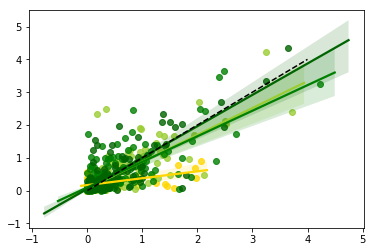

In [648]:
alpha =0.5
modi=0
# plt.plot(combo_stack[:, np.array([12])], combo_stack[:, np.array([14])], 'ro', alpha=alpha)
sns.regplot(x=sus_stack[:, np.array([0+modi])].flatten(), y=sus_stack[:, np.array([1+modi])].flatten(), color='gold')
sns.regplot(x=sus_stack[:, np.array([1+modi])].flatten(), y=sus_stack[:, np.array([2+modi])].flatten(), color='yellowgreen')
sns.regplot(x=sus_stack[:, np.array([2+modi])].flatten(), y=sus_stack[:, np.array([3+modi])].flatten(), color='green')
sns.regplot(x=sus_stack[:, np.array([3+modi])].flatten(), y=sus_stack[:, np.array([4+modi])].flatten(), color='darkgreen')
# plt.plot(combo_stack[:, np.array([17])], combo_stack[:, np.array([18])], 'go', alpha=alpha)
# plt.plot(combo_stack[:, np.array([7])], combo_stack[:, np.array([8])], 'bo', alpha=alpha)
plt.plot([0, 4], [0, 4], '--k')

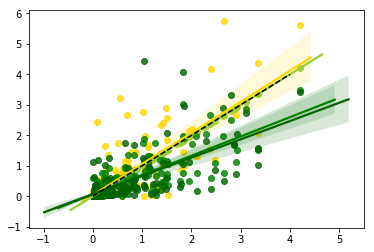

In [652]:
alpha =0.5
modi=10
# plt.plot(combo_stack[:, np.array([12])], combo_stack[:, np.array([14])], 'ro', alpha=alpha)
sns.regplot(x=sus_stack[:, np.array([2+modi])].flatten(), y=sus_stack[:, np.array([1+modi])].flatten(), color='gold')
sns.regplot(x=sus_stack[:, np.array([2+modi])].flatten(), y=sus_stack[:, np.array([2+modi])].flatten(), color='yellowgreen')
sns.regplot(x=sus_stack[:, np.array([2+modi])].flatten(), y=sus_stack[:, np.array([3+modi])].flatten(), color='green')
sns.regplot(x=sus_stack[:, np.array([2+modi])].flatten(), y=sus_stack[:, np.array([4+modi])].flatten(), color='darkgreen')
# plt.plot(combo_stack[:, np.array([17])], combo_stack[:, np.array([18])], 'go', alpha=alpha)
# plt.plot(combo_stack[:, np.array([7])], combo_stack[:, np.array([8])], 'bo', alpha=alpha)
plt.plot([0, 4], [0, 4], '--k')

In [492]:
len(expanded_clus_vec)

552

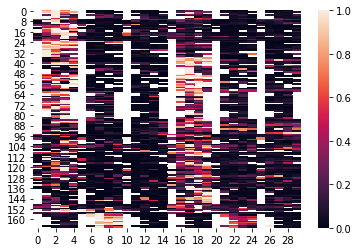

In [575]:
clus_block_lookup = {'plus': 2, 'neutral': 3, 'minus': 4}
clus_blocks_bool_dict = {'plus': [], 'minus': [], 'neutral': []}
for ki in clus_block_lookup:
    clus_blocks_bool_dict[ki] = np.isin(new_sort_expanded_clusters[expanded_sorter1], clus_block_lookup[ki])
sns.heatmap(combo_stack[expanded_sorter2, :][clus_blocks_bool_dict['plus'], :])

Text(0.5, 1.0, 'sus chunked by sorted compoenents')

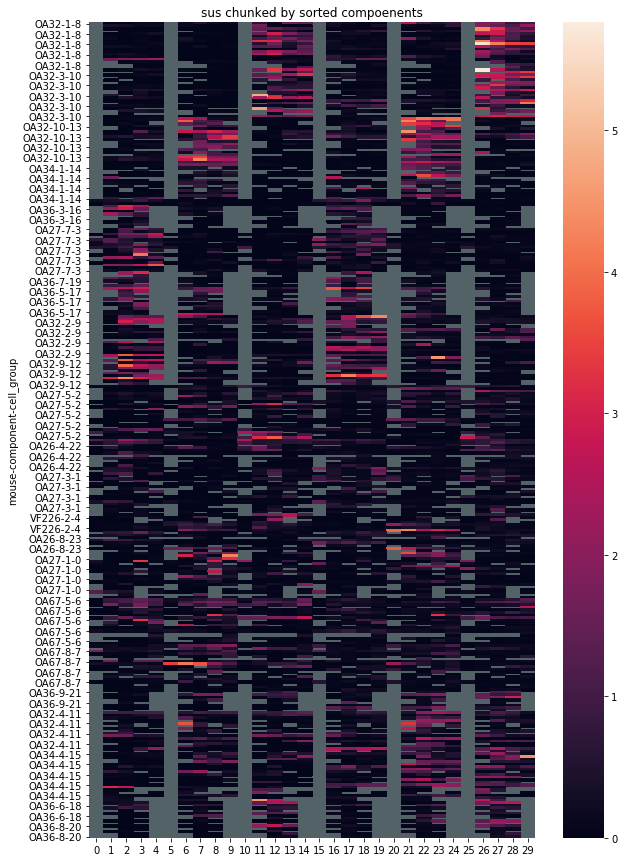

In [624]:
sorted_list = []
for s in new_sort2:
    sbool = np.array(clus_vec) == s
    sorted_list.append(test.iloc[sbool, :])
new_sort_df = pd.concat(sorted_list, axis=0)

plt.figure(figsize=(10,15))
mask = new_sort_df.isna()
g = sns.heatmap(new_sort_df, mask=mask)
g.set_facecolor('xkcd:gunmetal')
plt.title('sus chunked by sorted compoenents')
# plt.savefig('rebel_all_cell_sus_trans_sorted_by_sus_chunks.pdf', bbox_inches='tight')

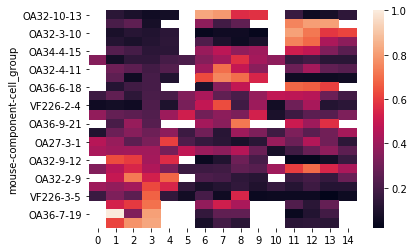

In [304]:
new_df = mtest.sort_values(by=[3, 2, 12, 13, 7, 8]) #1, 6, 11, 4, 9, 14, 0, 5, 10
sns.heatmap(new_df)

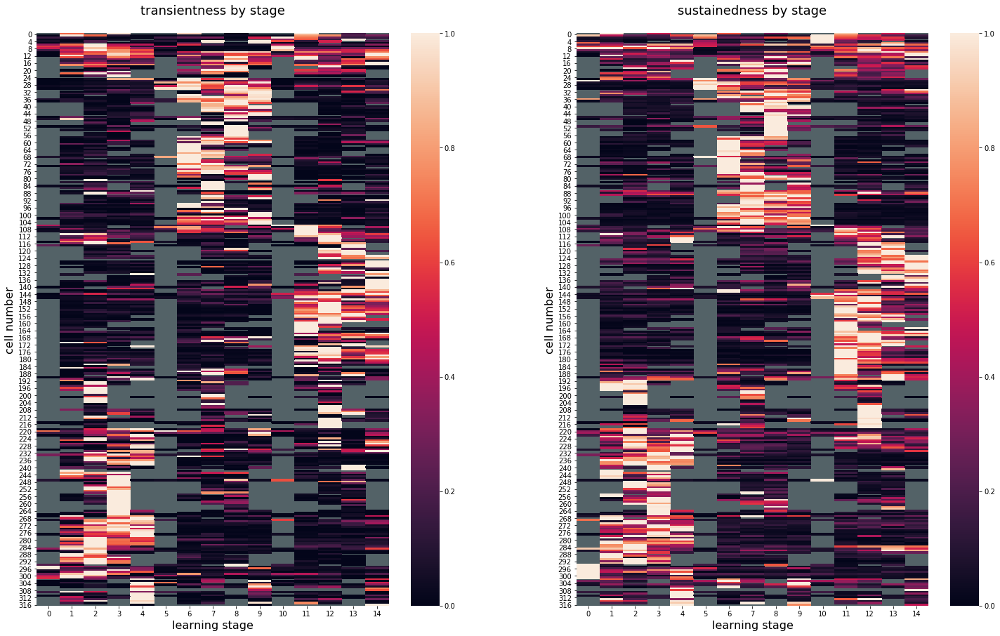

In [321]:
fig = plt.figure(figsize=(25, 15))
gs = fig.add_gridspec(100, 100)
ax1 = fig.add_subplot(gs[:, :45])
ax2 = fig.add_subplot(gs[:, 55:])
# plt.figure(figsize=(20,15))
mask = np.isnan(trans_stack[sorter, :])
g = sns.heatmap(trans_stack[sorter, :], mask=mask, ax=ax1)
g.set_facecolor('xkcd:gunmetal')
ax1.set_title('transientness by stage\n', size=18)
ax1.set_xlabel('learning stage', size=16)
ax1.set_ylabel('cell number', size=16)

# plt.figure(figsize=(10,15))
mask = np.isnan(sus_stack[sorter, :])
g = sns.heatmap(sus_stack[sorter, :], mask=mask, ax=ax2)
g.set_facecolor('xkcd:gunmetal')
ax2.set_title('sustainedness by stage\n', size=18)
ax2.set_xlabel('learning stage', size=16)
ax2.set_ylabel('cell number', size=16)

plt.savefig('rebel_all_cell_sus_trans_sorted_by_trans_cells.pdf', bbox_inches='tight')

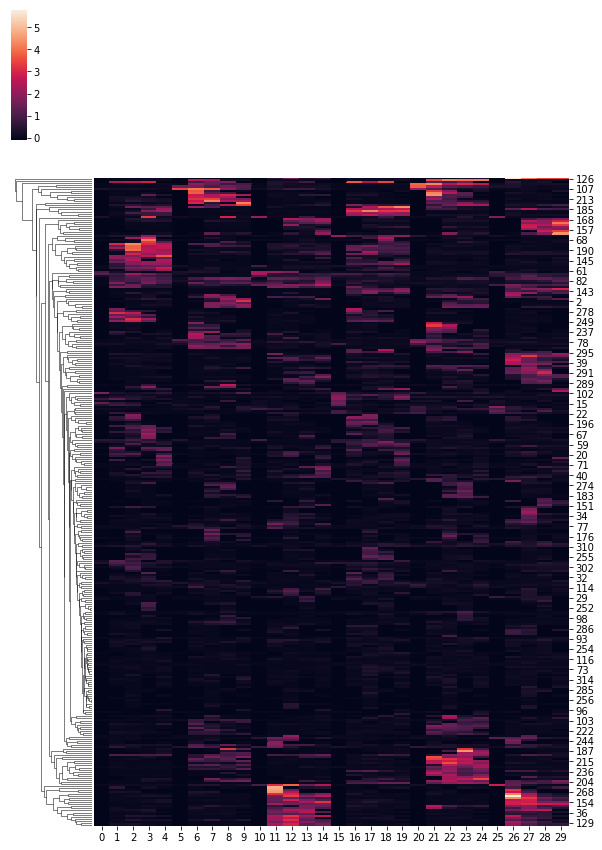

In [622]:
ak = deepcopy(combo_stack)
ak[np.isnan(ak)] = -.1
g = sns.clustermap(ak, figsize=(10,15), col_cluster=False)
sorter = g.dendrogram_row.reordered_ind

In [325]:
combo_stack.shape

(317, 30)

In [335]:
combo_stack.shape

(552, 30)

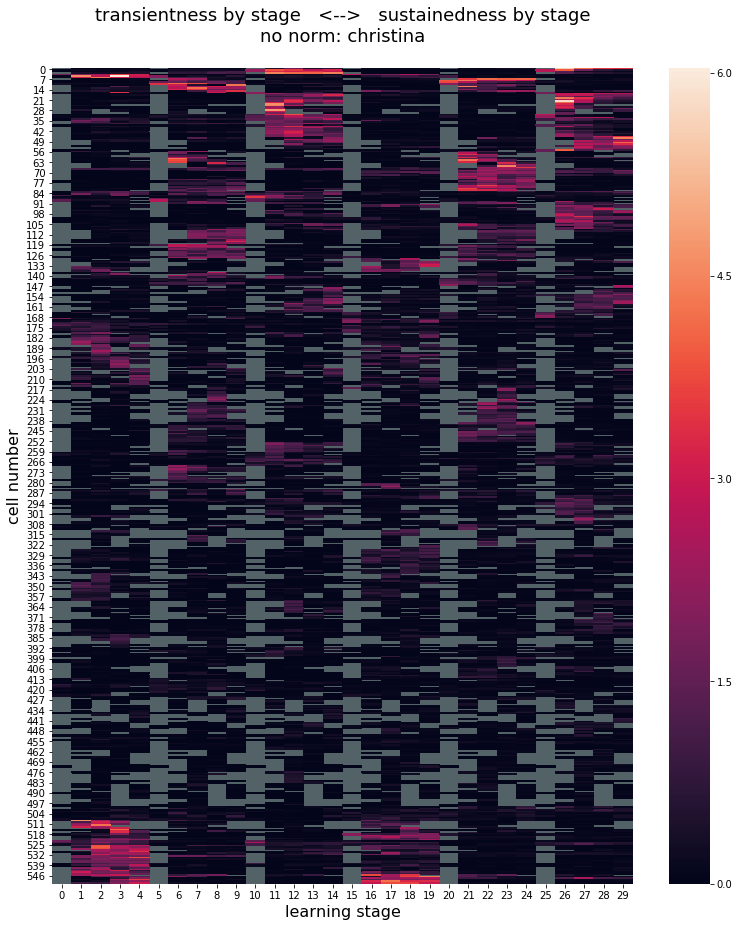

In [347]:
fig = plt.figure(figsize=(13, 15))
gs = fig.add_gridspec(100, 100)
ax1 = fig.add_subplot(gs[:, :])
# ax2 = fig.add_subplot(gs[:, 55:])
# plt.figure(figsize=(20,15))
mask = np.isnan(combo_stack[sorter, :])
g = sns.heatmap(combo_stack[sorter, :], mask=mask, ax=ax1)
g.set_facecolor('xkcd:gunmetal')
ax1.set_title('transientness by stage   <-->   sustainedness by stage\nno norm: christina\n', size=18)
ax1.set_xlabel('learning stage', size=16)
ax1.set_ylabel('cell number', size=16)

plt.savefig('christina_all_cell_sus_trans_sorted_by_all30cols_nonorm_cells.pdf', bbox_inches='tight')

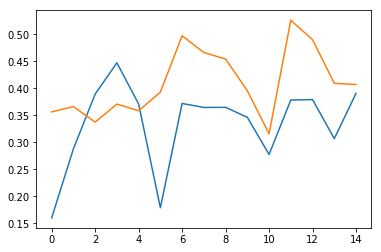

In [619]:
plt.plot(np.nanmean(trans_stack, axis=0))
plt.plot(np.nanmean(sus_stack, axis=0))
# plt.plot(np.nanmean(combo_stack, axis=0))

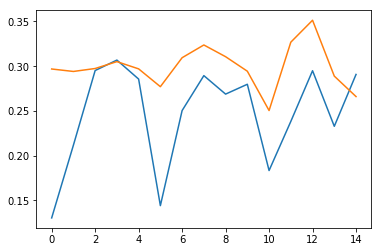

In [313]:
plt.plot(np.nanmean(trans_stack, axis=0))
plt.plot(np.nanmean(sus_stack, axis=0))


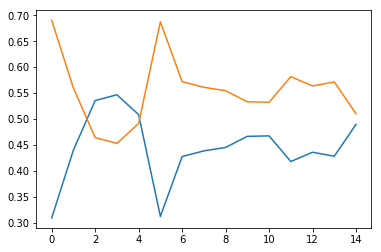

In [621]:
plt.plot(np.nanmean(trans_stack, axis=0)/(np.nanmean(sus_stack, axis=0)+np.nanmean(trans_stack, axis=0)))
plt.plot(np.nanmean(sus_stack, axis=0)/(np.nanmean(sus_stack, axis=0)+np.nanmean(trans_stack, axis=0)))

# correlation of stages 

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()


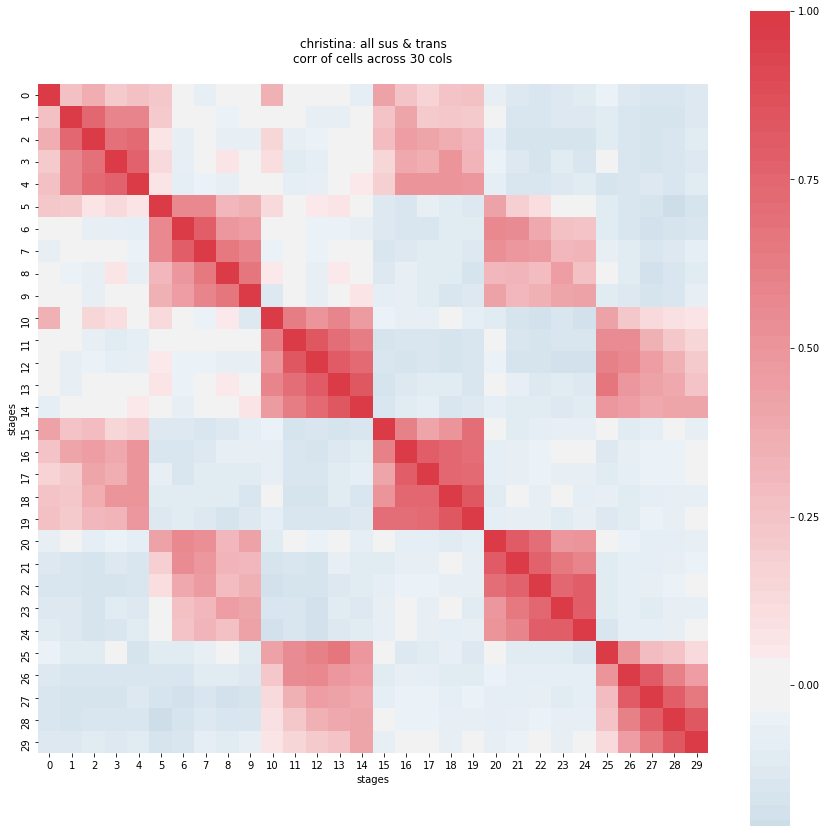

In [406]:
num_corr = 30
corrmat = np.zeros((num_corr, num_corr))
pmat = np.zeros((num_corr, num_corr))
logpmat = np.zeros((num_corr, num_corr))
for i in range(num_corr):
    for k in range(num_corr):
        nanboo = ~(np.isnan(combo_stack[:, i]) | np.isnan(combo_stack[:, k]))
        corA, corP = pearsonr(combo_stack[nanboo, i], combo_stack[nanboo, k])
        corrmat[i, k] = corA
        pmat[i, k] = corP
        logpmat[i, k] = -1*np.log10(corP)

lpm = deepcopy(logpmat)
lpm[~np.isfinite(lpm)] = 0
plt.figure(figsize=(15, 15))
cmap = sns.diverging_palette(240, 10, n=100)
sns.heatmap(corrmat, square=True, cmap=cmap, center=0)
sz = corrmat.shape[0]
# for i in np.unique(clus_vec)[:-1]:
#     inds = np.where(np.array(clus_vec) == i)[0]
# #     start = inds[0]
#     ends = inds[-1]
#     plt.plot([0, sz], [ends, ends], linewidth=1, color='w')
#     plt.plot([ends, ends], [0, sz], linewidth=1, color='w')
#     plt.plot([0, sz], [start, start], linewidth=2, color='w')
plt.title('christina: all sus & trans\ncorr of cells across 30 cols\n')
plt.xlabel('stages')
plt.ylabel('stages')
plt.savefig('christina_allpmn_stages_corr_30sustranscols.pdf', bbox_inches='tight')

# correlation of stages for PMN

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10


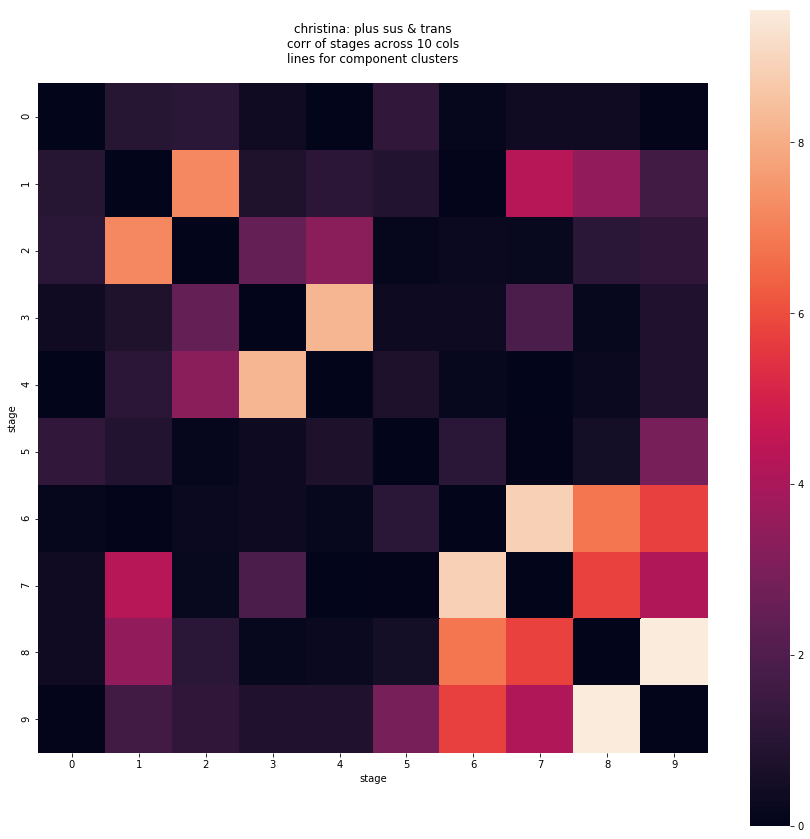

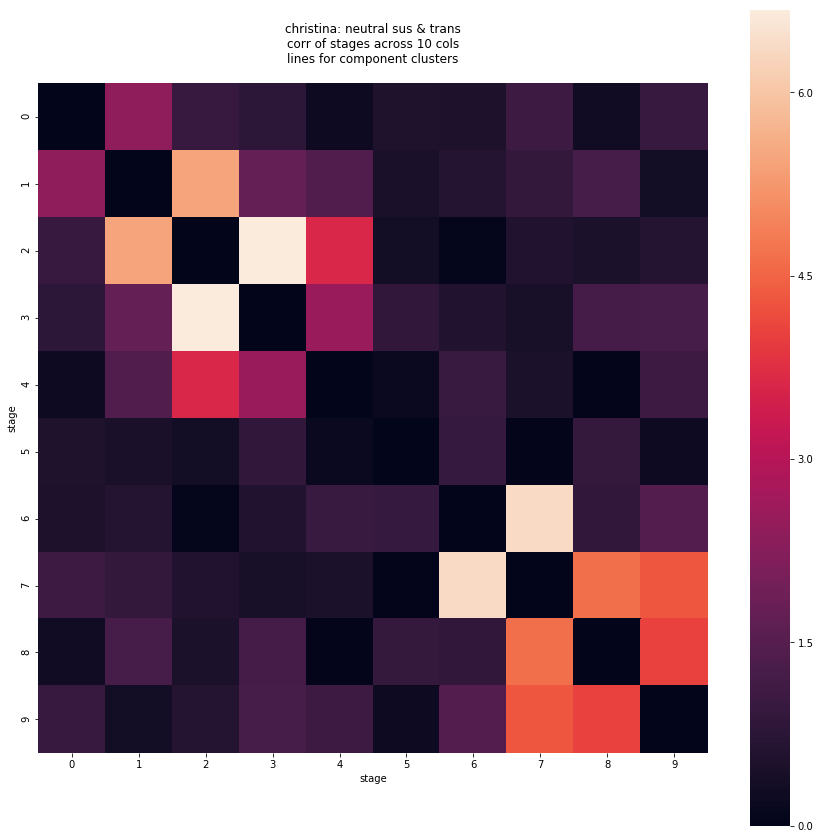

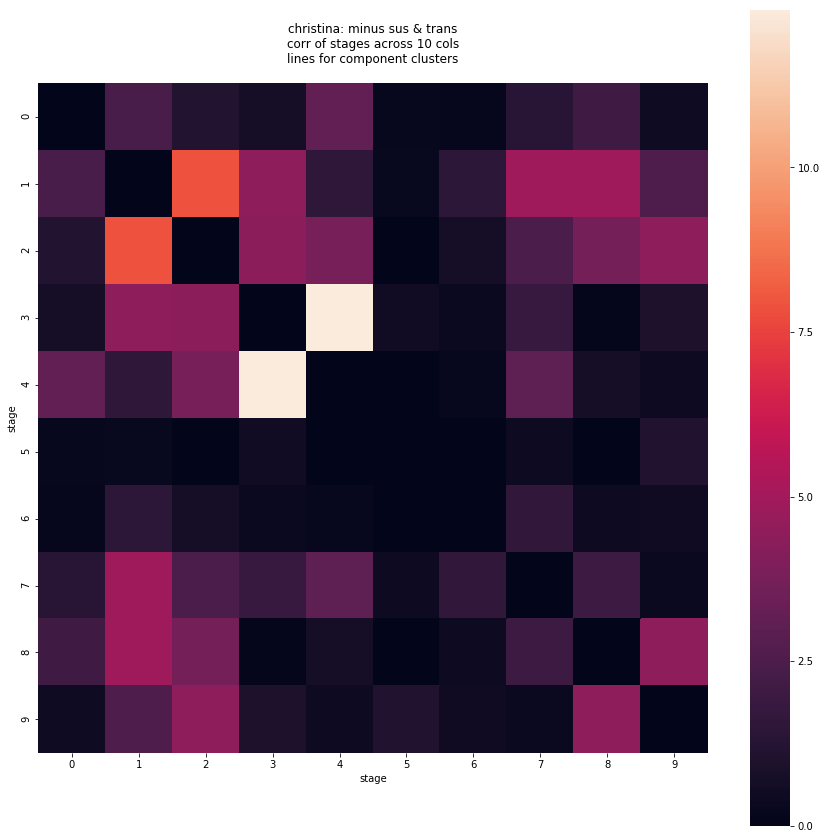

In [580]:
num_corr = 10
pmn_col_lookup = {'plus': np.array([0, 1, 2, 3, 4, 15, 16, 17, 18, 19]),
       'neutral': np.array([0, 1, 2, 3, 4, 15, 16, 17, 18, 19]) + 5,
       'minus': np.array([0, 1, 2, 3, 4, 15, 16, 17, 18, 19]) + 10}
for ki in pmn_col_lookup:
    sorted_stack = combo_stack[expanded_sorter2, :]
    sorted_stack_pmn = sorted_stack[clus_blocks_bool_dict[ki], :]
    oriboo = np.isin(np.arange(sorted_stack_pmn.shape[1]), pmn_col_lookup[ki])
    sorted_stack_pmn = sorted_stack_pmn[:, oriboo]
    corrmat = np.zeros((num_corr, num_corr))
    pmat = np.zeros((num_corr, num_corr))
    logpmat = np.zeros((num_corr, num_corr))
    for i in range(num_corr):
        for k in range(num_corr):
            nanboo = ~(np.isnan(sorted_stack_pmn[:, i]) | np.isnan(sorted_stack_pmn[:, k]))
            corA, corP = pearsonr(sorted_stack_pmn[nanboo, i], sorted_stack_pmn[nanboo, k])
            corrmat[i, k] = corA
            pmat[i, k] = corP
            logpmat[i, k] = -1*np.log10(corP)

    plt.figure(figsize=(15, 15))
    cmap = sns.diverging_palette(240, 10, n=100)
    lpm = deepcopy(logpmat)
    lpm[~np.isfinite(lpm)] = 0
    sns.heatmap(lpm, square=True, ) #cmap=cmap)
#     sz = corrmat.shape[0]
#     for i in np.unique(clus_vec)[:-1]:
#         inds = np.where(np.array(clus_vec) == i)[0]
#     #     start = inds[0]
#         ends = inds[-1]
#         plt.plot([0, sz], [ends, ends], linewidth=1, color='w')
#         plt.plot([ends, ends], [0, sz], linewidth=1, color='w')
    #     plt.plot([0, sz], [start, start], linewidth=2, color='w')
    plt.title('christina: {} sus & trans\ncorr of stages across 10 cols\nlines for component clusters\n'.format(ki))
    plt.xlabel('stage')
    plt.ylabel('stage')
#     plt.savefig('christina_{}_stages_corr_10sustranscols.pdf'.format(ki), bbox_inches='tight')

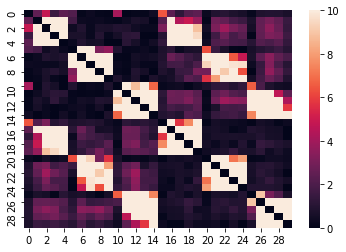

In [371]:
lpm = deepcopy(logpmat)
lpm[~np.isfinite(lpm)] = 0
sns.heatmap(lpm, vmax=10)

# corr of cells

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()


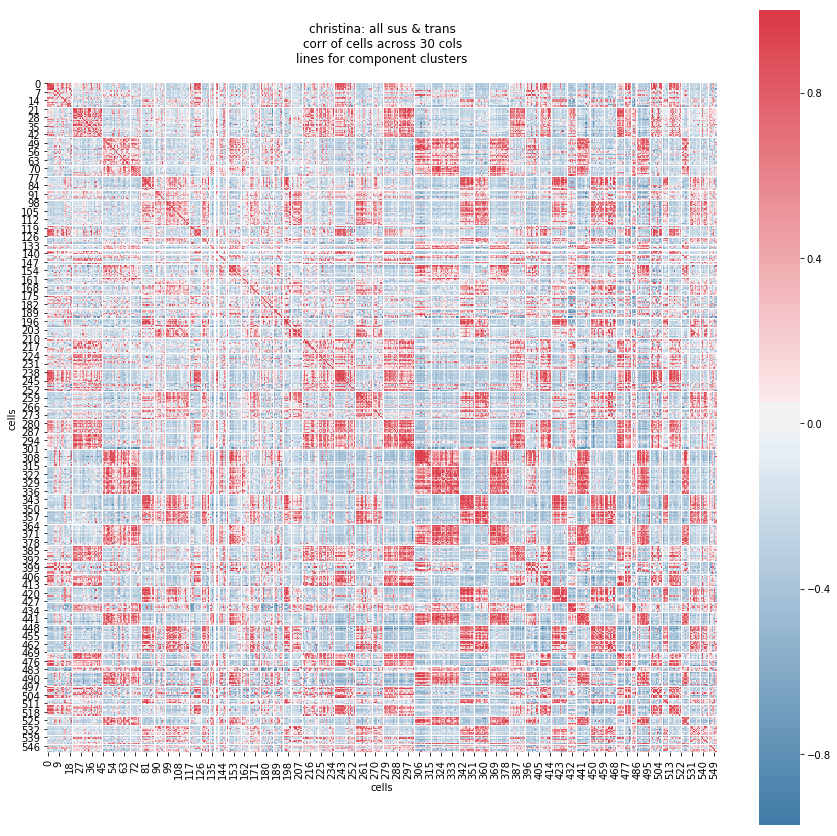

In [404]:
num_corr = combo_stack.shape[0]
corrmat = np.zeros((num_corr, num_corr))
pmat = np.zeros((num_corr, num_corr))
logpmat = np.zeros((num_corr, num_corr))
for i in range(num_corr):
    for k in range(num_corr):
        nanboo = ~(np.isnan(combo_stack[i, :]) | np.isnan(combo_stack[k, :]))
        corA, corP = pearsonr(combo_stack[i, nanboo], combo_stack[k, nanboo])
        corrmat[i, k] = corA
        pmat[i, k] = corP
        logpmat[i, k] = -1*np.log10(corP)
        
lpm = deepcopy(logpmat)
lpm[~np.isfinite(lpm)] = 0
plt.figure(figsize=(15, 15))
cmap = sns.diverging_palette(240, 10, n=100)
sns.heatmap(corrmat, square=True, cmap=cmap)
sz = corrmat.shape[0]
for i in np.unique(clus_vec)[:-1]:
    inds = np.where(np.array(clus_vec) == i)[0]
#     start = inds[0]
    ends = inds[-1]
    plt.plot([0, sz], [ends, ends], linewidth=1, color='w')
    plt.plot([ends, ends], [0, sz], linewidth=1, color='w')
#     plt.plot([0, sz], [start, start], linewidth=2, color='w')
plt.title('christina: all sus & trans\ncorr of cells across 30 cols\nlines for component clusters\n')
plt.xlabel('cells')
plt.ylabel('cells')
plt.savefig('christina_allpmn_cells_corr_30sustranscols.pdf', bbox_inches='tight')

# now for only pmn

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log10
  app.launch_new_instance()


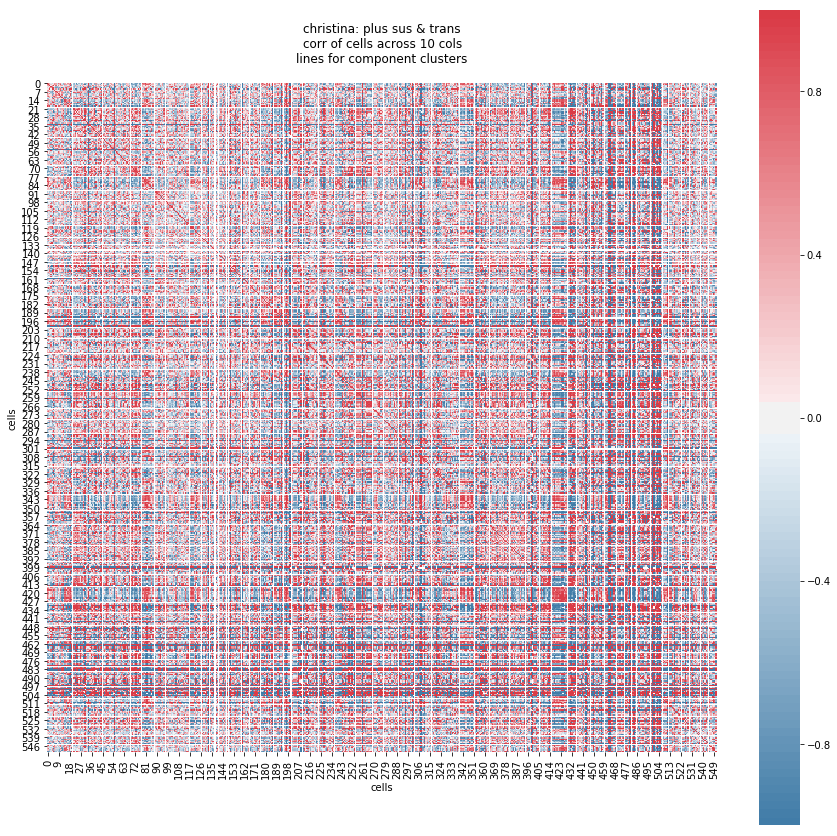

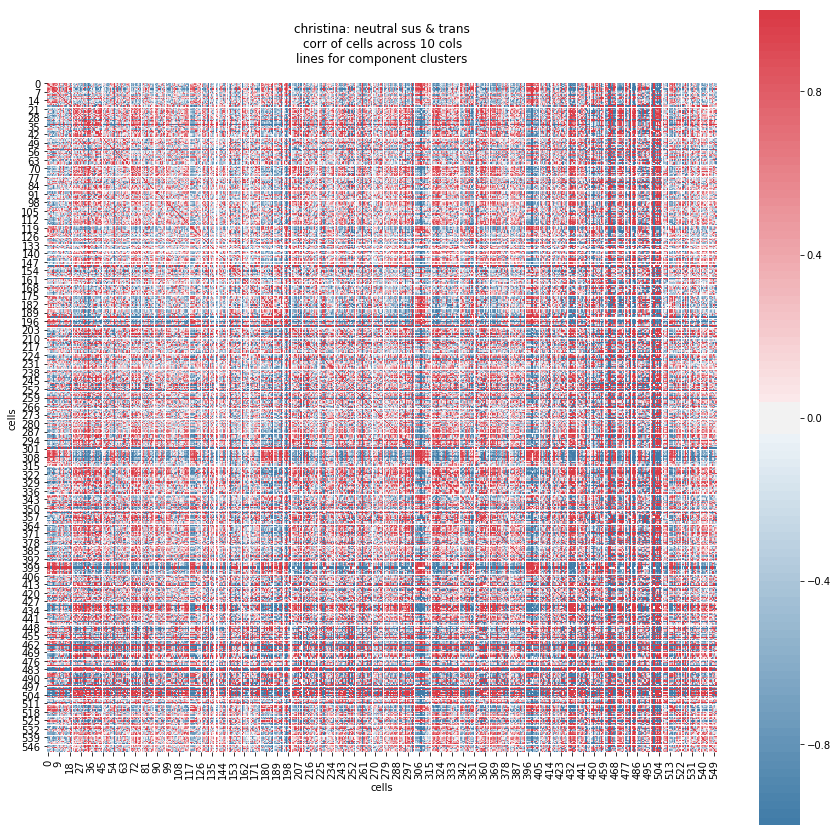

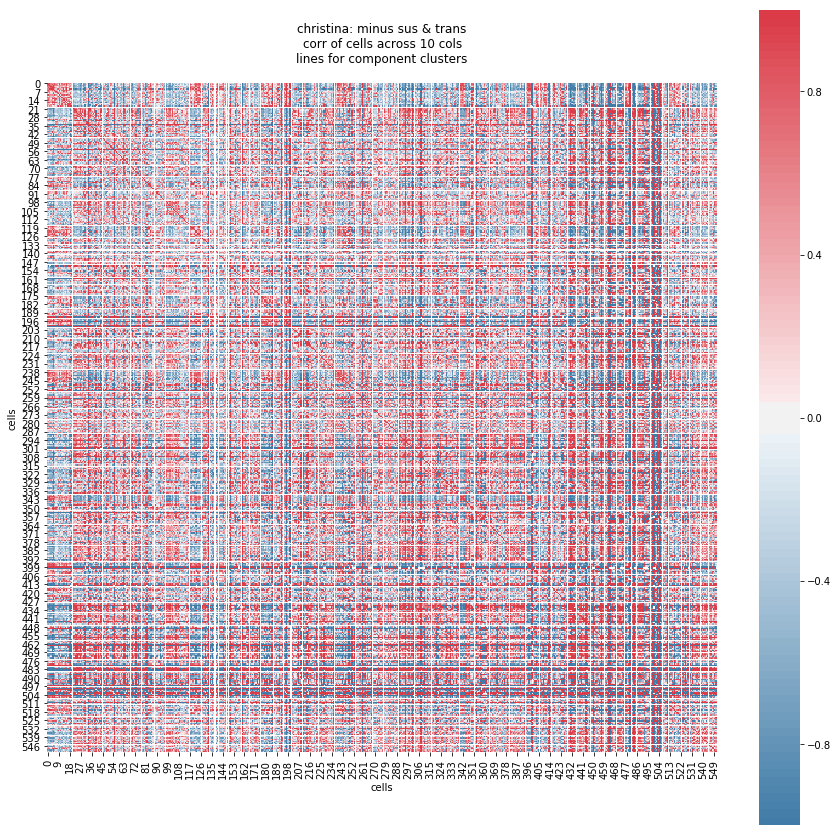

In [402]:
num_corr = combo_stack.shape[0]
pmn_col_lookup = {'plus': np.array([0, 1, 2, 3, 4, 15, 16, 17, 18, 19]),
       'neutral': np.array([0, 1, 2, 3, 4, 15, 16, 17, 18, 19]) + 5,
       'minus': np.array([0, 1, 2, 3, 4, 15, 16, 17, 18, 19]) + 10}
for ki in pmn_col_lookup:
    corrmat = np.zeros((num_corr, num_corr))
    pmat = np.zeros((num_corr, num_corr))
    logpmat = np.zeros((num_corr, num_corr))
    for i in range(num_corr):
        for k in range(num_corr):
            oriboo = np.isin(np.arange(combo_stack.shape[1]), pmn_col_lookup[ki])
            nanboo = ~(np.isnan(combo_stack[i, :]) | np.isnan(combo_stack[k, :]))
            corA, corP = pearsonr(combo_stack[i, nanboo & oriboo], combo_stack[k, nanboo & oriboo])
            corrmat[i, k] = corA
            pmat[i, k] = corP
            logpmat[i, k] = -1*np.log10(corP)

    plt.figure(figsize=(15, 15))
    cmap = sns.diverging_palette(240, 10, n=100)
    sns.heatmap(corrmat, square=True, cmap=cmap)
    sz = corrmat.shape[0]
    for i in np.unique(clus_vec)[:-1]:
        inds = np.where(np.array(clus_vec) == i)[0]
    #     start = inds[0]
        ends = inds[-1]
        plt.plot([0, sz], [ends, ends], linewidth=1, color='w')
        plt.plot([ends, ends], [0, sz], linewidth=1, color='w')
    #     plt.plot([0, sz], [start, start], linewidth=2, color='w')
    plt.title('christina: {} sus & trans\ncorr of cells across 10 cols\nlines for component clusters\n'.format(ki))
    plt.xlabel('cells')
    plt.ylabel('cells')
    plt.savefig('christina_{}_cell_corr_10sustranscols.pdf'.format(ki), bbox_inches='tight')

Text(114.0, 0.5, 'cells')

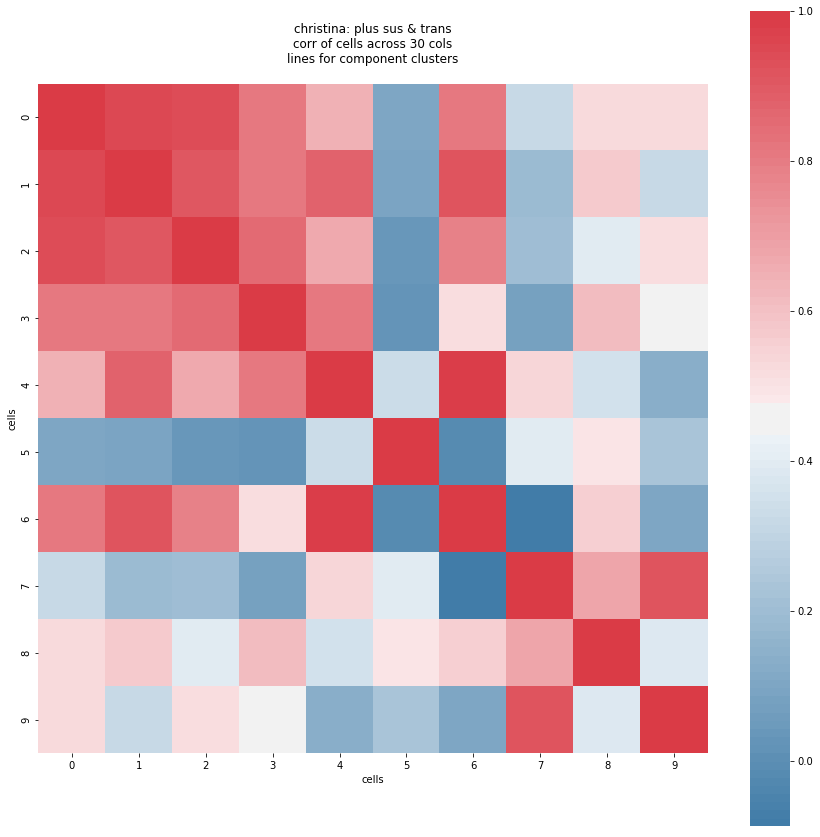

In [399]:
lpm = deepcopy(logpmat)
lpm[~np.isfinite(lpm)] = 0
plt.figure(figsize=(15, 15))
cmap = sns.diverging_palette(240, 10, n=100)
sns.heatmap(corrmat, square=True, cmap=cmap)
sz = corrmat.shape[0]
for i in np.unique(clus_vec)[:-1]:
    inds = np.where(np.array(clus_vec) == i)[0]
#     start = inds[0]
    ends = inds[-1]
    plt.plot([0, sz], [ends, ends], linewidth=1, color='w')
    plt.plot([ends, ends], [0, sz], linewidth=1, color='w')
#     plt.plot([0, sz], [start, start], linewidth=2, color='w')
plt.title('christina: plus sus & trans\ncorr of cells across 30 cols\nlines for component clusters\n')
plt.xlabel('cells')
plt.ylabel('cells')

In [ ]:
# for meta, ks, tensor, mouse in zip(my_meta_list, my_ks_list, my_tensor_list, mice):
#     ks_mat = _trial_driven_visually(tensor, mouse, sec=15.5)
comp_proj_ks_list = []
for mouse, proj, meti in zip(mice, projection_list, meta_list):
    comp_list = []
    for k in proj:
        comp_list.append(proj[k][None, :, :])
    pseudoten = np.concatenate(comp_list, axis=0)
#     ks_mat = cas.calc.tca._trial_driven_visually(pseudoten, mouse, sec=15.5)
    ks_mat = cas.calc.tca._trial_driven_visually_bins(pseudoten, mouse, sec=15.5)
    comp_proj_ks_list.append(ks_mat)
    print('Making progress: {} done.'.format(mouse))
comp_proj_ks_dict = {}
for mi, pp in zip(mice, comp_proj_ks_list):
    comp_proj_ks_dict[mi] = pp
np.save('comp_proj_ks_dict_rebel.npy', comp_proj_ks_dict)

In [ ]:
# for meta, ks, tensor, mouse in zip(my_meta_list, my_ks_list, my_tensor_list, mice):
#     ks_mat = _trial_driven_visually(tensor, mouse, sec=15.5)
comp_proj_ks_list2 = []
for mouse, proj, meti in zip(mice, thresh_list, meta_list):
    comp_list = []
    for k in proj:
        comp_list.append(proj[k][None, :, :])
    pseudoten = np.concatenate(comp_list, axis=0)
#     ks_mat = cas.calc.tca._trial_driven_visually(pseudoten, mouse, sec=15.5)
    ks_mat = cas.calc.tca._trial_driven_visually_bins(pseudoten, mouse, sec=15.5)
    comp_proj_ks_list2.append(ks_mat)
    print('Making progress: {} done.'.format(mouse))
comp_proj_ks_dict2 = {}
for mi, pp in zip(mice, comp_proj_ks_list2):
    comp_proj_ks_dict2[mi] = pp
np.save('comp_proj_ks_dict2_rebel.npy', comp_proj_ks_dict2)

In [ ]:
# np.save('comp_proj_ks_dict2.npy', comp_proj_ks_dict2)
# np.save('comp_proj_ks_dict.npy', comp_proj_ks_dict)
# comp_proj_ks_dict2 = np.load('comp_proj_ks_dict2.npy').item()
# comp_proj_ks_dict = np.load('comp_proj_ks_dict.npy').item()
comp_proj_ks_dict2['OA27'].shape

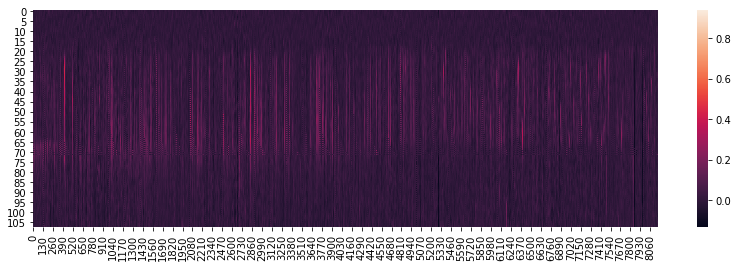

In [15]:
plt.figure(figsize=(14,4))
sns.heatmap(thresh_list[0][5])

In [ ]:
sns.heatmap(thresh_list[0][3])

# DAILY: fit weighted average/projection of groups with simple filters

In [18]:
# subselect everything for only one stimulus
ks_thresh = 1.31

fits = {}
daily_avg_dict = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, projection_list, meta_list):
    daily_avg_dict[mi] = {}
    A = _get_fitting_template_defaults(mi)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_bool(meti)
    fits[mi] = {}
#     comp_mat = np.zeros((len(proj.keys()), proj[1].shape[0], len(u_days)))
    for c, comp_n in enumerate(proj.keys()):
        daily_avg_dict[mi][comp_n] = {}
        fits[mi]['component_{}'.format(c+1)] = {}
        ks_boo = comp_proj_ks_dict[mi][c, :] > ks_thresh 
        for ori in oris:
#             cell_mat = proj[comp_n][:, all_ori == ori]
            # get daily averages
            cell_mat = np.zeros((proj[comp_n].shape[0], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                cell_mat[:, dc] = np.nanmean(proj[comp_n][:, day_ori_bool & ks_boo], axis=1)
            all_tr = []
            for tr_n in range(cell_mat.shape[1]):
                b = deepcopy(cell_mat[:, tr_n])
                b[b < 0] = 0
                if np.sum(np.isnan(b)) == len(b):
                    sp_ans = np.zeros(4)
                    sp_ans[:] = np.nan
                    sp_ans = [sp_ans]
                else:
                    sp_ans = sp.optimize.nnls(A, b)
                all_tr.append(sp_ans[0])
            fits[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = np.vstack(all_tr)
            fits[mi]['component_{}'.format(c+1)]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict[mi][comp_n][ori] = cell_mat
            
    print('Making progress: {} done.'.format(mi))


fits2 = {}
daily_avg_dict2 = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list, meta_list):
    daily_avg_dict2[mi] = {}
    A = _get_fitting_template_defaults(mi)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_bool(meti)
    fits2[mi] = {}
    for c, comp_n in enumerate(proj.keys()):
        fits2[mi]['component_{}'.format(c+1)] = {}
        ks_boo = comp_proj_ks_dict2[mi][c, :] > ks_thresh 
        for ori in oris:
#             cell_mat = proj[comp_n][:, all_ori == ori]
            cell_mat = np.zeros((proj[comp_n].shape[0], len(u_days)))
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                cell_mat[:, dc] = np.nanmean(proj[comp_n][:, day_ori_bool & ks_boo], axis=1)
            all_tr = []
            for tr_n in range(cell_mat.shape[1]):
                b = deepcopy(cell_mat[:, tr_n])
                b[b < 0] = 0
                if np.sum(np.isnan(b)) == len(b):
                    sp_ans = np.zeros(4)
                    sp_ans[:] = np.nan
                    sp_ans = [sp_ans]
                else:
                    sp_ans = sp.optimize.nnls(A, b)
                all_tr.append(sp_ans[0])
            fits2[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = np.vstack(all_tr)
            fits2[mi]['component_{}'.format(c+1)]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]
            daily_avg_dict2[mi][ori] = cell_mat

    print('Making progress: {} done.'.format(mi))

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:27: RuntimeWarning: Mean of empty slice


Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:66: RuntimeWarning: Mean of empty slice


Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


# taking the average of the fits rather than fitting the average

In [109]:
fits = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, projection_list, meta_list):
    A = _get_fitting_template_defaults(mi)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_bool(meti)
    fits[mi] = {}
    for c, comp_n in enumerate(proj.keys()):
        fits[mi]['component_{}'.format(c+1)] = {}
        ks_boo = comp_proj_ks_dict[mi][c, :] > ks_thresh 
        cell_mat = proj[comp_n][:, :]
        all_tr = []
        for tr_n in range(cell_mat.shape[1]):
            b = deepcopy(cell_mat[:, tr_n])
            b[b < 0] = 0
            sp_ans = sp.optimize.nnls(A, b)
            all_tr.append(sp_ans[0])
        betas = np.vstack(all_tr)
        for ori in oris:
            new_tr = np.zeros((betas.shape[1], len(u_days)))
            new_tr[:] = np.nan
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                if np.sum((day_ori_bool & ks_boo)) < 10:
                    continue # no trials passed threshold for this day/comp
                new_tr[:, dc] = np.nanmean(betas[day_ori_bool & ks_boo,:], axis=0)
            fits[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = new_tr.T
            fits[mi]['component_{}'.format(c+1)]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]

    print('Making progress: {} done.'.format(mi))


fits2 = {}
oris = [0, 135, 270]
# A = np.vstack(norm_gker).T
for mi, proj, meti in zip(mice, thresh_list, meta_list):
    A = _get_fitting_template_defaults(mi)
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_bool(meti)
    fits2[mi] = {}
    for c, comp_n in enumerate(proj.keys()):
        fits2[mi]['component_{}'.format(c+1)] = {}
        ks_boo = comp_proj_ks_dict[mi][c, :] > ks_thresh 
        cell_mat = proj[comp_n][:, :]
        all_tr = []
        for tr_n in range(cell_mat.shape[1]):
            b = deepcopy(cell_mat[:, tr_n])
            b[b < 0] = 0
            sp_ans = sp.optimize.nnls(A, b)
            all_tr.append(sp_ans[0])
        betas = np.vstack(all_tr)
        for ori in oris:
            new_tr = np.zeros((betas.shape[1], len(u_days)))
            new_tr[:] = np.nan
            for dc, day_i in enumerate(u_days):
                day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
                if np.sum((day_ori_bool & ks_boo)) < 10:
                    continue # no trials passed threshold for this day/comp
                new_tr[:, dc] = np.nanmean(betas[day_ori_bool & ks_boo, :], axis=0)
            fits2[mi]['component_{}'.format(c+1)]['ori_{}'.format(ori)] = new_tr.T
            fits2[mi]['component_{}'.format(c+1)]['trial_inds_{}'.format(ori)] = np.where(all_ori == ori)[0]

    print('Making progress: {} done.'.format(mi))

Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.
Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


In [65]:
betas.shape
new_tr.shape

(8163, 27)

In [106]:
# for meta, ks, tensor, mouse in zip(my_meta_list, my_ks_list, my_tensor_list, mice):
#     ks_mat = _trial_driven_visually(tensor, mouse, sec=15.5)

proj_ks_dict = {}
proj_avg_dict = {}
for mouse, proj, meti in zip(mice, projection_list, meta_list):
    proj_ks_dict[mouse] = {}
    proj_avg_dict[mouse] = {}
    pre_proj_avg_dict[mouse] = {}
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_bool(meti)
    comp_list = []
    for k in proj:
        comp_list.append(proj[k][None, :, :])
    pseudoten = np.concatenate(comp_list, axis=0)
    for ori in np.unique(all_ori):
        new_pseudo = np.zeros((pseudoten.shape[0], pseudoten.shape[1], len(u_days)))
        pre_pseudo = np.zeros((pseudoten.shape[0], pseudoten.shape[1], len(u_days)))
        for dc, day_i in enumerate(u_days):
            day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
            new_pseudo[:, :, dc] = np.nanmean(pseudoten[:, :, day_ori_bool], axis=2)
            pre_day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty & (pre_proj_ks_dict[mi] > 1.31)
            pre_pseudo[:, :, dc] = np.nanmean(pseudoten[:, :, pre_day_ori_bool], axis=2)
#         ks_mat = cas.calc.tca._trial_driven_visually(new_pseudo, mouse, sec=15.5)
        ks_mat = cas.calc.tca._trial_driven_visually_bins(new_pseudo, mouse, sec=15.5)
        proj_ks_dict[mouse][ori] = ks_mat
        proj_avg_dict[mouse][ori] = new_pseudo
    print('Making progress: {} done.'.format(mouse))


Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


In [104]:
stim_datapoints = np.floor(15.5*2)
bin_length = np.floor(15.5/2)
bin_starts = np.arange(0, stim_datapoints, bin_length)
bin_ends = np.arange(bin_length, stim_datapoints, bin_length)
bin_starts = bin_starts[:len(bin_ends)]
print(bin_starts)
print(bin_ends)

[ 0.  7. 14. 21.]
[ 7. 14. 21. 28.]


In [105]:
# for meta, ks, tensor, mouse in zip(my_meta_list, my_ks_list, my_tensor_list, mice):
#     ks_mat = _trial_driven_visually(tensor, mouse, sec=15.5)
proj_ks_dict2 = {}
proj_avg_dict2 = {}
for mouse, proj, meti in zip(mice, thresh_list, meta_list):
    proj_ks_dict2[mouse] = {}
    proj_avg_dict2[mouse] = {}
    all_ori = meti['orientation'].values
    all_days = meti.reset_index()['date'].values
    u_days = meti.reset_index()['date'].unique()
    firsty = _first100_bool(meti)
    comp_list = []
    for k in proj:
        comp_list.append(proj[k][None, :, :])
    pseudoten = np.concatenate(comp_list, axis=0)
    for ori in np.unique(all_ori):
        new_pseudo = np.zeros((pseudoten.shape[0], pseudoten.shape[1], len(u_days)))
        for dc, day_i in enumerate(u_days):
            day_ori_bool = (all_ori == ori) & (all_days == day_i) & firsty
            new_pseudo[:, :, dc] = np.nanmean(pseudoten[:, :, day_ori_bool], axis=2)
#         ks_mat = cas.calc.tca._trial_driven_visually(new_pseudo, mouse, sec=15.5)
        ks_mat = cas.calc.tca._trial_driven_visually_bins(new_pseudo, mouse, sec=15.5)
        proj_ks_dict2[mouse][ori] = ks_mat
        proj_avg_dict2[mouse][ori] = new_pseudo
    print('Making progress: {} done.'.format(mouse))

Making progress: OA27 done.
Making progress: VF226 done.
Making progress: OA67 done.
Making progress: OA32 done.
Making progress: OA34 done.
Making progress: OA36 done.
Making progress: OA26 done.


In [86]:
fits['OA27']['component_1'].keys()

dict_keys(['ori_0', 'trial_inds_0', 'ori_135', 'trial_inds_135', 'ori_270', 'trial_inds_270'])

In [120]:
tails.shape

(7, 27)

In [19]:
peaks = np.mean(proj_avg_dict2['OA27'][270][:, 15:22, :], axis=1)
tails = np.mean(proj_avg_dict2['OA27'][270][:, int(15.5*4)-15:int(15.5*4), :], axis=1)
peaks[peaks < 0] = 0
tails[tails < 0] = 0
for i in range(10):
    plt.figure()
    sns.heatmap(proj_avg_dict2['OA27'][270][i, :, :])
    plt.plot(proj_ks_dict2['OA27'][270][i, :]*10)
    denom = fits2['OA27']['component_{}'.format(i+1)]['ori_270'][:,1] + fits2['OA27']['component_{}'.format(i+1)]['ori_270'][:,0]
    fitplot = fits2['OA27']['component_{}'.format(i+1)]['ori_270'][:,0]/denom
    fitplot = (peaks[i,:] - tails[i,:])/(tails[i,:] + peaks[i,:])
    fitplot2 = (tails[i,:])/(tails[i,:] + peaks[i,:])
#     peak = proj_avg_dict2['OA27'][270][i-1, 15:22, :]
    plt.plot((fitplot-np.nanmin(fitplot))*100)

NameError: name 'proj_avg_dict2' is not defined

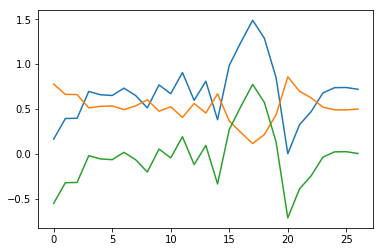

In [141]:
plt.plot(fitplot-np.nanmin(fitplot))
plt.plot(fitplot2)
plt.plot(fitplot)

# for weighted average data

D:\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


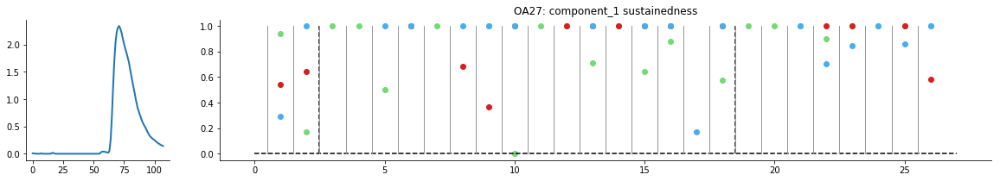

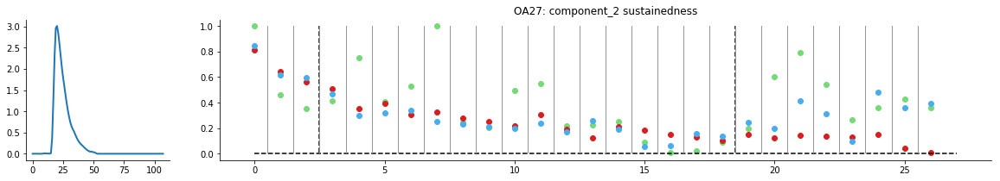

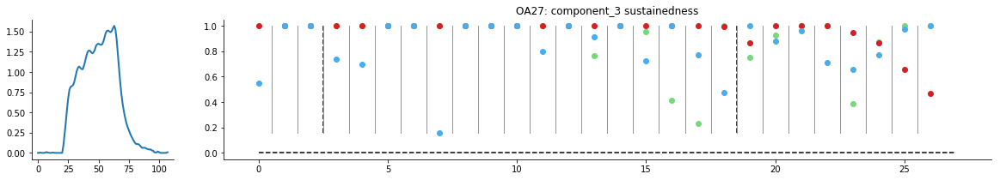

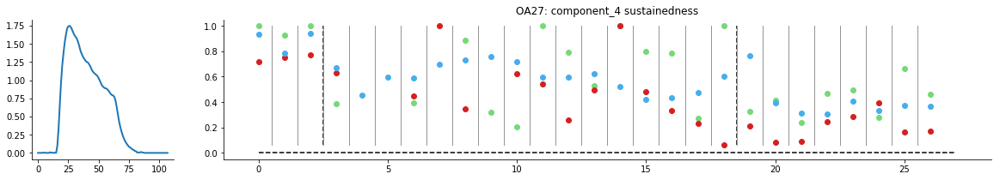

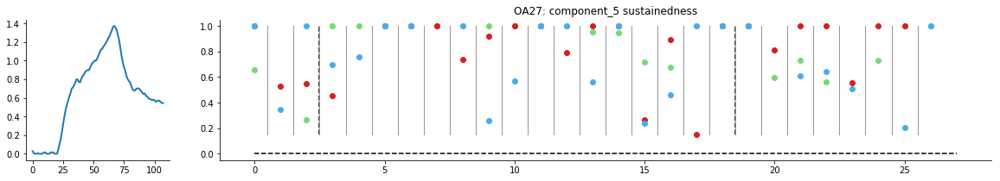

...

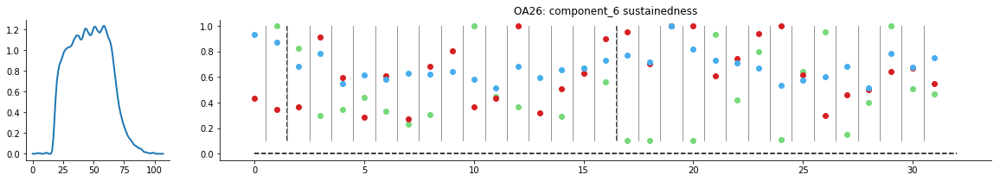

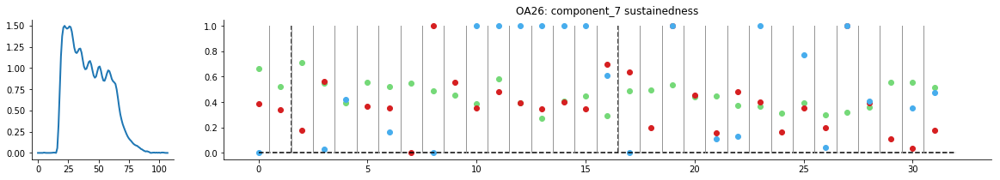

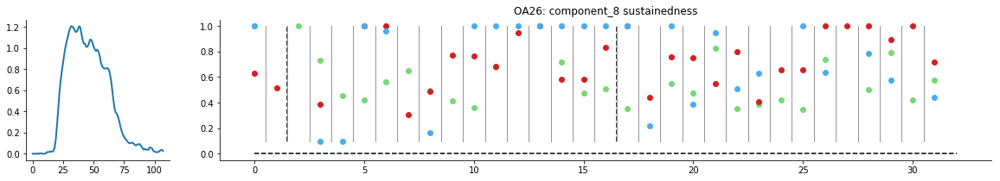

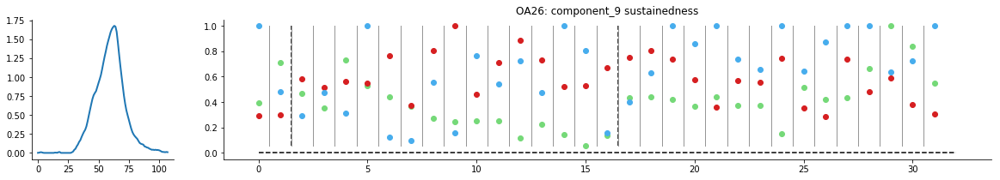

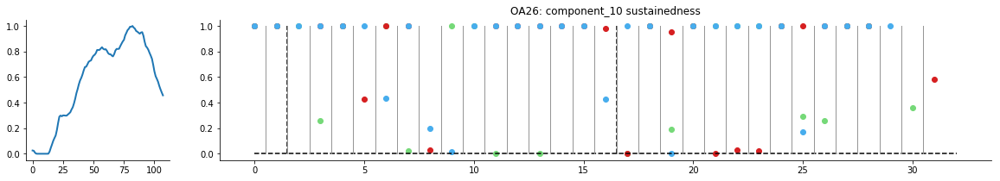

In [41]:
alpha = 0.7
color_vals = [[0.46, 0.85, 0.47, 0.1], [0.84, 0.12, 0.13, 0.1], [0.28, 0.68, 0.93, alpha]]
ksthresh = 1.31

for mi, meti, V in zip(mice, meta_list, model_list):
    
    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    udays = {d: c for c, d in enumerate(np.unique(dates))}
    ndays = np.diff([udays[i] for i in np.unique(dates)])
    day_x = np.where(ndays)[0] + 0.5
    
    # get indices for stimulus period
    tstart = int(np.floor(15.5))
    tend = int(np.floor(15.5*2-7))
#     sstart = int(np.floor(15.5*2))
    if mi in ['OA32', 'OA34', 'OA36']:
        send = int(np.floor(15.5*3))
    else:
        send = int(np.floor(15.5*4))
    sstart = int(send-7)
        
    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 0.5
    if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
        lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
        lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 0.5
    else:
        lear_ind = 0 - 0.5

    for comp_n in range(1, len(fits[mi].keys())+1):
        
        fig = plt.figure(figsize=(20, 3))
        gs = fig.add_gridspec(100, 100)
        ax1 = fig.add_subplot(gs[:, :15])
        sns.despine()
        ax2 = fig.add_subplot(gs[:, 20:])
        sns.despine()
        
        temp_fac = V.results[rank][0].factors[1][:, comp_n-1]
        ax1.plot(temp_fac, linewidth=2)
        ax2.set_title('temporal factor')
        
        all_y = []
        for cs_type in ['plus', 'minus', 'neutral']:
            
            ori_type = 'ori_{}'.format(lookup[mi][cs_type])
            trial_type = 'trial_inds_{}'.format(lookup[mi][cs_type])

            fit_mat = fits[mi]['component_{}'.format(comp_n)][ori_type]
#             day_avg = proj_avg_dict[mi][lookup[mi][cs_type]][comp_n-1, :, :]
#             a = np.nanmean(day_avg[sstart:send, :], axis=0)  # sustained
#             b = np.nanmean(day_avg[tstart:tend, :], axis=0)  # transient
#             a[a < 0] = 0 
#             b[b < 0] = 0
#             y = (b - a)/(a + b)
            y = fit_mat[:,1]/(fit_mat[:,0] + fit_mat[:,1])
#             y = pd.DataFrame(data=y[:, None]).rolling(20).mean().values
#             x = fits[mi]['component_{}'.format(comp_n)][trial_type]
            all_y.extend(y)
            x = np.array([c for c, d in enumerate(np.unique(dates))])
            
#             ksboo = proj_ks_dict[mi][lookup[mi][cs_type]][comp_n-1, :] > ksthresh
#             ksboo = ksboo[x]
#             ax2.plot(x[ksboo], y[ksboo], 'o', color=color_dict[cs_type])
            ax2.plot(x, y, 'o', color=color_dict[cs_type])
            
        ax2.set_title('{}: component_{} sustainedness'.format(mi, comp_n))

        y_min = np.nanmin(all_y, axis=0)
        y_max = np.nanmax(all_y, axis=0)
        ax2.plot([lear_ind, lear_ind], [y_min, y_max], '--k')
        ax2.plot([rev_ind, rev_ind], [y_min, y_max], '--k')
#         ax2.plot([0, len(x)], [0.5, 0.5], '--k')
        ax2.plot([0, len(x)], [0, 0], '--k')
            
        if len(day_x) > 0:
            for k in day_x:
                ax2.plot([k, k], [y_min, y_max], color='#969696', linewidth=1)
                

# for thresholded data

In [ ]:
alpha = 0.7
color_vals = [[0.46, 0.85, 0.47, 0.1], [0.84, 0.12, 0.13, 0.1], [0.28, 0.68, 0.93, alpha]]
ksthresh = 1.31


times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)

for mi, meti, V in zip(mice, meta_list, model_list):
    
    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    udays = {d: c for c, d in enumerate(np.unique(dates))}
    ndays = np.diff([udays[i] for i in np.unique(dates)])
    day_x = np.where(ndays)[0] + 0.5
    
    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 0.5
    if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
        lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
        lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 0.5
    else:
        lear_ind = 0 - 0.5

    for comp_n in range(1, len(fits[mi].keys())+1):
        
        fig = plt.figure(figsize=(20, 4))
        gs = fig.add_gridspec(100, 100)
        ax1 = fig.add_subplot(gs[:, :15])
        sns.despine()
        ax2 = fig.add_subplot(gs[:, 20:])
        sns.despine()
        
        temp_fac = V.results[rank][0].factors[1][:, comp_n-1]
        ax1.plot(temp_fac, linewidth=2)
        ax1.set_title('temporal factor \n', size=18)
        ax1.set_xticks(timepts)
        ax1.set_xticklabels(times, size=12)
        ax1.tick_params(axis='both', which='major', labelsize=14)
        ax1.set_xlabel('time from stimulus onset (sec)', size=14)
        ax1.set_ylabel('temporal factor amplitude (AU)', size=14)
        
        ax2.set_xticks(timepts)
        ax2.set_xticklabels(times, size=12)
        ax2.tick_params(axis='both', which='major', labelsize=14)
        ax2.set_xlabel('time from stimulus onset (sec)', size=14)
        ax2.set_ylabel('temporal factor amplitude (AU)', size=14)
        
        all_y = []
        for cs_type in ['plus', 'minus', 'neutral']:
            
            ori_type = 'ori_{}'.format(lookup[mi][cs_type])
            trial_type = 'trial_inds_{}'.format(lookup[mi][cs_type])

            fit_mat = fits2[mi]['component_{}'.format(comp_n)][ori_type]
            y = fit_mat[:,1]/(fit_mat[:,0] + fit_mat[:,1])
#             y = pd.DataFrame(data=y[:, None]).rolling(20).mean().values
#             x = fits[mi]['component_{}'.format(comp_n)][trial_type]
            all_y.extend(y)
            x = np.array([c for c, d in enumerate(np.unique(dates))])
            
#             ksboo = proj_ks_dict2[mi][lookup[mi][cs_type]][comp_n-1, :] > ksthresh
#             ksboo = ksboo[x]
#             ax2.plot(x[ksboo], y[ksboo], 'o', color=color_dict[cs_type])
            ax2.plot(x, y, 'o', color=color_dict[cs_type])
            
        ax2.set_title('{}: component_{} sustainedness'.format(mi, comp_n))

        y_min = 0 #np.nanmin(all_y, axis=0)
        y_max = 1 #np.nanmax(all_y, axis=0)
        if len(day_x) > 0:
            for k in day_x:
                if k == lear_ind or k == rev_ind:
                    continue
                ax2.plot([k, k], [y_min, y_max], color=color_dict['gray'], linewidth=2)
        ax2.plot([lear_ind, lear_ind], [y_min, y_max], '--', color=color_dict['learning'], linewidth=3)
        ax2.plot([rev_ind, rev_ind], [y_min, y_max], '--', color=color_dict['reversal'], linewidth=3)
        ax2.plot([-0.5, len(x)-0.5], [0.5, 0.5], '--k')
        ax2.set_ylim([y_min, y_max+0.05])
        ax2.set_xlim([-0.5, len(x)-0.5])

# Tuning index by learning stage, per component average

In [227]:
# for each orientation get mean response
end = int(15.5*4)
start = end-16
first_boo = _first100_bool(meta_list[0])
dp_threshold = 2

# preallocate
all_means2 = np.zeros((len(meta_list[0]['orientation'].unique()), 5, len(thresh_list[0].keys())))
for c_comp, ki in enumerate(thresh_list[0]):
    cell_mat = deepcopy(thresh_list[0][ki])
    new_mat = np.empty(cell_mat.shape)
    new_mat[:] = np.nan

    # take averages for CS per day and create an index of tuning across days
#     day_means = np.zeros((len(meta_list[0]['orientation'].unique()),
#                           len(meta_list[0].reset_index()['date'].unique())))
    c_day = 0
    for n_day in meta_list[0]['learning_state'].unique():
        day_bool = meta_list[0]['learning_state'].isin([n_day]).values
        if n_day == 'naive':
            ori_means = np.zeros((len(meta_list[0]['orientation'].unique())))
            for c_ori, n_ori in enumerate(meta_list[0]['orientation'].unique()):
                ori_bool = meta_list[0]['orientation'].isin([n_ori]).values
    #             for n_te in meta_list[0]['trialerror'].unique():
    #                 te_bool = meta_list[0]['trialerror'].isin([n_te]).values
                total_bool = ori_bool & day_bool & first_boo

                # if there are no trials of a given type skip
                if np.sum(total_bool) == 0:
                    continue

                # subtract mean trace from each cell
    #             ori_means[c_ori] = np.nanmean(np.nanmean(cell_mat[start:end, total_bool], axis=1))
                all_means[c_ori, c_day, c_comp] = np.nanmean(np.nanmean(cell_mat[start:end, total_bool], axis=1))
            c_day += 1
        else:
            ori_means = np.zeros((len(meta_list[0]['orientation'].unique())))
            for dpi in ['low_dp', 'high_dp']:
                if dpi == 'high_dp':
                    dp_bool = cas.utils.add_dprime_to_meta(meta_list[0])['dprime'].values >= dp_threshold
                elif dpi == 'low_dp':
                    dp_bool = cas.utils.add_dprime_to_meta(meta_list[0])['dprime'].values < dp_threshold
                for c_ori, n_ori in enumerate(meta_list[0]['orientation'].unique()):
                    ori_bool = meta_list[0]['orientation'].isin([n_ori]).values
        #             for n_te in meta_list[0]['trialerror'].unique():
        #                 te_bool = meta_list[0]['trialerror'].isin([n_te]).values
                    total_bool = ori_bool & day_bool & first_boo & dp_bool

                    # if there are no trials of a given type skip
                    if np.sum(total_bool) == 0:
                        continue

                    # subtract mean trace from each cell
        #             ori_means[c_ori] = np.nanmean(np.nanmean(cell_mat[start:end, total_bool], axis=1))
                    all_means2[c_ori, c_day, c_comp] = np.nanmean(np.nanmean(cell_mat[start:end, total_bool], axis=1))
                c_day += 1
    
    all_means2[all_means2 < 0] = 0

# Tuning index by learning stage, per cell

In [219]:
# for each orientation get mean response of cells
end = int(15.5*4)
start = end-16
first_boo = _first100_bool(meta_list[0])
dp_threshold = 2

cell_means = np.nanmean(tensor_list[0][:, start:end, :], axis=1)

# preallocate
all_means = np.zeros((len(meta_list[0]['orientation'].unique()), 5, cell_means.shape[0]))
for c_comp in range(cell_means.shape[0]):
    cell_mat = cell_means[c_comp, :]
#     new_mat = np.empty(cell_mat.shape)
#     new_mat[:] = np.nan
    # take averages for CS per day and create an index of tuning across days
#     day_means = np.zeros((len(meta_list[0]['orientation'].unique()),
#                           len(meta_list[0].reset_index()['date'].unique())))
    c_day = 0
    for n_day in meta_list[0]['learning_state'].unique():
        day_bool = meta_list[0]['learning_state'].isin([n_day]).values
        if n_day == 'naive':
            ori_means = np.zeros((len(meta_list[0]['orientation'].unique())))
            for c_ori, n_ori in enumerate(meta_list[0]['orientation'].unique()):
                ori_bool = meta_list[0]['orientation'].isin([n_ori]).values
    #             for n_te in meta_list[0]['trialerror'].unique():
    #                 te_bool = meta_list[0]['trialerror'].isin([n_te]).values
                total_bool = ori_bool & day_bool & first_boo

                # if there are no trials of a given type skip
                if np.sum(total_bool) == 0:
                    continue

                # subtract mean trace from each cell
    #             ori_means[c_ori] = np.nanmean(np.nanmean(cell_mat[start:end, total_bool], axis=1))
                all_means[c_ori, c_day, c_comp] = np.nanmean(cell_mat[total_bool])
            c_day += 1
        else:
            ori_means = np.zeros((len(meta_list[0]['orientation'].unique())))
            for dpi in ['low_dp', 'high_dp']:
                if dpi == 'high_dp':
                    dp_bool = cas.utils.add_dprime_to_meta(meta_list[0])['dprime'].values >= dp_threshold
                elif dpi == 'low_dp':
                    dp_bool = cas.utils.add_dprime_to_meta(meta_list[0])['dprime'].values < dp_threshold
                for c_ori, n_ori in enumerate(meta_list[0]['orientation'].unique()):
                    ori_bool = meta_list[0]['orientation'].isin([n_ori]).values
        #             for n_te in meta_list[0]['trialerror'].unique():
        #                 te_bool = meta_list[0]['trialerror'].isin([n_te]).values
                    total_bool = ori_bool & day_bool & first_boo & dp_bool

                    # if there are no trials of a given type skip
                    if np.sum(total_bool) == 0:
                        continue

                    # subtract mean trace from each cell
        #             ori_means[c_ori] = np.nanmean(np.nanmean(cell_mat[start:end, total_bool], axis=1))
                    all_means[c_ori, c_day, c_comp] = np.nanmean(cell_mat[total_bool])
                c_day += 1
    
    all_means3[all_means3 < 0] = 0
    
    droppers = np.max(all_means3, axis=0) < 0.01
    tuning_index = np.max(all_means3, axis=0)/np.mean(all_means3, axis=0)
    tuning_index[droppers] = np.nan

    plt.plot(tuning_index)
    plt.legend(bbox_to_anchor=(1.05, 1), labels=[k for k in thresh_list[0].keys()])
    ply

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: Mean of empty slice
  import sys
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:56: RuntimeWarning: Mean of empty slice
D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: RuntimeWarning: Mean of empty slice


# take stage averages of sustainedness, per component average

Skipped empty for: low_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: low_dp reversal1
Skipped empty for: low_dp learning
Skipped empty for: low_dp learning
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: low_dp learning
Skipped empty for: high_dp learning
Skipped empty for: high_dp reversal1
Skipped empty for: low_dp learning
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp learning
Skipped empty for: low_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1


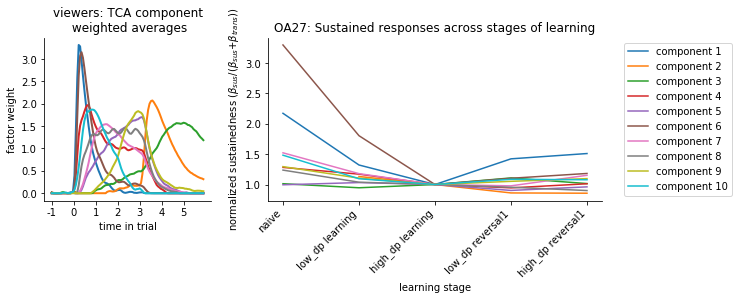

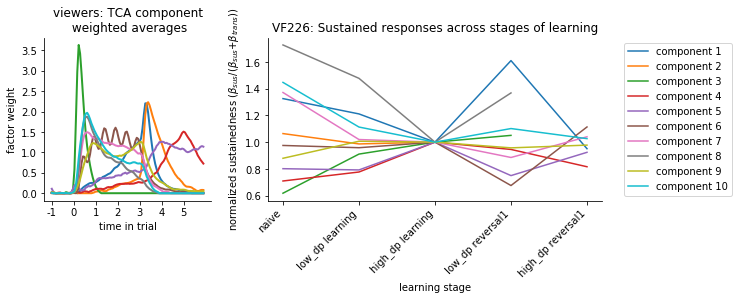

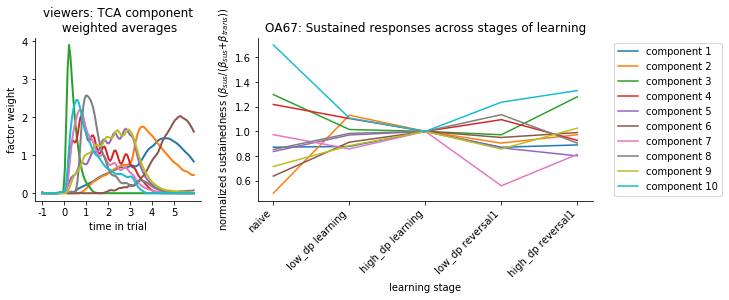

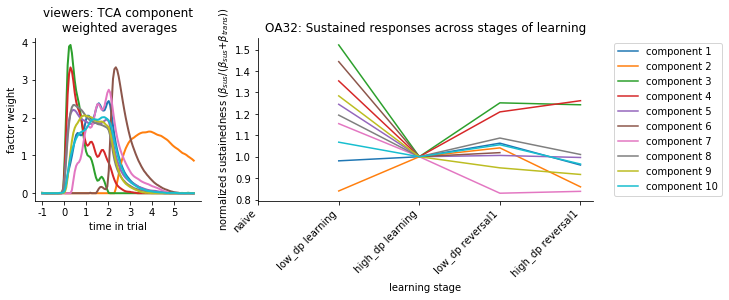

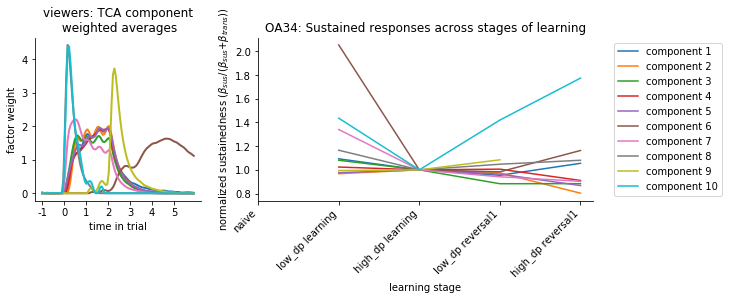

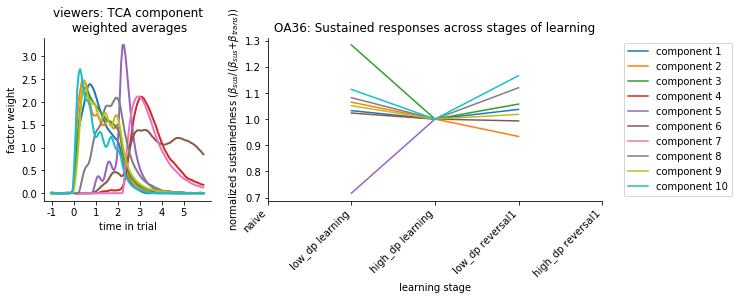

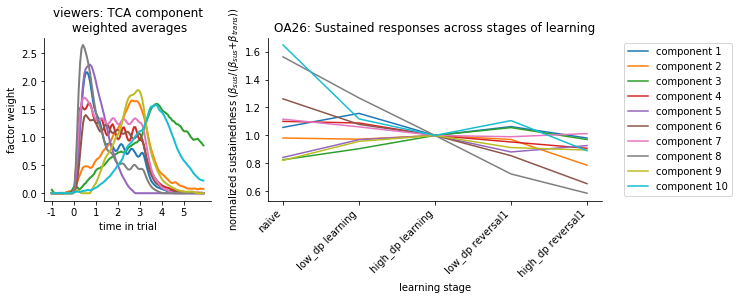

In [29]:
alpha = 0.7
color_vals = [[0.46, 0.85, 0.47, 0.1], [0.84, 0.12, 0.13, 0.1], [0.28, 0.68, 0.93, alpha]]
ksthresh = 35 #35
dp_threshold = 2

for mi, meti, V in zip(mice, meta_list, model_list):
    
    # calculate change indices for days and reversal/learning
    dates = meti.reset_index()['date']
    udays = {d: c for c, d in enumerate(np.unique(dates))}
    ndays = np.diff([udays[i] for i in dates])
    day_x = np.where(ndays)[0] + 0.5
    
    # get your learning and reversal start indices 
    rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
    if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
        lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
    else:
        lear_ind = 0
    
    fig = plt.figure(figsize=(10, 3))
    gs = fig.add_gridspec(100, 100)
    ax1 = fig.add_subplot(gs[:, :30])
    sns.despine()
    ax2 = fig.add_subplot(gs[:, 40:])
    sns.despine()

    temp_fac = V.results[rank][0].factors[1][:, :]
    ax1.plot(temp_fac, linewidth=2)
    ax2.set_title('temporal factor')
        
    first_boo = _first100_bool(meti)
#     all_means3 = np.zeros((len(meti['orientation'].unique()), 5, len(fits[mi].keys())))
    all_means3 = np.zeros((1, 5, len(fits[mi].keys())))
    all_means3[:] = np.nan
    for comp_n in range(1, len(fits[mi].keys())+1):
        
#         fig = plt.figure(figsize=(6, 3))
#         gs = fig.add_gridspec(100, 100)
#         ax1 = fig.add_subplot(gs[:, :30])
#         sns.despine()
#         ax2 = fig.add_subplot(gs[:, 35:])
#         sns.despine()
        
#         temp_fac = V.results[rank][0].factors[1][:, comp_n-1]
#         ax1.plot(temp_fac, linewidth=2)
#         ax2.set_title('temporal factor')
        
        y_vec = np.zeros((len(meti)))
        for cs_type in ['plus', 'minus', 'neutral']:
            ori_type = 'ori_{}'.format(lookup[mi][cs_type])
            trial_type = 'trial_inds_{}'.format(lookup[mi][cs_type])
            fit_mat = fits[mi]['component_{}'.format(comp_n)][ori_type]
            x = fits[mi]['component_{}'.format(comp_n)][trial_type]
            y = fit_mat[:,1]/(fit_mat[:,1] + fit_mat[:,0])
            y_vec[x] = y
            ks_boo = proj_ks_dict[mi][lookup[mi][cs_type]][comp_n-1, :] < ksthresh
            y_vec[ks_boo] = np.nan
#         ax2.plot(y_vec, '-o')
        
        stage_labels = []
        c_day = 0
        for n_day in meta_list[0]['learning_state'].unique(): # forcing to include all stages
            day_bool = meti['learning_state'].isin([n_day]).values
            if n_day == 'naive':
#                 for c_ori, n_ori in enumerate(meti['orientation'].unique()):
#                     ori_bool = meti['orientation'].isin([n_ori]).values
#                     total_bool = ori_bool & day_bool & first_boo
                total_bool = day_bool & first_boo & (y_vec < 1)
                stage_labels.append(n_day)
                    # if there are no trials of a given type skip
                if np.sum(total_bool) == 0:
#                     print('Skipped empty for: naive')
                    c_day += 1
                    continue

                # subtract mean trace from each cell
#                 print(np.nanmean(y_vec[total_bool]))
                all_means3[0, c_day, comp_n-1] = np.nanmean(y_vec[total_bool])
                c_day += 1
            else:
                for dpi in ['low_dp', 'high_dp']:
                    if dpi == 'high_dp':
                        dp_bool = cas.utils.add_dprime_to_meta(meti)['dprime'].values >= dp_threshold
                    elif dpi == 'low_dp':
                        dp_bool = cas.utils.add_dprime_to_meta(meti)['dprime'].values < dp_threshold
#                     for c_ori, n_ori in enumerate(meti['orientation'].unique()):
#                         ori_bool = meti['orientation'].isin([n_ori]).values
                    total_bool = day_bool & first_boo & dp_bool & (y_vec < 1)
                    
                    stage_labels.append('{} {}'.format(dpi, n_day))
                    # if there are no trials of a given type skip
                    if np.sum(total_bool) == 0:
                        print('Skipped empty for: {} {}'.format(dpi, n_day))
                        continue

                    # subtract mean trace from each cell
                    all_means3[0, c_day, comp_n-1] = np.nanmean(y_vec[total_bool])
                    c_day += 1
    
#     all_means3[all_means3 < 0] = 0
#     droppers = np.max(all_means3, axis=0) > 0.01
#     tuning_index = np.max(all_means3, axis=0)/np.mean(all_means3, axis=0)
    tuning_index = all_means3.squeeze()
    tuning_index = tuning_index/tuning_index[2, :]
#     tuning_index[droppers] = np.nan

    ax2.plot(tuning_index)
    ax2.legend(bbox_to_anchor=(1.05, 1), labels=['component {}'.format(k) for k in thresh_list[0].keys()])
    ax2.set_title('{}: Sustained responses across stages of learning'.format(mi))
    ax1.set_title('{}: TCA component\n weighted averages'.format(words[0]))
    ax1.set_xlabel('time in trial')
    ax1.set_ylabel('factor weight')
    stim_window_ticks = np.arange(0, 108, 15.5)
    stim_window_labels = np.arange(-1, 7, 1)
    ax1.set_xticks(stim_window_ticks)
    ax1.set_xticklabels(labels=stim_window_labels)
    ax2.set_xlabel('learning stage')
    ax2.set_ylabel(r'normalized sustainedness ($\beta_{sus}$/($\beta_{sus}$+$\beta_{trans}$))')
    stage_ticks = np.arange(0, 5, 1)
    ax2.set_xticks(stage_ticks)
    ax2.set_xticklabels(labels=stage_labels, rotation=45, ha='right')
#     plt.savefig('.//Adaptation plots//{}_{}_sustainedness_weighted_avg_stages.pdf'.format(mi, words[0]), bbox_inches='tight')

In [75]:
meti.groupby(['date', 'learning_state']).max()

orientation condition  trialerror  hunger  \
mouse date   run trial_idx                                              
OA26  170208 1   0                  270      plus         1.0  hungry   
                 1                  270      plus         1.0  hungry   
                 2                    0   neutral         2.0  hungry   
                 3                    0   neutral         2.0  hungry   
                 4                  135     minus         4.0  hungry   

                           learning_state       tag  firstlick  firstlickbout  \
mouse date   run trial_idx                                                      
OA26  170208 1   0                  naive  standard        NaN            NaN   
                 1                  naive  standard        NaN            NaN   
                 2                  naive  standard        NaN            NaN   
                 3                  naive  standard        NaN            NaN   
                 4                  naive  standard        NaN            NaN   

                            ensure  quinine      speed  pre_speed  \
mouse date   run trial_idx                                          
OA26  170208 1   0             NaN      NaN   0.000000   0.000000   
                 1             NaN      NaN   0.000000   0.000000   
                 2             NaN      NaN   0.000000   0.000000   
                 3             NaN      NaN  21.419649  23.491501   
                 4             NaN      NaN   7.826901  20.269073   

                            anticipatory_licks  pre_licks  pupil  pre_pupil  \
mouse date   run trial_idx                                                    
OA26  170208 1   0                         NaN        NaN    NaN        NaN   
                 1                         NaN        NaN    NaN        NaN   
                 2                         NaN        NaN    NaN        NaN   
                 3                         NaN        NaN    NaN        NaN   
                 4                         NaN        NaN    NaN        NaN   

                            brainmotion  
mouse date   run trial_idx               
OA26  170208 1   0             0.000000  
                 1             0.000000  
                 2             0.000000  
                 3            21.419649  
                 4             7.826901

In [ ]:
alpha = 0.7
color_vals = [[0.46, 0.85, 0.47, 0.1], [0.84, 0.12, 0.13, 0.1], [0.28, 0.68, 0.93, alpha]]
ksthresh = 1.31 #35
dp_threshold = 2
t_or_wa = 'weighted_avg'

if t_or_wa == 'thresh':
    which_fits = deepcopy(fits2)
#     which_ks = deepcopy(proj_ks_dict2)
elif t_or_wa == 'weighted_avg':
    which_fits = deepcopy(fits)
#     which_ks = deepcopy(proj_ks_dict)

wtf = {}
wtf['OA27'] = {}
for ori in ['plus', 'minus', 'neutral']:
    wtf['OA27'][ori] = {}
    ti_cont, mi_cont, ci_cont = [], [], []
    ti_norm_cont = []
    for mi, meti, V in zip(mice, meta_list, model_list):
        
        if mi not in ['OA27']:
            continue
            
        # add dprime to meti
        meti = cas.utils.add_dprime_to_meta(meti)
        
        # get indices for stimulus period
        tstart = int(np.floor(15.5))
        tend = int(np.floor(15.5*2))
        sstart = int(np.floor(15.5*2))
        if mi in ['OA32', 'OA34', 'OA36']:
            send = int(np.floor(15.5*3))
        else:
            send = int(np.floor(15.5*4))
        
        # calculate change indices for days and reversal/learning
        dates = meti.reset_index()['date']
        udays = {d: c for c, d in enumerate(np.unique(dates))}
        ndays = np.diff([udays[i] for i in np.unique(dates)])
        day_x = np.where(ndays)[0] + 0.5

        # get your learning and reversal start indices 
        rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
        rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 0.5
        if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
            lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
            lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 0.5
        else:
            lear_ind = 0 - 0.5

        fig = plt.figure(figsize=(10, 3))
        gs = fig.add_gridspec(100, 100)
        ax1 = fig.add_subplot(gs[:, :30])
        sns.despine()
        ax2 = fig.add_subplot(gs[:, 40:])
        sns.despine()

        temp_fac = V.results[rank][0].factors[1][:, :]
        ax1.plot(temp_fac, linewidth=2)
        ax2.set_title('temporal factor')

#         ori_bool = meti['orientation'].isin([lookup[mi][ori]])
    #     ori_bool = meti['orientation'].isin([0, 135, 270])

        first_boo = _first100_bool(meti)
    #     all_means3 = np.zeros((len(meti['orientation'].unique()), 5, len(fits[mi].keys())))
        all_means3 = np.zeros((1, 5, len(which_fits[mi].keys())))
        all_means3[:] = np.nan
        for comp_n in range(1, len(which_fits[mi].keys())+1):
        
            mi_cont.append(mi)
            ci_cont.append(comp_n)
            
            # don't consider offset components
            temp_fac = V.results[rank][0].factors[1][:, comp_n-1]
            if np.argmax(temp_fac) > send:
                continue
            
            ori_type = 'ori_{}'.format(lookup[mi][cs_type])
            trial_type = 'trial_inds_{}'.format(lookup[mi][cs_type])
            fit_mat = which_fits[mi]['component_{}'.format(comp_n)][ori_type]
            x = which_fits[mi]['component_{}'.format(comp_n)][trial_type]
#             day_avg = proj_avg_dict[mi][lookup[mi][cs_type]][comp_n-1, :, :]
#             a = np.nanmean(day_avg[sstart:send, :], axis=0)  # sustained
#             b = np.nanmean(day_avg[tstart:tend, :], axis=0)  # transient
#             a[a < 0] = 0 
#             b[b < 0] = 0
#             y_vec = (b-a)/(a + b)
            y_vec = fit_mat[:,1]/(fit_mat[:,1] + fit_mat[:,0])
            wtf['OA27'][ori][comp_n] = y_vec
    

In [ ]:
wtf

In [ ]:
plt.plot(wtf['OA27']['plus'][])
plt.plot(wtf['OA27']['minus'][1])

# make a ton of plots: both of the compoenents averaged by stage and the indices plotted against one another

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:140: RuntimeWarning: Mean of empty slice


Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:117: RuntimeWarning: Mean of empty slice


Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1


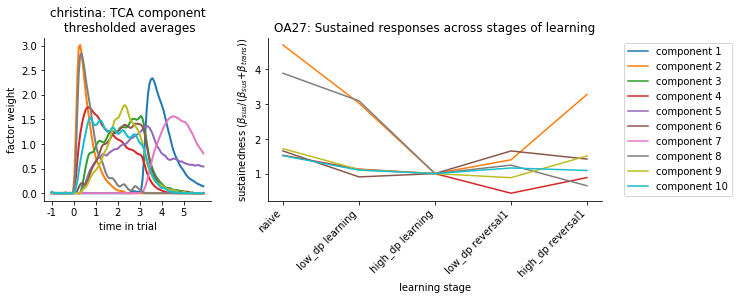

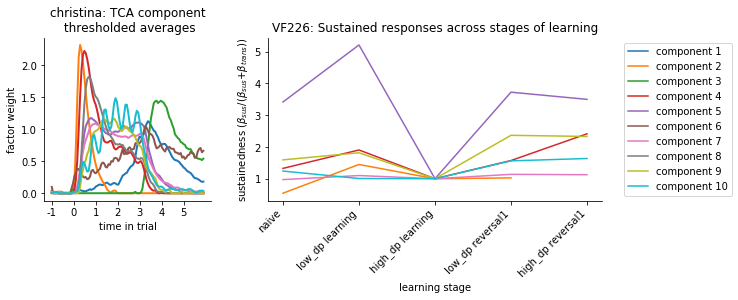

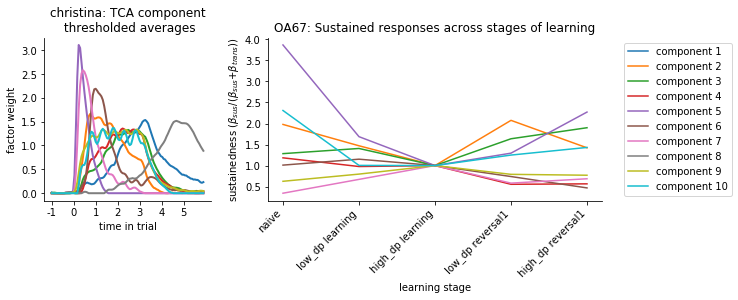

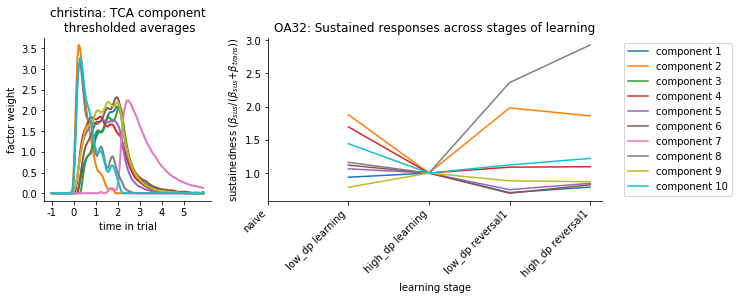

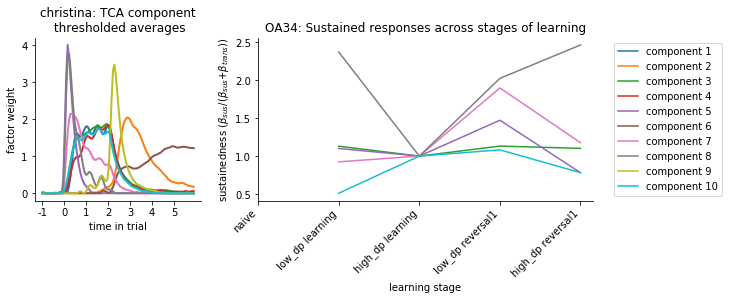

...

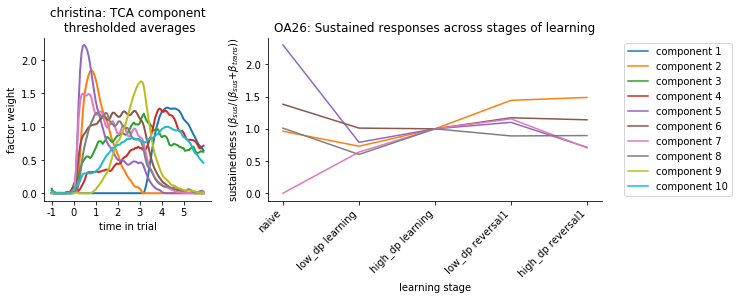

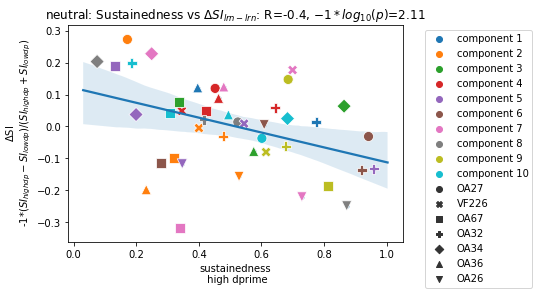

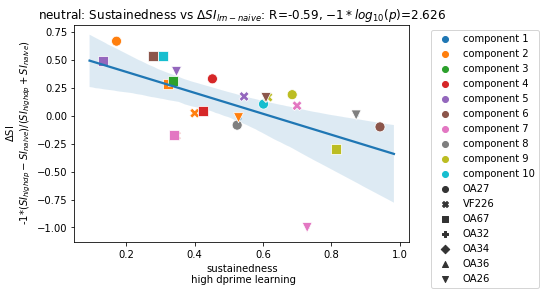

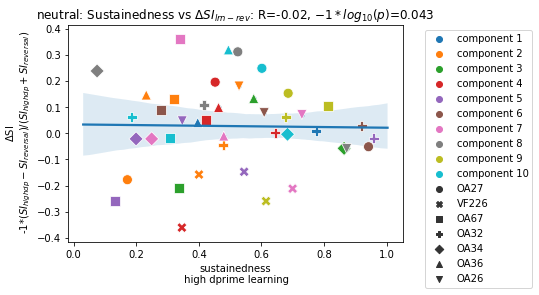

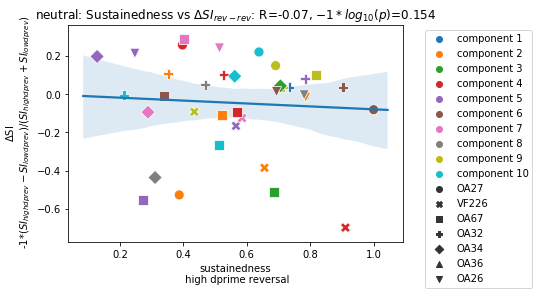

In [118]:
alpha = 0.7
color_vals = [[0.46, 0.85, 0.47, 0.1], [0.84, 0.12, 0.13, 0.1], [0.28, 0.68, 0.93, alpha]]
ksthresh = 1.31 #35
dp_threshold = 2
t_or_wa = 'thresh'

folder = 'Sustainedness index plots daily thresh fit on means'
# folder = 'Sustainedness index plots daily thresh mean of trials fits'
if not os.path.isdir(folder): os.mkdir(folder)
save_dir = os.path.join(folder, 'Sustainedness plots')
if not os.path.isdir(save_dir): os.mkdir(save_dir)

if t_or_wa == 'thresh':
    which_fits = deepcopy(fits2)
#     which_ks = deepcopy(proj_ks_dict2)
elif t_or_wa == 'weighted_avg':
    which_fits = deepcopy(fits)
#     which_ks = deepcopy(proj_ks_dict)

for ori in ['plus', 'minus', 'neutral']:
    ti_cont, mi_cont, ci_cont = [], [], []
    ti_norm_cont = []
    for mi, meti, V in zip(mice, meta_list, model_list):
        
        # add dprime to meti
        meti = cas.utils.add_dprime_to_meta(meti)
        
        # get indices for stimulus period
        tstart = int(np.floor(15.5))
        tend = int(np.floor(15.5*1.5))
        if mi in ['OA32', 'OA34', 'OA36']:
            send = int(np.floor(15.5*3))
        else:
            send = int(np.floor(15.5*4))
        sstart = int(np.floor(send-15.5/2))
        
        # calculate change indices for days and reversal/learning
        dates = meti.reset_index()['date']
        udays = {d: c for c, d in enumerate(np.unique(dates))}
        ndays = np.diff([udays[i] for i in np.unique(dates)])
        day_x = np.where(ndays)[0] + 0.5

        # get your learning and reversal start indices 
        rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
        rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 0.5
        if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
            lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
            lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 0.5
        else:
            lear_ind = 0 - 0.5

        fig = plt.figure(figsize=(10, 3))
        gs = fig.add_gridspec(100, 100)
        ax1 = fig.add_subplot(gs[:, :30])
        sns.despine()
        ax2 = fig.add_subplot(gs[:, 40:])
        sns.despine()

        temp_fac = V.results[rank][0].factors[1][:, :]
        ax1.plot(temp_fac, linewidth=2)
        ax2.set_title('temporal factor')

#         ori_bool = meti['orientation'].isin([lookup[mi][ori]])
    #     ori_bool = meti['orientation'].isin([0, 135, 270])

        first_boo = _first100_bool(meti)
    #     all_means3 = np.zeros((len(meti['orientation'].unique()), 5, len(fits[mi].keys())))
        all_means3 = np.zeros((1, 5, len(which_fits[mi].keys())))
        all_means3[:] = np.nan
        for comp_n in range(1, len(which_fits[mi].keys())+1):

            mi_cont.append(mi)
            ci_cont.append(comp_n)
            
            # don't consider offset components
            temp_fac = V.results[rank][0].factors[1][:, comp_n-1]
            if np.argmax(temp_fac) > send:
                continue
            
            ori_type = 'ori_{}'.format(lookup[mi][ori])
            trial_type = 'trial_inds_{}'.format(lookup[mi][ori])
            fit_mat = which_fits[mi]['component_{}'.format(comp_n)][ori_type]
#             x = which_fits[mi]['component_{}'.format(comp_n)][trial_type]
#             day_avg = daily_avg_dict[mi][comp_n][lookup[mi][ori]]
#             a = np.nanmean(day_avg[sstart:send, :], axis=0)  # sustained
#             b = np.nanmean(day_avg[tstart:tend, :], axis=0)  # transient
#             a[a < 0] = 0 
#             b[b < 0] = 0
#             y_vec = a #/(a + b)
            y_vec = fit_mat[:,1]/(fit_mat[:,1] + fit_mat[:,0])
#             y_vec[x] = y
#             ks_boo = which_ks[mi][lookup[mi][cs_type]][comp_n-1, :] < ksthresh
#             y_vec[ks_boo] = np.nan

            stage_labels = []
            c_day = 0
            for n_day in meta_list[0]['learning_state'].unique(): # forcing to include all stages
                meti_d = meti.groupby('date').max()
                day_bool = meti_d['learning_state'].isin([n_day]).values
                if n_day == 'naive':
    #                 for c_ori, n_ori in enumerate(meti['orientation'].unique()):
    #                     ori_bool = meti['orientation'].isin([n_ori]).values
    #                     total_bool = ori_bool & day_bool & first_boo
                    total_bool = day_bool #& (y_vec < 1)
                    stage_labels.append(n_day)
                        # if there are no trials of a given type skip
                    if np.sum(total_bool) == 0:
    #                     print('Skipped empty for: naive')
                        c_day += 1
                        continue

                    if np.sum(~np.isnan(y_vec)) <= len(y_vec)/3:
                        c_day += 1
                        continue
                    # subtract mean trace from each cell
    #                 print(np.nanmean(y_vec[total_bool]))
                    all_means3[0, c_day, comp_n-1] = np.nanmean(y_vec[total_bool])
                    c_day += 1
                else:
                    for dpi in ['low_dp', 'high_dp']:
                        if dpi == 'high_dp':
                            dp_bool = meti_d['dprime'].values >= dp_threshold
                        elif dpi == 'low_dp':
                            dp_bool = meti_d['dprime'].values < dp_threshold
    #                     for c_ori, n_ori in enumerate(meti['orientation'].unique()):
    #                         ori_bool = meti['orientation'].isin([n_ori]).values
                        total_bool = day_bool & dp_bool #& (y_vec < 1) #& ori_bool

                        stage_labels.append('{} {}'.format(dpi, n_day))
                        # if there are no trials of a given type skip
                        if np.sum(total_bool) == 0:
                            print('Skipped empty for: {} {}'.format(dpi, n_day))
                            c_day += 1
                            continue
                        if np.sum(~np.isnan(y_vec)) <= len(y_vec)/3:
                            c_day += 1
                            continue

                        # subtract mean trace from each cell
                        all_means3[0, c_day, comp_n-1] = np.nanmean(y_vec[total_bool])
                        c_day += 1

    #     all_means3[all_means3 < 0] = 0
    #     droppers = np.max(all_means3, axis=0) > 0.01
    #     tuning_index = np.max(all_means3, axis=0)/np.mean(all_means3, axis=0)
        tuning_index = all_means3.squeeze()
        ti_cont.append(tuning_index)  #for continued analysis 
        tuning_index = tuning_index/tuning_index[2, :]
        ti_norm_cont.append(tuning_index)  #for continued analysis 
    #     tuning_index[droppers] = np.nan


        ax2.plot(tuning_index)
        ax2.legend(bbox_to_anchor=(1.05, 1), labels=['component {}'.format(k) for k in thresh_list[0].keys()])
        ax2.set_title('{}: Sustained responses across stages of learning'.format(mi))
        ax1.set_title('{}: TCA component\n thresholded averages'.format(words[0]))
        ax1.set_xlabel('time in trial')
        ax1.set_ylabel('factor weight')
        stim_window_ticks = np.arange(0, 108, 15.5)
        stim_window_labels = np.arange(-1, 7, 1)
        ax1.set_xticks(stim_window_ticks)
        ax1.set_xticklabels(labels=stim_window_labels)
        ax2.set_xlabel('learning stage')
        ax2.set_ylabel(r'sustainedness ($\beta_{sus}$/($\beta_{sus}$+$\beta_{trans}$))')
        stage_ticks = np.arange(0, 5, 1)
        ax2.set_xticks(stage_ticks)
        ax2.set_xticklabels(labels=stage_labels, rotation=45, ha='right')
        plt.savefig('.//{}//Sustainedness plots//{}_{}_{}_{}_sus_avg_stages.pdf'.format(folder, t_or_wa, mi, ori, words[0]), bbox_inches='tight')
#         plt.close('all')
    
    stacked_nsus_idx = np.vstack([s.T for s in ti_norm_cont])
    stacked_sus_idx = np.vstack([s.T for s in ti_cont])
    index = pd.MultiIndex.from_arrays([mi_cont, ci_cont], names=['mouse', 'component'])
    sus_df = pd.DataFrame(data=stacked_sus_idx, columns=stage_labels, index=index)
    norm_sus_df = pd.DataFrame(data=stacked_nsus_idx, columns=stage_labels, index=index)
    
    plt.figure()
    dsus = ((sus_df['high_dp learning'] - sus_df['low_dp learning'])*-1)/(sus_df['high_dp learning'] + sus_df['low_dp learning'])
    # dsusr = (norm_sus_df['high_dp learning'] - norm_sus_df['low_dp reversal1'])*-1
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=sus_df.index)
    sns.regplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], marker='.')
#     sns.scatterplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], hue=sus_df.reset_index()['mouse'].values)
    sns.scatterplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=['component {}'.format(s) for s in sus_df.reset_index()['component'].values],
                    style=sus_df.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1))
    # plt.ylim([-0.2, 0.2])
    keep_bool = ~np.isnan(tester['delta_sus'])
    r = sp.stats.pearsonr(sus_df['high_dp learning'].loc[keep_bool], tester['delta_sus'].loc[keep_bool])
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{low dp})/(SI_{high dp}+SI_{low dp}$)')
    plt.xlabel('sustainedness\n high dprime')
    plt.title('{}: '.format(ori) + 'Sustainedness vs $\Delta$$SI_{lrn-lrn}$' + ': R={}, {}={}'.format(round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_learnldp.pdf'.format(folder, t_or_wa, ori, words[0]), bbox_inches='tight')

    plt.figure()
    dsus = ((sus_df['high_dp learning'] - sus_df['naive'])*-1)/(sus_df['high_dp learning'] + sus_df['naive'])
    # dsusr = (norm_sus_df['high_dp learning'] - norm_sus_df['low_dp reversal1'])*-1
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=sus_df.index)
    sns.regplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], marker='.')
#     sns.scatterplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], hue=sus_df.reset_index()['mouse'].values)
    sns.scatterplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=['component {}'.format(s) for s in sus_df.reset_index()['component'].values],
                    style=sus_df.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1))
    # plt.ylim([-0.2, 0.15])
    keep_bool = ~np.isnan(tester['delta_sus'])
    r = sp.stats.pearsonr(sus_df['high_dp learning'].loc[keep_bool], tester['delta_sus'].loc[keep_bool])
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{naive})/(SI_{high dp}+SI_{naive}$)')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('{}: '.format(ori) + 'Sustainedness vs $\Delta$$SI_{lrn-naive}$' + ': R={}, {}={}'.format(round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_naive.pdf'.format(folder, t_or_wa, ori, words[0]), bbox_inches='tight')
    
    plt.figure()
    dsus = ((sus_df['high_dp learning'] - sus_df['low_dp reversal1'])*-1)/(sus_df['high_dp learning'] + sus_df['low_dp reversal1'])
    # dsusr = (norm_sus_df['high_dp learning'] - norm_sus_df['low_dp reversal1'])*-1
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=sus_df.index)
    sns.regplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], marker='.')
#     sns.scatterplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], hue=sus_df.reset_index()['mouse'].values)
    sns.scatterplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=['component {}'.format(s) for s in sus_df.reset_index()['component'].values],
                    style=sus_df.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1))
    # plt.ylim([-0.2, 0.2])
    keep_bool = ~np.isnan(tester['delta_sus'])
    r = sp.stats.pearsonr(sus_df['high_dp learning'].loc[keep_bool], tester['delta_sus'].loc[keep_bool])
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{reversal})/(SI_{high dp}+SI_{reversal}$)')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('{}: '.format(ori) + 'Sustainedness vs $\Delta$$SI_{lrn-rev}$' + ': R={}, {}={}'.format(round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_revldp.pdf'.format(folder, t_or_wa, ori, words[0]), bbox_inches='tight')
    
    plt.figure()
    dsus = ((sus_df['high_dp reversal1'] - sus_df['low_dp reversal1'])*-1)/(sus_df['high_dp reversal1'] + sus_df['low_dp reversal1'])
    # dsusr = (norm_sus_df['high_dp learning'] - norm_sus_df['low_dp reversal1'])*-1
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=sus_df.index)
    sns.regplot(x=sus_df['high_dp reversal1'], y=tester['delta_sus'], marker='.')
#     sns.scatterplot(x=sus_df['high_dp reversal1'], y=tester['delta_sus'], hue=sus_df.reset_index()['mouse'].values)
    sns.scatterplot(x=sus_df['high_dp reversal1'], y=tester['delta_sus'], s=100,
                    hue=['component {}'.format(s) for s in sus_df.reset_index()['component'].values],
                    style=sus_df.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1))
    # plt.ylim([-0.2, 0.2])
    keep_bool = ~np.isnan(tester['delta_sus'])
    r = sp.stats.pearsonr(sus_df['high_dp reversal1'].loc[keep_bool], tester['delta_sus'].loc[keep_bool])
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp rev}-SI_{low dp rev})/(SI_{high dp rev}+SI_{low dp rev}$)')
    plt.xlabel('sustainedness\n high dprime reversal')
    plt.title('{}: '.format(ori) + 'Sustainedness vs $\Delta$$SI_{rev-rev}$' + ': R={}, {}={}'.format(round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    plt.savefig('.//{}//{}_{}_{}_SI_revhdp_v_revldp.pdf'.format(folder, t_or_wa, ori, words[0]), bbox_inches='tight')

In [47]:
## do this with all CS and fits on the same plot so need to re-order the for loops

alpha = 0.7
color_vals = [[0.46, 0.85, 0.47, 0.1], [0.84, 0.12, 0.13, 0.1], [0.28, 0.68, 0.93, alpha]]
ksthresh = 1.31 #35
dp_threshold = 2
t_or_wa = 'thresh'

# folder = 'Sustainedness index plots daily thresh fit on means'
folder = 'Sustainedness index plots daily thresh mean of trials fits'
if not os.path.isdir(folder): os.mkdir(folder)
save_dir = os.path.join(folder, 'Sustainedness plots')
if not os.path.isdir(save_dir): os.mkdir(save_dir)

if t_or_wa == 'thresh':
    which_fits = deepcopy(fits2)
#     which_ks = deepcopy(proj_ks_dict2)
elif t_or_wa == 'weighted_avg':
    which_fits = deepcopy(fits)
#     which_ks = deepcopy(proj_ks_dict)

sus_list, hues = [], []
for ori in ['plus', 'minus', 'neutral']:
    ti_cont, mi_cont, ci_cont, ori_cont = [], [], [], []
    ti_norm_cont = []
    for mi, meti, V in zip(mice, meta_list, model_list):
        
        # add dprime to meti
        meti = cas.utils.add_dprime_to_meta(meti)
        
        # get indices for stimulus period
        tstart = int(np.floor(15.5))
        tend = int(np.floor(15.5*1.5))
        if mi in ['OA32', 'OA34', 'OA36']:
            send = int(np.floor(15.5*3))
        else:
            send = int(np.floor(15.5*4))
        sstart = int(np.floor(send-15.5/2))
        
        # calculate change indices for days and reversal/learning
        dates = meti.reset_index()['date']
        udays = {d: c for c, d in enumerate(np.unique(dates))}
        ndays = np.diff([udays[i] for i in np.unique(dates)])
        day_x = np.where(ndays)[0] + 0.5

        # get your learning and reversal start indices 
        rev_ind = np.where(meti['learning_state'].isin(['learning']).values)[0][-1]
        rev_ind = np.where(np.unique(dates) == dates[rev_ind])[0] + 0.5
        if np.sum(meti['learning_state'].isin(['naive']).values) != 0:
            lear_ind = np.where(meti['learning_state'].isin(['naive']).values)[0][-1]
            lear_ind = np.where(np.unique(dates) == dates[lear_ind])[0] + 0.5
        else:
            lear_ind = 0 - 0.5

#         fig = plt.figure(figsize=(10, 3))
#         gs = fig.add_gridspec(100, 100)
#         ax1 = fig.add_subplot(gs[:, :30])
#         sns.despine()
#         ax2 = fig.add_subplot(gs[:, 40:])
#         sns.despine()

#         temp_fac = V.results[rank][0].factors[1][:, :]
#         ax1.plot(temp_fac, linewidth=2)
#         ax2.set_title('temporal factor')

#         ori_bool = meti['orientation'].isin([lookup[mi][ori]])
    #     ori_bool = meti['orientation'].isin([0, 135, 270])

        first_boo = _first100_bool(meti)
    #     all_means3 = np.zeros((len(meti['orientation'].unique()), 5, len(fits[mi].keys())))
        all_means3 = np.zeros((1, 5, len(which_fits[mi].keys())))
        all_means3[:] = np.nan
        for comp_n in range(1, len(which_fits[mi].keys())+1):

            mi_cont.append(mi)
            ci_cont.append(comp_n)
            ori_cont.append('initial {}'.format(ori))
            
            # don't consider offset components
            temp_fac = V.results[rank][0].factors[1][:, comp_n-1]
            if np.argmax(temp_fac) > send:
                continue
            
            ori_type = 'ori_{}'.format(lookup[mi][ori])
            trial_type = 'trial_inds_{}'.format(lookup[mi][ori])
            fit_mat = which_fits[mi]['component_{}'.format(comp_n)][ori_type]
#             x = which_fits[mi]['component_{}'.format(comp_n)][trial_type]
#             day_avg = daily_avg_dict[mi][comp_n][lookup[mi][ori]]
#             a = np.nanmean(day_avg[sstart:send, :], axis=0)  # sustained
#             b = np.nanmean(day_avg[tstart:tend, :], axis=0)  # transient
#             a[a < 0] = 0 
#             b[b < 0] = 0
#             y_vec = a #/(a + b)
            y_vec = fit_mat[:,0] #/(fit_mat[:,1] + fit_mat[:,0])
#             y_vec[x] = y
#             ks_boo = which_ks[mi][lookup[mi][cs_type]][comp_n-1, :] < ksthresh
#             y_vec[ks_boo] = np.nan

            stage_labels = []
            c_day = 0
            for n_day in meta_list[0]['learning_state'].unique(): # forcing to include all stages
                meti_d = meti.groupby('date').max()
                day_bool = meti_d['learning_state'].isin([n_day]).values
                if n_day == 'naive':
    #                 for c_ori, n_ori in enumerate(meti['orientation'].unique()):
    #                     ori_bool = meti['orientation'].isin([n_ori]).values
    #                     total_bool = ori_bool & day_bool & first_boo
                    total_bool = day_bool #& (y_vec < 1)
                    stage_labels.append(n_day)
                        # if there are no trials of a given type skip
                    if np.sum(total_bool) == 0:
    #                     print('Skipped empty for: naive')
                        c_day += 1
                        continue

                    if np.sum(~np.isnan(y_vec)) <= len(y_vec)/3:
                        c_day += 1
                        continue
                    # subtract mean trace from each cell
    #                 print(np.nanmean(y_vec[total_bool]))
                    all_means3[0, c_day, comp_n-1] = np.nanmean(y_vec[total_bool])
                    c_day += 1
                else:
                    for dpi in ['low_dp', 'high_dp']:
                        if dpi == 'high_dp':
                            dp_bool = meti_d['dprime'].values >= dp_threshold
                        elif dpi == 'low_dp':
                            dp_bool = meti_d['dprime'].values < dp_threshold
    #                     for c_ori, n_ori in enumerate(meti['orientation'].unique()):
    #                         ori_bool = meti['orientation'].isin([n_ori]).values
                        total_bool = day_bool & dp_bool #& (y_vec < 1) #& ori_bool

                        stage_labels.append('{} {}'.format(dpi, n_day))
                        # if there are no trials of a given type skip
                        if np.sum(total_bool) == 0:
                            print('Skipped empty for: {} {}'.format(dpi, n_day))
                            c_day += 1
                            continue
                        if np.sum(~np.isnan(y_vec)) <= len(y_vec)/3:
                            c_day += 1
                            continue

                        # subtract mean trace from each cell
                        all_means3[0, c_day, comp_n-1] = np.nanmean(y_vec[total_bool])
                        c_day += 1

    #     all_means3[all_means3 < 0] = 0
    #     droppers = np.max(all_means3, axis=0) > 0.01
    #     tuning_index = np.max(all_means3, axis=0)/np.mean(all_means3, axis=0)
        tuning_index = all_means3.squeeze()
        ti_cont.append(tuning_index)  #for continued analysis 
        tuning_index = tuning_index/tuning_index[2, :]
        ti_norm_cont.append(tuning_index)  #for continued analysis 
    #     tuning_index[droppers] = np.nan


#         ax2.plot(tuning_index)
#         ax2.legend(bbox_to_anchor=(1.05, 1), labels=['component {}'.format(k) for k in thresh_list[0].keys()])
#         ax2.set_title('{}: Sustained responses across stages of learning'.format(mi))
#         ax1.set_title('{}: TCA component\n thresholded averages'.format(words[0]))
#         ax1.set_xlabel('time in trial')
#         ax1.set_ylabel('factor weight')
#         stim_window_ticks = np.arange(0, 108, 15.5)
#         stim_window_labels = np.arange(-1, 7, 1)
#         ax1.set_xticks(stim_window_ticks)
#         ax1.set_xticklabels(labels=stim_window_labels)
#         ax2.set_xlabel('learning stage')
#         ax2.set_ylabel(r'sustainedness ($\beta_{sus}$/($\beta_{sus}$+$\beta_{trans}$))')
#         stage_ticks = np.arange(0, 5, 1)
#         ax2.set_xticks(stage_ticks)
#         ax2.set_xticklabels(labels=stage_labels, rotation=45, ha='right')
#         plt.savefig('.//{}//Sustainedness plots//{}_{}_{}_{}_sus_avg_stages.pdf'.format(folder, t_or_wa, mi, ori, words[0]), bbox_inches='tight')
#         plt.close('all')
    
    stacked_nsus_idx = np.vstack([s.T for s in ti_norm_cont])
    stacked_sus_idx = np.vstack([s.T for s in ti_cont])
    index = pd.MultiIndex.from_arrays([mi_cont, ci_cont, ori_cont], names=['mouse', 'component', 'initial CS'])
    sus_df = pd.DataFrame(data=stacked_sus_idx, columns=stage_labels, index=index)
    norm_sus_df = pd.DataFrame(data=stacked_nsus_idx, columns=stage_labels, index=index)
    sus_list.append(sus_df)
    hues.append(color_dict[ori])
print('done.')

D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:144: RuntimeWarning: Mean of empty slice


Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1


D:\Anaconda3\lib\site-packages\ipykernel_launcher.py:121: RuntimeWarning: Mean of empty slice


Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
Skipped empty for: high_dp reversal1
done.


In [48]:
total_sus = pd.concat(sus_list, axis=0)
total_sus.head()

hue_dict = {}
for ori in ['plus', 'minus', 'neutral']:
    hue_dict['initial {}'.format(ori)] = color_dict[ori]

# SUS

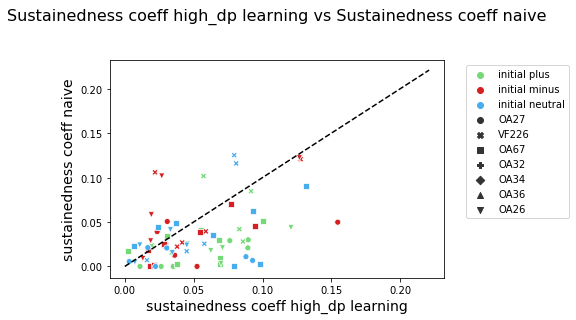

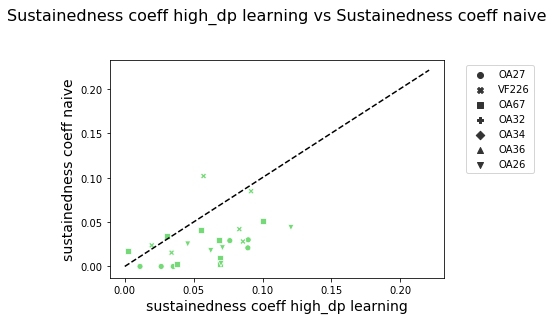

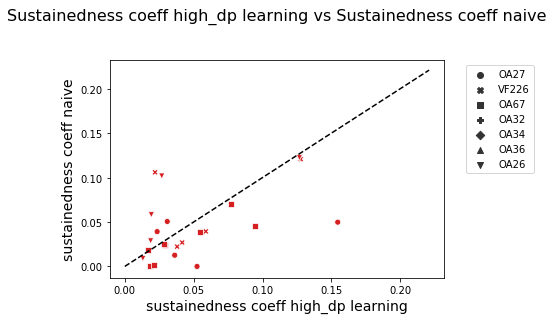

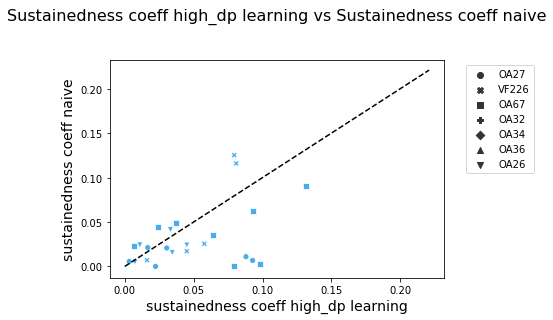

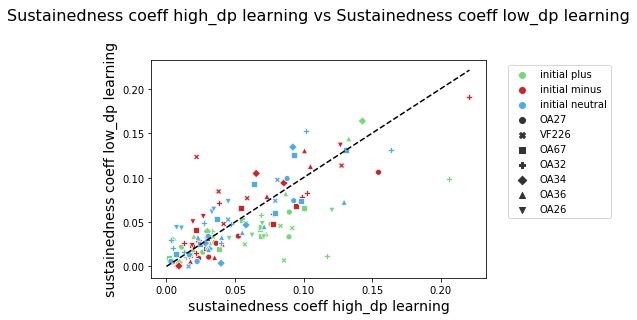

...

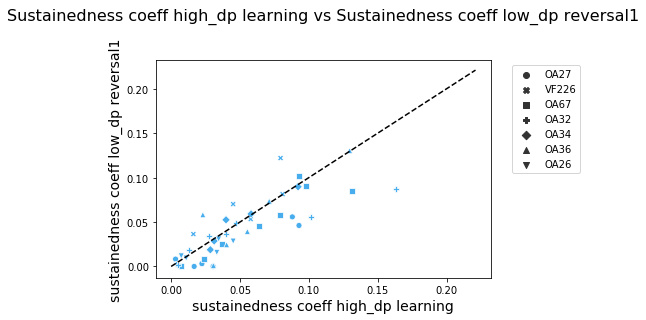

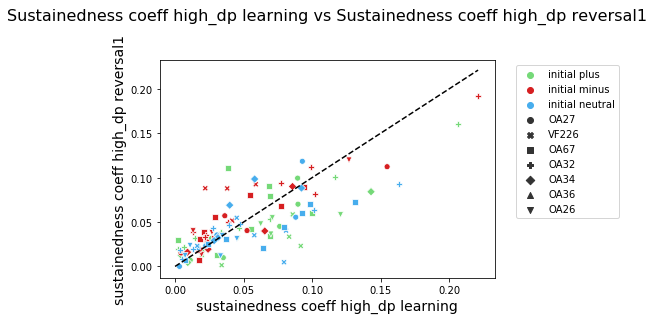

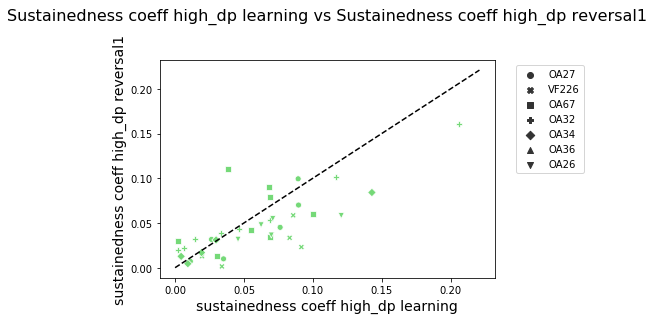

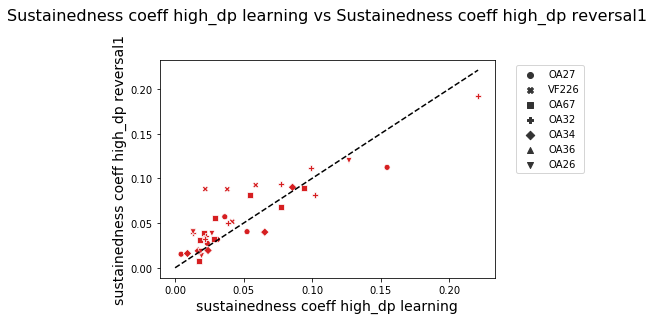

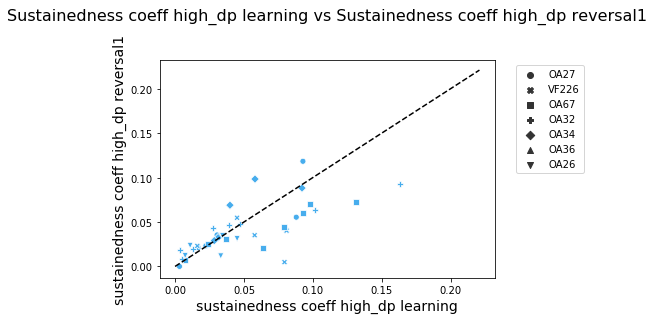

In [49]:
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
folder = 'Sustainedness plots component thresh scatter'
tag = 'v1'
primary_stage = 'high_dp learning'
secondary_stages = [s for s in stages if s != primary_stage]

if not os.path.isdir(folder): os.mkdir(folder)
save_dir = os.path.join(folder, primary_stage)
if not os.path.isdir(save_dir): os.mkdir(save_dir)
    
for stages_to_comp in secondary_stages:
    plt.figure()
    # for ori in ['plus', 'minus', 'neutral']:
    #     ori_vec = total_sus.reset_index()['initial CS'].values
    # oriboo = ori_vec == 'initial {}'.format(ori)
    sns.scatterplot(x=total_sus[primary_stage].values, 
                    y=total_sus[stages_to_comp].values,
                    palette=hue_dict,
                    hue=total_sus.reset_index()['initial CS'].values,
                    style=total_sus.reset_index()['mouse'].values)
    xmax = np.nanmax(total_sus[primary_stage].values)
    ymax = np.nanmax(total_sus[stages_to_comp].values)
    maxval = np.nanmax([xmax, ymax])
    plt.plot([0, maxval], [0, maxval], 'k--')
    plt.xlabel(primary_stage)
    plt.ylabel(stages_to_comp)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.ylabel('sustainedness coeff {}'.format(stages_to_comp), size=14)
    plt.xlabel('sustainedness coeff {}'.format(primary_stage), size=14)
    plt.title('Sustainedness coeff {} vs Sustainedness coeff {}\n\n'.format(primary_stage, stages_to_comp), size=16)
    plt.savefig('.//{}//{}_{}_{}_sus_{}_v_{}.pdf'.format(save_dir, t_or_wa, tag, words[0], primary_stage, stages_to_comp),
                bbox_inches='tight')


    for ori in ['plus', 'minus', 'neutral']:
        plt.figure()
    #     f, ax = plt.subplots(figsize=(7, 7))
    #     ax.set(xscale="log", yscale="log")
        ori_vec = total_sus.reset_index()['initial CS'].values
        oriboo = ori_vec == 'initial {}'.format(ori)
        sns.scatterplot(x=total_sus[primary_stage].iloc[oriboo].values, 
                        y=total_sus[stages_to_comp].iloc[oriboo].values,
                        color=hue_dict['initial {}'.format(ori)],
                        style=total_sus.reset_index()['mouse'].iloc[oriboo].values)
        plt.plot([0, maxval], [0, maxval], 'k--')
    #     plt.yscale('log')
    #     plt.xscale('log')
    #     plt.ylim([-5, None])
    #     plt.xlim([-5, None])
        plt.xlabel(primary_stage)
        plt.ylabel(stages_to_comp)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.ylabel('sustainedness coeff {}'.format(stages_to_comp), size=14)
        plt.xlabel('sustainedness coeff {}'.format(primary_stage), size=14)
        plt.title('Sustainedness coeff {} vs Sustainedness coeff {}\n\n'.format(primary_stage, stages_to_comp), size=16)
        plt.savefig('.//{}//{}_{}_{}_sus_initial_{}_{}_v_{}.pdf'.format(save_dir, t_or_wa, tag, words[0], ori, primary_stage, stages_to_comp),
                    bbox_inches='tight')

# TRANS

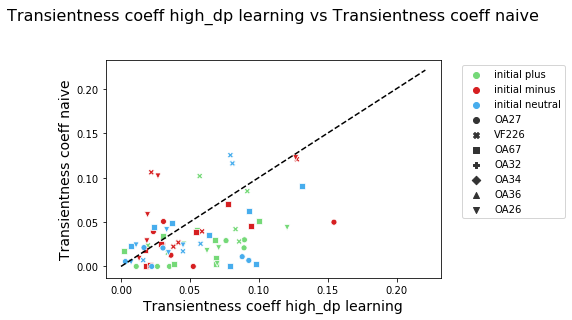

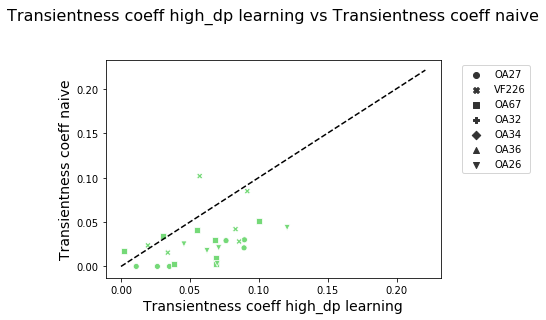

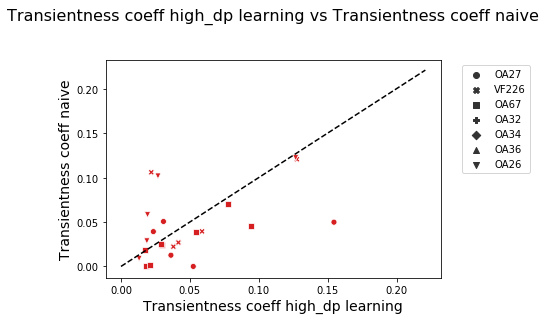

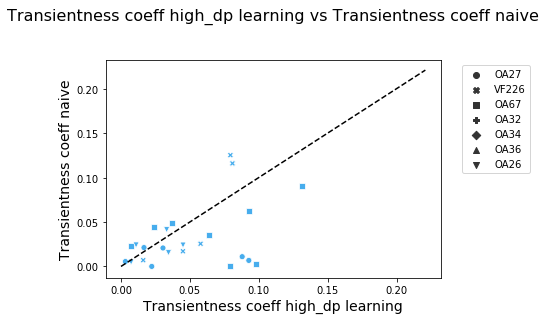

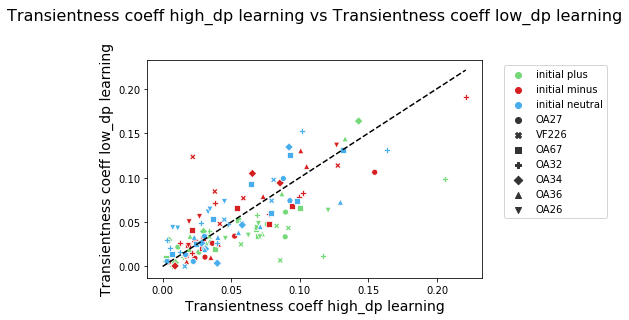

...

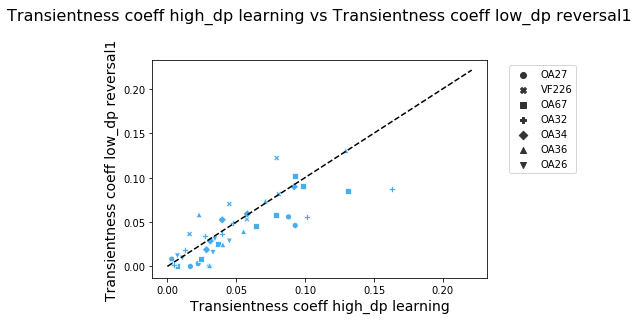

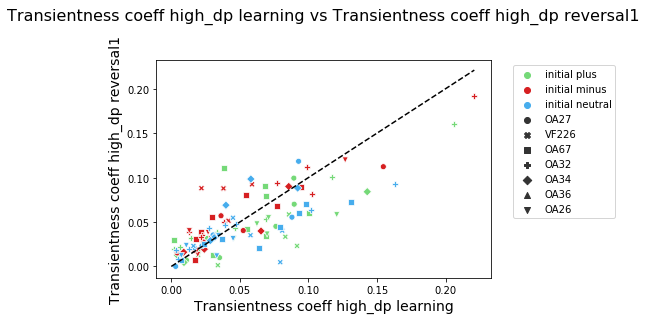

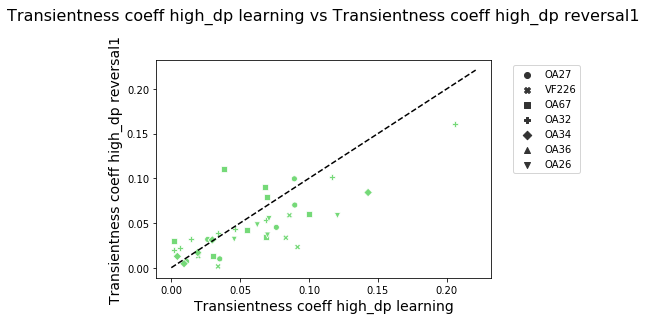

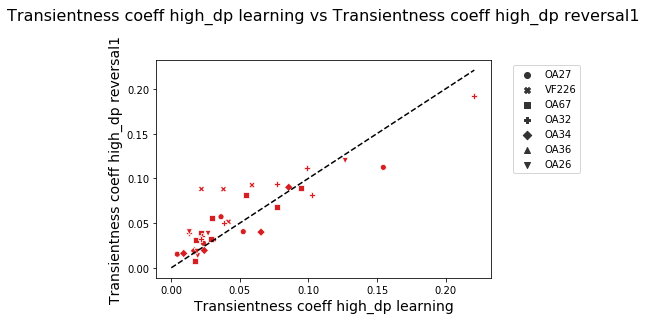

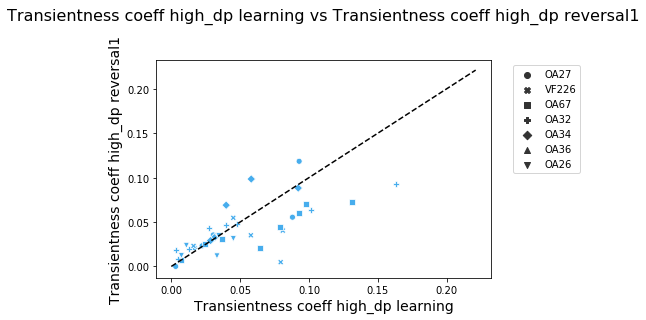

In [50]:
stages = ['naive', 'low_dp learning', 'high_dp learning', 'low_dp reversal1', 'high_dp reversal1']
folder = 'Transient plots component thresh scatter'
tag = 'v1'
primary_stage = 'high_dp learning'
secondary_stages = [s for s in stages if s != primary_stage]

if not os.path.isdir(folder): os.mkdir(folder)
save_dir = os.path.join(folder, primary_stage)
if not os.path.isdir(save_dir): os.mkdir(save_dir)
    
for stages_to_comp in secondary_stages:
    plt.figure()
    # for ori in ['plus', 'minus', 'neutral']:
    #     ori_vec = total_sus.reset_index()['initial CS'].values
    # oriboo = ori_vec == 'initial {}'.format(ori)
    sns.scatterplot(x=total_sus[primary_stage].values, 
                    y=total_sus[stages_to_comp].values,
                    palette=hue_dict,
                    hue=total_sus.reset_index()['initial CS'].values,
                    style=total_sus.reset_index()['mouse'].values)
    xmax = np.nanmax(total_sus[primary_stage].values)
    ymax = np.nanmax(total_sus[stages_to_comp].values)
    maxval = np.nanmax([xmax, ymax])
    plt.plot([0, maxval], [0, maxval], 'k--')
    plt.xlabel(primary_stage)
    plt.ylabel(stages_to_comp)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.ylabel('Transientness coeff {}'.format(stages_to_comp), size=14)
    plt.xlabel('Transientness coeff {}'.format(primary_stage), size=14)
    plt.title('Transientness coeff {} vs Transientness coeff {}\n\n'.format(primary_stage, stages_to_comp), size=16)
    plt.savefig('.//{}//{}_{}_{}_trans_{}_v_{}.pdf'.format(save_dir, t_or_wa, tag, words[0], primary_stage, stages_to_comp),
                bbox_inches='tight')


    for ori in ['plus', 'minus', 'neutral']:
        plt.figure()
    #     f, ax = plt.subplots(figsize=(7, 7))
    #     ax.set(xscale="log", yscale="log")
        ori_vec = total_sus.reset_index()['initial CS'].values
        oriboo = ori_vec == 'initial {}'.format(ori)
        sns.scatterplot(x=total_sus[primary_stage].iloc[oriboo].values, 
                        y=total_sus[stages_to_comp].iloc[oriboo].values,
                        color=hue_dict['initial {}'.format(ori)],
                        style=total_sus.reset_index()['mouse'].iloc[oriboo].values)
        plt.plot([0, maxval], [0, maxval], 'k--')
    #     plt.yscale('log')
    #     plt.xscale('log')
    #     plt.ylim([-5, None])
    #     plt.xlim([-5, None])
        plt.xlabel(primary_stage)
        plt.ylabel(stages_to_comp)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.ylabel('Transientness coeff {}'.format(stages_to_comp), size=14)
        plt.xlabel('Transientness coeff {}'.format(primary_stage), size=14)
        plt.title('Transientness coeff {} vs Transientness coeff {}\n\n'.format(primary_stage, stages_to_comp), size=16)
        plt.savefig('.//{}//{}_{}_{}_trans_initial_{}_{}_v_{}.pdf'.format(save_dir, t_or_wa, tag, words[0], ori, primary_stage, stages_to_comp),
                    bbox_inches='tight')

Text(0.5, 1.0, 'Average sustainedness for component-groups >0.5 SI high dp learning\n')

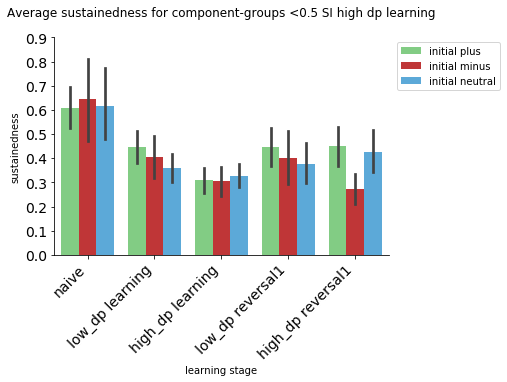

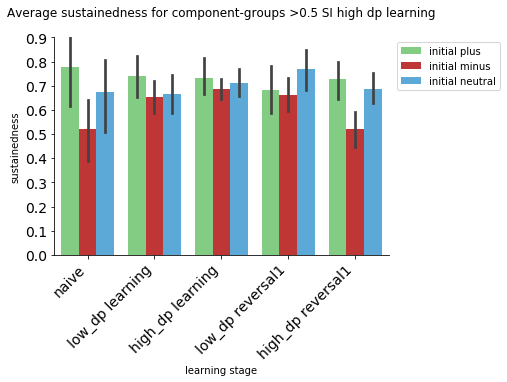

In [44]:

plt.figure()
filter_sus = total_sus.loc[total_sus['high_dp learning'].lt(0.5), :]
# filter_sus = total_sus.loc[total_sus['high_dp learning'].gt(0.5), :]
test = filter_sus.stack()
new_df = test.to_frame().reset_index()
mapper = {'level_3': 'learning stage', 0: 'sustainedness'}
new_stage_df = new_df.rename(columns=mapper)

hue_dict = {}
for ori in ['plus', 'minus', 'neutral']:
    hue_dict['initial {}'.format(ori)] = color_dict[ori]

sns.barplot(x='learning stage', y='sustainedness', data=new_stage_df, hue='initial CS', palette=hue_dict)
plt.xticks(rotation=45, ha='right', size=14)
plt.yticks(size=14)
plt.ylim([0, 0.9])
# plt.ylabel(size=16)
# plt.xlabel(size=16)
sns.despine()
plt.legend(bbox_to_anchor=(1.01, 1), loc='upper left')
plt.title('Average sustainedness for component-groups <0.5 SI high dp learning\n')
# sns.lineplot(data=new_stage_df, y='sustainedness', x='learning stage', hue='initial CS')

plt.figure()
# filter_sus = total_sus.loc[total_sus['high_dp learning'].lt(0.5), :]
filter_sus = total_sus.loc[total_sus['high_dp learning'].gt(0.5), :]
test = filter_sus.stack()
new_df = test.to_frame().reset_index()
mapper = {'level_3': 'learning stage', 0: 'sustainedness'}
new_stage_df = new_df.rename(columns=mapper)

hue_dict = {}
for ori in ['plus', 'minus', 'neutral']:
    hue_dict['initial {}'.format(ori)] = color_dict[ori]

sns.barplot(x='learning stage', y='sustainedness', data=new_stage_df, hue='initial CS', palette=hue_dict)
plt.xticks(rotation=45, ha='right', size=14)
plt.yticks(size=14)
plt.ylim([0, 0.9])
# plt.ylabel(size=16)
# plt.xlabel(size=16)
sns.despine()
plt.legend(bbox_to_anchor=(1.01, 1), loc='upper left')
plt.title('Average sustainedness for component-groups >0.5 SI high dp learning\n')

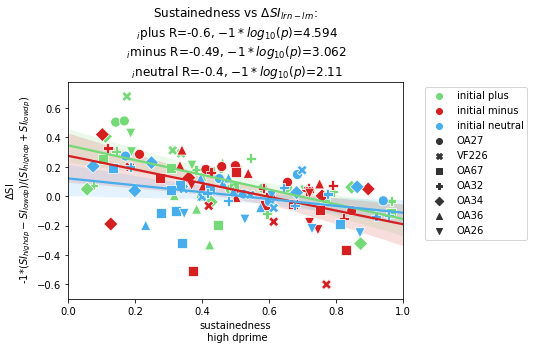

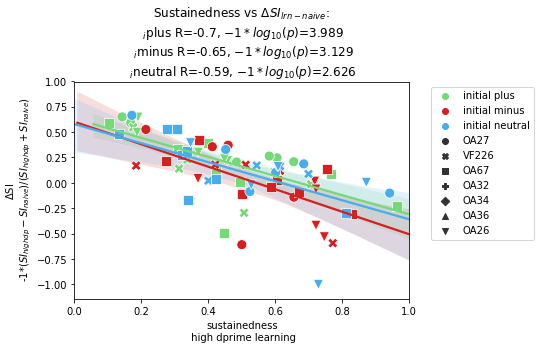

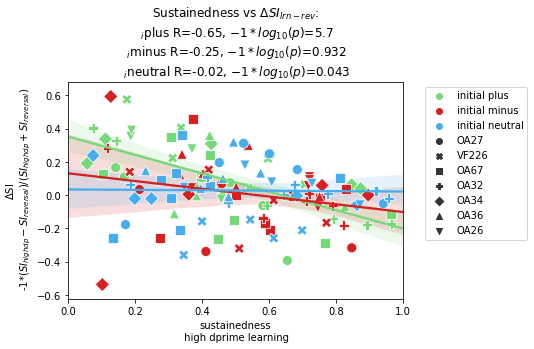

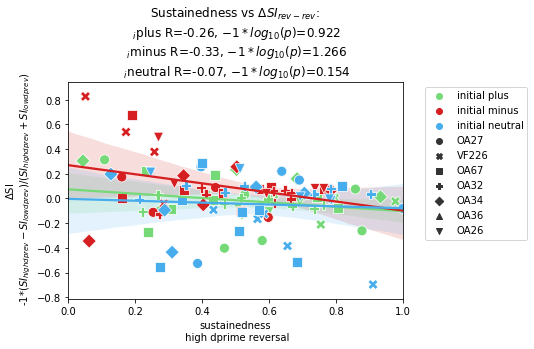

In [291]:
folder = 'Sustainedness index plots daily thresh fit on means grouped PMN'
# folder = 'Sustainedness index plots daily thresh mean of trials fits'
if not os.path.isdir(folder): os.mkdir(folder)
save_dir = os.path.join(folder, 'Sustainedness plots christina ylim')
if not os.path.isdir(save_dir): os.mkdir(save_dir)
tag = 'v1'

hue_dict = {}
for ori in ['plus', 'minus', 'neutral']:
    hue_dict['initial {}'.format(ori)] = color_dict[ori]

plt.figure()
dsus = ((total_sus['high_dp learning'] - total_sus['low_dp learning'])*-1)/(total_sus['high_dp learning'] + total_sus['low_dp learning'])
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{low dp})/(SI_{high dp}+SI_{low dp}$)')
plt.xlabel('sustainedness\n high dprime')
plt.title('Sustainedness vs $\Delta$$SI_{lrn-lrn}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_learnldp.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

plt.figure()
dsus = ((total_sus['high_dp learning'] - total_sus['naive'])*-1)/(total_sus['high_dp learning'] + total_sus['naive'])
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{naive})/(SI_{high dp}+SI_{naive}$)')
plt.xlabel('sustainedness\n high dprime learning')
plt.title('Sustainedness vs $\Delta$$SI_{lrn-naive}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_naive.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

plt.figure()
dsus = ((total_sus['high_dp learning'] - total_sus['low_dp reversal1'])*-1)/(total_sus['high_dp learning'] + total_sus['low_dp reversal1'])
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{reversal})/(SI_{high dp}+SI_{reversal}$)')
plt.xlabel('sustainedness\n high dprime learning')
plt.title('Sustainedness vs $\Delta$$SI_{lrn-rev}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_revldp.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

plt.figure()
dsus = ((total_sus['high_dp reversal1'] - total_sus['low_dp reversal1'])*-1)/(total_sus['high_dp reversal1'] + total_sus['low_dp reversal1'])
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp reversal1'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp reversal1'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp reversal1'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp reversal1'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n -1*($SI_{high dp rev}-SI_{low dp rev})/(SI_{high dp rev}+SI_{low dp rev}$)')
plt.xlabel('sustainedness\n high dprime reversal')
plt.title('Sustainedness vs $\Delta$$SI_{rev-rev}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_revhdp_v_revldp.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

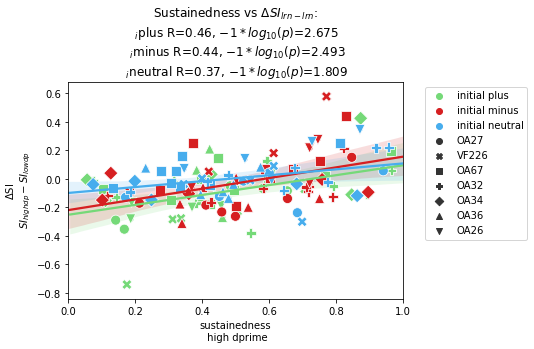

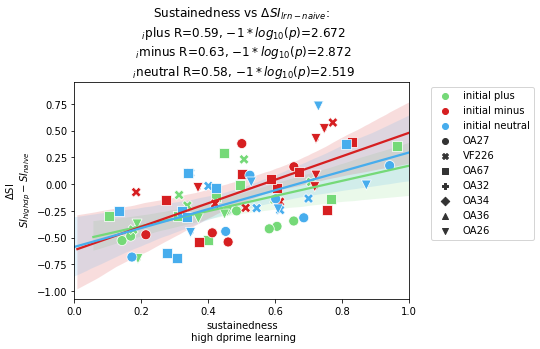

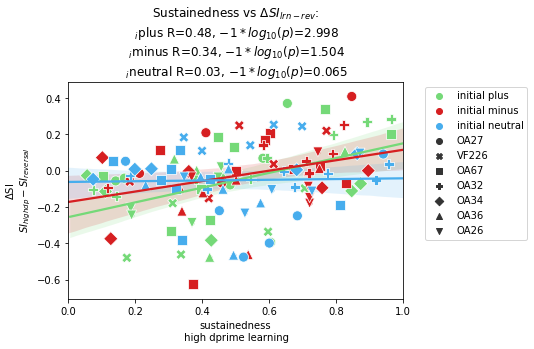

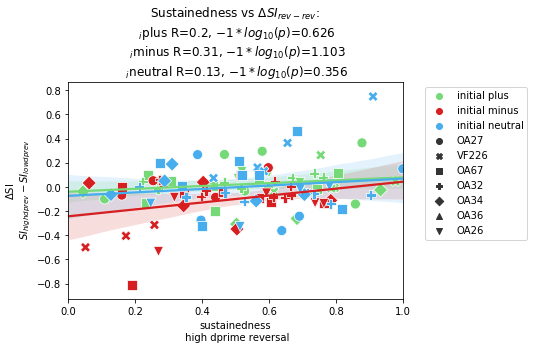

In [364]:
folder = 'Sustainedness index plots daily thresh fit on means grouped PMN'
# folder = 'Sustainedness index plots daily thresh mean of trials fits'
if not os.path.isdir(folder): os.mkdir(folder)
save_dir = os.path.join(folder, 'Sustainedness plots christina ylim')
if not os.path.isdir(save_dir): os.mkdir(save_dir)
tag = 'v2'

hue_dict = {}
for ori in ['plus', 'minus', 'neutral']:
    hue_dict['initial {}'.format(ori)] = color_dict[ori]

plt.figure()
dsus = total_sus['high_dp learning'] - total_sus['low_dp learning']
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{low dp}$')
plt.xlabel('sustainedness\n high dprime')
plt.title('Sustainedness vs $\Delta$$SI_{lrn-lrn}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_learnldp.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

plt.figure()
dsus = total_sus['high_dp learning'] - total_sus['naive']
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{naive}$')
plt.xlabel('sustainedness\n high dprime learning')
plt.title('Sustainedness vs $\Delta$$SI_{lrn-naive}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_naive.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

plt.figure()
dsus = total_sus['high_dp learning'] - total_sus['low_dp reversal1']
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{reversal}$')
plt.xlabel('sustainedness\n high dprime learning')
plt.title('Sustainedness vs $\Delta$$SI_{lrn-rev}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_revldp.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

plt.figure()
dsus = total_sus['high_dp reversal1'] - total_sus['low_dp reversal1']
ori_vec = total_sus.reset_index()['initial CS'].values
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp reversal1'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp reversal1'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
sns.scatterplot(x=total_sus['high_dp reversal1'], y=tester['delta_sus'], s=100,
                hue=total_sus.reset_index()['initial CS'].values, palette=hue_dict,
                style=total_sus.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim([0, 1])
# plt.ylim([-1, 1])
keep_bool = ~np.isnan(tester['delta_sus'])
rs, ps = [], []
for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    r = sp.stats.pearsonr(total_sus['high_dp reversal1'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
    ps.append(r[1])
    rs.append(r[0])
plt.ylabel('$\Delta$SI\n $SI_{high dp rev}-SI_{low dp rev}$')
plt.xlabel('sustainedness\n high dprime reversal')
plt.title('Sustainedness vs $\Delta$$SI_{rev-rev}$'
          + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
          + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
          + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
         )
plt.savefig('.//{}//{}_{}_{}_SI_revhdp_v_revldp.pdf'.format(folder, t_or_wa, tag, words[0]), bbox_inches='tight')

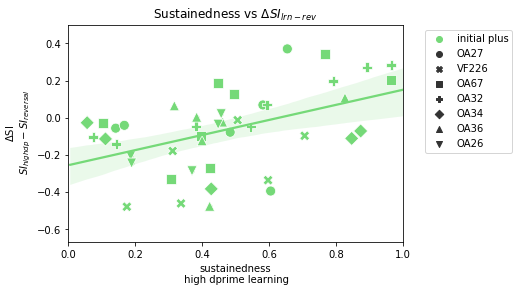

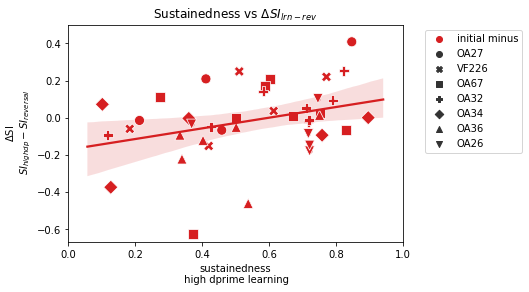

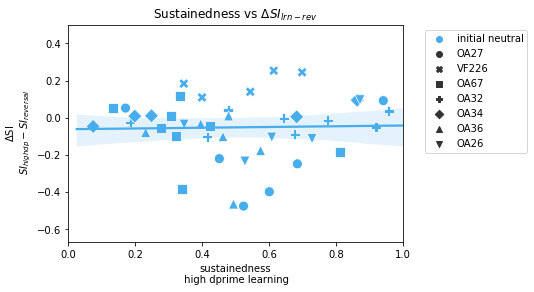

In [366]:
for ori in ['plus', 'minus', 'neutral']:
    plt.figure()
    dsus = total_sus['high_dp learning'] - total_sus['low_dp reversal1']
    ori_vec = total_sus.reset_index()['initial CS'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
    # for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
    sns.scatterplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], s=100,
                    hue=total_sus.iloc[oriboo, :].reset_index()['initial CS'].values, palette=hue_dict,
                    style=total_sus.iloc[oriboo, :].reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    plt.ylim([-0.67, 0.5])
    keep_bool = ~np.isnan(tester['delta_sus'])
    rs, ps = [], []
#     for ori in ['plus', 'minus', 'neutral']:
#         oriboo = ori_vec == 'initial {}'.format(ori)
#         r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
#         ps.append(r[1])
#         rs.append(r[0])
    plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{reversal}$')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('Sustainedness vs $\Delta$$SI_{lrn-rev}$'
#               + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
#               + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
#               + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
             )
#     plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_revldp_{}.pdf'.format(folder, t_or_wa, tag, words[0], ori), bbox_inches='tight')




In [452]:
# working on regression to the mean

ori_bounds = {}
for ori in ['plus', 'minus', 'neutral']:
    plt.figure()
    
    ori_vec = total_sus.reset_index()['initial CS'].values
    oriboo = ori_vec == 'initial {}'.format(ori)
    
    # shuffle fit
    shuff_dsus = []
    shuff_sus = []
    shuff_oriboo = []
    sz = len(total_sus['low_dp reversal1'].values)
    for booti in range(1000):
        rand_inds = np.random.permutation(sz)
        shuff_dsus.extend(deepcopy(total_sus['high_dp learning']).values - deepcopy(total_sus['low_dp reversal1']).values[rand_inds])
        shuff_sus.extend(deepcopy(total_sus['high_dp learning']).values)
        shuff_oriboo.extend(oriboo)
    shuff_dsus = np.array(shuff_dsus)
    shuff_sus = np.array(shuff_sus)
    shuff_oriboo = np.array(shuff_oriboo)
    sig_vec = np.zeros(len(total_sus['high_dp learning'].values))
    bounds = []
    for ic, isus in enumerate(total_sus['high_dp learning'].values):
        if np.isnan(isus):
            bounds.append([np.nan, np.nan, np.nan])
            sig_vec[ic] = 1
            continue
#         iboo = shuff_sus == isus
        nboo = np.arange(ic*len(total_sus['high_dp learning'].values), len(shuff_sus), len(total_sus['high_dp learning'].values))
        sorted_dsus = np.sort(shuff_dsus[nboo])
        sorted_dsus = sorted_dsus[~np.isnan(sorted_dsus)]
        straps = len(sorted_dsus)
        lower = sorted_dsus[int(np.floor(straps*.05))]
        upper = sorted_dsus[int(np.floor(straps*.95))]
        bounds.append([total_sus['high_dp learning'].values[ic], lower, upper])
        if (total_sus['high_dp learning'].values[ic] > lower) and (total_sus['high_dp learning'].values[ic] < upper):
            sig_vec[ic] = 1
            
    ori_bounds[ori] = np.vstack(bounds)[oriboo, :]
    print(np.sum(sig_vec))
    x_shuff = shuff_sus[shuff_oriboo]
    y_shuff = shuff_dsus[shuff_oriboo]
    sns.regplot(x=x_shuff, y=y_shuff, marker='.', color=color_dict['gray'], scatter_kws={'alpha': 0.01}, dropna=True)
    
    # data fit
    dsus = deepcopy(total_sus['high_dp learning']) - deepcopy(total_sus['low_dp reversal1'])
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=regori, y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
    
    # annotated scatterplot
    sns.scatterplot(x=regori, y=regtester['delta_sus'], s=100,
                    hue=total_sus.iloc[oriboo, :].reset_index()['initial CS'].values, palette=hue_dict,
                    style=total_sus.iloc[oriboo, :].reset_index()['mouse'].values)
    
    # annotated scatterplot
    sig_boo = sig_vec > 0
    bad_color = {'initial plus': color_dict['gray'], 'initial minus': color_dict['gray'], 'initial neutral': color_dict['gray']}
    sns.scatterplot(x=total_sus['high_dp learning'].iloc[sig_boo & oriboo], y=tester['delta_sus'].iloc[sig_boo & oriboo], s=100,
                    hue=total_sus.iloc[sig_boo & oriboo, :].reset_index()['initial CS'].values, palette=bad_color,
                    style=total_sus.iloc[sig_boo & oriboo, :].reset_index()['mouse'].values)
    
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    plt.ylim([-0.67, 0.5])
    keep_bool = ~np.isnan(tester['delta_sus'])
    rs, ps = [], []
#     for ori in ['plus', 'minus', 'neutral']:
#         oriboo = ori_vec == 'initial {}'.format(ori)
#         r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
#         ps.append(r[1])
#         rs.append(r[0])
    plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{reversal}$')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('Sustainedness vs $\Delta$$SI_{lrn-rev}$')
#               + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
#               + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
#               + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
        
#     plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_revldp_{}_boot.pdf'.format(folder, t_or_wa, tag, words[0], ori), bbox_inches='tight')



IndexError: index 0 is out of bounds for axis 0 with size 0

<Figure size 432x288 with 0 Axes>

In [457]:
# working on regression to the mean

ori_bounds = {}
for ori in ['plus', 'minus', 'neutral']:
    plt.figure()
    
    ori_vec = total_sus.reset_index()['initial CS'].values
    oriboo = ori_vec == 'initial {}'.format(ori)
    
    # shuffle fit
    shuff_dsus = []
    shuff_sus = []
    shuff_oriboo = []
    sz = len(total_sus['low_dp reversal1'].values)
    boots = np.zeros((sz, 1000))
    for booti in range(1000):
        rand_inds = np.random.permutation(sz)
        shuff_dsus.extend(deepcopy(total_sus['high_dp learning']).values - deepcopy(total_sus['low_dp reversal1']).values[rand_inds])
        shuff_sus.extend(deepcopy(total_sus['high_dp learning']).values)
        shuff_oriboo.extend(oriboo)
        boots[:, booti] = deepcopy(total_sus['high_dp learning']).values - deepcopy(total_sus['low_dp reversal1']).values[rand_inds]
    shuff_dsus = np.array(shuff_dsus)
    shuff_sus = np.array(shuff_sus)
    shuff_oriboo = np.array(shuff_oriboo)
    sig_vec = np.zeros(len(total_sus['high_dp learning'].values))
    bounds = []
    break 
    for ic, isus in enumerate(total_sus['high_dp learning'].values):
        if np.isnan(isus):
            bounds.append([np.nan, np.nan, np.nan])
            sig_vec[ic] = 1
            continue
#         iboo = shuff_sus == isus
        nboo = np.arange(ic*len(total_sus['high_dp learning'].values), len(shuff_sus), len(total_sus['high_dp learning'].values))
        sorted_dsus = np.sort(shuff_dsus[nboo])
        sorted_dsus = sorted_dsus[~np.isnan(sorted_dsus)]
        straps = len(sorted_dsus)
        lower = sorted_dsus[int(np.floor(straps*.05))]
        upper = sorted_dsus[int(np.floor(straps*.95))]
        bounds.append([total_sus['high_dp learning'].values[ic], lower, upper])
        if (total_sus['high_dp learning'].values[ic] > lower) and (total_sus['high_dp learning'].values[ic] < upper):
            sig_vec[ic] = 1
            
    ori_bounds[ori] = np.vstack(bounds)[oriboo, :]
    print(np.sum(sig_vec))
    x_shuff = shuff_sus[shuff_oriboo]
    y_shuff = shuff_dsus[shuff_oriboo]
    sns.regplot(x=x_shuff, y=y_shuff, marker='.', color=color_dict['gray'], scatter_kws={'alpha': 0.01}, dropna=True)
    
    # data fit
    dsus = deepcopy(total_sus['high_dp learning']) - deepcopy(total_sus['low_dp reversal1'])
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=regori, y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
    
    # annotated scatterplot
    sns.scatterplot(x=regori, y=regtester['delta_sus'], s=100,
                    hue=total_sus.iloc[oriboo, :].reset_index()['initial CS'].values, palette=hue_dict,
                    style=total_sus.iloc[oriboo, :].reset_index()['mouse'].values)
    
    # annotated scatterplot
    sig_boo = sig_vec > 0
    bad_color = {'initial plus': color_dict['gray'], 'initial minus': color_dict['gray'], 'initial neutral': color_dict['gray']}
    sns.scatterplot(x=total_sus['high_dp learning'].iloc[sig_boo & oriboo], y=tester['delta_sus'].iloc[sig_boo & oriboo], s=100,
                    hue=total_sus.iloc[sig_boo & oriboo, :].reset_index()['initial CS'].values, palette=bad_color,
                    style=total_sus.iloc[sig_boo & oriboo, :].reset_index()['mouse'].values)
    
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    plt.ylim([-0.67, 0.5])
    keep_bool = ~np.isnan(tester['delta_sus'])
    rs, ps = [], []
#     for ori in ['plus', 'minus', 'neutral']:
#         oriboo = ori_vec == 'initial {}'.format(ori)
#         r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
#         ps.append(r[1])
#         rs.append(r[0])
    plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{reversal}$')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('Sustainedness vs $\Delta$$SI_{lrn-rev}$')
#               + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
#               + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
#               + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
        
#     plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_revldp_{}_boot.pdf'.format(folder, t_or_wa, tag, words[0], ori), bbox_inches='tight')




<Figure size 432x288 with 0 Axes>

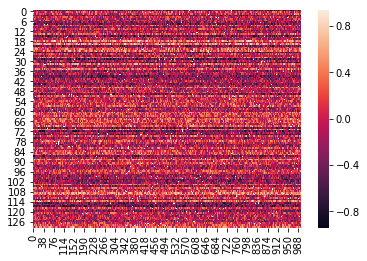

In [462]:
# np.vstack(bounds).shape
# len(total_sus['high_dp learning'].values)
# len(np.arange(ic*len(total_sus['high_dp learning'].values), len(shuff_sus), len(total_sus['high_dp learning'].values)))
sns.heatmap(boots[~np.isnan(total_sus['high_dp learning'].values), :])

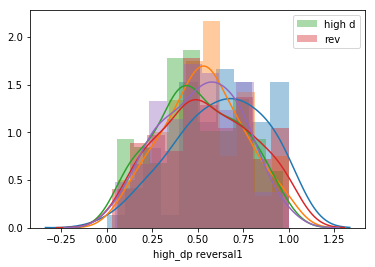

In [384]:
sns.distplot(total_sus['naive'].dropna(), 10)
sns.distplot(total_sus['low_dp learning'].dropna(), 10)
sns.distplot(total_sus['high_dp learning'].dropna(), 10, label='high d''')
sns.distplot(total_sus['low_dp reversal1'].dropna(), 10, label='rev')
sns.distplot(total_sus['high_dp reversal1'].dropna(), 10)
plt.legend()

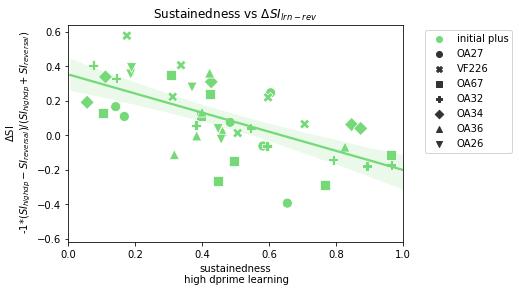

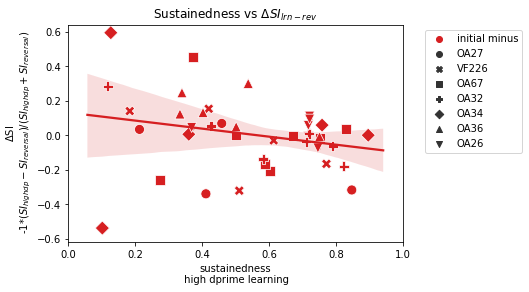

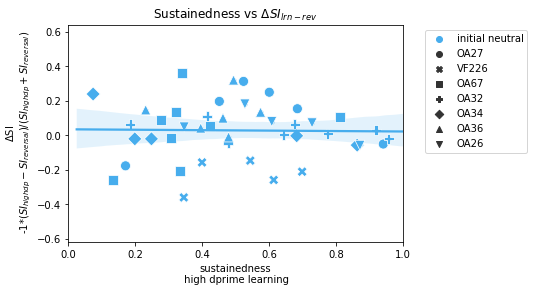

In [341]:
for ori in ['plus', 'minus', 'neutral']:
    plt.figure()
    dsus = ((total_sus['high_dp learning'] - total_sus['low_dp reversal1'])*-1)/(total_sus['high_dp learning'] + total_sus['low_dp reversal1'])
    ori_vec = total_sus.reset_index()['initial CS'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=total_sus.index)
    # for ori in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(ori)
    regtester = tester.iloc[oriboo]
    regori = total_sus['high_dp learning'].iloc[oriboo]
    sns.regplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', color=color_dict[ori], dropna=True)
    sns.scatterplot(x=total_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], s=100,
                    hue=total_sus.iloc[oriboo, :].reset_index()['initial CS'].values, palette=hue_dict,
                    style=total_sus.iloc[oriboo, :].reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    plt.ylim([-0.62, 0.64])
    keep_bool = ~np.isnan(tester['delta_sus'])
    rs, ps = [], []
#     for ori in ['plus', 'minus', 'neutral']:
#         oriboo = ori_vec == 'initial {}'.format(ori)
#         r = sp.stats.pearsonr(total_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
#         ps.append(r[1])
#         rs.append(r[0])
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{reversal})/(SI_{high dp}+SI_{reversal}$)')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('Sustainedness vs $\Delta$$SI_{lrn-rev}$'
#               + ':\n $_i$plus R={}, {}={}'.format(round(rs[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[0]), 3))
#               + '\n $_i$minus R={}, {}={}'.format(round(rs[1], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[1]), 3))
#               + '\n $_i$neutral R={}, {}={}'.format(round(rs[2], 2), '$-1*log_{10}(p)$', round(-1*np.log10(ps[2]), 3))
             )
    plt.savefig('.//{}//{}_{}_{}_SI_learnhdp_v_revldp_{}.pdf'.format(folder, t_or_wa, tag, words[0], ori), bbox_inches='tight')



D:\Anaconda3\lib\site-packages\scipy\stats\stats.py:3033: RuntimeWarning: Mean of empty slice.
  mx = x.mean()
D:\Anaconda3\lib\site-packages\scipy\stats\stats.py:3034: RuntimeWarning: Mean of empty slice.
  my = y.mean()


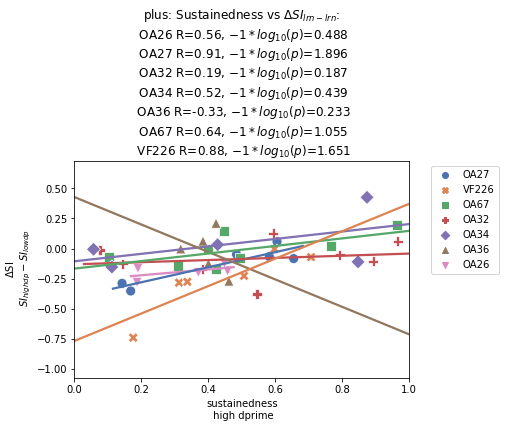

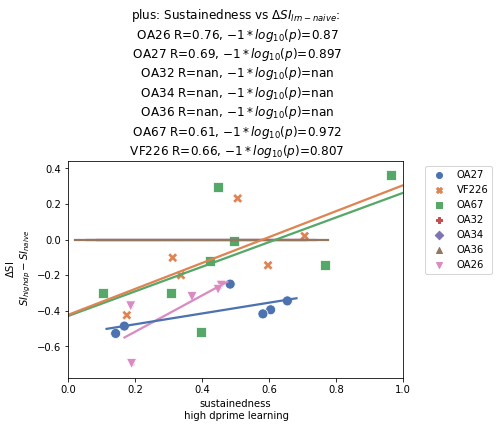

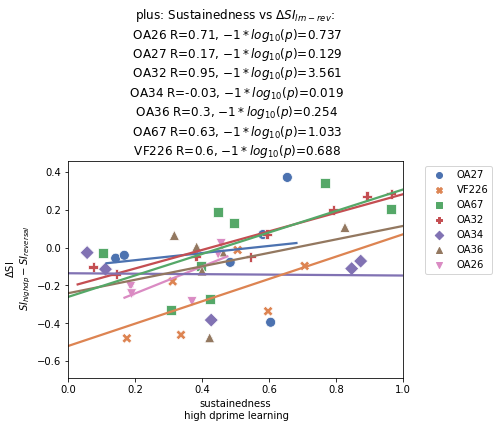

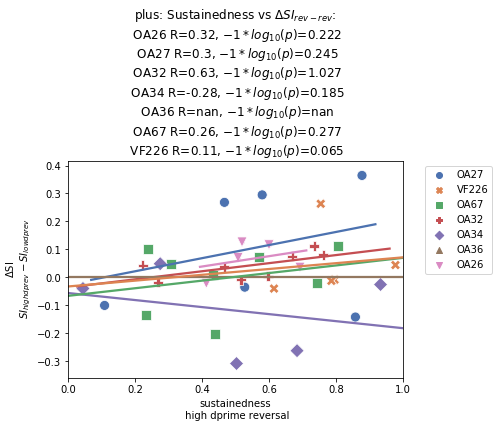

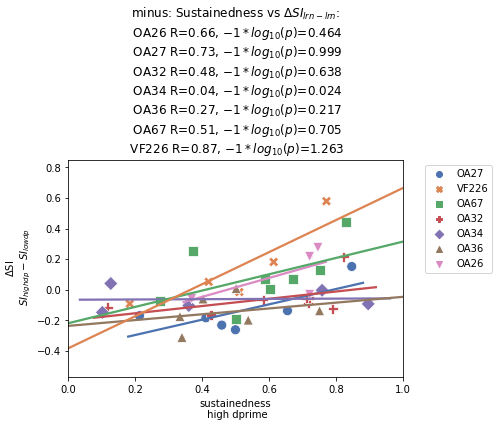

...

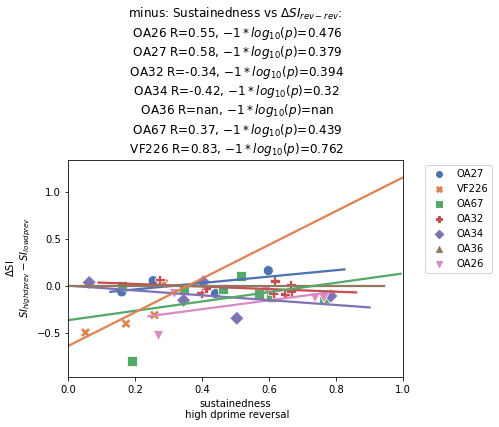

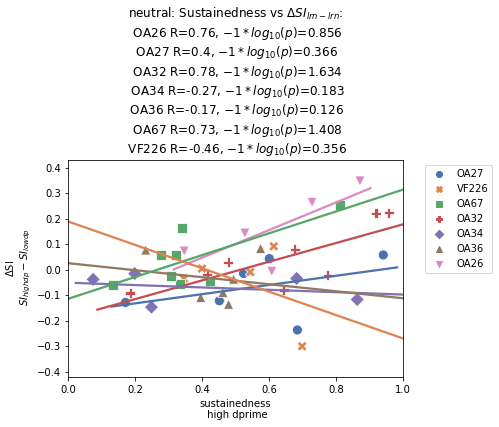

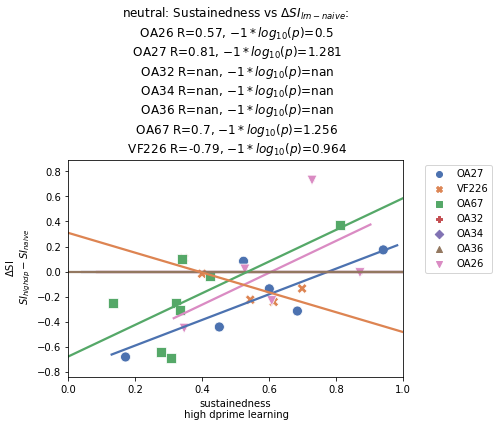

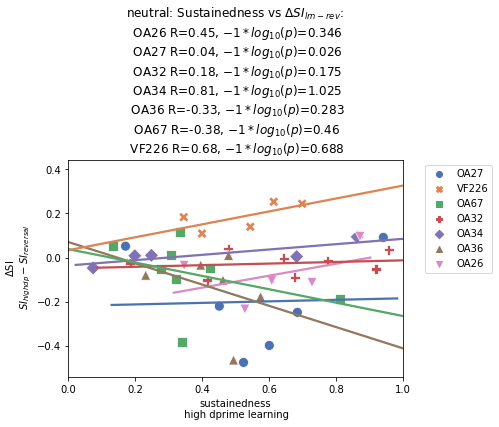

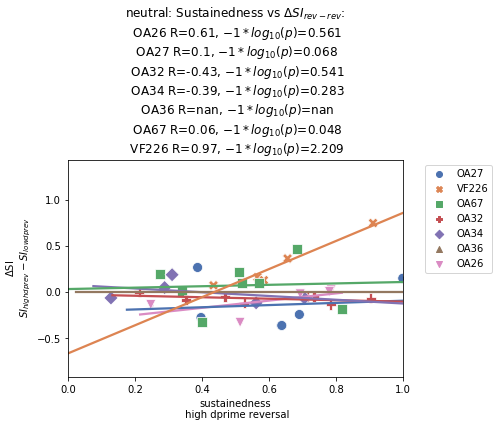

In [45]:
folder = 'Sustainedness index plots daily thresh fit on means grouped by mouse'
# folder = 'Sustainedness index plots daily thresh mean of trials fits'
if not os.path.isdir(folder): os.mkdir(folder)
# save_dir = os.path.join(folder, 'Sustainedness plots christina ylim')
# if not os.path.isdir(save_dir): os.mkdir(save_dir)
tag = 'v2_per_mouse'
save_please = True
cmap = sns.color_palette('deep', 7)

hue_dict = {}
mouse_vec = total_sus.reset_index()['mouse'].unique()
for ms, cm in zip(mouse_vec, cmap):
    hue_dict[ms] = cm

ori_vec = total_sus.reset_index()['initial CS'].values
for cs in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(cs)
    ori_sus = total_sus.iloc[oriboo, :]
    
    plt.figure()
    dsus = ori_sus['high_dp learning'] - ori_sus['low_dp learning']
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp learning'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{low dp}$')
    plt.xlabel('sustainedness\n high dprime')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{lrn-lrn}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_learnhdp_v_learnldp.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

    plt.figure()
    dsus = ori_sus['high_dp learning'] - ori_sus['naive']
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp learning'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{naive}$')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{lrn-naive}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_learnhdp_v_naive.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

    plt.figure()
    dsus = ori_sus['high_dp learning'] - ori_sus['low_dp reversal1']
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp learning'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n $SI_{high dp}-SI_{reversal}$')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{lrn-rev}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_learnhdp_v_revldp.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

    plt.figure()
    dsus = ori_sus['high_dp reversal1'] - ori_sus['low_dp reversal1']
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp reversal1'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp reversal1'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp reversal1'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp reversal1'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n $SI_{high dp rev}-SI_{low dp rev}$')
    plt.xlabel('sustainedness\n high dprime reversal')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{rev-rev}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_revhdp_v_revldp.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

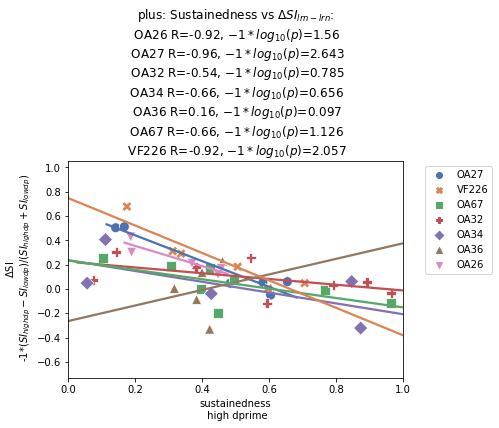

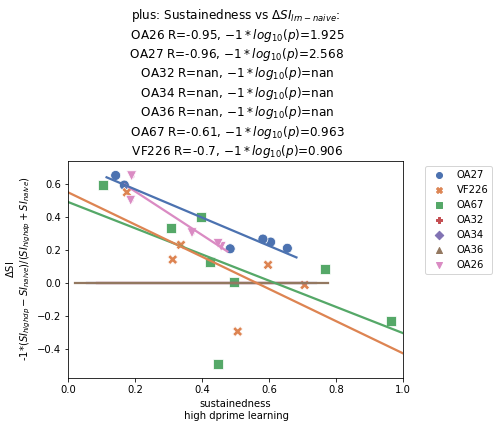

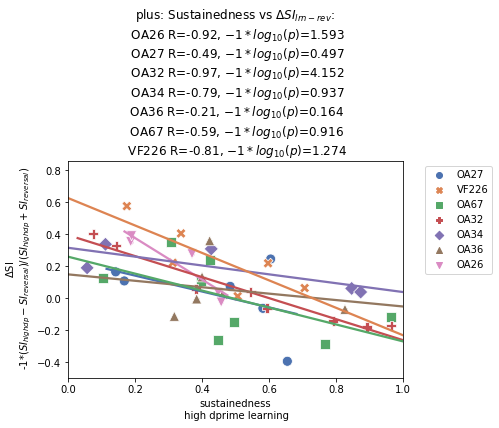

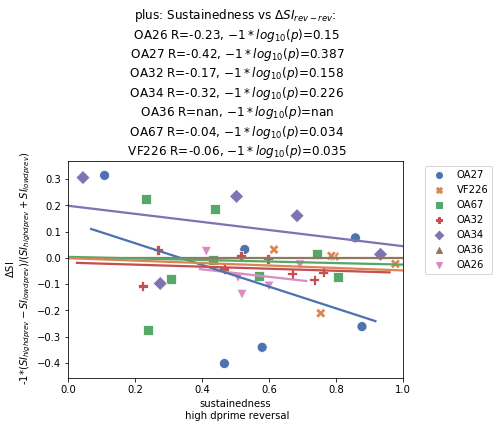

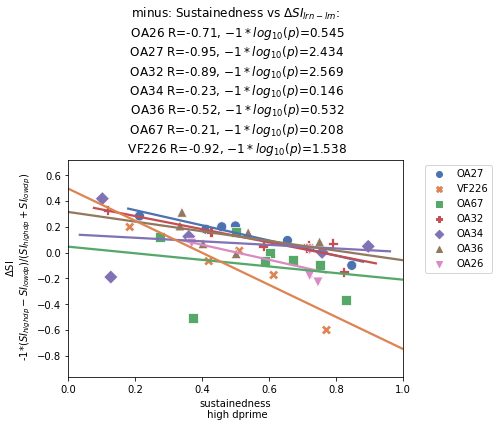

...

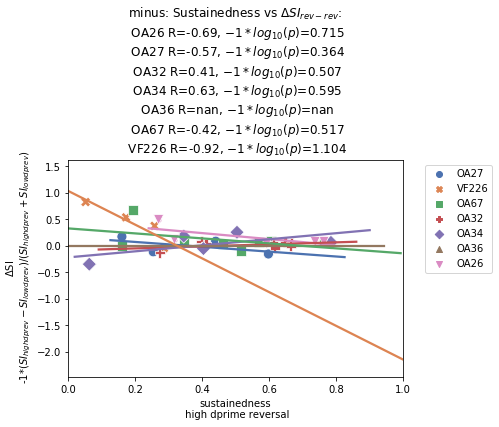

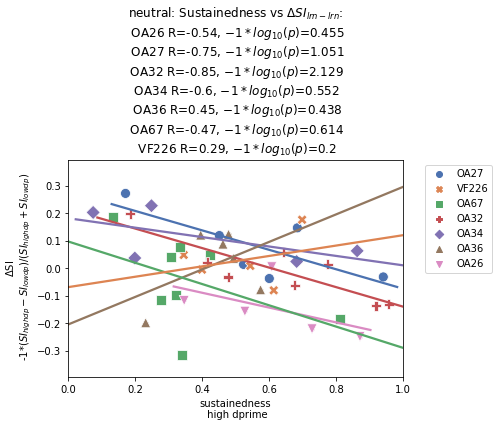

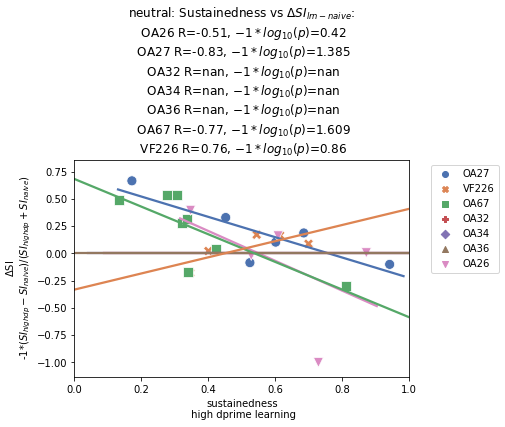

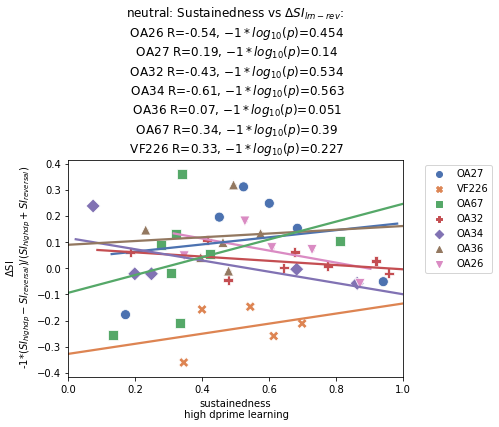

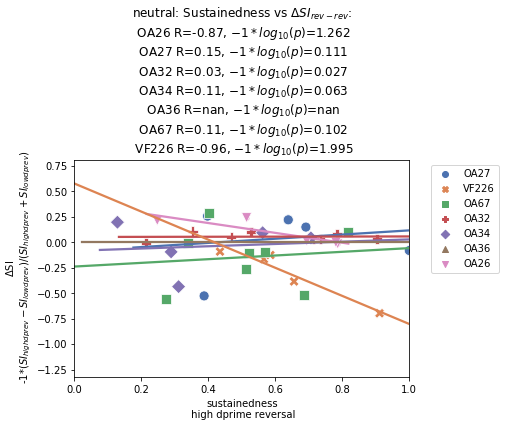

In [177]:
folder = 'Sustainedness index plots daily thresh fit on means grouped by mouse'
# folder = 'Sustainedness index plots daily thresh mean of trials fits'
if not os.path.isdir(folder): os.mkdir(folder)
# save_dir = os.path.join(folder, 'Sustainedness plots christina ylim')
# if not os.path.isdir(save_dir): os.mkdir(save_dir)
tag = 'v1_per_mouse'
save_please = True
cmap = sns.color_palette('deep', 7)

hue_dict = {}
mouse_vec = total_sus.reset_index()['mouse'].unique()
for ms, cm in zip(mouse_vec, cmap):
    hue_dict[ms] = cm

ori_vec = total_sus.reset_index()['initial CS'].values
for cs in ['plus', 'minus', 'neutral']:
    oriboo = ori_vec == 'initial {}'.format(cs)
    ori_sus = total_sus.iloc[oriboo, :]
    
    plt.figure()
    dsus = ((ori_sus['high_dp learning'] - ori_sus['low_dp learning'])*-1)/(ori_sus['high_dp learning'] + ori_sus['low_dp learning'])
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp learning'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{low dp})/(SI_{high dp}+SI_{low dp}$)')
    plt.xlabel('sustainedness\n high dprime')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{lrn-lrn}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_learnhdp_v_learnldp.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

    plt.figure()
    dsus = ((ori_sus['high_dp learning'] - ori_sus['naive'])*-1)/(ori_sus['high_dp learning'] + ori_sus['naive'])
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp learning'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{naive})/(SI_{high dp}+SI_{naive}$)')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{lrn-naive}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_learnhdp_v_naive.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

    plt.figure()
    dsus = ((ori_sus['high_dp learning'] - ori_sus['low_dp reversal1'])*-1)/(ori_sus['high_dp learning'] + ori_sus['low_dp reversal1'])
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp learning'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp learning'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp learning'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{reversal})/(SI_{high dp}+SI_{reversal}$)')
    plt.xlabel('sustainedness\n high dprime learning')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{lrn-rev}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_learnhdp_v_revldp.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

    plt.figure()
    dsus = ((ori_sus['high_dp reversal1'] - ori_sus['low_dp reversal1'])*-1)/(ori_sus['high_dp reversal1'] + ori_sus['low_dp reversal1'])
    mouse_vec = ori_sus.reset_index()['mouse'].values
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=ori_sus.index)
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        regtester = tester.iloc[oriboo]
        regori = ori_sus['high_dp reversal1'].iloc[oriboo]
        sns.regplot(x=ori_sus['high_dp reversal1'].iloc[oriboo], y=regtester['delta_sus'], marker='.', dropna=True, ci=None, color=hue_dict[ori])
    sns.scatterplot(x=ori_sus['high_dp reversal1'], y=tester['delta_sus'], s=100,
                    hue=ori_sus.reset_index()['mouse'].values, palette=hue_dict,
                    style=ori_sus.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlim([0, 1])
    # plt.ylim([-1, 1])
    keep_bool = ~np.isnan(tester['delta_sus'])
    title_tag = []
    for ori in np.unique(mouse_vec):
        oriboo = mouse_vec == ori
        r = sp.stats.pearsonr(ori_sus['high_dp reversal1'].loc[keep_bool & oriboo], tester['delta_sus'].loc[keep_bool & oriboo])
        title_tag.append('\n {} R={}, {}={}'.format(ori, round(r[0], 2), '$-1*log_{10}(p)$', round(-1*np.log10(r[1]), 3)))
    title_text = ''.join(title_tag)
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp rev}-SI_{low dp rev})/(SI_{high dp rev}+SI_{low dp rev}$)')
    plt.xlabel('sustainedness\n high dprime reversal')
    plt.title('{}: '.format(cs) + 'Sustainedness vs $\Delta$$SI_{rev-rev}$:' + title_text)
    if save_please:
        plt.savefig('.//{}//{}_{}_{}_{}_SI_revhdp_v_revldp.pdf'.format(folder, t_or_wa, cs, tag, words[0]), bbox_inches='tight')

In [180]:
 V.results[rank][0].factors[2]

(800, 10)

In [225]:
comp_fits = {}
for mi, V, meti in zip(mice, model_list, meta_list):
    A = _get_fitting_template_defaults(mi)
    fac_num = V.results[rank][0].factors[1].shape[1]
    comp_fits[mi] = {}
    for c, comp_n in enumerate(range(1, fac_num+1)):
        comp_fits[mi]['component_{}'.format(c+1)] = {}
        b = V.results[rank][0].factors[1][:,c]
        b[b < 0] = 0
        sp_ans = sp.optimize.nnls(A, b)
        sp_ans = sp_ans[0]
        plt.figure()
#         plt.plot(V.results[rank][0].factors[1][:,c])
        plt.plot(b, linewidth=3)
#         plt.plot(A, alpha=0.4)
        sns.despine()
        plt.title('{}: christina: comp {}: betas {}: sus_ratio {}'.format(mi, comp_n, sp_ans, sp_ans[1]/(sp_ans[1] + sp_ans[0])))
        plt.ylabel('temporal factor amplitude (AU)')
        plt.xlabel('time in trial (samples, 15.5 Hz)')
        plt.savefig('.//Raw for slides//{}_christina-horrible_component{}_w_fits.pdf'.format(mi,comp_n), bbox_inches='tight')
        plt.close('all')

In [191]:
sp_ans

(array([0.6385328 , 0.98208265, 0.        , 0.        ]), 2.308043779168869)

Text(0.5, 1.0, 'neutral: Sustainedness vs $\\Delta$$SI_{rev-rev}$: R=0.15, p=0.409')

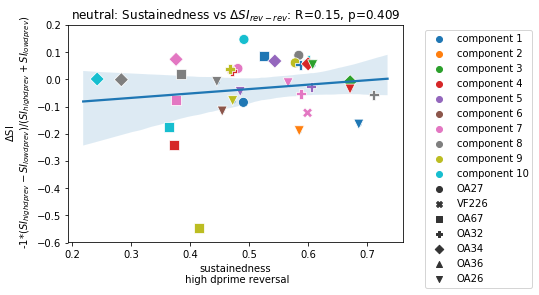

In [37]:
plt.figure()
dsus = ((sus_df['high_dp reversal1'] - sus_df['low_dp reversal1'])*-1)/(sus_df['high_dp reversal1'] + sus_df['low_dp reversal1'])
# dsusr = (norm_sus_df['high_dp learning'] - norm_sus_df['low_dp reversal1'])*-1
tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=sus_df.index)
sns.regplot(x=sus_df['high_dp reversal1'], y=tester['delta_sus'], marker='.')
sns.scatterplot(x=sus_df['high_dp reversal1'], y=tester['delta_sus'], s=100, hue=['component {}'.format(s) for s in sus_df.reset_index()['component'].values],
                style=sus_df.reset_index()['mouse'].values)
plt.legend(bbox_to_anchor=(1.05, 1))
# plt.ylim([-0.2, 0.2])
keep_bool = ~np.isnan(tester['delta_sus'])
r = sp.stats.pearsonr(sus_df['high_dp reversal1'].loc[keep_bool], tester['delta_sus'].loc[keep_bool])
plt.ylabel('$\Delta$SI\n -1*($SI_{high dp rev}-SI_{low dp rev})/(SI_{high dp rev}+SI_{low dp rev}$)')
plt.xlabel('sustainedness\n high dprime reversal')
plt.title('{}: '.format(ori) + 'Sustainedness vs $\Delta$$SI_{rev-rev}$' + ': R={}, p={}'.format(round(r[0], 2), round(r[1], 3)))
# plt.savefig('.//Sustainedness index plots//{}_{}_{}_SI_revhdp_v_revldp.pdf'.format(t_or_wa, ori, words[0]), bbox_inches='tight')

Text(0.5, 1.0, 'neutral: Sustainedness vs $\\Delta$$SI_{lrn-lrn}$: R=-0.46, p=0.0')

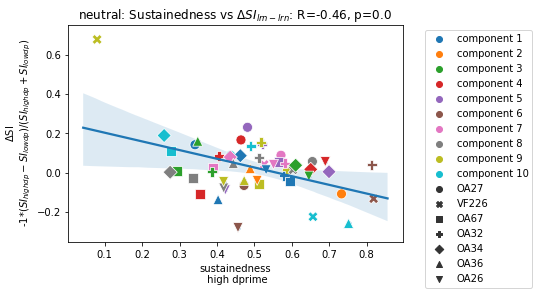

In [38]:
    plt.figure()
    dsus = ((sus_df['high_dp learning'] - sus_df['low_dp learning'])*-1)/(sus_df['high_dp learning'] + sus_df['low_dp learning'])
    # dsusr = (norm_sus_df['high_dp learning'] - norm_sus_df['low_dp reversal1'])*-1
    tester = pd.DataFrame(data=dsus.T, columns=['delta_sus'], index=sus_df.index)
    sns.regplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], marker='.')
    sns.scatterplot(x=sus_df['high_dp learning'], y=tester['delta_sus'], s=100,
                    hue=['component {}'.format(s) for s in sus_df.reset_index()['component'].values],
                    style=sus_df.reset_index()['mouse'].values)
    plt.legend(bbox_to_anchor=(1.05, 1))
    # plt.ylim([-0.2, 0.2])
    keep_bool = ~np.isnan(tester['delta_sus'])
    r = sp.stats.pearsonr(sus_df['high_dp learning'].loc[keep_bool], tester['delta_sus'].loc[keep_bool])
    plt.ylabel('$\Delta$SI\n -1*($SI_{high dp}-SI_{low dp})/(SI_{high dp}+SI_{low dp}$)')
    plt.xlabel('sustainedness\n high dprime')
    plt.title('{}: '.format(ori) + 'Sustainedness vs $\Delta$$SI_{lrn-lrn}$' + ': R={}, p={}'.format(round(r[0], 2), round(r[1], 3)))
#     plt.savefig('.//Sustainedness index plots//{}_{}_{}_SI_learnhdp_v_learnldp.pdf'.format(t_or_wa, ori, words[0]), bbox_inches='tight')

In [197]:
fac_list = []
mean_ten_list = []
for mi, V, meti, teni in zip(mice, model_list, meta_list, subset_tensor_list):
    A = _get_fitting_template_defaults(mi)
    fac_list.append(V.results[rank][0].factors[1])
    mean_ten_list.append(np.nanmean(teni, axis=2))

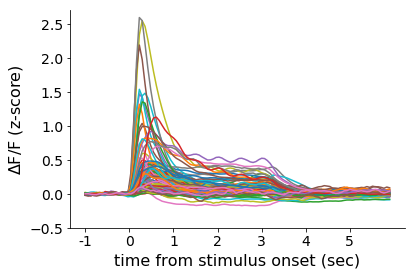

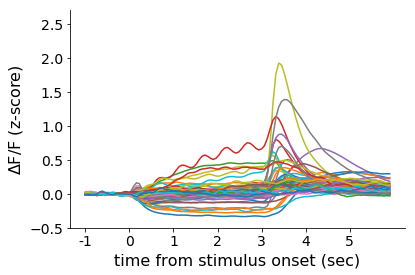

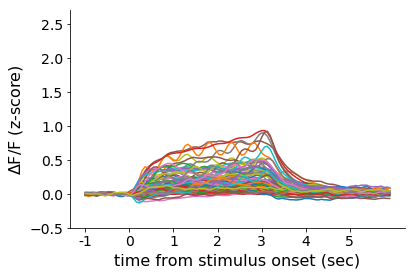

In [270]:
# g = sns.clustermap(mean_ten_list[0], col_cluster=False, method='ward')
off_cells = (np.argmax(mean_ten_list[0], axis=1)>65) & (np.max(mean_ten_list[0], axis=1)>.1)
offset = mean_ten_list[0][off_cells, :]
ons_cells = (np.argmax(mean_ten_list[0], axis=1)<27) & (np.argmax(mean_ten_list[0], axis=1)>18)
onset = mean_ten_list[0][ons_cells, :]
sus_cells = (np.argmax(mean_ten_list[0], axis=1)<65) & (np.argmax(mean_ten_list[0], axis=1)>27)
sust = mean_ten_list[0][sus_cells, :]

# plt.plot(mean_ten_list[0][:, :].T)
plt.figure()
plt.plot(onset.T)
sns.despine()
plt.ylim([-0.5, 2.7])
plt.ylabel('$\Delta$F/F (z-score)', size=16)
plt.xticks(timepts, labels=times, size=14)
plt.yticks(size=14)
plt.xlabel('time from stimulus onset (sec)', size=16)
plt.savefig('.//Raw for slides//christina-horrible_cells_onset.pdf', bbox_inches='tight')

plt.figure()
plt.plot(offset.T)
sns.despine()
plt.ylim([-0.5, 2.7])
plt.ylabel('$\Delta$F/F (z-score)', size=16)
plt.xticks(timepts, labels=times, size=14)
plt.yticks(size=14)
plt.xlabel('time from stimulus onset (sec)', size=16)
plt.savefig('.//Raw for slides//christina-horrible_cells_offset.pdf', bbox_inches='tight')

plt.figure()
plt.plot(sust.T)
sns.despine()
plt.ylim([-0.5, 2.7])
plt.ylabel('$\Delta$F/F (z-score)', size=16)
plt.xticks(timepts, labels=times, size=14)
plt.yticks(size=14)
plt.xlabel('time from stimulus onset (sec)', size=16)
plt.savefig('.//Raw for slides//christina-horrible_cells_sustained.pdf', bbox_inches='tight')

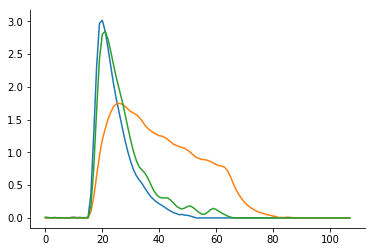

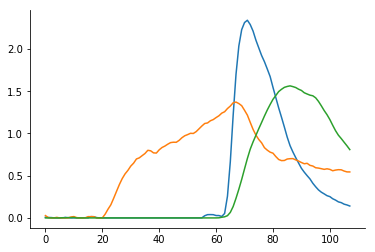

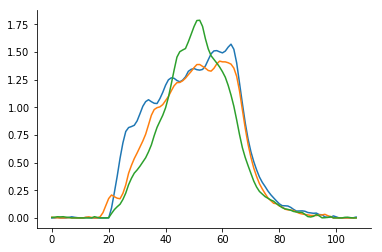

In [227]:
# g = sns.clustermap(mean_ten_list[0], col_cluster=False, method='ward')
off_cells = (np.argmax(fac_list[0], axis=0)>65) & (np.max(fac_list[0], axis=0)>.0)
offset = fac_list[0][:, off_cells]
ons_cells = (np.argmax(fac_list[0], axis=0)<27) & (np.argmax(fac_list[0], axis=0)>18)
onset = fac_list[0][:, ons_cells]
sus_cells = (np.argmax(fac_list[0], axis=0)<65) & (np.argmax(fac_list[0], axis=0)>27)
sust = fac_list[0][:, sus_cells]

# plt.plot(mean_ten_list[0][:, :].T)
plt.figure()
plt.plot(onset)
sns.despine()
# plt.savefig('.//Raw for slides//OA27_comps_christina-horrible_cells_onset.eps', bbox_inches='tight')
plt.figure()
plt.plot(offset)
sns.despine()
# plt.savefig('.//Raw for slides//OA27_comps_christina-horrible_cells_offset.eps', bbox_inches='tight')
plt.figure()
plt.plot(sust)
sns.despine()
# plt.savefig('.//Raw for slides//OA27_comps_christina-horrible_cells_sustained.eps', bbox_inches='tight')

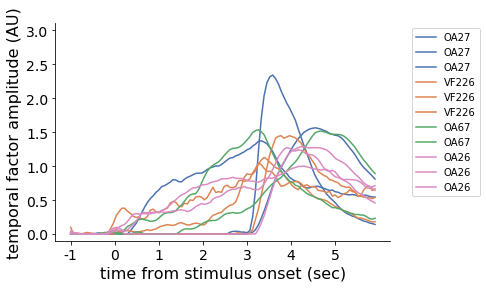

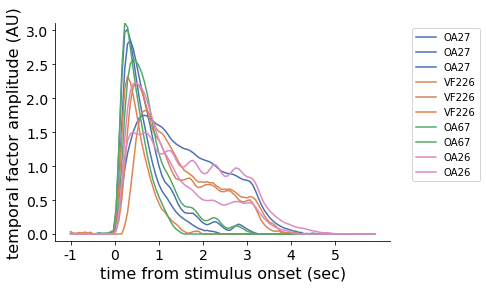

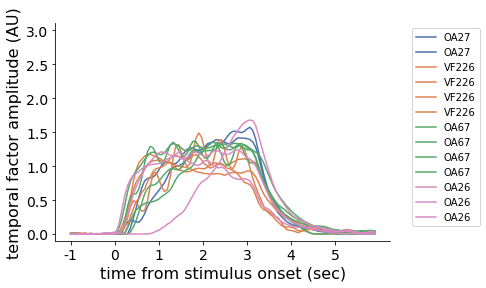

In [272]:
times = np.arange(-1, 7, 1)
timepts = np.arange(0, 108, 15.5)

# plt.plot(mean_ten_list[0][:, :].T)
plt.figure()
for faci, mi in zip(fac_list, mice):
    if mi in ['OA32', 'OA34', 'OA36']:
        continue
    off_cells = (np.argmax(faci, axis=0)>65) & (np.max(faci, axis=0)>0)
    offset = faci[:, off_cells]
    plt.plot(offset, color=hue_dict[mi], label=mi)
sns.despine()
plt.ylim([-0.1, 3.1])
plt.ylabel('temporal factor amplitude (AU)', size=16)
plt.xticks(timepts, labels=times, size=14)
plt.yticks(size=14)
plt.xlabel('time from stimulus onset (sec)', size=16)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('.//Raw for slides//3smice_comps_christina-horrible_cells_offset.pdf', bbox_inches='tight')

plt.figure()
for faci, mi in zip(fac_list, mice):
    if mi in ['OA32', 'OA34', 'OA36']:
        continue
    ons_cells = (np.argmax(faci, axis=0)<27) & (np.argmax(faci, axis=0)>18)
    onset = faci[:, ons_cells]
    plt.plot(onset, color=hue_dict[mi], label=mi)
sns.despine()
plt.ylim([-0.1, 3.1])
plt.ylabel('temporal factor amplitude (AU)', size=16)
plt.xticks(timepts, labels=times, size=14)
plt.yticks(size=14)
plt.xlabel('time from stimulus onset (sec)', size=16)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('.//Raw for slides//3smice_comps_christina-horrible_cells_onset.pdf', bbox_inches='tight')

plt.figure()
for faci, mi in zip(fac_list, mice):
    if mi in ['OA32', 'OA34', 'OA36']:
        continue
    sus_cells = (np.argmax(faci, axis=0)<65) & (np.argmax(faci, axis=0)>27) & (np.max(faci, axis=0)<1.76)
    sust = faci[:, sus_cells]
    plt.plot(sust, color=hue_dict[mi], label=mi)
sns.despine()
plt.ylim([-0.1, 3.1])
plt.ylabel('temporal factor amplitude (AU)', size=16)
plt.xticks(timepts, labels=times, size=14)
plt.yticks(size=14)
plt.xlabel('time from stimulus onset (sec)', size=16)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('.//Raw for slides//3smice_comps_christina-horrible_cells_sustained.pdf', bbox_inches='tight')

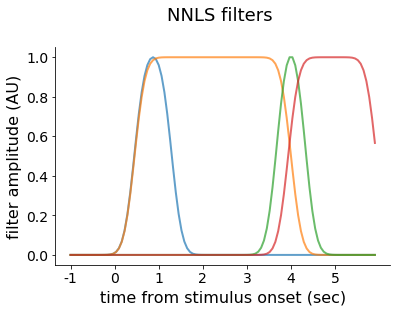

In [262]:
A = _get_fitting_template_defaults('OA27')
plt.plot(A, linewidth=2, alpha=0.7)
plt.title('NNLS filters \n', size=18)
plt.xticks(timepts, labels=times,  size=14)
plt.yticks(size=14)
plt.ylabel('filter amplitude (AU)', size=16)
plt.xlabel('time from stimulus onset (sec)', size=16)
sns.despine()
plt.savefig('.//Raw for slides//NNLS_filters.eps', bbox_inches='tight')